In [11]:
print("Multivariate Linear Regression Using Gradient Descent")
print("Enter the number of features:")
n=int(input())
print("Enter the number of samples in training data:")
m=int(input())

x=[]
y=[]
for i in range(n):
    print("Enter Feature ",i+1," Samples:")
    row=[]
    for j in range(m):
        print(j+1,"th Sample: ")
        xs=float(input())
        row.append(xs)
    x.append(row)
        
print("Enter actual outputs:")
for i in range(m):
    print(i+1,"th Output: ")
    xs=float(input())
    y.append(xs)
        
print("---------------------------------------")
for i in range(n):
    print("Feature ",i+1," Samples:")
    for j in range(m):
        print(j+1,"th Sample: ",x[i][j])

print("Actual Outputs:")    
for i in range(m):
    print(i+1,"th output: ",y[i])
    
print("--------------------------------------")        

Multivariate Linear Regression Using Gradient Descent
Enter the number of features:
4
Enter the number of samples in training data:
3
Enter Feature  1  Samples:
1 th Sample: 
2
2 th Sample: 
4
3 th Sample: 
6
Enter Feature  2  Samples:
1 th Sample: 
16
2 th Sample: 
32
3 th Sample: 
64
Enter Feature  3  Samples:
1 th Sample: 
8
2 th Sample: 
8
3 th Sample: 
12
Enter Feature  4  Samples:
1 th Sample: 
5.0
2 th Sample: 
5.2
3 th Sample: 
5.5
Enter actual outputs:
1 th Output: 
10000
2 th Output: 
12500
3 th Output: 
15000
---------------------------------------
Feature  1  Samples:
1 th Sample:  2.0
2 th Sample:  4.0
3 th Sample:  6.0
Feature  2  Samples:
1 th Sample:  16.0
2 th Sample:  32.0
3 th Sample:  64.0
Feature  3  Samples:
1 th Sample:  8.0
2 th Sample:  8.0
3 th Sample:  12.0
Feature  4  Samples:
1 th Sample:  5.0
2 th Sample:  5.2
3 th Sample:  5.5
Actual Outputs:
1 th output:  10000.0
2 th output:  12500.0
3 th output:  15000.0
--------------------------------------


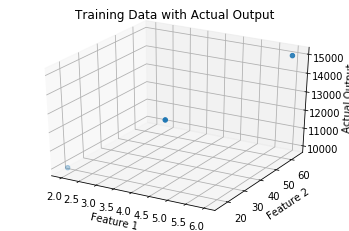

In [29]:
#Plotting data set using two features
from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt

ax = plt.axes(projection='3d')
ax.set_title("Training Data with Actual Output")
ax.scatter(x[0],x[1],y)
ax.set_xlabel("Feature 1")
ax.set_ylabel("Feature 2")
ax.set_zlabel("Actual Output")
ax.grid(True)

In [ ]:

#output= W0X0 + W1X1 + ... + WnXn            X0=1 cause W0 is the intercept
def predict_output(f,w):
    N=len(w)
    total=0
    for i in range(N):
        if i==0:
            total+=w[i]
        else:
            total+=f[i-1]*w[i]
    return total

#Caluclating cost using MSE
def cost_function(list_x,list_y,w):
    N=len(list_x[0])  #total number of data in training set
    total=0
    for i in range(N):
        f=[]
        for j in range(len(list_x)): #total number of features
              f.append(list_x[j][i])
        total+=(list_y[i]-predict_output(f,w))**2
    total=total/N
    return total

#Updating weights
def update_weights(list_x,list_y,w,learning_rate):
    N=len(list_x[0])
    new_w=[]
    for i in range(len(w)):
        new_w.append(0)
    for i in range(N):
        f=[]
        for j in range(len(list_x)): #total number of features
              f.append(list_x[j][i])
                
        for j in range(len(w)):
            if j==0:
                new_w[j]+=-2*(list_y[i]-predict_output(f,w))
            else:
                new_w[j]+=-2*list_x[j-1][i]*(list_y[i]-predict_output(f,w))
    for i in range(len(w)):
        w[i]-=(new_w[i]/N)*learning_rate
    return w

#training function
def train_model(list_x,list_y,w,learning_rate):
    N=len(list_x[0])
    min_cost=999999999
    cnt=0
    ite=0
    while(True):
        ite+=1
        print("\n\n-------------- Iteration: ",ite," ------------------")
       
        for i in range(N):
            f=[]
            for j in range(len(list_x)): #total number of features
                f.append(list_x[j][i])
            print("x: ",f,", Actual y: ",list_y[i],", Predicted y: ",predict_output(f,w))
            
        print(".......................................\nWhere weights: ",w)
        cost=cost_function(list_x,list_y,w)
        if(abs(cost)<min_cost):
            min_cost=abs(cost)
            min_w=w
            cnt=0
        else:
            cnt+=1
            
        if(cnt>30): break
        print("Error(Cost) is: ",cost)
        
        w=update_weights(list_x,list_y,w,learning_rate)
        
        
    print("\n\n---------------------******************************------------------------------")
    print("Minimum Error(Cost): ",min_cost," where weights: ",min_w)
    for i in range(N):
        f=[]
        for j in range(len(list_x)): #total number of features
            f.append(list_x[j][i])
        print("x: ",f,", Actual y: ",list_y[i],", Predicted y: ",predict_output(f,min_w))
    print("---------------------******************************------------------------------")
    return min_w  

#Calling model train function

ini_w=[]
for i in range(len(x)+1):
    ini_w.append(1)

w=train_model(x,y,ini_w,0.0005)




-------------- Iteration:  1  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  32.0
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  50.2
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  88.5
.......................................
Where weights:  [1, 1, 1, 1, 1]
Error(Cost) is:  158903792.09666666


-------------- Iteration:  2  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9498.807850000001
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  17701.410664000003
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  34473.534285
.......................................
Where weights:  [13.443100000000001, 54.068066666666674, 505.0725333333334, 120.4268, 66.53073666666667]
Error(Cost) is:  135508134.67195502


-------------- Iteration:  3  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  964.9141163511665
x:  [4.0, 32.0, 8.0, 5.2] , Actu

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  17150.098440939862
.......................................
Where weights:  [69.2308898942374, 88.95700810227738, 153.17482965424585, 408.9768103629058, 333.8572145827924]
Error(Cost) is:  4962107.482183077


-------------- Iteration:  49  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  7523.792982851074
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10057.489583716902
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16562.67384823173
.......................................
Where weights:  [70.02300101180514, 89.1180821028444, 142.99622997376935, 412.44690138219454, 337.6037853991429]
Error(Cost) is:  4846469.293792126


-------------- Iteration:  50  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  7705.647422677132
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10338.772893801255
x:  [6.0, 64.0, 12.0, 5.5] , A

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16580.64542192797
.......................................
Where weights:  [86.41104256991453, 107.19062753071698, 117.87513520909951, 501.1258693001567, 417.01300530718225]
Error(Cost) is:  3198833.2477849848


-------------- Iteration:  69  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  8284.51813500674
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10424.938812175253
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16467.21183906967
.......................................
Where weights:  [87.13565446150632, 107.88922244374155, 115.03378559634687, 504.8152372036537, 420.5083136973943]
Error(Cost) is:  3133822.5143478704


-------------- Iteration:  70  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  8339.71203476281
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10482.561128520752
x:  [6.0, 64.0, 12.0, 5.5] 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16221.009752314396
.......................................
Where weights:  [103.31792411616124, 127.03929144944196, 86.63553187930032, 588.8736930002302, 498.96322240429123]
Error(Cost) is:  1957640.4863927637


-------------- Iteration:  95  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  8968.373568441186
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10692.178185849012
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16200.680672302991
.......................................
Where weights:  [103.86466050416882, 127.71181094866748, 85.50363586076101, 591.6195711012051, 501.61410869157305]
Error(Cost) is:  1924702.2942843018


-------------- Iteration:  96  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  8992.459721535924
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10704.923022755967
x:  [6.0, 64.0, 12.0, 

Error(Cost) is:  1498843.0901727434


-------------- Iteration:  112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9299.71198968016
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10817.397221301835
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16054.194983166453
.......................................
Where weights:  [112.27366600509966, 138.68262325710316, 70.73957906476073, 633.2589762927804, 542.4336003564879]
Error(Cost) is:  1477627.4902712752


-------------- Iteration:  113  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9316.304597490778
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  10822.714130933933
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  16044.091903566306
.......................................
Where weights:  [112.71656460705017, 139.28456233591436, 69.93271845169598, 635.3965717974959, 544.5845677209593]
Error(Cost) is:  145695

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11004.402508648642
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15822.118575102379
.......................................
Where weights:  [125.39806702874452, 158.24239679511825, 48.289447942921626, 693.5221046254493, 606.2684006273726]
Error(Cost) is:  985037.7557308362


-------------- Iteration:  149  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9804.642853533918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11008.480615718769
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15817.011798851887
.......................................
Where weights:  [125.69121571154545, 158.72960105481786, 47.802449619972386, 694.7711359877202, 607.6968307782836]
Error(Cost) is:  976767.5892750766


-------------- Iteration:  150  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9815.159904364367
x:  [4.0, 32.0, 8.0, 5

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11078.20965580512
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15733.00569168496
.......................................
Where weights:  [130.68994449750335, 167.5374133631654, 39.67630887220425, 715.1138064717462, 632.080331186625]
Error(Cost) is:  853037.6052590039


-------------- Iteration:  169  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9990.030006817033
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11081.453210683132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15729.10411626969
.......................................
Where weights:  [130.92557344137794, 167.9791905581312, 39.30116274294409, 716.0214971004962, 633.2310943136633]
Error(Cost) is:  847989.0688688891


-------------- Iteration:  170  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  9998.062093135588
x:  [4.0, 32.0, 8.0, 5.2] , Ac

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11136.564241216465
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15663.91726173389
.......................................
Where weights:  [134.96248782075008, 176.0223196852221, 33.024120178250556, 730.6612932401176, 652.9712082749746]
Error(Cost) is:  771834.4496950856


-------------- Iteration:  189  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10131.754258440986
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11139.142456474057
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15660.897355356381
.......................................
Where weights:  [135.15381417398697, 176.42870654857302, 32.734323022477184, 731.3066810503675, 653.9080828814556]
Error(Cost) is:  768692.5842352851


-------------- Iteration:  190  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10137.887121023961
x:  [4.0, 32.0, 8.0, 5

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11183.017552210398
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15610.210287905536
.......................................
Where weights:  [138.45003439507542, 183.87645108912292, 27.87965896762593, 741.5672877242629, 670.0719855193651]
Error(Cost) is:  720702.3258550676


-------------- Iteration:  209  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10239.914288839225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11185.079659884688
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15607.860605861839
.......................................
Where weights:  [138.60723321188803, 184.25522330406713, 27.655381818350158, 742.0112645415563, 670.8440767186298]
Error(Cost) is:  718689.62766564


-------------- Iteration:  210  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10244.588986710578
x:  [4.0, 32.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11220.30858280177
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15568.330671031941
.......................................
Where weights:  [141.33278617381157, 191.23777441807914, 23.894662756892476, 748.9104062435563, 684.2523539974293]
Error(Cost) is:  687386.3810050827


-------------- Iteration:  229  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10322.271267891181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11221.972671562493
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15566.495140748008
.......................................
Where weights:  [141.46368376951506, 191.594922992909, 23.72075444336101, 749.1998127811415, 684.897432958588]
Error(Cost) is:  686043.1222774686


-------------- Iteration:  230  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10325.825315582963
x:  [4.0, 32.0, 8.0, 5.2]

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11250.54492987791
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15535.548329654364
.......................................
Where weights:  [143.74931436375942, 198.21242677067707, 20.801381032891246, 753.520006626943, 696.181088916034]
Error(Cost) is:  664640.391884207


-------------- Iteration:  249  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10384.792293550829
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11251.902387122584
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15534.108077775734
.......................................
Where weights:  [143.85992935657296, 198.55256236351306, 20.666208017422637, 753.6908621299121, 696.7282028298341]
Error(Cost) is:  663694.7330639007


-------------- Iteration:  250  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10387.484931706353
x:  [4.0, 32.0, 8.0, 5.2

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11275.347500998998
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15509.764481075057
.......................................
Where weights:  [145.80617811403616, 204.88206654241714, 18.39393753230879, 756.0337762105307, 706.3724703840705]
Error(Cost) is:  648179.54018839


-------------- Iteration:  269  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10432.065520300366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11276.468701918926
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15508.628299310301
.......................................
Where weights:  [145.90113882890466, 205.20873699672143, 18.288557267676076, 756.1137759547121, 706.8439567115007]
Error(Cost) is:  647470.7326918913


-------------- Iteration:  270  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10434.096036857965
x:  [4.0, 32.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11295.962764379348
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15489.365365491858
.......................................
Where weights:  [147.5853212472568, 211.309528751831, 16.514027254026086, 756.9420192878969, 715.221981094761]
Error(Cost) is:  635469.9714767478


-------------- Iteration:  289  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10467.618887326851
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11296.901843256412
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15488.463154332114
.......................................
Where weights:  [147.6681869124356, 211.6254644186133, 16.431563972327716, 756.9524574553384, 715.6350176754478]
Error(Cost) is:  634902.9505615669


-------------- Iteration:  290  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10469.140511528023
x:  [4.0, 32.0, 8.0, 5.2] 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11313.349232627308
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15473.110103263509
.......................................
Where weights:  [149.14975996175406, 217.54317411367154, 15.039923325128516, 756.6217122979697, 723.0337560428844]
Error(Cost) is:  625013.1102556862


-------------- Iteration:  309  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10494.165115999715
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11314.147820897713
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15472.38796587313
.......................................
Where weights:  [149.223267729794, 217.85047669031522, 14.975090054205932, 756.5789609712713, 723.401553250365]
Error(Cost) is:  624531.6476181353


-------------- Iteration:  310  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10495.295668144992
x:  [4.0, 32.0, 8.0, 5.2

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11332.977663099045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15456.08381723335
.......................................
Where weights:  [151.00522853397348, 225.71573138506204, 13.531256611869397, 754.7431796546285, 732.339203886149]
Error(Cost) is:  612958.9961475091


-------------- Iteration:  336  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10519.332583471967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11333.635948587345
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15455.540884668231
.......................................
Where weights:  [151.06934862260874, 226.01387469728877, 13.483956084438617, 754.6480286073996, 732.6615918489132]
Error(Cost) is:  612542.9767625747


-------------- Iteration:  337  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10520.07486165212
x:  [4.0, 32.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11352.694764300324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15440.71706796362
.......................................
Where weights:  [152.9861000017503, 235.41270019982122, 12.219578593661952, 750.8682942627725, 742.3240373846013]
Error(Cost) is:  599955.9624392483


-------------- Iteration:  369  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10538.321094597473
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11353.236099907434
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15440.3225821585
.......................................
Where weights:  [153.04233229135392, 235.70241217887676, 12.186783396967028, 750.7305298223166, 742.6082330036721]
Error(Cost) is:  599580.3399342883


-------------- Iteration:  370  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10538.74309568164
x:  [4.0, 32.0, 8.0, 5.2]

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10545.11673271862
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11363.021910359947
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15433.457147055438
.......................................
Where weights:  [154.076761357679, 241.16722894273585, 11.625129696933593, 747.9359154001909, 747.8432230246005]
Error(Cost) is:  592585.5089816026


-------------- Iteration:  389  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10545.408645105525
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11363.512885871953
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15433.126075328268
.......................................
Where weights:  [154.12956276096767, 241.45287427966596, 11.598520941412175, 747.7803837637596, 748.1107857225106]
Error(Cost) is:  592223.9159547365


-------------- Iteration:  390  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10549.903317687633
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11372.453130493232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15427.321526481464
.......................................
Where weights:  [155.10612569387717, 246.84610301570567, 11.140286857458621, 744.6918712339674, 753.0650852742533]
Error(Cost) is:  585453.0962442759


-------------- Iteration:  409  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10550.08943255304
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11372.904945311111
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15427.039378252895
.......................................
Where weights:  [155.15623303565638, 247.12825357696002, 11.118443206258869, 744.5229679328926, 753.3195715200363]
Error(Cost) is:  585101.4255630985


-------------- Iteration:  410  ------------------
x:  [2.0, 16.0, 8.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10552.819088829556
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11381.186724946154
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15422.053654793064
.......................................
Where weights:  [156.0872410519499, 252.45946817500763, 10.739886176077583, 741.2139636096003, 758.0526047467093]
Error(Cost) is:  578493.7923117456


-------------- Iteration:  429  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10552.924076689624
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11381.60799322744
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15421.809286814467
.......................................
Where weights:  [156.13522122909362, 252.73856583960693, 10.721714667308941, 741.0350668203595, 758.2967509082995]
Error(Cost) is:  578149.5966129182


-------------- Iteration:  430  ------------------
x:  [2.0, 16.0, 8.0, 5

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.300801264502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11389.375224522208
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15417.456241919677
.......................................
Where weights:  [157.03014704103592, 258.0151687471495, 10.404577324680277, 737.5619831651553, 762.854242842608]
Error(Cost) is:  571668.8280350886


-------------- Iteration:  449  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.343630806692
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11389.772572527736
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15417.241084824349
.......................................
Where weights:  [157.07643628513378, 258.2915554297709, 10.389237495412935, 737.3756887953787, 763.0901546744759]
Error(Cost) is:  571330.641531009


-------------- Iteration:  450  ------------------
x:  [2.0, 16.0, 8.0, 5.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.684264700649
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11397.135966044394
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15413.377565992021
.......................................
Where weights:  [157.94256994598075, 263.5192791599574, 10.119480233362278, 733.7818713062683, 767.5072964501624]
Error(Cost) is:  564954.9076549397


-------------- Iteration:  469  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.679520289952
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11397.514491458707
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15413.185029564223
.......................................
Where weights:  [157.98750401373508, 263.79321989678044, 10.10632577598883, 733.5901737603134, 767.7365947968656]
Error(Cost) is:  564621.8451428775


-------------- Iteration:  470  ------------------
x:  [2.0, 16.0, 8.0, 5

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.227668636211
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11404.559224189717
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15409.700944191913
.......................................
Where weights:  [158.83045721989356, 268.97651265638893, 9.87315217142834, 729.9089204892243, 772.0404774893782]
Error(Cost) is:  558337.888553836


-------------- Iteration:  489  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10554.186563390442
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11404.922849308185
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15409.525960057825
.......................................
Where weights:  [158.87429460755428, 269.2482133566613, 9.861686071250757, 729.7133516649209, 772.2644103220372]
Error(Cost) is:  558009.4083236987


-------------- Iteration:  490  ------------------
x:  [2.0, 16.0, 8.0, 5.0]

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10553.129517900194
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11411.714464335157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15406.33663652949
.......................................
Where weights:  [159.6983884738886, 274.3905355699542, 9.656793500784136, 725.970235026393, 776.4758964125413]
Error(Cost) is:  551809.044298638


-------------- Iteration:  509  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10553.060672678086
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11412.066207641758
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15406.175306516903
.......................................
Where weights:  [159.74132826763366, 274.6601566658482, 9.646633539778987, 725.7719711943141, 776.695424977556]
Error(Cost) is:  551484.8079474083


-------------- Iteration:  510  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , A

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10551.542423899311
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11418.655150585557
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15403.215620381496
.......................................
Where weights:  [160.54989150130638, 279.7642089832362, 9.46363695265614, 721.9866232821387, 780.8305873863847]
Error(Cost) is:  545362.8550785021


-------------- Iteration:  529  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10551.45246629089
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11418.997335578315
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15403.064946131439
.......................................
Where weights:  [160.59208710301758, 280.0318759257596, 9.454489184141968, 721.786567268653, 781.0464524481714]
Error(Cost) is:  545042.6446216756


-------------- Iteration:  530  ------------------
x:  [2.0, 16.0, 8.0, 5.0] ,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10549.58370917623
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11425.422442831628
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15400.284803521157
.......................................
Where weights:  [161.38768527971297, 285.09977454879385, 9.288478021642005, 717.9740526455225, 785.1176810576952]
Error(Cost) is:  538995.7012306063


-------------- Iteration:  549  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10549.47773408686
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11425.756858595665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15400.142478577058
.......................................
Where weights:  [161.4292549612033, 285.3655858785252, 9.280116374046722, 717.7728970260836, 785.3304538350379]
Error(Cost) is:  538679.3700910918


-------------- Iteration:  550  ------------------
x:  [2.0, 16.0, 8.0, 5.0] 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11432.048039545343
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15397.503343253284
.......................................
Where weights:  [162.21386682362692, 290.3989973746137, 9.127313869679739, 713.9447683072036, 789.3473063338232]
Error(Cost) is:  532705.0907257667


-------------- Iteration:  569  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10547.225485423573
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11432.376064223088
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15397.367593191233
.......................................
Where weights:  [162.25490184215587, 290.66303092763707, 9.119564463182163, 713.7430439977643, 789.5574276666229]
Error(Cost) is:  532392.5347531472


-------------- Iteration:  570  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10547.106889744578
x:  [4.0, 32.0, 8.0, 5.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10544.89130448324
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11438.556363703807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15394.839816071348
.......................................
Where weights:  [163.0300548621569, 295.66327589502276, 8.97706566698845, 709.9081535239524, 793.5272837935208]
Error(Cost) is:  526489.202363463


-------------- Iteration:  589  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10544.764137368922
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11438.879059435501
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15394.709275570816
.......................................
Where weights:  [163.07062570073742, 295.9255935749528, 8.969794754048475, 709.7062671445016, 793.735094259498]
Error(Cost) is:  526180.3426964768


-------------- Iteration:  590  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10542.280217687385
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11444.966243622186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15392.27004130987
.......................................
Where weights:  [163.83750031784362, 300.8937263555907, 8.83536509053564, 705.8713911041971, 797.6636588752428]
Error(Cost) is:  520346.6156336683


-------------- Iteration:  609  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10542.146273026105
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11445.284429548978
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15392.143659629113
.......................................
Where weights:  [163.87766148363713, 301.1543778030164, 8.82846978295571, 705.6696537087987, 797.8694219477507]
Error(Cost) is:  520041.3885650783


-------------- Iteration:  610  ------------------
x:  [2.0, 16.0, 8.0, 5.0] ,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10539.41230037082
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11451.606513803612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15389.652375968908
.......................................
Where weights:  [164.67696497179216, 306.35027319196973, 8.693791294055961, 701.6386212139074, 801.9650317197868]
Error(Cost) is:  513974.5019295234


-------------- Iteration:  630  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10539.273144578918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11451.920642189585
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15389.529494066497
.......................................
Where weights:  [164.7167412417444, 306.6092182213799, 8.687205524169693, 701.4372948722333, 802.1688639059662]
Error(Cost) is:  513673.0304933424


-------------- Iteration:  631  ------------------
x:  [2.0, 16.0, 8.0, 5.0]

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11462.501629843131
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15385.430808274483
.......................................
Where weights:  [166.05927503105607, 315.3660578620359, 8.470117309914801, 694.6096138518506, 809.0495112753563]
Error(Cost) is:  503527.8228453474


-------------- Iteration:  665  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10534.293016220829
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11462.8101147302
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15385.312334260754
.......................................
Where weights:  [166.09848497338174, 315.6222355824259, 8.463908095570568, 694.40938564609, 809.2504890769494]
Error(Cost) is:  503232.4934072672


-------------- Iteration:  666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10534.148182991814
x:  [4.0, 32.0, 8.0, 5.2] , 

-------------- Iteration:  683  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10531.670408796872
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11468.338710058786
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15383.196981761494
.......................................
Where weights:  [166.80172972589247, 320.22017115006173, 8.353556547984168, 690.8118846440074, 812.8552709702102]
Error(Cost) is:  497946.12252817355


-------------- Iteration:  684  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10531.523844710528
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11468.644556649153
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15383.080362319444
.......................................
Where weights:  [166.84066102568676, 320.4748786339291, 8.347499182861936, 690.6124057333463, 813.0548387248841]
Error(Cost) is:  497654.07067335997


-------------- Iterat

-------------- Iteration:  708  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10527.985978945995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11475.946451807595
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15380.306718056108
.......................................
Where weights:  [167.77083377555573, 326.5649157093158, 8.20412416913307, 685.8378698280922, 817.8232736841883]
Error(Cost) is:  490696.021109208


-------------- Iteration:  709  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10527.837871949445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11476.249152460801
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15380.192130587318
.......................................
Where weights:  [167.8094207259525, 326.81771635149613, 8.198226810276442, 685.6394898071915, 818.021094219709]
Error(Cost) is:  490408.22435395693


-------------- Iteration: 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15377.349979763221
.......................................
Where weights:  [168.7698341502528, 333.1132400151097, 8.052495453115213, 680.6953170350765, 822.9449440185489]
Error(Cost) is:  483267.9282286288


-------------- Iteration:  735  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10523.974571166429
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11484.078616646764
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15377.237140848774
.......................................
Where weights:  [168.808083359768, 333.3640858651975, 8.046729028414179, 680.4981774048473, 823.141046476572]
Error(Cost) is:  482984.4896063845


-------------- Iteration:  736  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10523.82562562162
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11484.378229679845
x:  [6.0, 64.0, 12.0, 5.5] , 

Error(Cost) is:  478472.018619925


-------------- Iteration:  752  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10521.440564380711
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11489.15736283762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15375.32796435974
.......................................
Where weights:  [169.4564016654394, 337.617070064859, 7.9493534584937136, 677.1544115584156, 826.4650149564659]
Error(Cost) is:  478191.39337249805


-------------- Iteration:  753  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10521.29141475854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11489.455156057527
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15375.216174351655
.......................................
Where weights:  [169.4944263682467, 337.8665772761022, 7.943662005187515, 676.9581718950611, 826.6599733189199]
Error(Cost) is:  477910.93273

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10518.457193200087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11495.093637090398
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15373.102299054215
.......................................
Where weights:  [170.21458169127752, 342.5931827351906, 7.836225180467199, 673.2393443549515, 830.3523776622683]
Error(Cost) is:  472613.3283188858


-------------- Iteration:  773  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10518.308043888526
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11495.389384297527
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15372.991556660938
.......................................
Where weights:  [170.25236398149596, 342.8412151588283, 7.83060564127923, 673.0441329446267, 830.5460991543787]
Error(Cost) is:  472336.1396273342


-------------- Iteration:  774  ------------------
x:  [2.0, 16.0, 8.0, 5.0]

Error(Cost) is:  467923.16737478337


-------------- Iteration:  790  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10515.7737696954
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11500.401947236656
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15371.116343530375
.......................................
Where weights:  [170.8928459656769, 347.0465586299981, 7.735565194463633, 669.7335417640305, 833.8300858492128]
Error(Cost) is:  467648.7296764755


-------------- Iteration:  791  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10515.624794421405
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11500.695923844647
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15371.00646031371
.......................................
Where weights:  [170.9304152788561, 347.2932741668249, 7.730002323582501, 669.5392744780902, 834.0227195613712]
Error(Cost) is:  467374.4529

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11509.47095453149
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15367.730459625005
.......................................
Where weights:  [172.0521035684785, 354.6609725338001, 7.564417396842002, 663.7359878294337, 839.7741733641151]
Error(Cost) is:  459220.5336490574


-------------- Iteration:  822  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10511.015104652224
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11509.762003276306
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15367.621916452114
.......................................
Where weights:  [172.08931526494578, 354.90544134421367, 7.558938762150806, 663.5433741216722, 839.964978706212]
Error(Cost) is:  458951.20026466757


-------------- Iteration:  823  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10510.866736427964
x:  [4.0, 32.0, 8.0, 5.2]

Where weights:  [173.015935066747, 360.99381095525337, 7.4227526352636595, 658.7455467822812, 844.7163210721169]
Error(Cost) is:  452268.96507384116


-------------- Iteration:  848  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10507.1658736806
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11517.297190830526
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15364.813777198173
.......................................
Where weights:  [173.0528539392307, 361.23641463320223, 7.417335142912456, 658.5543360331652, 844.9056279846088]
Error(Cost) is:  452003.7088697933


-------------- Iteration:  849  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10507.01819773922
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11517.585784998078
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15364.70629559406
.......................................
Where weights:  [173.089761

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15362.564492255948
.......................................
Where weights:  [173.82558507339064, 366.3146347740563, 7.304067063648375, 654.5514278049203, 848.8679405101238]
Error(Cost) is:  446469.12622961606


-------------- Iteration:  870  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10503.924025803597
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11523.62571530117
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15362.457787074989
.......................................
Where weights:  [173.86226023066257, 366.55567311006, 7.298696459646293, 654.3614097400879, 849.0559996155544]
Error(Cost) is:  446207.271671518


-------------- Iteration:  871  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10503.777031476664
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11523.912359503993
x:  [6.0, 64.0, 12.0, 5.5] 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10500.551621290178
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11530.196461931748
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15360.013389415952
.......................................
Where weights:  [174.70276537042983, 372.0800382588997, 7.175724333134406, 650.0059775289194, 853.3658739680886]
Error(Cost) is:  440226.82286156266


-------------- Iteration:  894  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10500.405406587153
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11530.481105947076
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15359.90753181251
.......................................
Where weights:  [174.73917821288387, 372.3193817832987, 7.170401118107843, 649.8172624159971, 853.5525895179941]
Error(Cost) is:  439968.6294408776


-------------- Iteration:  895  ------------------
x:  [2.0, 16.0, 8.0, 5.0

-------------- Iteration:  912  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10497.779632824848
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11535.59001728434
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15358.007950491974
.......................................
Where weights:  [175.39275800230956, 376.6155597582243, 7.074904252058111, 646.4296705650385, 856.9039845505705]
Error(Cost) is:  435346.9567441082


-------------- Iteration:  913  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10497.634099959727
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11535.873033676438
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15357.90274028069
.......................................
Where weights:  [175.42896546877583, 376.8535707456447, 7.069616415463856, 646.2419863627794, 857.089647890001]
Error(Cost) is:  435091.62537847605


-------------- Iteration: 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15355.387671383756
.......................................
Where weights:  [176.2947284421794, 382.544910627247, 6.943245125904644, 641.7538175644144, 861.529087335859]
Error(Cost) is:  429008.3969565301


-------------- Iteration:  938  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10494.007850356069
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11542.92091316544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15355.283288146473
.......................................
Where weights:  [176.33066839886894, 382.78118030568646, 6.938001639373556, 641.567486989419, 861.7133798401]
Error(Cost) is:  428756.783168556


-------------- Iteration:  939  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10493.863289868506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11543.201732786089
x:  [6.0, 64.0, 12.0, 5.5] , Act

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11547.962871199272
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15353.409927831137
.......................................
Where weights:  [176.97577229608615, 387.0221924226845, 6.843911980774519, 638.2227715185109, 865.0213410922262]
Error(Cost) is:  424252.88610272127


-------------- Iteration:  957  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10491.267758174445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11548.24218790899
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15353.306157869349
.......................................
Where weights:  [177.01151082092832, 387.25714765446116, 6.838700886555009, 638.0374664801401, 865.2046012037185]
Error(Cost) is:  424004.06142880354


-------------- Iteration:  958  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10491.123928714167
x:  [4.0, 32.0, 8.0, 5

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11558.242539266248
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15349.591515778426
.......................................
Where weights:  [178.29109614728745, 395.6697640360913, 6.65220185528559, 631.402291569936, 871.7660759703787]
Error(Cost) is:  415142.90477865684


-------------- Iteration:  994  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10485.972151727774
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11558.518806184798
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15349.488910832702
.......................................
Where weights:  [178.32644660683408, 395.9021812413025, 6.647051412823622, 631.2189732252712, 871.9473468461977]
Error(Cost) is:  414899.42311921605


-------------- Iteration:  995  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10485.829776826115
x:  [4.0, 32.0, 8.0, 5.2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15346.120236809806
.......................................
Where weights:  [179.48719012094656, 403.5338091700811, 6.477976686210918, 625.199396798961, 877.8994403933351]
Error(Cost) is:  406944.14149713353


-------------- Iteration:  1028  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10481.153753311255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11567.863450535986
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15346.01867592426
.......................................
Where weights:  [179.52218845634465, 403.7639188949995, 6.472879889239347, 625.017889833066, 878.0789060345109]
Error(Cost) is:  406705.46842018823


-------------- Iteration:  1029  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10481.012734862412
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11568.136875192955
x:  [6.0, 64.0, 12.0, 5

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15344.09477435175
.......................................
Where weights:  [180.18520458541596, 408.1231990679188, 6.376334634138335, 621.5793222060221, 881.4787440548546]
Error(Cost) is:  402197.18317254534


-------------- Iteration:  1048  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10478.340997904532
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11573.316653135682
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15343.993818172206
.......................................
Where weights:  [180.21999765707443, 408.3519623415114, 6.37126869300344, 621.3988737468208, 881.6571573003628]
Error(Cost) is:  401961.2941908834


-------------- Iteration:  1049  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10478.200781130756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11573.588470285475
x:  [6.0, 64.0, 12.0, 5

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15340.2794607267
.......................................
Where weights:  [181.50017853080232, 416.7691906135188, 6.184897056925728, 614.7592712836097, 888.2217220851314]
Error(Cost) is:  393329.98026687774


-------------- Iteration:  1086  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10473.040960532391
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11583.58964452472
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15340.179637483305
.......................................
Where weights:  [181.534585222133, 416.99541753393254, 6.179888629693138, 614.5808188666196, 888.3981542468692]
Error(Cost) is:  393099.2919073364


-------------- Iteration:  1087  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10472.902267768952
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11583.858438055933
x:  [6.0, 64.0, 12.0, 5.5

Where weights:  [182.42562131964937, 422.85408169935846, 6.050192534390173, 609.9593552920732, 892.9672501226235]
Error(Cost) is:  387148.6531865339


-------------- Iteration:  1113  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10469.310305647814
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11590.81939877346
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15337.495543537523
.......................................
Where weights:  [182.45975625854732, 423.0785237118317, 6.045224245397059, 609.7823087060619, 893.142288878151]
Error(Cost) is:  386921.5901805288


-------------- Iteration:  1114  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10469.17269301361
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11591.086066968
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15337.396543420577
.......................................
Where weights:  [182.493881

Error(Cost) is:  382857.15308701346


-------------- Iteration:  1132  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10466.702487506109
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11595.872718587729
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15335.619529094885
.......................................
Where weights:  [183.1064194901795, 427.33043538902564, 5.951106522247094, 606.4282617739436, 896.4582797380752]
Error(Cost) is:  382632.60704940226


-------------- Iteration:  1133  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10466.565632439824
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11596.137902135995
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15335.521082490493
.......................................
Where weights:  [183.14035457844992, 427.55356438104815, 5.946167636587853, 606.2522497746472, 896.632293743339]
Error(Cost) is:  382

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11605.10795429405
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15332.191100677983
.......................................
Where weights:  [184.28824067485883, 435.10113425669994, 5.779112300225821, 600.2984349605247, 902.5184814040322]
Error(Cost) is:  374855.91565337306


-------------- Iteration:  1168  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10461.800726078181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11605.370425905261
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15332.093663886044
.......................................
Where weights:  [184.32182892563608, 435.32198398782106, 5.774224278912429, 600.124219499172, 902.6907169441859]
Error(Cost) is:  374636.0623481754


-------------- Iteration:  1169  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10461.665298979773
x:  [4.0, 32.0, 8.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10456.280516453942
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11616.065686031685
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15328.123334131884
.......................................
Where weights:  [185.69049486586601, 444.32126752305646, 5.575051748155071, 593.0251868178515, 909.7090328057342]
Error(Cost) is:  365732.2345026454


-------------- Iteration:  1210  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10456.146701725847
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11616.324941412719
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15328.02709349602
.......................................
Where weights:  [185.7236716869935, 444.53941292911446, 5.570223881249217, 592.853103608029, 909.8791586432809]
Error(Cost) is:  365517.73224401724


-------------- Iteration:  1211  ------------------
x:  [2.0, 16.0, 8.0, 5

-------------- Iteration:  1240  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10452.150408058395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11624.067327816649
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15325.152985306186
.......................................
Where weights:  [186.71446327356256, 451.0541074251657, 5.426046658295523, 587.7140030027397, 914.959791875971]
Error(Cost) is:  359140.83385305456


-------------- Iteration:  1241  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10452.017801536982
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11624.324235278611
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15325.057617265618
.......................................
Where weights:  [186.7473396998355, 451.27027807875885, 5.421262632074539, 587.5434770991815, 915.1283773545968]
Error(Cost) is:  358930.1974563724


-------------- Iterati

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10446.61423122634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11634.79279794138
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15321.171543156974
.......................................
Where weights:  [188.08700206031554, 460.0788980756809, 5.226323543786708, 580.5948012171061, 921.9979693154455]
Error(Cost) is:  350399.6447206109


-------------- Iteration:  1283  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10446.483245791318
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11635.04655877384
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15321.077344037967
.......................................
Where weights:  [188.11947586954065, 460.29242177129424, 5.221598211856071, 580.4263629666976, 922.1644902511821]
Error(Cost) is:  350194.1350386006


-------------- Iteration:  1284  ------------------
x:  [2.0, 16.0, 8.0, 5.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10443.87158069417
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11640.106171726367
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15319.199156849976
.......................................
Where weights:  [188.7669554428633, 464.5497686516843, 5.12738247431701, 577.0679518581139, 925.4846706987908]
Error(Cost) is:  346109.1592615865


-------------- Iteration:  1304  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10443.741398796781
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11640.358373880114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15319.105536608804
.......................................
Where weights:  [188.7992298064398, 464.76198105521974, 5.1226861994006985, 576.900547890926, 925.6501689124165]
Error(Cost) is:  345906.16595285316


-------------- Iteration:  1305  ------------------
x:  [2.0, 16.0, 8.0, 5.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11645.386909841243
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15317.238890406146
.......................................
Where weights:  [189.44273277810305, 468.9931827470025, 5.029049719325296, 573.5627591606477, 928.9499580329883]
Error(Cost) is:  341871.2088600396


-------------- Iteration:  1325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10441.01637414466
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11645.6375629607
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15317.145845394121
.......................................
Where weights:  [189.47480892561012, 469.2040919149143, 5.024382313786589, 573.396383153496, 929.1144398281332]
Error(Cost) is:  341670.7011127292


-------------- Iteration:  1326  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10440.887028978159
x:  [4.0, 32.0, 8.0, 5.2] 

-------------- Iteration:  1364  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10435.999905074475
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11655.355899217157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15313.538304919215
.......................................
Where weights:  [190.71846743272823, 477.3814784623353, 4.843418089084811, 566.9456370594233, 935.4917389632667]
Error(Cost) is:  333941.9476212748


-------------- Iteration:  1365  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10435.872030388975
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11655.603628203571
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15313.446345645267
.......................................
Where weights:  [190.75016939632462, 477.589927383491, 4.838805165428017, 566.7812016949688, 935.6543020038142]
Error(Cost) is:  333746.0903922508


-------------- Iteratio

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11661.035320015282
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15311.430052964282
.......................................
Where weights:  [191.44526494543027, 482.1603677091934, 4.737662599878025, 563.1757997950214, 939.2186505147713]
Error(Cost) is:  329466.1746058324


-------------- Iteration:  1388  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10432.941237726576
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11661.281383154015
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15311.338712170393
.......................................
Where weights:  [191.4767537368051, 482.3674150079805, 4.733080707698893, 563.0124700554011, 939.3801204414838]
Error(Cost) is:  329272.9424213934


-------------- Iteration:  1389  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10432.814259798193
x:  [4.0, 32.0, 8.0, 5.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15309.790011844321
.......................................
Where weights:  [192.0106523348942, 485.8779425567415, 4.6553939010645635, 560.2431820409337, 942.117874547208]
Error(Cost) is:  326005.2807845653


-------------- Iteration:  1406  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10430.661322449972
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11665.698198638385
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15309.69915214942
.......................................
Where weights:  [192.0419752975135, 486.08389951194175, 4.650836146163442, 560.0807123927623, 942.2784941295724]
Error(Cost) is:  325814.0784172213


-------------- Iteration:  1407  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10430.535013018323
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11665.942894116019
x:  [6.0, 64.0, 12.0, 5.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10428.519091782326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11669.848275259623
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15308.158608791771
.......................................
Where weights:  [192.57306224461368, 489.5759400774323, 4.573558576163147, 557.3260074460825, 945.0018305191153]
Error(Cost) is:  322580.7420946174


-------------- Iteration:  1424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10428.393410512228
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11670.091753498056
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15308.06822764434
.......................................
Where weights:  [192.6042202526691, 489.7808124316477, 4.569024829663647, 557.1643933654702, 945.1616042395765]
Error(Cost) is:  322391.54822205147


-------------- Iteration:  1425  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11675.430244317806
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15306.086535989658
.......................................
Where weights:  [193.28738910581168, 494.27283316817125, 4.469618210632771, 553.6208510628061, 948.6647944801178]
Error(Cost) is:  318257.24158486613


-------------- Iteration:  1447  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10425.512891383805
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11675.672085350321
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15305.996762633695
.......................................
Where weights:  [193.31833760313742, 494.47632795195796, 4.46511495564846, 553.4603236600925, 948.8234938611271]
Error(Cost) is:  318070.583448932


-------------- Iteration:  1448  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10425.388091660545
x:  [4.0, 32.0, 8.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10423.02383831416
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11680.494037886581
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15304.206815016478
.......................................
Where weights:  [193.93540489366717, 498.5337132868262, 4.375326750596328, 550.2596442633304, 951.9877249461314]
Error(Cost) is:  314360.3253413182


-------------- Iteration:  1468  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10422.899768519066
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11680.734393706818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15304.117593015522
.......................................
Where weights:  [193.9661633299281, 498.73595838073504, 4.370851155112412, 550.1001026667292, 952.1454497224075]
Error(Cost) is:  314175.9527499898


-------------- Iteration:  1469  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15302.1613164121
.......................................
Where weights:  [194.64057120936081, 503.1703739550967, 4.27271951936795, 546.6020016445314, 955.6037149996791]
Error(Cost) is:  310147.0018241315


-------------- Iteration:  1491  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10420.056183956094
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11686.243162436014
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15302.072694379549
.......................................
Where weights:  [194.67112282309404, 503.3712591454776, 4.268274021550881, 546.4435327991811, 955.7603792207564]
Error(Cost) is:  309965.10035053856


-------------- Iteration:  1492  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10419.932984469258
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11686.481832046102
x:  [6.0, 64.0, 12.0, 5.

-------------- Iteration:  1512  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10417.476568131911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11691.240551267558
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15300.217624474912
.......................................
Where weights:  [195.31064084265702, 507.5762645783345, 4.175219193765617, 543.1264023830247, 959.0397343936278]
Error(Cost) is:  306169.71763285383


-------------- Iteration:  1513  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10417.354125173984
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11691.477755157026
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15300.129572540834
.......................................
Where weights:  [195.34099592803224, 507.77585754893994, 4.170802294743359, 542.9689529000598, 959.1953908463402]
Error(Cost) is:  305990.14883973595


-------------- Iter

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15298.461484110041
.......................................
Where weights:  [195.91605395410727, 511.5570210638144, 4.0871269334485065, 539.9861712385872, 962.144204576236]
Error(Cost) is:  302598.2818061413


-------------- Iteration:  1533  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10414.91279304525
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11696.20725012352
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15298.373947258602
.......................................
Where weights:  [195.94623147487337, 511.75544650400997, 4.082735873093106, 539.829642759236, 962.2989505037959]
Error(Cost) is:  302420.8076630946


-------------- Iteration:  1534  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10414.79110198361
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11696.442997298192
x:  [6.0, 64.0, 12.0, 5.5

-------------- Iteration:  1556  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10412.122909587539
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11701.611977660548
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15296.367670675474
.......................................
Where weights:  [196.63787684876894, 516.3032037768174, 3.9820961929091863, 536.2421312847397, 965.8456071641341]
Error(Cost) is:  298367.5076812019


-------------- Iteration:  1557  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10412.002036745831
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11701.84613965213
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15296.28074794211
.......................................
Where weights:  [196.6678426627944, 516.500237192194, 3.977735938986351, 536.0867009027096, 965.9992674906382]
Error(Cost) is:  298192.5148906851


-------------- Iteration:

Where weights:  [197.20572692472484, 520.0369732182763, 3.8994696949211205, 533.2967363849724, 968.7574595851829]
Error(Cost) is:  295060.13678368414


-------------- Iteration:  1576  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10409.712176420378
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11706.282191495533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15294.634051430867
.......................................
Where weights:  [197.2355261915611, 520.2329115432468, 3.8951336757647557, 533.1421698649324, 968.9102658821257]
Error(Cost) is:  294887.0837689413


-------------- Iteration:  1577  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10409.592010608238
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11706.514983736224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15294.547637166856
.......................................
Where weights:  [197

-------------- Iteration:  1599  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10406.957260926802
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11711.619174426974
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15292.65292253362
.......................................
Where weights:  [197.91850228293052, 524.7236660662948, 3.795755488809106, 529.5996250030529, 972.4124677331826]
Error(Cost) is:  290934.75713990635


-------------- Iteration:  1600  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10406.837903093627
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11711.850401358817
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15292.567089330552
.......................................
Where weights:  [197.94809249696806, 524.918229814707, 3.7914498892612123, 529.4461428186416, 972.5642020379862]
Error(Cost) is:  290764.1236637427


-------------- Iterati

-------------- Iteration:  1643  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10401.73849661742
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11721.729266663377
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15288.899979265521
.......................................
Where weights:  [199.21229532734154, 533.2307091831116, 3.607498856255364, 522.8888189665691, 979.0468498982432]
Error(Cost) is:  283520.7840174562


-------------- Iteration:  1644  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10401.620669389067
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11721.957528363124
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15288.815246787066
.......................................
Where weights:  [199.2415060798261, 533.4227778712844, 3.603248472221988, 522.7373050140916, 979.1966383796776]
Error(Cost) is:  283354.4988426718


-------------- Iteration

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11726.735589315513
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15287.041594260867
.......................................
Where weights:  [199.8529566929596, 537.443232926134, 3.514277815903331, 519.5657571453805, 982.3320680088589]
Error(Cost) is:  279884.9509268936


-------------- Iteration:  1666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10399.037195509029
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11726.96238269101
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15286.957406838053
.......................................
Where weights:  [199.88197954349846, 537.6340661086535, 3.5100547733352556, 519.4152178240103, 982.4808929565554]
Error(Cost) is:  279720.79817123036


-------------- Iteration:  1667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10398.920160546386
x:  [4.0, 32.0, 8.0, 5.

-------------- Iteration:  1687  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10396.586656236106
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11731.709708127595
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15285.195163614695
.......................................
Where weights:  [200.48949692191493, 541.6286590881941, 3.4216564380396046, 516.2640713084364, 985.5961535323356]
Error(Cost) is:  276295.74327971105


-------------- Iteration:  1688  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10396.470339994956
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11731.935042624704
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15285.111517740497
.......................................
Where weights:  [200.51833307925546, 541.8182647126372, 3.4174605609725295, 516.1145003490078, 985.7440211445606]
Error(Cost) is:  276133.6955973071


-------------- Iter

-------------- Iteration:  1707  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10394.266801790578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11736.2038631914
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15283.526899185501
.......................................
Where weights:  [201.06461597555668, 545.410224230915, 3.3379723059230297, 513.2809724190989, 988.5452802211262]
Error(Cost) is:  273072.7840532192


-------------- Iteration:  1708  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10394.151165943436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11736.42787958097
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15283.443742604122
.......................................
Where weights:  [201.0932834541675, 545.5987207470951, 3.3338009730409914, 513.1322763824049, 988.6922828734367]
Error(Cost) is:  272912.62663907214


-------------- Iteration

-------------- Iteration:  1727  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10391.960517385662
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11740.671729431044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15281.868393390132
.......................................
Where weights:  [201.63637083804508, 549.1696689058011, 3.2547776917553177, 510.3153233156934, 991.4771558284765]
Error(Cost) is:  269887.4202889373


-------------- Iteration:  1728  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10391.845557953464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11740.89443542374
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15281.785723239012
.......................................
Where weights:  [201.66487062464282, 549.3570628015224, 3.2506307594445047, 510.16749708395497, 991.6232985806047]
Error(Cost) is:  269729.1310932795


-------------- Itera

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11748.427699911375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15278.989318430939
.......................................
Where weights:  [202.6289058893732, 555.695858480422, 3.1103564141209454, 505.1671192576676, 996.5667309205968]
Error(Cost) is:  264402.1816022478


-------------- Iteration:  1763  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10387.843148929103
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11748.648131127597
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15278.907492695298
.......................................
Where weights:  [202.65711457187894, 555.8813382875846, 3.106251839790377, 505.02080295980556, 996.7113809333929]
Error(Cost) is:  264247.10950362455


-------------- Iteration:  1764  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10387.72939709009
x:  [4.0, 32.0, 8.0, 5

Where weights:  [203.16345845022428, 559.2106878573579, 3.0325750181396143, 502.39443564160825, 999.3078385478037]
Error(Cost) is:  261471.31259621086


-------------- Iteration:  1782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10385.687559519913
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11752.824062124844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15277.35735551094
.......................................
Where weights:  [203.19151035194557, 559.3951367881494, 3.0284932566446368, 502.2489325534218, 999.4516846115961]
Error(Cost) is:  261317.95945468885


-------------- Iteration:  1783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10385.574439899681
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11753.043203916408
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15277.276008419969
.......................................
Where weights:  [2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15275.896752534503
.......................................
Where weights:  [203.69504002624058, 562.7059821991916, 2.955225923672319, 499.6371622924544, 1002.0337113979331]
Error(Cost) is:  258572.93194968175


-------------- Iteration:  1801  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10383.543950615262
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11756.976783749029
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15275.815833829256
.......................................
Where weights:  [203.72293601855503, 562.8894059831149, 2.951166848208261, 499.49246789425746, 1002.1767579810171]
Error(Cost) is:  258421.27871080904


-------------- Iteration:  1802  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10383.431459700312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11757.194707574245
x:  [6.0, 64.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10378.958774334798
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11765.85944903528
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15272.518521297583
.......................................
Where weights:  [204.85965471859737, 570.3636425332031, 2.7857657794791635, 493.5963941272377, 1008.0056858120452]
Error(Cost) is:  252279.48188877848


-------------- Iteration:  1843  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10378.84762822027
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11766.074767632603
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15272.43859340609
.......................................
Where weights:  [204.88720913704148, 570.5448203756711, 2.781756405635474, 493.45347144639385, 1008.1469808541137]
Error(Cost) is:  252131.51976358364


-------------- Iteration:  1844  ------------------
x:  [2.0, 16.0, 8.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11772.07811638361
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15270.210104958169
.......................................
Where weights:  [205.65546039659029, 575.596282666561, 2.669970105394507, 489.46861036594396, 1012.0864613501155]
Error(Cost) is:  248023.62763232904


-------------- Iteration:  1872  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10375.638532461722
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11772.291611086444
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15270.130854110348
.......................................
Where weights:  [205.682781410445, 575.7759258100705, 2.665994693692909, 489.32689833683725, 1012.2265595274704]
Error(Cost) is:  247878.16156918174


-------------- Iteration:  1873  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10375.528360151562
x:  [4.0, 32.0, 8.0,

Where weights:  [206.60694344831157, 581.8525441418674, 2.5315222108146975, 484.53333985545623, 1016.9655277728015]
Error(Cost) is:  242982.75245539288


-------------- Iteration:  1907  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10371.801665837635
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11779.72460803799
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15267.371669448123
.......................................
Where weights:  [206.63398539843013, 582.0303523650117, 2.527587404995864, 484.39307530866125, 1017.1041949519913]
Error(Cost) is:  242840.24286971442


-------------- Iteration:  1908  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10371.692618854657
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11779.935860074886
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15267.293251095027
.......................................
Where weights:  

.......................................
Where weights:  [207.14627816619804, 585.3988175228617, 2.4530449791610653, 481.73585152864626, 1019.7311576050083]
Error(Cost) is:  240148.3855751479


-------------- Iteration:  1927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10369.626792220648
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11783.937897287278
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15265.807664628563
.......................................
Where weights:  [207.1731619329848, 585.5755856473365, 2.4491331902082667, 481.5964074667524, 1019.8690136431276]
Error(Cost) is:  240007.53834799366


-------------- Iteration:  1928  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10369.51838311358
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11784.147913594064
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15265.729704987909
..................

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11788.961324551388
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15263.942930455356
.......................................
Where weights:  [207.81601219653547, 589.8025020730361, 2.3555936733582996, 478.26199184454657, 1023.1654561074752]
Error(Cost) is:  236651.875926608


-------------- Iteration:  1952  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10366.926081830798
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11789.169867519919
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15263.865517729064
.......................................
Where weights:  [207.84269953472986, 589.9779786257834, 2.3517104662420816, 478.1235666428279, 1023.3023048884011]
Error(Cost) is:  236513.07940525934


-------------- Iteration:  1953  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10366.818464824122
x:  [4.0, 32.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10364.886747077631
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11793.120583133168
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15262.39898223045
.......................................
Where weights:  [208.34827440224626, 593.3022717518243, 2.278145545392721, 475.50118810066493, 1025.8948191280265]
Error(Cost) is:  233891.3580194879


-------------- Iteration:  1972  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10364.779728194306
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11793.327906218456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15262.322022334069
.......................................
Where weights:  [208.3748056314325, 593.4767218451341, 2.274285053308623, 475.36357262451435, 1026.0308674047105]
Error(Cost) is:  233754.18054417972


-------------- Iteration:  1973  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10362.326938342514
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11798.079590627112
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15260.55816116506
.......................................
Where weights:  [208.98288083876142, 597.4749827593971, 2.185805567252689, 472.2095325831053, 1029.1489884488144]
Error(Cost) is:  230621.20889752646


-------------- Iteration:  1996  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10362.220670234146
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11798.28545926807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15260.481741169448
.......................................
Where weights:  [209.00922594204985, 597.6482090240025, 2.181972157882145, 472.07288252785935, 1029.2840822990206]
Error(Cost) is:  230485.949367388


-------------- Iteration:  1997  ------------------
x:  [2.0, 16.0, 8.0, 

Error(Cost) is:  226996.91073903663


-------------- Iteration:  2023  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10359.363182819667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11803.82114687283
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15258.426852088893
.......................................
Where weights:  [209.7176303937698, 602.306162179945, 2.0788940172458212, 468.3984422945749, 1032.9166770866948]
Error(Cost) is:  226863.77686277262


-------------- Iteration:  2024  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10359.257783961219
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11804.025331553068
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15258.35105719228
.......................................
Where weights:  [209.74375999984267, 602.4779714913903, 2.075091964334373, 468.26291000703935, 1033.0506658985862]
Error(Cost) is:  226

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11807.284153868757
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15257.141357717115
.......................................
Where weights:  [210.1607929686006, 605.2200774004389, 2.014410551521789, 466.09979158580256, 1035.1891501852467]
Error(Cost) is:  224612.41039765006


-------------- Iteration:  2041  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10357.470725634217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11807.487322871799
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15257.06593984757
.......................................
Where weights:  [210.18679259800314, 605.3910320797087, 2.010627411188691, 465.9649334774001, 1035.3224724957154]
Error(Cost) is:  224480.67503281197


-------------- Iteration:  2042  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10357.365881820968
x:  [4.0, 32.0, 8.0

Where weights:  [210.73102675968414, 608.9695206465623, 1.9314372744600568, 463.1420321029584, 1038.113225961773]
Error(Cost) is:  221732.0105105492


-------------- Iteration:  2063  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10355.171251123007
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11811.941996046899
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15255.41233149495
.......................................
Where weights:  [210.75685914326414, 609.1393756387803, 1.927678469645157, 463.00804148595876, 1038.2456906600378]
Error(Cost) is:  221601.96450263154


-------------- Iteration:  2064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10355.067081730474
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11812.143798935433
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15255.337420737435
.......................................
Where weights:  [21

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10353.300869239512
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11815.565406508631
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15254.067294144726
.......................................
Where weights:  [211.22054862234546, 612.1882608730015, 1.8602081860439668, 460.6029192792662, 1040.6234227320663]
Error(Cost) is:  219274.13564237117


-------------- Iteration:  2082  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10353.19724841766
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11815.76614667469
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15253.99277787783
.......................................
Where weights:  [211.24623743238118, 612.3571718298741, 1.8564702722536721, 460.4696733673589, 1040.7551512061202]
Error(Cost) is:  219145.53118010136


-------------- Iteration:  2083  ------------------
x:  [2.0, 16.0, 8.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15252.358938019079
.......................................
Where weights:  [211.80948896809784, 616.0607048361395, 1.7745129655713945, 457.54813031389057, 1043.643422994707]
Error(Cost) is:  216335.2378300921


-------------- Iteration:  2105  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10350.822339501823
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11820.36695567768
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15252.284922801813
.......................................
Where weights:  [211.8350050458019, 616.2284800306592, 1.770800185626981, 457.4157803514977, 1043.7742657225378]
Error(Cost) is:  216208.35703382443


-------------- Iteration:  2106  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10350.719445616422
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11820.566287580934
x:  [6.0, 64.0, 12.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15250.735608036855
.......................................
Where weights:  [212.36911731885812, 619.7404144097336, 1.6930828593893452, 454.6453804462398, 1046.5131156188725]
Error(Cost) is:  213560.98331085712


-------------- Iteration:  2127  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10348.56563155225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11824.738779026226
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15250.662068931622
.......................................
Where weights:  [212.39446926124612, 619.9071103696295, 1.6893939623606828, 454.5138818412947, 1046.6431166847233]
Error(Cost) is:  213435.72961716435


-------------- Iteration:  2128  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10348.46339954443
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11824.936828702423
x:  [6.0, 64.0, 12

Where weights:  [213.051016250098, 624.2240865148597, 1.59386147024812, 451.108422338621, 1050.0097939603975]
Error(Cost) is:  210204.7929490148


-------------- Iteration:  2154  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10345.815866038887
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11830.06578160721
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15248.68464531102
.......................................
Where weights:  [213.07616819601265, 624.3894674432076, 1.5902016742008724, 450.9779611002306, 1050.13876947348]
Error(Cost) is:  210081.50766375018


-------------- Iteration:  2155  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10345.714440519201
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11830.262268908584
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15248.61170773968
.......................................
Where weights:  [213.101312

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15246.795204606322
.......................................
Where weights:  [213.72753581516173, 628.672387815123, 1.4954228190909848, 447.5993665958158, 1053.478887696147]
Error(Cost) is:  206901.34636822194


-------------- Iteration:  2181  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10343.087792882918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11835.35076051544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15246.722821195504
.......................................
Where weights:  [213.7524893423359, 628.8364640859476, 1.4917918944534971, 447.4699345404007, 1053.6068457468452]
Error(Cost) is:  206779.9985571153


-------------- Iteration:  2182  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10342.98716748914
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11835.545697767238
x:  [6.0, 64.0, 12.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15244.346041257446
.......................................
Where weights:  [214.57186276100268, 634.2240685720724, 1.3725669403164424, 443.21990667895153, 1057.8084732247887]
Error(Cost) is:  202815.19884213727


-------------- Iteration:  2215  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10339.683034476771
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11841.946652682956
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15244.27437617014
.......................................
Where weights:  [214.59656865263497, 634.3865165714337, 1.3689720485008796, 443.0917590903332, 1057.935161436518]
Error(Cost) is:  202696.2475599414


-------------- Iteration:  2216  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10339.583407676237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11842.13965540295
x:  [6.0, 64.0, 12.

-------------- Iteration:  2242  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10337.003342018852
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11847.137905742542
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15242.347343798188
.......................................
Where weights:  [215.26089565963596, 638.7546484654576, 1.2723075056553999, 439.64594522258244, 1061.3417335114311]
Error(Cost) is:  199510.80056538223


-------------- Iteration:  2243  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10336.90450115449
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11847.32938590214
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15242.27626491571
.......................................
Where weights:  [215.28539946244945, 638.9157676755253, 1.268742019273056, 439.5188458533593, 1061.4673854411492]
Error(Cost) is:  199393.78731551368


-------------- Iter

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11851.717962734969
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15240.647192025897
.......................................
Where weights:  [215.84700762889713, 642.6084950792891, 1.187023835166054, 436.60582683138693, 1064.3472302716355]
Error(Cost) is:  196721.34278115557


-------------- Iteration:  2267  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10334.540997698434
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11851.908099593966
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15240.576611786762
.......................................
Where weights:  [215.8713395289237, 642.7684839814845, 1.1834833619237444, 436.47961910889836, 1064.472000708915]
Error(Cost) is:  196605.96555058906


-------------- Iteration:  2268  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10334.442879023467
x:  [4.0, 32.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10332.584082325971
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11855.69914766136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15239.169346090897
.......................................
Where weights:  [216.35648166842623, 645.9584263297185, 1.1128915560325814, 433.9632235769782, 1066.9597388971522]
Error(Cost) is:  194312.57875015118


-------------- Iteration:  2288  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10332.486537601415
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11855.888116864997
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15239.099199294258
.......................................
Where weights:  [216.3806641430668, 646.1174327191042, 1.1093728253004154, 433.83779091264836, 1067.0837431028292]
Error(Cost) is:  194198.61426168415


-------------- Iteration:  2289  ------------------
x:  [2.0, 16.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11862.654222184407
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15236.5875698606
.......................................
Where weights:  [217.24652570757644, 651.8107094877946, 0.9833834986437355, 429.34663255967985, 1071.5237550176178]
Error(Cost) is:  190140.1052087605


-------------- Iteration:  2325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10328.897424474544
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11862.841151510413
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15236.51818028195
.......................................
Where weights:  [217.27044713815243, 651.9679994410095, 0.9799027517733117, 429.2225539111404, 1071.6464206273754]
Error(Cost) is:  190028.58787948344


-------------- Iteration:  2326  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10328.800961022493
x:  [4.0, 32.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10326.015794351995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11868.423609730224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15234.445929597841
.......................................
Where weights:  [217.98483684683094, 656.6653073005184, 0.8759537118181249, 425.517068601562, 1075.3097069405082]
Error(Cost) is:  186713.30960605308


-------------- Iteration:  2356  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10325.920176063108
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11868.608846932795
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15234.377168148196
.......................................
Where weights:  [218.00854173560427, 656.8211734321144, 0.872504473397816, 425.3941131389514, 1075.4312621554598]
Error(Cost) is:  186603.8020952364


-------------- Iteration:  2357  ------------------
x:  [2.0, 16.0, 8.0



-------------- Iteration:  2372  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10324.394091866841
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11871.565264274077
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15233.279723686148
.......................................
Where weights:  [218.38687580278582, 659.3088234720074, 0.8174540400172284, 423.4317229882726, 1077.371304114717]
Error(Cost) is:  184860.39112936961


-------------- Iteration:  2373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10324.298949212633
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11871.74958005003
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15233.211304277036
.......................................
Where weights:  [218.41046277617681, 659.4639142776917, 0.814021959166098, 423.3093791438189, 1077.4922546767727]
Error(Cost) is:  184751.97035677623


-------------- It

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11876.888531806966
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15231.303686544032
.......................................
Where weights:  [219.06809676177988, 663.788037724223, 0.7183313009530414, 419.8982814710275, 1080.86450591338]
Error(Cost) is:  181741.87004891262


-------------- Iteration:  2402  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10321.551917629056
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11877.07128630355
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15231.23584669362
.......................................
Where weights:  [219.09148393754268, 663.9418148058186, 0.7149282921495587, 419.77697396173784, 1080.9844319423162]
Error(Cost) is:  181635.27829151772


-------------- Iteration:  2403  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10321.457608565861
x:  [4.0, 32.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10319.015257975327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11881.985448056523
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15229.411672709084
.......................................
Where weights:  [219.7203514444511, 668.0767907816908, 0.6234233715069977, 416.51508583509997, 1084.2091728685164]
Error(Cost) is:  178780.81227004703


-------------- Iteration:  2430  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10318.92169289773
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11882.166707661085
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15229.344387773888
.......................................
Where weights:  [219.74354731820412, 668.2293100002137, 0.6200481985752191, 416.39477059484534, 1084.3281179286262]
Error(Cost) is:  178675.95717549228


-------------- Iteration:  2431  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11885.059641859818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15228.270508734171
.......................................
Where weights:  [220.11375741886027, 670.6635427367157, 0.5661798630206586, 414.47451884320185, 1086.226501371504]
Error(Cost) is:  177006.61485996193


-------------- Iteration:  2447  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10317.335278647533
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11885.239999823554
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15228.203558494868
.......................................
Where weights:  [220.1368379092277, 670.8153032778985, 0.5628214792335806, 414.35480208782894, 1086.344854762428]
Error(Cost) is:  176902.80033365733


-------------- Iteration:  2448  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10317.242206296825
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11888.656768216133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15226.935228243201
.......................................
Where weights:  [220.57408330910175, 673.6903114539912, 0.4991990068097436, 412.08684331653006, 1088.5869854501757]
Error(Cost) is:  174941.8523133459


-------------- Iteration:  2467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10315.479009044326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11888.836071166352
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15226.868669632873
.......................................
Where weights:  [220.59702878891224, 673.8411842638105, 0.49586026806718747, 411.9678268506898, 1088.7046465266399]
Error(Cost) is:  174839.24877198672


-------------- Iteration:  2468  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10315.38648112529
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10313.725611448015
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11892.232852990348
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15225.60775854652
.......................................
Where weights:  [221.03171649854653, 676.6993749265496, 0.43260995868238106, 409.71313462493964, 1090.9336617515867]
Error(Cost) is:  172901.1749930225


-------------- Iteration:  2487  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10313.633597788967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11892.411107098429
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15225.541589274351
.......................................
Where weights:  [221.05452775755157, 676.8493651978374, 0.4292907500701812, 409.59481435225126, 1091.0506345633214]
Error(Cost) is:  172799.76831060273


-------------- Iteration:  2488  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10311.890456785219
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11895.788019266343
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15224.288053954504
.......................................
Where weights:  [221.48667273829116, 679.690836722162, 0.366410426736632, 407.35331106868557, 1093.2666110450668]
Error(Cost) is:  170884.3019474932


-------------- Iteration:  2507  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10311.798981364966
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11895.965230667525
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15224.222271743003
.......................................
Where weights:  [221.50935056162248, 679.8399496173744, 0.3631106340117182, 407.23568291673007, 1093.3828996181132]
Error(Cost) is:  170784.07816278643


-------------- Iteration:  2508  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15222.388182340554
.......................................
Where weights:  [222.14163631931444, 683.9974015277104, 0.27110833234283416, 403.9560645821769, 1096.6251688361658]
Error(Cost) is:  168001.5519182053


-------------- Iteration:  2536  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10309.157832968926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11901.081813971276
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15222.322957348893
.......................................
Where weights:  [222.1641220461339, 684.1452513357815, 0.26783649109542335, 403.8394328202785, 1096.740472366295]
Error(Cost) is:  167903.01886877924


-------------- Iteration:  2537  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10309.067159009272
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11901.257472737281
x:  [6.0, 64.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10306.449150997465
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11906.329227168939
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15220.375077909353
.......................................
Where weights:  [222.8356358914683, 688.5606386589018, 0.17012620959443275, 400.35634136633774, 1100.183897500796]
Error(Cost) is:  164973.74787481673


-------------- Iteration:  2567  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10306.35927147642
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11906.503346903148
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15220.310443347993
.......................................
Where weights:  [222.85791807277639, 688.7071500995262, 0.16688398573973218, 400.2407653795899, 1100.298157279207]
Error(Cost) is:  164876.99063497246


-------------- Iteration:  2568  ------------------
x:  [2.0, 16.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11911.358020408028
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15218.508351850782
.......................................
Where weights:  [223.4791728416131, 692.7920702390115, 0.07648677536400621, 397.01836394871884, 1103.4838611940324]
Error(Cost) is:  162190.70653574626


-------------- Iteration:  2596  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10303.764201104701
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11911.530665230246
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15218.444264787904
.......................................
Where weights:  [223.50126627776504, 692.9373406285757, 0.07327201533971164, 396.90376696879997, 1103.5971531147898]
Error(Cost) is:  162095.58155195395


-------------- Iteration:  2597  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10303.675109061804
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11915.65898438861
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15216.911801514
.......................................
Where weights:  [224.02956915165262, 696.4110766182935, -0.003599999859873542, 394.16349997666595, 1106.3062132588411]
Error(Cost) is:  159829.24418842568


-------------- Iteration:  2621  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10301.5447214671
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11915.830367766368
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15216.848182708822
.......................................
Where weights:  [224.05150116018575, 696.555285577082, -0.006791270959775766, 394.04974030957897, 1106.418677402295]
Error(Cost) is:  159735.5042042555


-------------- Iteration:  2622  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10301.456280382994
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11919.758341937477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15215.39008900842
.......................................
Where weights:  [224.55416579524618, 699.8604431294502, -0.07993273086194214, 391.4424569203503, 1108.9962683940787]
Error(Cost) is:  157594.59359264275


-------------- Iteration:  2645  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10299.429279289947
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11919.92852300062
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15215.326916511527
.......................................
Where weights:  [224.57594394303302, 700.0036404117211, -0.08310161407361033, 391.32949531730054, 1109.107943562049]
Error(Cost) is:  157502.16423290016


-------------- Iteration:  2646  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10299.341458651117
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11924.335753928342
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15213.69091908079
.......................................
Where weights:  [225.13993928246353, 703.7120641312366, -0.16516714967478058, 388.40409420981433, 1112.0000294676943]
Error(Cost) is:  155117.93588160153


-------------- Iteration:  2672  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10297.06714076647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11924.504592466645
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15213.628244939253
.......................................
Where weights:  [225.1615456267381, 703.8541317583924, -0.16831103419193602, 388.2920237385699, 1112.1108236522919]
Error(Cost) is:  155026.95908365803


-------------- Iteration:  2673  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10296.980012927343
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15211.880812371288
.......................................
Where weights:  [225.76395722334624, 707.8151528831918, -0.2559664222274759, 385.1673604148277, 1115.1999025260757]
Error(Cost) is:  152501.15816059543


-------------- Iteration:  2701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10294.55078103073
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11929.379428060674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15211.818669122174
.......................................
Where weights:  [225.78538054726175, 707.9560171013951, -0.2590836759146407, 385.0562392563235, 1115.309758208945]
Error(Cost) is:  152411.7161049551


-------------- Iteration:  2702  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10294.46439122336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11929.546787322517
x:  [6.0, 64.0, 12

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15210.826852268929
.......................................
Where weights:  [226.12730045024114, 710.204234045286, -0.30883557634539, 383.2827266172693, 1117.063073641063]
Error(Cost) is:  150987.756602519


-------------- Iteration:  2718  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10293.085595165849
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11932.217869681133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15210.765018139376
.......................................
Where weights:  [226.14861720797722, 710.3443975616929, -0.31193732385741185, 383.1721582094662, 1117.1723828680947]
Error(Cost) is:  150899.20215814727


-------------- Iteration:  2719  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10292.99963508786
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11932.384396446716
x:  [6.0, 64.0, 12.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10290.602961816025
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11937.027368596844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15208.979695791091
.......................................
Where weights:  [226.76409096416302, 714.3913059607638, -0.40149335370123806, 379.9797424533487, 1120.3284425925528]
Error(Cost) is:  148353.5927927255


-------------- Iteration:  2748  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10290.517729878076
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11937.192484768022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15208.918403420394
.......................................
Where weights:  [226.78522095542837, 714.5302414365085, -0.404567925296319, 379.87014278908333, 1120.4367941083412]
Error(Cost) is:  148266.58328761012


-------------- Iteration:  2749  ------------------
x:  [2.0, 16.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15206.784458180431
.......................................
Where weights:  [227.5208793050766, 719.3673964315298, -0.5116117114105755, 376.05433864969854, 1124.2091429127402]
Error(Cost) is:  145253.18756237885


-------------- Iteration:  2784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10287.465971932044
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11943.104524310045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15206.723809658499
.......................................
Where weights:  [227.54178733529753, 719.5048724526578, -0.5146539860152046, 375.9458902805588, 1124.3163562446407]
Error(Cost) is:  145167.9964474997


-------------- Iteration:  2785  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10287.381660052597
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11943.267858091396
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10286.119945177761
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11945.712124105514
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15205.755848905856
.......................................
Where weights:  [227.8754830630391, 721.6990131934431, -0.5632092075045831, 374.2150358155479, 1126.027499304705]
Error(Cost) is:  143811.71391703855


-------------- Iteration:  2801  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10286.036028079117
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11945.874693095004
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15205.69550206825
.......................................
Where weights:  [227.8962870903094, 721.8358053667055, -0.5662363489030423, 374.1071269018357, 1126.1341793246318]
Error(Cost) is:  143727.3682276479


-------------- Iteration:  2802  ------------------
x:  [2.0, 16.0, 8.0

-------------- Iteration:  2826  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10283.946080884441
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11949.923457995154
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15204.192569936262
.......................................
Where weights:  [228.414409369715, 725.2426011613254, -0.6416270115444817, 371.4196658821806, 1128.7910348638684]
Error(Cost) is:  141634.7281769395


-------------- Iteration:  2827  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10283.862801365898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11950.084791828102
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15204.132681598094
.......................................
Where weights:  [228.43505533344305, 725.3783540235364, -0.6446311535167267, 371.31257683209, 1128.8969043569862]
Error(Cost) is:  141551.65929148885


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10280.880950447488
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11955.861403489249
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15201.988359689158
.......................................
Where weights:  [229.17429094601323, 730.2390305013488, -0.7521954581123363, 367.4782177008781, 1132.6875968443098]
Error(Cost) is:  138593.4059956303


-------------- Iteration:  2864  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10280.798569911547
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11956.020995761824
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15201.929117831354
.......................................
Where weights:  [229.19471404147126, 730.3733179436865, -0.7551671710862947, 367.3722846516235, 1132.792323501419]
Error(Cost) is:  138512.12084815864


-------------- Iteration:  2865  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10279.319845051414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11958.885665896047
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15200.865730626016
.......................................
Where weights:  [229.56130717698113, 732.7837681444078, -0.808509211188331, 365.47079382423397, 1134.6721596741518]
Error(Cost) is:  137057.11338407788


-------------- Iteration:  2883  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10279.237922377422
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11959.044371172346
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15200.806818027942
.......................................
Where weights:  [229.5816167631233, 732.9173092319268, -0.8114644077087028, 365.3654495392033, 1134.776304272032]
Error(Cost) is:  136976.72927349652


-------------- Iteration:  2884  ------------------
x:  [2.0, 16.0, 

-------------- Iteration:  2900  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10277.848907364887
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11961.735250273443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15199.807943367636
.......................................
Where weights:  [229.92596978135182, 735.1815245745127, -0.8615703445862777, 363.5793165156408, 1136.5420963645527]
Error(Cost) is:  135617.39011828633


-------------- Iteration:  2901  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10277.767416107243
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11961.89311978537
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15199.749341011597
.......................................
Where weights:  [229.94617241434983, 735.3143624158362, -0.8645099786252959, 363.474526988468, 1136.6456925222965]
Error(Cost) is:  135537.8504065942


-------------- It

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15198.814037416032
.......................................
Where weights:  [230.26860988212326, 737.4344770160005, -0.911427039176462, 361.80206826518855, 1138.2991048659885]
Error(Cost) is:  134271.54086715504


-------------- Iteration:  2918  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10276.385715843608
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11964.569828337728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15198.75572656609
.......................................
Where weights:  [230.2887120210326, 737.5666540811865, -0.9143520505744999, 361.6977999932421, 1138.4021857046914]
Error(Cost) is:  134192.79049716276


-------------- Iteration:  2919  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10276.30465373042
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11964.726866486551
x:  [6.0, 64.0, 1

Error(Cost) is:  130543.15676849498


-------------- Iteration:  2966  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10272.521432384647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11972.055938643636
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15195.976825839618
.......................................
Where weights:  [231.2467129500166, 743.8657723894139, -1.053748343144702, 356.7287217355163, 1143.3146748523973]
Error(Cost) is:  130466.59309886786


-------------- Iteration:  2967  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10272.441503640392
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11972.210781165537
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15195.919347125177
.......................................
Where weights:  [231.26652821772728, 743.9960631979534, -1.05663161264012, 356.625941442749, 1143.4162846574013]
Error(Cost) is:  13



-------------- Iteration:  2991  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10270.53023076251
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11975.913407988977
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15194.54490406342
.......................................
Where weights:  [231.74035505056682, 747.1116043079544, -1.1255769568666323, 354.1682375494063, 1145.84599960213]
Error(Cost) is:  128567.02712639666


-------------- Iteration:  2992  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10270.450886024595
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11976.067119140476
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15194.487845322208
.......................................
Where weights:  [231.7600255362952, 747.240943135334, -1.1284391595020553, 354.0662082298153, 1145.9468669862285]
Error(Cost) is:  128491.62245844118


-------------- Ite

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11980.809869375704
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15192.727300588624
.......................................
Where weights:  [232.36695743358476, 751.2316864742976, -1.2167522850586037, 350.9180984488152, 1149.0591253031312]
Error(Cost) is:  126175.88519542692


-------------- Iteration:  3024  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10267.924104495336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11980.962144427274
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15192.67077493857
.......................................
Where weights:  [232.38644414095418, 751.3598169086678, -1.2195877465696474, 350.8170223736524, 1149.1590502985885]
Error(Cost) is:  126101.88293419678


-------------- Iteration:  3025  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10267.845524117121
x:  [4.0, 32.0,

Where weights:  [232.81370869064574, 754.1691982631022, -1.2817579307226243, 348.6008335162775, 1151.3500006411782]
Error(Cost) is:  124484.76904131782


-------------- Iteration:  3047  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10266.122574761157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11984.452170573826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15191.375250854937
.......................................
Where weights:  [232.83306436880892, 754.2964671445793, -1.2845743265052183, 348.5004370796831, 1151.4492537379617]
Error(Cost) is:  124411.75862111228


-------------- Iteration:  3048  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10266.044522759768
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11984.6033773624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15191.319121752174
.......................................
Where weights:  

-------------- Iteration:  3068  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10264.488281163161
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11987.61821733948
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15190.199990366169
.......................................
Where weights:  [233.23822480844484, 756.9605079256119, -1.343528197501129, 346.3989005669567, 1153.5268574255715]
Error(Cost) is:  122888.39280343523


-------------- Iteration:  3069  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10264.410708489339
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11987.76849554736
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15190.144205959576
.......................................
Where weights:  [233.2574559788219, 757.0869581343181, -1.3463264764707252, 346.2991499428183, 1153.6254720645732]
Error(Cost) is:  122816.31865921558


-------------- Ite

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10262.17097083668
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11992.107443065619
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15188.53355584652
.......................................
Where weights:  [233.81271305939444, 760.7379254102239, -1.4271205301228458, 343.4190735221744, 1156.4727494522817]
Error(Cost) is:  120744.45633964111


-------------- Iteration:  3099  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10262.094077814741
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11992.25640461311
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15188.47826019422
.......................................
Where weights:  [233.83177573614483, 760.8632677272188, -1.4298942920108222, 343.32019686171554, 1156.5705000805215]
Error(Cost) is:  120673.63961593527


-------------- Iteration:  3100  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15187.046251811698
.......................................
Where weights:  [234.32544769344432, 764.1092959620576, -1.5017272501126704, 340.75955781090846, 1159.1019779313126]
Error(Cost) is:  118846.91225489885


-------------- Iteration:  3126  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10260.026469331528
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11996.26189368738
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15186.991392375881
.......................................
Where weights:  [234.34435998849784, 764.2336494782369, -1.5044791303404526, 340.661461168921, 1159.198957424127]
Error(Cost) is:  118777.20844237153


-------------- Iteration:  3127  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10259.950205277783
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11996.409636761826
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15185.95211480583
.......................................
Where weights:  [234.70264154498025, 766.5894487720144, -1.5566117735966538, 338.8030818724114, 1161.0361730309112]
Error(Cost) is:  117460.57619396206


-------------- Iteration:  3146  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10258.505430658775
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11999.208536552673
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15185.897576273212
.......................................
Where weights:  [234.72144321155722, 766.7130748756819, -1.5593475565544062, 338.70555905195266, 1161.1325852370205]
Error(Cost) is:  117391.68546868306


-------------- Iteration:  3147  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10258.429612715669
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  11999.355415396136
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12002.575873409965
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15184.647595381055
.......................................
Where weights:  [235.1523628354557, 769.5464893434036, -1.6220495813121805, 336.47041160150826, 1163.3422782674652]
Error(Cost) is:  115818.30260438455


-------------- Iteration:  3170  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10256.69192422968
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12002.721764635666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15184.593439455408
.......................................
Where weights:  [235.17103260173513, 769.6692481665144, -1.6247661717911774, 336.3735729379024, 1163.4380141080715]
Error(Cost) is:  115750.37507392658


-------------- Iteration:  3171  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10256.616638176089
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12008.954774716149
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15182.279699003695
.......................................
Where weights:  [235.96867372689397, 774.9139568748998, -1.7408289148269156, 332.2362688366436, 1167.5282015521093]
Error(Cost) is:  112866.87187455969


-------------- Iteration:  3214  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10253.400140893838
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12009.098795052047
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15182.2262375665
.......................................
Where weights:  [235.9871040745563, 775.0351414550754, -1.7435106681081673, 332.14067201927065, 1167.6227096889393]
Error(Cost) is:  112800.67536067066


-------------- Iteration:  3215  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10253.325820298649
x:  [4.0, 32.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15181.160295490521
.......................................
Where weights:  [236.35457797864603, 777.4513829502719, -1.7969808666190223, 330.23461271196834, 1169.5070623145893]
Error(Cost) is:  111484.86798306541


-------------- Iteration:  3235  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10251.843977429065
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12012.113483667668
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15181.10716236699
.......................................
Where weights:  [236.3728951431287, 777.5718233200635, -1.7996461509024233, 330.13960296717556, 1169.6009900645688]
Error(Cost) is:  111419.48201560455


-------------- Iteration:  3236  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10251.770113246395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12012.256577575
x:  [6.0, 64.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10249.857229966019
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12015.962324161985
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15179.678443685509
.......................................
Where weights:  [236.86543300570233, 780.8103945716838, -1.8713140897487226, 327.5848463798125, 1172.1266524428859]
Error(Cost) is:  109668.48337406875


-------------- Iteration:  3263  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10249.783948483317
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12016.104289229705
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15179.625745179394
.......................................
Where weights:  [236.88360033976448, 780.9298497654528, -1.87395757258618, 327.4906137940625, 1172.219811884305]
Error(Cost) is:  109604.16271768599


-------------- Iteration:  3264  ------------------
x:  [2.0, 16.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10248.322823981442
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12018.93486294612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15178.575014822047
.......................................
Where weights:  [237.24583014123317, 783.3116098506307, -1.9266647149860854, 325.61175524985674, 1174.077273515974]
Error(Cost) is:  108325.64230582683


-------------- Iteration:  3284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10248.249992529916
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12019.075956187748
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15178.52263994434
.......................................
Where weights:  [237.26388590731665, 783.4303314544042, -1.9292919638493868, 325.5181013587617, 1174.1698608530578]
Error(Cost) is:  108262.10922684307


-------------- Iteration:  3285  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15177.426309023082
.......................................
Where weights:  [237.64183609137478, 785.9154573576999, -1.9842865393657851, 323.55770238075723, 1176.1079343156055]
Error(Cost) is:  106936.4885751155


-------------- Iteration:  3306  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10246.653093846777
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12022.169559391634
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15177.374271053239
.......................................
Where weights:  [237.65977571151686, 786.0334152701201, -1.98689688812677, 323.46465092986307, 1176.1999260732287]
Error(Cost) is:  106873.77023594668


-------------- Iteration:  3307  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10246.58075211613
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12022.309703918074
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15176.388444384602
.......................................
Where weights:  [237.9996305524559, 788.2680538658987, -2.0363483066019397, 321.7018496112, 1177.9426521681598]
Error(Cost) is:  105689.08628649947


-------------- Iteration:  3326  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10245.210283445744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12024.964653987403
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15176.336710813632
.......................................
Where weights:  [238.01746523383508, 788.3853217772316, -2.0389433859889734, 321.6093424697207, 1178.0341058151005]
Error(Cost) is:  105627.09954980672


-------------- Iteration:  3327  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10245.1383648819
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12025.103978730975
x:  [6.0, 64.0, 12.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12028.573847943182
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15174.996950738536
.......................................
Where weights:  [238.47933542025027, 791.4222446645174, -2.106148948830246, 319.21365679576013, 1180.40250881949]
Error(Cost) is:  104028.14294728271


-------------- Iteration:  3353  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10243.27586788607
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12028.71211413389
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15174.945625283506
.......................................
Where weights:  [238.49702940734585, 791.5385874724284, -2.1087235561477953, 319.12187942487344, 1180.4932410066488]
Error(Cost) is:  103967.13035523494


-------------- Iteration:  3354  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10243.204516673588
x:  [4.0, 32.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10242.065739154967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12031.056444528282
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15174.075392122384
.......................................
Where weights:  [238.79703443050136, 793.5112026095802, -2.1523765284101084, 317.56577609274854, 1182.0316230435758]
Error(Cost) is:  102935.37414455292


-------------- Iteration:  3371  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10241.994742865285
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12031.193982589739
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15174.024336954442
.......................................
Where weights:  [238.81463523856615, 793.6269327398611, -2.1549375774824617, 317.474482034437, 1182.121877422244]
Error(Cost) is:  102875.00246231291


-------------- Iteration:  3372  ------------------
x:  [2.0, 16.0,

Error(Cost) is:  101436.65689100785


-------------- Iteration:  3396  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10240.226587163452
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12034.619354657425
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15172.752812953553
.......................................
Where weights:  [239.25298165464366, 796.5091803988365, -2.218720255989186, 315.20081237548027, 1184.3696539606242]
Error(Cost) is:  101377.1642076788


-------------- Iteration:  3397  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10240.156130284955
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12034.755847740762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15172.702145689373
.......................................
Where weights:  [239.27044873638553, 796.6240312419438, -2.2212618468825944, 315.11021194547703, 1184.4592226101975]
Error(Cost) is

-------------- Iteration:  3424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10238.261585942662
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12038.426067090993
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15171.339732526623
.......................................
Where weights:  [239.74012837018904, 799.7123033832154, -2.289603742664643, 312.67401925941675, 1186.8676713226687]
Error(Cost) is:  99725.4609397652


-------------- Iteration:  3425  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10238.191705386103
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12038.561443690607
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15171.289479709649
.......................................
Where weights:  [239.75745257500228, 799.8262147714124, -2.292124543897402, 312.58415992122053, 1186.9565073201743]
Error(Cost) is:  99666.97187427973


-------------- It

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12041.260653086681
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15170.287512780887
.......................................
Where weights:  [240.10287162485474, 802.0974395636931, -2.342385596340748, 310.7924974723682, 1188.7277658675023]
Error(Cost) is:  98504.36769237806


-------------- Iteration:  3446  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10236.728938916342
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12041.395198320857
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15170.23756857304
.......................................
Where weights:  [240.12008943945648, 802.210651407131, -2.3448909170029344, 310.7031899721409, 1188.8160563115084]
Error(Cost) is:  98446.5947990945


-------------- Iteration:  3447  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10236.659507875083
x:  [4.0, 32.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10235.344180387805
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12044.077831518389
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15169.241754854456
.......................................
Where weights:  [240.4633872256682, 804.4679283103948, -2.394843309738308, 308.92253035712366, 1190.576437328034]
Error(Cost) is:  97298.22618053273


-------------- Iteration:  3467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10235.275155487116
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12044.21155049266
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15169.192117360551
.......................................
Where weights:  [240.48049930341466, 804.5804449050695, -2.397333244897817, 308.83377130595596, 1190.6641855688558]
Error(Cost) is:  97241.16069024587


-------------- Iteration:  3468  ------------------
x:  [2.0, 16.0, 8.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12049.26391515878
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15167.316641410118
.......................................
Where weights:  [241.12705269975993, 808.8317104445348, -2.4914115945865585, 305.4801478103652, 1193.9796171586013]
Error(Cost) is:  95097.29410512961


-------------- Iteration:  3506  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10232.598916604227
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12049.39611308881
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15167.267568539308
.......................................
Where weights:  [241.1439701287865, 808.9429471706019, -2.493873206903377, 305.3923983873643, 1194.0663672691553]
Error(Cost) is:  95041.51946332851


-------------- Iteration:  3507  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10232.530696871358
x:  [4.0, 32.0, 8.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12051.900519878332
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15166.337913810432
.......................................
Where weights:  [241.46446020078307, 811.0502571105412, -2.540506906819787, 303.73004065847965, 1195.7097936511116]
Error(Cost) is:  93987.99470799677


-------------- Iteration:  3526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10231.238316861038
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12052.031944509545
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15166.289127994016
.......................................
Where weights:  [241.4812786704081, 811.1608431514585, -2.54295411980399, 303.6428045303993, 1195.7960363122763]
Error(Cost) is:  93932.87067121184


-------------- Iteration:  3527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10231.17049618312
x:  [4.0, 32.0, 8.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12054.521701638248
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15165.364911329953
.......................................
Where weights:  [241.79989401866985, 813.2558262697383, -2.589315033410622, 301.9901708515316, 1197.429849384137]
Error(Cost) is:  92891.63516539971


-------------- Iteration:  3546  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10229.88567601846
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12054.652357494084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15165.316410888754
.......................................
Where weights:  [241.8166141077616, 813.365765431723, -2.591747931292343, 301.90344501582575, 1197.515587564265]
Error(Cost) is:  92837.1541443938


-------------- Iteration:  3547  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10229.818252061214
x:  [4.0, 32.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12058.424753435014
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15163.916069003266
.......................................
Where weights:  [242.29936932618958, 816.5400131206234, -2.6619924223275007, 299.3994302626892, 1199.9910859690956]
Error(Cost) is:  91271.02837521136


-------------- Iteration:  3576  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10227.871535926486
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12058.554264551414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15163.867993497992
.......................................
Where weights:  [242.31594292245777, 816.6489890521987, -2.664404004408992, 299.31346427416355, 1200.0760729553735]
Error(Cost) is:  91217.49784143217


-------------- Iteration:  3577  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10227.804702703284
x:  [4.0, 32.0, 

Error(Cost) is:  90418.2970270361


-------------- Iteration:  3592  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10226.804553348222
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12060.62128405457
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15163.100700235644
.......................................
Where weights:  [242.58046034516877, 818.3882635036454, -2.702893265672246, 297.9414324376424, 1201.4324797490758]
Error(Cost) is:  90365.26662089939


-------------- Iteration:  3593  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10226.738033063993
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12060.75015094299
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15163.052863872672
.......................................
Where weights:  [242.5969514992893, 818.4966973555358, -2.705292851805245, 297.8558940702924, 1201.5170439840356]
Error(Cost) is:  90312

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12063.44764181492
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15162.05153487305
.......................................
Where weights:  [242.94215062882893, 820.7664761115682, -2.755521904200096, 296.0653723314455, 1203.2871748120494]
Error(Cost) is:  89206.43437600235


-------------- Iteration:  3615  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10225.279512712277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12063.575679751191
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15162.004006223386
.......................................
Where weights:  [242.9585357015674, 820.8742124493378, -2.75790605469938, 295.9803842001893, 1203.371195077142]
Error(Cost) is:  89154.1147283142


-------------- Iteration:  3616  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10225.21343971244
x:  [4.0, 32.0, 8.0, 5.2]

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12065.873951754933
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15161.150870284975
.......................................
Where weights:  [243.25264661159568, 822.808072179488, -2.800701389465872, 294.45485318642335, 1204.8793529609434]
Error(Cost) is:  88217.59089495603


-------------- Iteration:  3634  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10224.02743398512
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12066.001278070453
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15161.10360579432
.......................................
Where weights:  [243.26894061790398, 822.9152097305547, -2.803072289119138, 294.37033740984305, 1204.9629062506538]
Error(Cost) is:  88165.85120478984


-------------- Iteration:  3635  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10223.96172821174
x:  [4.0, 32.0, 8.0,

-------------- Iteration:  3651  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10222.9130528639
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12068.160120734261
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15160.302227080716
.......................................
Where weights:  [243.54520869210384, 824.7317479316362, -2.843271357965426, 292.9373558340669, 1206.379568672687]
Error(Cost) is:  87290.90482279641


-------------- Iteration:  3652  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10222.847673931177
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12068.286776531448
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15160.25521149152
.......................................
Where weights:  [243.56141689187754, 824.8383212812531, -2.8456297721269492, 292.8532851294823, 1206.462681958993]
Error(Cost) is:  87239.70863477873


-------------- Iterati

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12071.31539648844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15159.13096487281
.......................................
Where weights:  [243.94899076051922, 827.38672554464, -2.9020246656507687, 290.84296882846076, 1208.4501042735578]
Error(Cost) is:  86019.9677302492


-------------- Iteration:  3677  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10221.219417959017
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12071.441126864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15159.084292807125
.......................................
Where weights:  [243.9650805336672, 827.4925202067799, -2.904365847853325, 290.759512393814, 1208.5326102853862]
Error(Cost) is:  85969.51694788926


-------------- Iteration:  3678  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10221.154535758275
x:  [4.0, 32.0, 8.0, 5.2] 

-------------- Iteration:  3695  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10220.05444531338
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12073.697978314263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15158.246532491228
.......................................
Where weights:  [244.2538908366926, 829.3915269951362, -2.946389904699067, 289.26147522709334, 1210.0135874289706]
Error(Cost) is:  85066.44588034111


-------------- Iteration:  3696  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10219.989904791457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12073.823009894233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15158.200119823745
.......................................
Where weights:  [244.26989118465298, 829.4967336621925, -2.9487180748687747, 289.1784826341214, 1210.0956348814696]
Error(Cost) is:  85016.55433933747


-------------- Ite

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12076.067318012629
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15157.367015687443
.......................................
Where weights:  [244.5570963118138, 831.3851859799098, -2.9905085666335864, 287.68877139303146, 1211.5683809171535]
Error(Cost) is:  84123.49371491818


-------------- Iteration:  3715  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10218.767225122709
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12076.191654680848
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15157.320860976459
.......................................
Where weights:  [244.57300773160193, 831.4898079198944, -2.9928237970898257, 287.6062400637533, 1211.6499723589454]
Error(Cost) is:  84074.1552161406


-------------- Iteration:  3716  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10218.703062133998
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15156.263030777156
.......................................
Where weights:  [244.93768513946517, 833.887661687014, -3.045887084506638, 285.71468597056594, 1213.519984959498]
Error(Cost) is:  82947.32213065142


-------------- Iteration:  3739  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10217.232496168563
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12079.164819140024
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15156.217199857674
.......................................
Where weights:  [244.9534849350526, 833.9915496673277, -3.0481860728078773, 285.6327336275623, 1213.6010040086564]
Error(Cost) is:  82898.67345748204


-------------- Iteration:  3740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10217.16878330577
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12079.288247331526
x:  [6.0, 64.0, 12.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10216.151915150698
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12081.258182315925
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15155.440127624901
.......................................
Where weights:  [245.22137356950478, 835.7529907586572, -3.0871658705663303, 284.2432155710816, 1214.9746978848577]
Error(Cost) is:  82075.99785890766


-------------- Iteration:  3757  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10216.088519215209
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12081.380996537766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15155.394538057495
.......................................
Where weights:  [245.23709016114094, 835.8563316502191, -3.0894527520711437, 284.161694800671, 1215.05529027628]
Error(Cost) is:  82027.86021814602


-------------- Iteration:  3758  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10214.572582324246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12084.317755940403
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15154.304390770862
.......................................
Where weights:  [245.61290859300465, 838.3274406993855, -3.14413714171661, 282.2123530598366, 1216.9824324242488]
Error(Cost) is:  80880.98870762822


-------------- Iteration:  3782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10214.509649596694
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12084.439672809425
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15154.259134307624
.......................................
Where weights:  [245.6285103499928, 838.4300265217071, -3.146407313921937, 282.1314279280474, 1217.0624359603319]
Error(Cost) is:  80833.55194072377


-------------- Iteration:  3783  ------------------
x:  [2.0, 16.0, 8.0,

Error(Cost) is:  79796.9531460635


-------------- Iteration:  3805  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10213.06728026324
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12087.233912943919
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15153.2218912505
.......................................
Where weights:  [245.98609052651466, 840.7812140502799, -3.198437901153871, 280.27668663626906, 1218.8960549928952]
Error(Cost) is:  79750.1521669141


-------------- Iteration:  3806  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10213.004789030883
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12087.35497452326
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15153.176952277245
.......................................
Where weights:  [246.00158283169543, 840.8830801970115, -3.2006921473036067, 280.19632922271467, 1218.975497276061]
Error(Cost) is:  79703

-------------- Iteration:  3843  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10210.705452973692
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12091.809379469814
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15151.523443494158
.......................................
Where weights:  [246.57161505169896, 844.6311980585589, -3.2836360941308382, 277.23961527294114, 1221.898539425488]
Error(Cost) is:  77991.90817666471


-------------- Iteration:  3844  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10210.643654449752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12091.929099094916
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15151.479002664475
.......................................
Where weights:  [246.5869356263864, 844.7319350302951, -3.2858653522105796, 277.1601486124485, 1221.9771010997115]
Error(Cost) is:  77946.16585788588


-------------- It

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10209.350064170032
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12094.4351159613
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15150.548750262897
.......................................
Where weights:  [246.9076317406487, 846.8405997545239, -3.3325290328160144, 275.4967221579375, 1223.6215840363784]
Error(Cost) is:  76991.75024634699


-------------- Iteration:  3866  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10209.288663172712
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12094.554065475146
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15150.504595304319
.......................................
Where weights:  [246.9228537638506, 846.9406887232697, -3.334743950918511, 275.4177666765357, 1223.6996403529467]
Error(Cost) is:  76946.59452102343


-------------- Iteration:  3867  ------------------
x:  [2.0, 16.0, 8.0, 

Where weights:  [247.28684597170172, 849.3340371127738, -3.387707536614229, 273.5297666639126, 1225.5661393476967]
Error(Cost) is:  75870.76666384342


-------------- Iteration:  3891  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10207.75947729563
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12097.51649156931
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15149.404920347795
.......................................
Where weights:  [247.30195677386305, 849.4333947727371, -3.389906271224357, 273.4513880776242, 1225.643625338978]
Error(Cost) is:  75826.26839632085


-------------- Iteration:  3892  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10207.698542806986
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12097.634537335955
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15149.361100867018
.......................................
Where weights:  [247.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10206.362496323687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12100.222802781293
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15148.400317171288
.......................................
Where weights:  [247.64828464631603, 851.7105953223564, -3.440299564146156, 271.655011634779, 1227.4195441961529]
Error(Cost) is:  74809.98048050936


-------------- Iteration:  3915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10206.301971560373
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12100.340054804648
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15148.356792334009
.......................................
Where weights:  [247.6632894408906, 851.809255953423, -3.442482873860427, 271.5771829018139, 1227.4964865959785]
Error(Cost) is:  74766.10436496156


-------------- Iteration:  3916  ------------------
x:  [2.0, 16.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12102.794418890047
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15147.445713835139
.......................................
Where weights:  [247.97737552535818, 853.8744579226188, -3.488184745745861, 269.9480421711912, 1229.107074263183]
Error(Cost) is:  73850.62717074102


-------------- Iteration:  3937  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10204.974908693795
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12102.910916675308
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15147.40246897674
.......................................
Where weights:  [247.99228379974176, 853.9724839070125, -3.4903540110512323, 269.8707140811463, 1229.1835217215357]
Error(Cost) is:  73807.31371670424


-------------- Iteration:  3938  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10204.914790900813
x:  [4.0, 32.0, 8.0

-------------- Iteration:  3965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10203.298258533752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12106.159018988663
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15146.196748848477
.......................................
Where weights:  [248.4079449250087, 856.7055695700551, -3.5508358102590254, 267.7147113073947, 1231.314971394724]
Error(Cost) is:  72604.79654023115


-------------- Iteration:  3966  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10203.238632491237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12106.274529958842
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15146.153870303311
.......................................
Where weights:  [248.4227269162184, 856.8027652080174, -3.5529867004189506, 267.6380382386077, 1231.3907712913651]
Error(Cost) is:  72562.21376689189


-------------- Iter

-------------- Iteration:  3985  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10202.109054549523
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12108.462812770016
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15145.34156318449
.......................................
Where weights:  [248.70276245942097, 858.6440755489299, -3.593733964152646, 266.1855150864701, 1232.8267527453847]
Error(Cost) is:  71757.86963459339


-------------- Iteration:  3986  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10202.04977729272
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12108.57764805263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15145.298935459654
.......................................
Where weights:  [248.7174579825863, 858.7407026358345, -3.595872272566041, 266.10929052088005, 1232.902109246496]
Error(Cost) is:  71715.78358458584


-------------- Iterati



-------------- Iteration:  4005  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10200.9268068773
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12110.753130387031
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15144.491379974566
.......................................
Where weights:  [248.9958554429735, 860.5712421339005, -3.6363811830115766, 264.6652639802341, 1234.3296908505677]
Error(Cost) is:  70920.82203745267


-------------- Iteration:  4006  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10200.867876365963
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12110.86729393454
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15144.449001602869
.......................................
Where weights:  [249.01046500389387, 860.667303995517, -3.638506983276256, 264.5894852942976, 1234.4046065498146]
Error(Cost) is:  70879.22691655504


-------------- Itera

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12113.143546410993
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15143.604039479418
.......................................
Where weights:  [249.30175806503445, 862.5826355979991, -3.680892299976796, 263.07857024928256, 1235.898314915184]
Error(Cost) is:  70052.4285893503


-------------- Iteration:  4027  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10199.634320420239
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12113.257008865203
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15143.56192135886
.......................................
Where weights:  [249.31627790672712, 862.6781075311379, -3.683005045423424, 263.0032569301847, 1235.9727705473067]
Error(Cost) is:  70011.34278192924


-------------- Iteration:  4028  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10199.57576898668
x:  [4.0, 32.0, 8.0, 

Error(Cost) is:  69316.55936830094


-------------- Iteration:  4045  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10198.583017941615
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12115.293651985046
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15142.805904039575
.......................................
Where weights:  [249.57690804989804, 864.3918220556791, -3.720928678471104, 261.65138811820754, 1237.3092439380475]
Error(Cost) is:  69275.90514878755


-------------- Iteration:  4046  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10198.524774848163
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12115.406483827432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15142.764020006893
.......................................
Where weights:  [249.59134719190928, 864.4867633663255, -3.72302968151114, 261.5764933822448, 1237.3832857539649]
Error(Cost) is:  6

Error(Cost) is:  68507.98938487285


-------------- Iteration:  4065  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10197.421396008209
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12117.544012244485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15141.970553302783
.......................................
Where weights:  [249.86488767229102, 866.2853668915237, -3.762831865078482, 260.15765962900986, 1238.7859614724098]
Error(Cost) is:  68467.80939232493


-------------- Iteration:  4066  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10197.363493610832
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12117.656184070998
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15141.928914272976
.......................................
Where weights:  [249.87924235177252, 866.37975283792, -3.7649205781894692, 260.08320299379153, 1238.8595701767838]
Error(Cost) is:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15140.933233068708
.......................................
Where weights:  [250.22249445487054, 868.6367293622075, -3.8148663236904676, 258.3027803336253, 1240.6197169369598]
Error(Cost) is:  67470.93258392464


-------------- Iteration:  4091  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10195.921440025579
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12120.449812520073
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15140.8918982781
.......................................
Where weights:  [250.23674425063402, 868.7304256694516, -3.816939775436975, 258.2288677223083, 1240.6927878129134]
Error(Cost) is:  67431.36082605006


-------------- Iteration:  4092  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10195.863977555427
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12120.56113209447
x:  [6.0, 64.0, 12.0

Where weights:  [250.70465020190872, 871.8070353626478, -3.8850235871596803, 255.80187499318257, 1243.0921413398685]
Error(Cost) is:  66138.4319061878


-------------- Iteration:  4125  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10193.977141266332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12124.216418964432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15139.493705497493
.......................................
Where weights:  [250.71875858456184, 871.8998018399872, -3.887076462242135, 255.72869588095807, 1243.164487070001]
Error(Cost) is:  66099.64166106508


-------------- Iteration:  4126  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10193.920249046225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12124.326633817927
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15139.45279291086
.......................................
Where weights:  [2

-------------- Iteration:  4150  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10192.559830359929
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12126.962114484904
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15138.474482567999
.......................................
Where weights:  [251.07012648482404, 874.2101419518827, -3.9382031168651346, 253.90617719560836, 1244.966250455263]
Error(Cost) is:  65137.244873431126


-------------- Iteration:  4151  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10192.503353827791
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12127.071524043957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15138.433868912753
.......................................
Where weights:  [251.08412767568643, 874.3022036138602, -3.940240394741049, 253.83355407908348, 1245.0380465215146]
Error(Cost) is:  65099.041825332686


--------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12130.447350760847
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15137.180736520542
.......................................
Where weights:  [251.51613375076607, 877.1427617954539, -4.003100506262771, 251.59277128865293, 1247.253310715279]
Error(Cost) is:  63925.79586534626


-------------- Iteration:  4183  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10190.704824246606
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12130.555738123014
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15137.140502312499
.......................................
Where weights:  [251.53000413062992, 877.2339633393136, -4.005118750161176, 251.5208266788696, 1247.324436001794]
Error(Cost) is:  63888.303333094904


-------------- Iteration:  4184  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10190.648891775563
x:  [4.0, 32.0, 8.

Error(Cost) is:  62958.10316332098


-------------- Iteration:  4209  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10189.25589901444
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12133.362678718393
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15136.098544748304
.......................................
Where weights:  [251.8892095908877, 879.5958375532816, -4.0573858283194015, 249.65765516345542, 1249.1663892524914]
Error(Cost) is:  62921.17818364084


-------------- Iteration:  4210  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10189.20039150364
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12133.470211034037
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15136.058627939994
.......................................
Where weights:  [251.90297055006064, 879.6863196261509, -4.059388150689753, 249.58627811050798, 1249.2369534456502]
Error(Cost) is:  6

Error(Cost) is:  62114.28530441129


-------------- Iteration:  4232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10187.983336659196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12135.82795909021
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15135.183414041401
.......................................
Where weights:  [252.20469263747606, 881.6702249307638, -4.1032909686305015, 248.02126849612048, 1250.7841403378634]
Error(Cost) is:  62077.85522460521


-------------- Iteration:  4233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10187.928202382569
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12135.934768355331
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15135.143765634912
.......................................
Where weights:  [252.2183610675458, 881.7600985994545, -4.1052798273250035, 247.95037138462314, 1250.8542300552658]
Error(Cost) is: 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12137.7457404038
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15134.47151912298
.......................................
Where weights:  [252.450111981425, 883.2839242872996, -4.139001316748579, 246.74829694761115, 1252.0426149669695]
Error(Cost) is:  61425.7553061805


-------------- Iteration:  4251  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10186.938545972029
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12137.85198719627
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15134.432079510581
.......................................
Where weights:  [252.46370843161483, 883.3733246685794, -4.140979701832868, 246.677773190299, 1252.1123355820378]
Error(Cost) is:  61389.72904978853


-------------- Iteration:  4252  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10186.883718125642
x:  [4.0, 32.0, 8.0, 5.2]

-------------- Iteration:  4277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10185.518235934285
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12140.603492805018
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15133.410699832406
.......................................
Where weights:  [252.81581985150714, 885.6885536255412, -4.192214544117101, 244.85139792494317, 1253.917911627605]
Error(Cost) is:  60460.426692631496


-------------- Iteration:  4278  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10185.463824655495
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12140.708901437505
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15133.371571351347
.......................................
Where weights:  [252.82930904198324, 885.7772487448468, -4.19417732211147, 244.78143051564209, 1253.9870822304931]
Error(Cost) is:  60424.96660227198


-------------- It

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15132.397080329123
.......................................
Where weights:  [253.16525602119108, 887.9861920801799, -4.243060117508555, 243.03889897978968, 1255.709769379986]
Error(Cost) is:  59545.19188202351


-------------- Iteration:  4304  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10184.05471916349
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12143.438700961222
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15132.358249135985
.......................................
Where weights:  [253.17864272433619, 888.074213317234, -4.245007982830767, 242.96946316451175, 1255.778414442777]
Error(Cost) is:  59510.26857763858


-------------- Iteration:  4305  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10184.000737124545
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12143.543278045796
x:  [6.0, 64.0, 12.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10182.174737862566
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12147.080707957139
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15131.006308612377
.......................................
Where weights:  [253.64471201037114, 891.1387464337929, -4.312824546039035, 240.55199707887178, 1258.1683498180519]
Error(Cost) is:  58300.771569190176


-------------- Iteration:  4340  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10182.121307209774
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12147.184216865007
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15130.96788532345
.......................................
Where weights:  [253.65795809222712, 891.2258430473836, -4.314751949912916, 240.48329065556973, 1258.2362737953658]
Error(Cost) is:  58266.57811835059


-------------- Iteration:  4341  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12150.377979271578
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15129.782336579292
.......................................
Where weights:  [254.066665314993, 893.9132048982325, -4.3742219043530515, 238.3633572473889, 1260.3320648699694]
Error(Cost) is:  57216.470075853984


-------------- Iteration:  4372  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10180.419775512444
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12150.480521111447
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15129.744272273307
.......................................
Where weights:  [254.07978764071913, 893.999487781398, -4.376131300785527, 238.2952927377588, 1260.3993542438852]
Error(Cost) is:  57182.91256873874


-------------- Iteration:  4373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10180.366859578568
x:  [4.0, 32.0, 8.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15129.136759458763
.......................................
Where weights:  [254.28922219703884, 895.3765773104111, -4.406605593454545, 237.20897155712254, 1261.4733041263414]
Error(Cost) is:  56648.661306367976


-------------- Iteration:  4389  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10179.52231225025
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12152.219138127424
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15129.098884496305
.......................................
Where weights:  [254.3022792482948, 895.4624309960699, -4.408505491963953, 237.14124562122518, 1261.5402587822873]
Error(Cost) is:  56615.436819566086


-------------- Iteration:  4390  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10179.469659536448
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12152.321139967506
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15127.780235944792
.......................................
Where weights:  [254.75687142761018, 898.4514989947199, -4.474652050397047, 234.78331041884022, 1263.871341226944]
Error(Cost) is:  55464.774873284965


-------------- Iteration:  4425  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10177.636511190432
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12155.872419492196
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15127.74275884177
.......................................
Where weights:  [254.76979132042166, 898.5364508260668, -4.476531991327918, 234.7162959134057, 1263.9375925543757]
Error(Cost) is:  55432.2447368568


-------------- Iteration:  4426  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10177.58441156968
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12155.973349848871
x:  [6.0, 64.0, 12.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12157.78504269434
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15127.03277865329
.......................................
Where weights:  [255.01455057851186, 900.145809937419, -4.512146292022022, 233.4467481802493, 1265.1926823593967]
Error(Cost) is:  54817.784420948235


-------------- Iteration:  4445  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10176.597416963183
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12157.885412091215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15126.995520774573
.......................................
Where weights:  [255.02739489572267, 900.2302648385066, -4.514015236138386, 233.3801256797313, 1265.2585461461622]
Error(Cost) is:  54785.6337449571


-------------- Iteration:  4446  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10176.545622101938
x:  [4.0, 32.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12159.786847302144
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15126.289693653005
.......................................
Where weights:  [255.27072242150487, 901.8302099180756, -4.549421209084868, 232.1180042336141, 1266.506294236565]
Error(Cost) is:  54178.34104053906


-------------- Iteration:  4465  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10175.564400972926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12159.886629582881
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15126.252653716218
.......................................
Where weights:  [255.28349160519846, 901.9141707957241, -4.551279220713379, 232.05177144495894, 1266.5717727496042]
Error(Cost) is:  54146.565398620565


-------------- Iteration:  4466  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10175.51290908848
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12161.776942247338
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15125.55095536797
.......................................
Where weights:  [255.52539577366701, 903.5047569113905, -4.586478084536454, 230.79703284541958, 1267.812222071138]
Error(Cost) is:  53546.356696299736


-------------- Iteration:  4485  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10174.537427664687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12161.876140846314
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15125.514132098273
.......................................
Where weights:  [255.53809026334093, 903.5882266554162, -4.58832522762692, 230.73118748898705, 1267.8773175641297]
Error(Cost) is:  53514.951713723385


-------------- Iteration:  4486  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10174.48623698476
x:  [4.0, 32.0, 8.

Error(Cost) is:  52890.705732465256


-------------- Iteration:  4506  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10173.465570454155
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12163.952603765103
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15124.743333368664
.......................................
Where weights:  [255.80381616423088, 905.3354471816435, -4.626990331493929, 229.35288736768436, 1269.2399212578132]
Error(Cost) is:  52859.685289721594


-------------- Iteration:  4507  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10173.4146941429
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12164.051164256867
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15124.706746969194
.......................................
Where weights:  [255.8164289950349, 905.41837999625, -4.628825592608686, 229.28746556962503, 1269.304598016021]
Error(Cost) is:  528

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15124.050023656715
.......................................
Where weights:  [256.042828426091, 906.9070182198578, -4.6617684012996525, 228.1131488686847, 1270.465541303716]
Error(Cost) is:  52273.74151140007


-------------- Iteration:  4526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10172.450874366752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12165.91833089614
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15124.01364060043
.......................................
Where weights:  [256.0553711561701, 906.989490103012, -4.66359346223511, 228.0480906777757, 1270.529858595623]
Error(Cost) is:  52243.08291868357


-------------- Iteration:  4527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10172.400295659185
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12166.016314853056
x:  [6.0, 64.0, 12.0, 5.5]

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12167.677652069226
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15123.360567283813
.......................................
Where weights:  [256.2805122841162, 908.4698546392804, -4.696353178422618, 226.8803006997606, 1271.6843494883515]
Error(Cost) is:  51694.29285520194


-------------- Iteration:  4545  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10171.492411394798
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12167.775120028815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15123.324386440543
.......................................
Where weights:  [256.29298530308256, 908.5518681527886, -4.698168095870401, 226.8156040951134, 1271.7483093118315]
Error(Cost) is:  51663.9741096025


-------------- Iteration:  4546  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10171.442113798119
x:  [4.0, 32.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15122.602993877892
.......................................
Where weights:  [256.54167887410705, 910.1870964484865, -4.734354868490231, 225.52564937875937, 1273.0235737002054]
Error(Cost) is:  51061.319576972724


-------------- Iteration:  4566  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10170.439254028124
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12169.815356543579
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15122.567035225904
.......................................
Where weights:  [256.5540752946298, 910.2686063062631, -4.736158640292474, 225.46135008443756, 1273.0871407380296]
Error(Cost) is:  51031.37207072517


-------------- Iteration:  4567  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10170.389265315582
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12169.912197528502
x:  [6.0, 64.0, 

-------------- Iteration:  4587  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10169.392564238826
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12171.843063698607
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15121.814335004314
.......................................
Where weights:  [256.8135618983319, 911.9748017458165, -4.7739158798036625, 224.1154127250705, 1274.417750225031]
Error(Cost) is:  50406.51595822151


-------------- Iteration:  4588  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10169.342882513512
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12171.939309970348
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15121.778607660799
.......................................
Where weights:  [256.8258785773513, 912.0557872813839, -4.775708048621233, 224.05152704388678, 1274.4809083600476]
Error(Cost) is:  50376.95249483975


-------------- Iter

.......................................
Where weights:  [257.07145496080386, 913.6705192156361, -4.811441247160375, 222.77774094336706, 1275.7401882648412]
Error(Cost) is:  49789.31092671911


-------------- Iteration:  4609  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10168.302925685326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12173.95397364911
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15121.030749276179
.......................................
Where weights:  [257.08369600148376, 913.7510074084191, -4.813222410034294, 222.71424759252156, 1275.802958537476]
Error(Cost) is:  49760.10945459968


-------------- Iteration:  4610  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10168.253563543833
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12174.049600804843
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15120.995251753204
..................

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10167.367516555427
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12175.766101564128
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15120.358073697833
.......................................
Where weights:  [257.3155948321301, 915.275805689492, -4.846965422452762, 221.51140592244204, 1276.992101944804]
Error(Cost) is:  49208.52413236915


-------------- Iteration:  4629  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10167.318428763287
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12175.861197234668
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15120.322773466201
.......................................
Where weights:  [257.32776426819095, 915.3558230623072, -4.848736166319504, 221.4482839793319, 1277.0545050393878]
Error(Cost) is:  49179.66329218555


-------------- Iteration:  4630  ------------------
x:  [2.0, 16.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10166.339690708395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12177.75726441434
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15119.6189389984
.......................................
Where weights:  [257.57040484458105, 916.9512512616086, -4.884042182997175, 220.18972568768095, 1278.2987305534207]
Error(Cost) is:  48605.98796993227


-------------- Iteration:  4650  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10166.290904370813
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12177.851776089901
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15119.5838555501
.......................................
Where weights:  [257.58249954654065, 917.0307772372538, -4.885802052494095, 220.12699138469338, 1278.3607504224249]
Error(Cost) is:  48577.480517707045


-------------- Iteration:  4651  ------------------
x:  [2.0, 16.0, 8.0,

-------------- Iteration:  4677  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10164.979068226234
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12180.393139886299
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15118.640482100946
.......................................
Where weights:  [257.9077190234578, 919.1691843089612, -4.933123916160698, 218.44010259069978, 1280.0284285035652]
Error(Cost) is:  47814.06732589335


-------------- Iteration:  4678  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10164.930680950281
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12180.486878476913
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15118.605685627623
.......................................
Where weights:  [257.9197147933866, 919.2480597794267, -4.934869390307968, 218.37788144066258, 1280.0899410635336]
Error(Cost) is:  47786.024335782924


-------------- It

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10163.677580898244
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12182.914455364975
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15117.704550738858
.......................................
Where weights:  [258.2303729080694, 921.2907219090695, -4.980072466978855, 216.76652132967214, 1281.682950601264]
Error(Cost) is:  47062.65145660932


-------------- Iteration:  4705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10163.629575339968
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12183.007454470338
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15117.67002876805
.......................................
Where weights:  [258.24227404573537, 921.3689751465063, -4.981804171424848, 216.7047910300148, 1281.7439779007798]
Error(Cost) is:  47035.0491725289


-------------- Iteration:  4706  ------------------
x:  [2.0, 16.0, 8.0, 

Where weights:  [258.50321778185616, 923.0847516305219, -5.019773434589456, 215.3512956351585, 1283.0820593504661]
Error(Cost) is:  46431.87791370758


-------------- Iteration:  4728  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10162.529325155603
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12185.138921877347
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15116.87881195667
.......................................
Where weights:  [258.51503889591464, 923.1624786908374, -5.021493495002946, 215.289980411892, 1283.142676300585]
Error(Cost) is:  46404.64557883256


-------------- Iteration:  4729  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10162.481656373191
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12185.23126856132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15116.844532169638
.......................................
Where weights:  [258.5

Error(Cost) is:  45782.69118839927


-------------- Iteration:  4752  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10161.389124830472
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12187.347782975517
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15116.058866022204
.......................................
Where weights:  [258.79770785183, 925.0211044410879, -5.062623939960781, 213.8237979474735, 1284.59216151121]
Error(Cost) is:  45755.839602076514


-------------- Iteration:  4753  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10161.341790461312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12187.439481815045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15116.024826719904
.......................................
Where weights:  [258.8094425938873, 925.0982635818558, -5.064331432602497, 213.7629307292354, 1284.6523355582942]
Error(Cost) is:  45729.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10159.881290762558
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12190.268845127215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15114.974545673762
.......................................
Where weights:  [259.1715174993762, 927.4790051835728, -5.117016036480028, 211.88487561874427, 1286.5090029059527]
Error(Cost) is:  44904.85386253952


-------------- Iteration:  4785  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10159.834398631217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12190.359687238415
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15114.940824395486
.......................................
Where weights:  [259.1831426055217, 927.555443438214, -5.1187075762775525, 211.8245770736765, 1286.5686147560593]
Error(Cost) is:  44878.51712853633


-------------- Iteration:  4786  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10157.877298578436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12194.1510930787
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15113.533425891677
.......................................
Where weights:  [259.66833052938637, 930.7456868311806, -5.189306044128961, 209.30794406169778, 1289.056587719834]
Error(Cost) is:  43786.21135535974


-------------- Iteration:  4828  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10157.830994204825
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12194.240796552105
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15113.500127284358
.......................................
Where weights:  [259.67980992353677, 930.8211669895734, -5.190976381742546, 209.24840131371204, 1289.1154523800653]
Error(Cost) is:  43760.53070611344


-------------- Iteration:  4829  ------------------
x:  [2.0, 16.0, 8.0

-------------- Iteration:  4851  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10156.769733854358
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12196.296730629214
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15112.736949015944
.......................................
Where weights:  [259.94290873925206, 932.5511137117572, -5.229259225089216, 207.88372768422974, 1290.4645847638365]
Error(Cost) is:  43174.01498423136


-------------- Iteration:  4852  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10156.7237543222
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12196.385804801232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15112.703884010054
.......................................
Where weights:  [259.95430760141886, 932.6260643503168, -5.230917844697538, 207.8246026495431, 1290.5230364677927]
Error(Cost) is:  43148.69338866427


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10155.350621370155
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12199.045916268957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15111.716430527798
.......................................
Where weights:  [260.29472327165905, 934.8643905522462, -5.2804508680261755, 206.05889235177372, 1292.2686384136464]
Error(Cost) is:  42395.91230811914


-------------- Iteration:  4883  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10155.305058054355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12199.134184122902
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15111.683664833274
.......................................
Where weights:  [260.30601894893675, 934.9386627219185, -5.282094473462238, 206.00030252929156, 1292.326561000529]
Error(Cost) is:  42371.04707041641


-------------- Iteration:  4884  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10154.351309345353
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12200.981840516517
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15110.997800815152
.......................................
Where weights:  [260.5424643750922, 936.4933561128445, -5.316499049495581, 204.77387801267452, 1293.5390186870209]
Error(Cost) is:  41852.23272777157


-------------- Iteration:  4905  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10154.306039121202
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12201.069540576613
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15110.965245890002
.......................................
Where weights:  [260.5536873915332, 936.5671505176285, -5.318132082236888, 204.71566507644891, 1293.5965686797222]
Error(Cost) is:  41827.68635859328


-------------- Iteration:  4906  ------------------
x:  [2.0, 16.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15110.283793776742
.......................................
Where weights:  [260.7886118533341, 938.1118431516429, -5.352315346593226, 203.49712968673825, 1294.801227082665]
Error(Cost) is:  41315.52522256001


-------------- Iteration:  4927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10153.313446500502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12202.992447611328
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15110.25144826515
.......................................
Where weights:  [260.79976267633816, 938.1851628648203, -5.353937874650306, 203.43929121240183, 1294.858406877943]
Error(Cost) is:  41291.293632778295


-------------- Iteration:  4928  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10153.268480674702
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12203.079557973586
x:  [6.0, 64.0, 12.

-------------- Iteration:  4950  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10152.282562276632
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12204.989535323588
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15109.510114212144
.......................................
Where weights:  [261.0553308960703, 939.8655938573288, -5.391124960018869, 202.11367821390064, 1296.168923463]
Error(Cost) is:  40737.87271896192


-------------- Iteration:  4951  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10152.237898802388
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12205.076059953139
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15109.477995615674
.......................................
Where weights:  [261.06640349213285, 939.9383992069553, -5.392736105471582, 202.0562454967848, 1296.2257021219225]
Error(Cost) is:  40713.97992285219


-------------- Iterati

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10151.347375110196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12206.80123323833
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15108.837598253154
.......................................
Where weights:  [261.2871746993864, 941.390030318644, -5.424859965549553, 200.9111219664154, 1297.3577846981982]
Error(Cost) is:  40239.05585894189


-------------- Iteration:  4972  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10151.302985920203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12206.887226508803
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15108.805676901211
.......................................
Where weights:  [261.29817929718587, 941.4623885610798, -5.426461216746736, 200.85404195114006, 1297.4142146719373]
Error(Cost) is:  40215.455619333916


-------------- Iteration:  4973  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10150.550358493758
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12208.345259283433
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15108.264444115277
.......................................
Where weights:  [261.48476441221976, 942.6892367598591, -5.453610744996264, 199.88623909179054, 1298.370995949487]
Error(Cost) is:  39816.36269487898


-------------- Iteration:  4990  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10150.5062030635
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12208.430799701222
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15108.232690865676
.......................................
Where weights:  [261.4957110582556, 942.7612139535881, -5.455203563778832, 199.8294596679236, 1298.4271287550282]
Error(Cost) is:  39793.0103651618


-------------- Iteration:  4991  ------------------
x:  [2.0, 16.0, 8.0, 5

-------------- Iteration:  5009  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10149.66970615842
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12210.05130921313
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15107.631145486845
.......................................
Where weights:  [261.70308839500314, 944.1247767008635, -5.485378515630275, 198.7538091293898, 1299.490529515331]
Error(Cost) is:  39351.90923645943


-------------- Iteration:  5010  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10149.625809017703
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12210.13634925769
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15107.599577979567
.......................................
Where weights:  [261.71397100805035, 944.1963328601668, -5.486962017134583, 198.69736183978495, 1299.5463339690384]
Error(Cost) is:  39328.829309081135


-------------- Itera

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10148.44544052326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12212.423026424323
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15106.750746132331
.......................................
Where weights:  [262.00659812151855, 946.1204362218267, -5.529541448415765, 197.17952716639036, 1301.0468831603232]
Error(Cost) is:  38710.762114299774


-------------- Iteration:  5038  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10148.401902451602
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12212.507370859821
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15106.719436840393
.......................................
Where weights:  [262.0173917171586, 946.1914070673141, -5.531111997222328, 197.12354160333413, 1301.1022311457398]
Error(Cost) is:  38688.05822023925


-------------- Iteration:  5039  ------------------
x:  [2.0, 16.0, 8

-------------- Iteration:  5064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10147.274383723048
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12214.691664445829
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15105.908610552111
.......................................
Where weights:  [262.29691675740787, 948.0293607115862, -5.571784978962234, 195.6736663913493, 1302.535594815014]
Error(Cost) is:  38102.40807559131


-------------- Iteration:  5065  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10147.231189114653
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12214.775343504709
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15105.877548253004
.......................................
Where weights:  [262.3076252045009, 948.0997716820722, -5.573343138019033, 195.61812248735717, 1302.5905061710907]
Error(Cost) is:  38080.060981679526


-------------- Ite

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15105.25821189896
.......................................
Where weights:  [262.5211358192815, 949.5036624110634, -5.604410527647126, 194.5106591002127, 1303.685357487302]
Error(Cost) is:  37635.86129032857


-------------- Iteration:  5086  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10146.327023092617
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12216.526945489317
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15105.227340357498
.......................................
Where weights:  [262.5317785043979, 949.5736409785546, -5.6059591178450034, 194.45545629861215, 1303.7399316255467]
Error(Cost) is:  37613.787826492284


-------------- Iteration:  5087  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10146.284106338862
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12216.610086272332
x:  [6.0, 64.0, 12.

.......................................
Where weights:  [262.73339749235635, 950.899341006511, -5.635296186925846, 193.40967387909816, 1304.7738044124635]
Error(Cost) is:  37196.84313915182


-------------- Iteration:  5106  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10145.471075382502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12218.185136210064
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15104.611807429148
.......................................
Where weights:  [262.7439779225197, 950.968910230647, -5.6368357185631295, 193.35479398922382, 1304.8280593163818]
Error(Cost) is:  37175.02715982493


-------------- Iteration:  5107  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10145.428409672586
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12218.26779065665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15104.581125473871
...................

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12220.162166502989
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15103.877918841794
.......................................
Where weights:  [262.9969793852089, 952.6324640930882, -5.673649321605212, 192.042494565094, 1306.125413945393]
Error(Cost) is:  36655.26497855016


-------------- Iteration:  5131  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10144.408178278443
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12220.244241099583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15103.847452131198
.......................................
Where weights:  [263.00748250853616, 952.7015250036184, -5.67517760452026, 191.98801565992306, 1306.1792724311222]
Error(Cost) is:  36633.76663526286


-------------- Iteration:  5132  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10144.365824309258
x:  [4.0, 32.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12222.12532723372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15103.149178740736
.......................................
Where weights:  [263.24820595373825, 954.2843475406488, -5.710204664286638, 190.73940138253698, 1307.4136671758195]
Error(Cost) is:  36142.76984576697


-------------- Iteration:  5155  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10143.395104166018
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12222.20682604818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15103.118925764833
.......................................
Where weights:  [263.2586353939648, 954.3529239646251, -5.711722225759843, 190.68530466602854, 1307.4671478253465]
Error(Cost) is:  36121.57208130099


-------------- Iteration:  5156  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10143.353047324807
x:  [4.0, 32.0, 8.0

-------------- Iteration:  5178  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10142.430911174208
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12224.074715702114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15102.425551007558
.......................................
Where weights:  [263.49767007961407, 955.9246424453902, -5.746503558394399, 189.44544985653354, 1308.6928828571713]
Error(Cost) is:  35637.44015732869


-------------- Iteration:  5179  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10142.389137124464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12224.155642773756
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15102.395510266913
.......................................
Where weights:  [263.5080263536528, 955.9927377816562, -5.748010473640632, 189.3917326474998, 1308.7459883211502]
Error(Cost) is:  35616.53876914361


-------------- Ite

Error(Cost) is:  35283.77885986455


-------------- Iteration:  5196  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10141.68084991403
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12225.527777153104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15101.886163614545
.......................................
Where weights:  [263.6836190121081, 957.1473075698491, -5.773560517331262, 188.480946827833, 1309.646401883372]
Error(Cost) is:  35263.084894322645


-------------- Iteration:  5197  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10141.639295852317
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12225.608278051372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15101.856281072665
.......................................
Where weights:  [263.69392074854755, 957.2150443064731, -5.775059496949482, 188.42751250119582, 1309.6992276864898]
Error(Cost) is:  352

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12227.852742641942
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15101.023118852703
.......................................
Where weights:  [263.9811458995243, 959.1036282862602, -5.816852902329174, 186.93769739808965, 1311.1720764013835]
Error(Cost) is:  34668.21071422912


-------------- Iteration:  5226  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10140.439515155736
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12227.932561643136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15100.993489436207
.......................................
Where weights:  [263.99136037328395, 959.1707912468813, -5.818339184575089, 186.88471569636323, 1311.2244547341968]
Error(Cost) is:  34647.87777991517


-------------- Iteration:  5227  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10140.39832516934
x:  [4.0, 32.0, 8.

Where weights:  [264.1645487801832, 960.3095524230625, -5.843539391701872, 185.98640054741387, 1312.112539644828]
Error(Cost) is:  34304.03677012436


-------------- Iteration:  5244  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10139.699940867758
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12229.365307133456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15100.461643481322
.......................................
Where weights:  [264.17470946308384, 960.3763616940633, -5.845017846976286, 185.93369785479877, 1312.1646421459557]
Error(Cost) is:  34283.91742413071


-------------- Iteration:  5245  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10139.658967793648
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12229.44468250942
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15100.432178741841
.......................................
Where weights:  [26

.......................................
Where weights:  [264.36719722166964, 961.6420213897208, -5.873026253962381, 184.93527843042375, 1313.1516913194066]
Error(Cost) is:  33903.88398274604


-------------- Iteration:  5264  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10138.882758627862
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12230.948399174426
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15099.873987750525
.......................................
Where weights:  [264.37729846911486, 961.7084398563348, -5.874496060933846, 184.88288402501433, 1313.2034890441807]
Error(Cost) is:  33883.99932669377


-------------- Iteration:  5265  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10138.842025227925
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12231.027310239897
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15099.844695366592
................

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15099.318899123267
.......................................
Where weights:  [264.56866026031116, 962.9666960082354, -5.9023406312525175, 183.89030490820485, 1314.1847644209538]
Error(Cost) is:  33508.39893328788


-------------- Iteration:  5284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10138.070356538969
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12232.522230834235
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15099.289769543193
.......................................
Where weights:  [264.57870241997176, 963.0327259564938, -5.903801840509903, 183.83821698665867, 1314.2362591521799]
Error(Cost) is:  33488.74622954426


-------------- Iteration:  5285  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10138.029861411225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12232.60068030523
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15098.737927936407
.......................................
Where weights:  [264.768944830185, 964.2836218720605, -5.931483532532454, 182.85144401422482, 1315.2117945064067]
Error(Cost) is:  33117.52717310392


-------------- Iteration:  5304  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10137.26270663934
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12234.08685628198
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15098.708968751365
.......................................
Where weights:  [264.77892824769816, 964.349265574622, -5.93293619436845, 182.7996607837482, 1315.2629880164613]
Error(Cost) is:  33098.10371597201


-------------- Iteration:  5305  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10137.222448389999
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12234.164846858617
x:  [6.0, 64.0, 12.0, 5

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15098.160355171432
.......................................
Where weights:  [264.9680578248068, 965.5928443079493, -5.960455960860014, 181.81865999233955, 1316.2328169247085]
Error(Cost) is:  32731.214888686718


-------------- Iteration:  5324  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10136.459781130785
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12235.64232936989
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15098.131565384683
.......................................
Where weights:  [264.97798284378786, 965.6581040241787, -5.961900125273343, 181.76717967062586, 1316.2837109756013]
Error(Cost) is:  32712.018004029276


-------------- Iteration:  5325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10136.419758374217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12235.719863736496
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15097.586160949084
.......................................
Where weights:  [265.16600609736844, 966.8944083775136, -5.989258913426081, 180.7919172955622, 1317.2478668180286]
Error(Cost) is:  32349.40889425598


-------------- Iteration:  5344  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10135.66155237773
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12237.188703635178
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15097.55753956973
.......................................
Where weights:  [265.17587305942266, 966.9592863535593, -5.990694630122737, 180.74073811073052, 1317.2984631614618]
Error(Cost) is:  32330.435939131028


-------------- Iteration:  5345  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10135.621763736406
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12237.265784460378
x:  [6.0, 64.0, 12

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15097.015325506407
.......................................
Where weights:  [265.36279646097347, 968.1883588787747, -6.017893381587969, 179.77118058484, 1318.25697912297]
Error(Cost) is:  31972.056624439214


-------------- Iteration:  5364  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10134.867992906255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12238.72603230189
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15096.986871549328
.......................................
Where weights:  [265.37260570570794, 968.2528573476462, -6.0193206999834725, 179.72030077537408, 1318.3072795003993]
Error(Cost) is:  31953.30498673335


-------------- Iteration:  5365  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10134.828437010707
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12238.802662238704
x:  [6.0, 64.0, 12.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15096.447829196037
.......................................
Where weights:  [265.5584356888722, 969.4747403477062, -6.046360350904259, 178.7564147278377, 1319.2601885717722]
Error(Cost) is:  31599.106127031977


-------------- Iteration:  5384  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10134.079075403144
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12240.25436828274
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15096.419541681884
.......................................
Where weights:  [265.5681875539075, 969.5388615293509, -6.047779320124964, 178.7058325425254, 1319.3101947144662]
Error(Cost) is:  31580.573225101674


-------------- Iteration:  5385  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10134.039750891918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12240.330549968665
x:  [6.0, 64.0, 12.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15095.883652485536
.......................................
Where weights:  [265.75293051469396, 970.7535970597647, -6.07466080116827, 177.74758479772882, 1320.257529693505]
Error(Cost) is:  31230.506055846578


-------------- Iteration:  5404  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10133.29477271496
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12241.773764180924
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15095.855530440705
.......................................
Where weights:  [265.7626253356757, 970.8173431611445, -6.076071470052965, 177.69729849560184, 1320.3072433226057]
Error(Cost) is:  31212.189338163746


-------------- Iteration:  5405  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10133.255678234555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12241.849500238022
x:  [6.0, 64.0, 12

Where weights:  [265.9270029277581, 971.8981708184274, -6.099989637796525, 176.84468437575944, 1321.1501476589171]
Error(Cost) is:  30902.44365134351


-------------- Iteration:  5422  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10132.59282364805
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12243.133619947157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15095.350741702327
.......................................
Where weights:  [265.93664669444564, 971.9615812238494, -6.101392877899945, 176.79466288838955, 1321.1995994890376]
Error(Cost) is:  30884.31934253278


-------------- Iteration:  5423  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10132.553935044689
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12243.208957167499
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15095.322775956733
.......................................
Where weights:  [2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15094.76518030504
.......................................
Where weights:  [266.13851369791206, 973.2889120216504, -6.130766035090124, 175.74759403122118, 1322.2347440633341]
Error(Cost) is:  30506.15479514531


-------------- Iteration:  5444  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10131.739903962858
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12244.785944605335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15094.737386300745
.......................................
Where weights:  [266.1480954298814, 973.3519145318219, -6.1321602486786055, 175.69789431323582, 1322.2838777884606]
Error(Cost) is:  30488.262910076886


-------------- Iteration:  5445  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10131.701265515232
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12244.86079720972
x:  [6.0, 64.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15094.210846338789
.......................................
Where weights:  [266.3296153265441, 974.5454575334858, -6.158572749811837, 174.7563643579274, 1323.2146853643924]
Error(Cost) is:  30150.30388012646


-------------- Iteration:  5464  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10130.969284382518
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12246.278832806616
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15094.183214917004
.......................................
Where weights:  [266.3391410096623, 974.6080915071205, -6.159958807873687, 174.70695536108778, 1323.2635316791784]
Error(Cost) is:  30132.6207019148


-------------- Iteration:  5465  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10130.93087195255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12246.353247556708
x:  [6.0, 64.0, 12.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15093.659754978577
.......................................
Where weights:  [266.5195990960279, 975.7946528154675, -6.186216807675781, 173.77093293536763, 1324.1888944466514]
Error(Cost) is:  29798.603926596315


-------------- Iteration:  5484  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10130.203172582436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12247.762988278904
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15093.632285188272
.......................................
Where weights:  [266.52906905815564, 975.8569204083398, -6.187594757917172, 173.7218129590849, 1324.2374550323193]
Error(Cost) is:  29781.127020699292


-------------- Iteration:  5485  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10130.16498484802
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12247.83696773595
x:  [6.0, 64.0, 12

Error(Cost) is:  29433.73347432248


-------------- Iteration:  5505  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10129.403577840874
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12249.312008815035
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15093.057277057578
.......................................
Where weights:  [266.72729791826947, 977.1603294178561, -6.216438538068384, 172.6936148759258, 1325.253943737716]
Error(Cost) is:  29416.47056524766


-------------- Iteration:  5506  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10129.365624622336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12249.385533954543
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15093.029983970075
.......................................
Where weights:  [266.7367069636983, 977.2221964667604, -6.217807624475092, 172.64481086994638, 1325.3021919514297]
Error(Cost) is:  29

Error(Cost) is:  29056.279163466173


-------------- Iteration:  5527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10128.57117337253
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12250.924590225099
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15092.458674650075
.......................................
Where weights:  [266.9336606922305, 978.5172211371288, -6.246465863454401, 171.62322679772143, 1326.3121419679082]
Error(Cost) is:  29039.2376316575


-------------- Iteration:  5528  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10128.533464292752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12250.997642405086
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15092.43155712873
.......................................
Where weights:  [266.9430092128146, 978.5786902186135, -6.247826143043885, 171.57473672952744, 1326.3600798190387]
Error(Cost) is:  290

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10127.819089450444
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12252.381570092088
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15091.91783271142
.......................................
Where weights:  [267.1201110661962, 979.7431833765066, -6.273595785871867, 170.6561228300873, 1327.2682323128972]
Error(Cost) is:  28700.498142788332


-------------- Iteration:  5548  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10127.781600951936
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12252.45419494946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15091.890873815459
.......................................
Where weights:  [267.12940490211156, 979.8042928913273, -6.274948108433476, 170.6079164071282, 1327.315889749016]
Error(Cost) is:  28683.665276842803


-------------- Iteration:  5549  ------------------
x:  [2.0, 16.0, 8.0,

Where weights:  [267.323947021154, 981.0834605692557, -6.303255440214447, 169.5988411706657, 1328.3134733834925]
Error(Cost) is:  28332.4467449877


-------------- Iteration:  5570  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10126.9596300499
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12254.046563859822
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15091.29977444062
.......................................
Where weights:  [267.33318107332406, 981.1441769895883, -6.304599063794528, 169.55094484146554, 1328.3608242572777]
Error(Cost) is:  28315.82974149211


-------------- Iteration:  5571  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10126.922393625184
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12254.118700385465
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15091.272996817079
.......................................
Where weights:  [267.34

Error(Cost) is:  27936.31699213666


-------------- Iteration:  5594  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10126.06896363433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12255.772013636877
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15090.659274442216
.......................................
Where weights:  [267.553987663367, 982.5960407528025, -6.336728072332946, 168.405637783247, 1329.4930882713418]
Error(Cost) is:  27919.932319069634


-------------- Iteration:  5595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10126.031988436218
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12255.84364409945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15090.632684673124
.......................................
Where weights:  [267.5631542461292, 982.6563135433128, -6.338061878610005, 168.3580914127549, 1329.5400931718366]
Error(Cost) is:  27903.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10125.331516521292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12257.200638242604
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15090.128958190853
.......................................
Where weights:  [267.7368094016969, 983.7981437197353, -6.363330001155215, 167.45735527381524, 1330.4305715016174]
Error(Cost) is:  27594.249402631347


-------------- Iteration:  5615  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10125.29475761157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12257.271849698976
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15090.102523960033
.......................................
Where weights:  [267.7459223640453, 983.8580639413493, -6.364656005261417, 167.4100870283481, 1330.4773014444447]
Error(Cost) is:  27578.065352488844


-------------- Iteration:  5616  ------------------
x:  [2.0, 16.0, 8.

-------------- Iteration:  5638  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10124.452271894206
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12258.903961079595
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15089.496671879853
.......................................
Where weights:  [267.9547843971904, 985.231388973793, -6.39504699153105, 166.3267354820542, 1331.5483155114987]
Error(Cost) is:  27208.44074676961


-------------- Iteration:  5639  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10124.41577086115
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12258.974672962573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15089.47042309444
.......................................
Where weights:  [267.96383342890584, 985.2908888339977, -6.396363693252702, 166.279798839938, 1331.5947176273573]
Error(Cost) is:  27192.482973723603


-------------- Iteratio

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10123.724281705554
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12260.314265192052
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15088.973156334057
.......................................
Where weights:  [268.1352616536927, 986.4180763310356, -6.421307780731333, 165.3906136222867, 1332.4737765806394]
Error(Cost) is:  26891.05730067535


-------------- Iteration:  5659  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10123.687994187234
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12260.384563442109
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15088.94706109232
.......................................
Where weights:  [268.14425775261543, 986.4772281436411, -6.422616780336062, 165.34395153855687, 1332.5199072648516]
Error(Cost) is:  26875.285673283663


-------------- Iteration:  5660  ------------------
x:  [2.0, 16.0, 8.

Error(Cost) is:  26546.209933267095


-------------- Iteration:  5681  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10122.892355915403
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12261.925919279423
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15088.374898155755
.......................................
Where weights:  [268.3415057577481, 987.7741877632002, -6.451317838759356, 164.3208410758938, 1333.5313662888507]
Error(Cost) is:  26530.640559141884


-------------- Iteration:  5682  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10122.856312395445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12261.995744841932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15088.348978379203
.......................................
Where weights:  [268.35044136663123, 987.8329418372392, -6.452618036611452, 164.27449274941793, 1333.577186788955]
Error(Cost) is:  

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12263.457360155284
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15087.80641572782
.......................................
Where weights:  [268.5374849407694, 989.0628045301073, -6.479834274085858, 163.30431189741896, 1334.5363189779773]
Error(Cost) is:  26190.415128427932


-------------- Iteration:  5704  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10122.066024019277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12263.526736556258
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15087.780662683432
.......................................
Where weights:  [268.54636307024674, 989.1211806613214, -6.481126108254916, 163.2582617122673, 1334.5818447320657]
Error(Cost) is:  26175.054428250263


-------------- Iteration:  5705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10122.03022285703
x:  [4.0, 32.0, 8.

-------------- Iteration:  5725  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10121.316400573143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12264.978949848908
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15087.241590133199
.......................................
Where weights:  [268.73220346353406, 990.3431321107906, -6.508167273926353, 162.29432166821022, 1335.5348071850335]
Error(Cost) is:  25854.55270370482


-------------- Iteration:  5726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10121.280819270523
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12265.047879977621
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15087.216002748428
.......................................
Where weights:  [268.74102448334895, 990.4011327303436, -6.509450798213043, 162.24856770655194, 1335.580040089096]
Error(Cost) is:  25839.38898711783


-------------- It

-------------- Iteration:  5746  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10120.5713806628
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12266.422244909463
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15086.705828098118
.......................................
Where weights:  [268.91690258661816, 991.5575793963129, -6.535042376256614, 161.33630130625556, 1336.4819173707233]
Error(Cost) is:  25537.975378082945


-------------- Iteration:  5747  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10120.536017869625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12266.490751729229
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15086.680397848839
.......................................
Where weights:  [268.9256694353947, 991.6152238264622, -6.536318018252339, 161.2908283256704, 1336.5268724935956]
Error(Cost) is:  25522.99733436007


-------------- Iter

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12267.72044435408
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15086.223926652328
.......................................
Where weights:  [269.08303375796453, 992.6499373172021, -6.559215702884372, 160.4745915035907, 1337.3338138059387]
Error(Cost) is:  25254.889739155882


-------------- Iteration:  5766  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10119.866091953973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12267.788570420485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15086.19863774158
.......................................
Where weights:  [269.09175188156087, 992.7072613659556, -6.560484255002295, 160.4293712568248, 1337.378519073188]
Error(Cost) is:  25240.0777253947


-------------- Iteration:  5767  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10119.830936017337
x:  [4.0, 32.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12269.417615192884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15085.593924009547
.......................................
Where weights:  [269.3002214794617, 994.0780060292602, -6.590818139012046, 159.3480552424193, 1338.4475207895023]
Error(Cost) is:  24887.18389164699


-------------- Iteration:  5791  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10118.990279895268
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12269.485243490239
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15085.568819874425
.......................................
Where weights:  [269.30887590332736, 994.1349112348502, -6.592077422343308, 159.30316540133165, 1338.491899413816]
Error(Cost) is:  24872.587537670173


-------------- Iteration:  5792  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10118.955380828553
x:  [4.0, 32.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15085.06828050801
.......................................
Where weights:  [269.48143232949036, 995.26951696472, -6.617185671551119, 158.4081282885941, 1339.3767436193348]
Error(Cost) is:  24582.451560402696


-------------- Iteration:  5812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10118.259544996768
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12270.900864811147
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15085.043330540666
.......................................
Where weights:  [269.4900336054052, 995.3260727079869, -6.6184372214585165, 158.3635141219019, 1339.4208497087022]
Error(Cost) is:  24568.03393219072


-------------- Iteration:  5813  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10118.224860249795
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12270.968058081147
x:  [6.0, 64.0, 12.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12272.641499946907
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15084.39719362235
.......................................
Where weights:  [269.71278347268435, 996.7907140508946, -6.650848991353195, 157.20812743184683, 1340.5630785652254]
Error(Cost) is:  24196.129182043067


-------------- Iteration:  5839  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10117.326618772357
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12272.70818270006
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15084.37244048038
.......................................
Where weights:  [269.72131689483, 996.8468236370583, -6.652090668030194, 157.16386521751576, 1340.6068367103535]
Error(Cost) is:  24181.938132226114


-------------- Iteration:  5840  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10117.29220764651
x:  [4.0, 32.0, 8.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10116.537711060126
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12274.236499713468
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15083.805117653803
.......................................
Where weights:  [269.91689631575684, 998.1328118587807, -6.680548934985222, 156.1494095747465, 1341.6097394777198]
Error(Cost) is:  23857.831301909308


-------------- Iteration:  5863  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10116.503531315722
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12274.302714663678
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15083.780538163825
.......................................
Where weights:  [269.9253698729477, 998.1885278164817, -6.6817819008640145, 156.1054578754017, 1341.6531906440844]
Error(Cost) is:  23843.838664079598


-------------- Iteration:  5864  ------------------
x:  [2.0, 16.0, 

Where weights:  [270.0774696320614, 999.1886253616121, -6.703913552180601, 155.31652794522043, 1342.4331360422657]
Error(Cost) is:  23593.369874661406


-------------- Iteration:  5882  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10115.85601751634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12275.557115325082
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15083.314895157397
.......................................
Where weights:  [270.0858960941544, 999.2440316561549, -6.705139665370874, 155.27282052458125, 1342.4763457118318]
Error(Cost) is:  23579.53234367767


-------------- Iteration:  5883  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10115.82203770817
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12275.622942947419
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15083.290459446462
.......................................
Where weights:  [27

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10114.908340497976
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12277.393009293322
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15082.633397440488
.......................................
Where weights:  [270.3208362774025, 1000.7888276629877, -6.739325217315139, 154.05420358891436, 1343.6810847320648]
Error(Cost) is:  23195.359133346396


-------------- Iteration:  5911  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10114.874638637242
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12277.458298460024
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15082.60916160834
.......................................
Where weights:  [270.3291913616586, 1000.843764628717, -6.740540944496856, 154.01086639970896, 1343.7239283864856]
Error(Cost) is:  23181.755035992526


-------------- Iteration:  5912  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12279.084318818215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15082.005570561732
.......................................
Where weights:  [270.5372739239019, 1002.2119644266444, -6.770818511926614, 152.93155790994356, 1344.7909454403537]
Error(Cost) is:  22844.23359082719


-------------- Iteration:  5937  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10114.001851264846
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12279.149111934952
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15081.981518867073
.......................................
Where weights:  [270.5455655284194, 1002.2664839957182, -6.772025002332168, 152.88854998533424, 1344.833463579926]
Error(Cost) is:  22830.835428894847


-------------- Iteration:  5938  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10113.968415271449
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10113.135695101973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12280.827079052608
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15081.35864479073
.......................................
Where weights:  [270.7602957410169, 1003.6783939141528, -6.803269852554377, 151.7747606366889, 1345.9345688160017]
Error(Cost) is:  22485.227955000883


-------------- Iteration:  5964  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10113.102513146481
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12280.891361029233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15081.334782835158
.......................................
Where weights:  [270.76852193470177, 1003.7324833890999, -6.804466825194938, 151.73209199311378, 1345.9767515383576]
Error(Cost) is:  22472.040350171403


-------------- Iteration:  5965  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12282.492297416236
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15080.740503148232
.......................................
Where weights:  [270.97339448978335, 1005.0795765113755, -6.83427731260026, 150.66943356736425, 1347.0273081433165]
Error(Cost) is:  22144.852200567286


-------------- Iteration:  5990  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10112.243189918729
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12282.556090995266
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15080.716822489538
.......................................
Where weights:  [270.98155818300637, 1005.1332550286799, -6.835465190956682, 150.62708910895088, 1347.0691703724126]
Error(Cost) is:  22131.864226399517


-------------- Iteration:  5991  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10112.21026972914
x:  [4.0, 32.0

Error(Cost) is:  21771.27737478008


-------------- Iteration:  6019  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10111.292414134523
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12284.397988069408
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15080.033096374334
.......................................
Where weights:  [271.21726658643865, 1006.6831022934817, -6.869762524677347, 149.40448747337524, 1348.2778487137914]
Error(Cost) is:  21758.50850255763


-------------- Iteration:  6020  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10111.25977280122
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12284.461222721899
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15080.009623193402
.......................................
Where weights:  [271.22535875357926, 1006.7363105072175, -6.870939995454288, 149.36251401533409, 1348.3193441675605]
Error(Cost) is:



-------------- Iteration:  6042  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10110.544080595706
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12285.847702480041
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15079.494951428002
.......................................
Where weights:  [271.40278719666105, 1007.9029510817753, -6.896757159523503, 148.44220611985543, 1349.2291713658053]
Error(Cost) is:  21466.882530122384


-------------- Iteration:  6043  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10110.511658743708
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12285.910511940823
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15079.471636081431
.......................................
Where weights:  [271.41082495182644, 1007.9558015218821, -6.897926712951741, 148.4005148926081, 1349.2703878028958]
Error(Cost) is:  21454.29218572851


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10109.96193988121
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12286.97545867302
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15079.076319805452
.......................................
Where weights:  [271.5471066678406, 1008.8518911043133, -6.917756720817736, 147.69363195389315, 1349.9692205813365]
Error(Cost) is:  21241.382594661118


-------------- Iteration:  6061  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10109.929688767257
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12287.037937370325
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15079.053127240786
.......................................
Where weights:  [271.555102095054, 1008.9044632265509, -6.918920115212707, 147.65216027852674, 1350.010219966858]
Error(Cost) is:  21228.92450616647


-------------- Iteration:  6062  ------------------
x:  [2.0, 16.0, 8.0

-------------- Iteration:  6083  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10109.222552491274
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12288.407842093817
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15078.544608253527
.......................................
Where weights:  [271.7304094234386, 1010.0571568914347, -6.944428641246194, 146.74285444432584, 1350.9091703980596]
Error(Cost) is:  20956.68758193477


-------------- Iteration:  6084  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10109.190518234778
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12288.469900682481
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15078.521571636362
.......................................
Where weights:  [271.73835108915904, 1010.1093755171418, -6.945584212942281, 146.70166162575148, 1350.9498941024801]
Error(Cost) is:  20944.39646730103


-------------- 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10108.551802486494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12289.70725725753
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15078.062255523615
.......................................
Where weights:  [271.8966961709093, 1011.1505377679214, -6.968624605362478, 145.88033768008822, 1351.761864604967]
Error(Cost) is:  20700.082403550452


-------------- Iteration:  6105  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10108.519964956567
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12289.768934736276
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15078.039360377345
.......................................
Where weights:  [271.9045890658201, 1011.2024357122065, -6.969773080541228, 145.8393978320097, 1351.8023382197832]
Error(Cost) is:  20687.941788066666


-------------- Iteration:  6106  ------------------
x:  [2.0, 16.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10107.790273449378
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12291.182534740032
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15077.514621371787
.......................................
Where weights:  [272.0854880990258, 1012.391896366712, -6.996095241403054, 144.90108824842818, 1352.7299620983904]
Error(Cost) is:  20410.664458100433


-------------- Iteration:  6129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10107.758659270912
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12291.243779529594
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15077.49188684301
.......................................
Where weights:  [272.0933256225054, 1012.4434302286821, -6.997235659624869, 144.86043560776926, 1352.770151776577]
Error(Cost) is:  20398.693586481128


-------------- Iteration:  6130  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15076.993410727086
.......................................
Where weights:  [272.265170761693, 1013.5733590520134, -7.02224041126368, 143.9690878866984, 1353.651348606147]
Error(Cost) is:  20137.103433917986


-------------- Iteration:  6152  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10107.034086806043
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12292.647462632616
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15076.97082906597
.......................................
Where weights:  [272.2729555854291, 1013.6245463987462, -7.023373161279056, 143.92870859561756, 1353.6912680477292]
Error(Cost) is:  20125.293006066157


-------------- Iteration:  6153  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10107.002694412144
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12292.708277768452
x:  [6.0, 64.0, 12.

Error(Cost) is:  19832.27300092691


-------------- Iteration:  6178  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10106.220869889861
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12294.222872822327
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15076.386024896412
.......................................
Where weights:  [272.47456154147307, 1014.9501607382971, -7.052708334118973, 142.88299377165737, 1354.7250740088875]
Error(Cost) is:  19820.641356376742


-------------- Iteration:  6179  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10106.189716007135
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12294.283225900712
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15076.363621377546
.......................................
Where weights:  [272.4822849522702, 1015.0009442781479, -7.0538321480931785, 142.84293302483923, 1354.764678533869]
Error(Cost) is

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15075.850150091415
.......................................
Where weights:  [272.65929954096606, 1016.1648636468478, -7.079589093257286, 141.92477176071452, 1355.672383547137]
Error(Cost) is:  19543.519305022393


-------------- Iteration:  6203  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10105.444757836656
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12295.726401355292
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15075.82790374112
.......................................
Where weights:  [272.66696876932264, 1016.2152909223224, -7.080705023281374, 141.8849920541118, 1355.7117102324596]
Error(Cost) is:  19532.05701475424


-------------- Iteration:  6204  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10105.413831582497
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12295.786313458651
x:  [6.0, 64.0, 

Where weights:  [272.8122574857281, 1017.170603997498, -7.101845616997435, 141.13139048657564, 1356.4567295962538]
Error(Cost) is:  19315.54631812601


-------------- Iteration:  6223  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10104.827953113196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12296.921310643414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15075.384344382102
.......................................
Where weights:  [272.81988185252516, 1017.2207362959406, -7.102955019329366, 141.09184347348406, 1356.4958262380374]
Error(Cost) is:  19304.217734203445


-------------- Iteration:  6224  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10104.797207763804
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12296.980872287735
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15075.362234649558
.......................................
Where weights: 

Error(Cost) is:  19090.232610857853


-------------- Iteration:  6243  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10104.214756421792
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12298.109230246053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15074.943379647164
.......................................
Where weights:  [272.97190046250853, 1018.2203002633288, -7.125074862841217, 140.3033344576955, 1357.2753555153042]
Error(Cost) is:  19079.03617361123


-------------- Iteration:  6244  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10104.184190918959
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12298.168443481361
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15074.921399246676
.......................................
Where weights:  [272.9794780070702, 1018.2701246927585, -7.126177452188171, 140.2640303079926, 1357.3142120594882]
Error(Cost) is: 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10103.5443821527
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12299.407917513161
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15074.46129711798
.......................................
Where weights:  [273.13809406072045, 1019.3130686579449, -7.1492572730442925, 139.44130085160745, 1358.1275720663882]
Error(Cost) is:  18834.369133427776


-------------- Iteration:  6266  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10103.514013266235
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12299.466749852036
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15074.43945810913
.......................................
Where weights:  [273.1456228617925, 1019.3625725855895, -7.150352769849309, 139.40224953069324, 1358.1661786610612]
Error(Cost) is:  18823.322760323


-------------- Iteration:  6267  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10102.908502535904
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12300.639779772537
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15074.004020536737
.......................................
Where weights:  [273.2957360324039, 1020.3496077675981, -7.172195357696668, 138.6236238846049, 1358.9359371229223]
Error(Cost) is:  18603.750786308836


-------------- Iteration:  6287  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10102.878320148748
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12300.698250814314
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15073.982315644102
.......................................
Where weights:  [273.30321859812216, 1020.3988076851373, -7.173284126912264, 138.58481238296878, 1358.9743066294393]
Error(Cost) is:  18592.839671055302


-------------- Iteration:  6288  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10101.947044035123
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12302.502372014495
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15073.312612218828
.......................................
Where weights:  [273.5340928058413, 1021.916868790029, -7.206878049039515, 137.38728535440632, 1360.1581959197213]
Error(Cost) is:  18257.7506525829


-------------- Iteration:  6319  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10101.917143637424
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12302.56029677021
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15073.29111011171
.......................................
Where weights:  [273.5415054630851, 1021.9656090402152, -7.207956646049774, 137.34883646273204, 1360.1962069457697]
Error(Cost) is:  18247.042466695086


-------------- Iteration:  6320  ------------------
x:  [2.0, 16.0, 8.0

Where weights:  [273.7113978212192, 1023.0826977936518, -7.232677253455894, 136.46761766907943, 1361.0673901986886]
Error(Cost) is:  18002.480138224662


-------------- Iteration:  6343  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10101.202159063409
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12303.945405664266
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15072.776947221424
.......................................
Where weights:  [273.7187584760678, 1023.1310961138569, -7.233748283728899, 136.42943850989036, 1361.105134564033]
Error(Cost) is:  17991.921668704843


-------------- Iteration:  6344  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10101.172477135568
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12304.002907187692
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15072.755602221307
.......................................
Where weights: 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12305.206551013463
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15072.308800535906
.......................................
Where weights:  [273.88014781802883, 1024.1922752087235, -7.257231638754136, 135.59232421709072, 1361.9327155892206]
Error(Cost) is:  17761.19564136052


-------------- Iteration:  6366  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10100.521672703062
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12305.26368265126
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15072.287592840152
.......................................
Where weights:  [273.887458979613, 1024.2403480971682, -7.258295467387671, 135.5544017757159, 1361.9702061603177]
Error(Cost) is:  17750.77868539799


-------------- Iteration:  6367  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10100.4921903574
x:  [4.0, 32.0, 8.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12306.799919048117
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15071.717330278578
.......................................
Where weights:  [274.0840518476295, 1025.5330000108813, -7.2869011984659595, 134.53468945965224, 1362.9783057366644]
Error(Cost) is:  17471.81858971226


-------------- Iteration:  6394  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10099.699427289223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12306.856583361543
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15071.696296057155
.......................................
Where weights:  [274.0913032055024, 1025.580679673557, -7.287956325212736, 134.49707721559767, 1363.015489643046]
Error(Cost) is:  17461.571353630232


-------------- Iteration:  6395  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10099.67018610274
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15071.172440814795
.......................................
Where weights:  [274.27189756932916, 1026.7681370435103, -7.314234154403511, 133.56034792900718, 1363.9415512214805]
Error(Cost) is:  17207.33457177394


-------------- Iteration:  6420  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10098.941937192147
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12308.324036379054
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15071.151566405875
.......................................
Where weights:  [274.27909383328705, 1026.8154544486156, -7.315281264573957, 133.52302145291716, 1363.978452614295]
Error(Cost) is:  17197.242455787564


-------------- Iteration:  6421  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10098.912918172524
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12308.380253678888
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15070.693875182842
.......................................
Where weights:  [274.4368787489803, 1027.8529334542566, -7.3382401486478726, 132.70460304616213, 1364.7875506668797]
Error(Cost) is:  16976.707289719223


-------------- Iteration:  6443  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10098.276648631625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12309.612871321478
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15070.673141134084
.......................................
Where weights:  [274.44402662504297, 1027.8999326957073, -7.339280218017908, 132.66752755441965, 1364.8242039336194]
Error(Cost) is:  16966.750436824666


-------------- Iteration:  6444  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10098.24782473676
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12309.668710614493
x:  [6.0, 64.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10097.615833491385
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12310.893040098994
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15070.197932808198
.......................................
Where weights:  [274.6078504037483, 1028.97711887846, -7.363117801777512, 131.81778602261738, 1365.6642683956436]
Error(Cost) is:  16739.34766725429


-------------- Iteration:  6467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10097.587203409257
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12310.948503926928
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15070.17734421606
.......................................
Where weights:  [274.61494813494875, 1029.0237884037174, -7.364150574695724, 131.78097062847692, 1365.700664526838]
Error(Cost) is:  16729.530025975317


-------------- Iteration:  6468  ------------------
x:  [2.0, 16.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10096.845761435177
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12312.384867605306
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15069.644155162443
.......................................
Where weights:  [274.79876024591323, 1030.2324033417829, -7.390896610135414, 130.8275511312023, 1366.6432262436492]
Error(Cost) is:  16476.282586576122


-------------- Iteration:  6494  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10096.81735721012
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12312.439893890041
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15069.623728989649
.......................................
Where weights:  [274.80580198451224, 1030.2787047003608, -7.391921235711738, 130.7910261664446, 1366.6793352529435]
Error(Cost) is:  16466.619233185043


-------------- Iteration:  6495  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12313.755693938827
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15069.135294066571
.......................................
Where weights:  [274.97418551315155, 1031.3858724869106, -7.416422297153347, 129.91763355709926, 1367.5427814481052]
Error(Cost) is:  16236.391400557826


-------------- Iteration:  6519  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10096.109952742732
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12313.810318169215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15069.115017139393
.......................................
Where weights:  [274.98117580067316, 1031.4318355405724, -7.417439436213498, 129.8813754651832, 1367.5786266237728]
Error(Cost) is:  16226.868743545923


-------------- Iteration:  6520  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10096.081764325529
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15068.710725167852
.......................................
Where weights:  [275.1205518066678, 1032.3482709265165, -7.43771968638988, 129.15844267870773, 1368.2933264702806]
Error(Cost) is:  16037.584117900531


-------------- Iteration:  6540  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10095.519728930974
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12314.95373339922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15068.690572763955
.......................................
Where weights:  [275.12749916591787, 1032.393951715044, -7.438730579065575, 129.12240725248458, 1368.3289515160282]
Error(Cost) is:  16028.178061524746


-------------- Iteration:  6541  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10095.491713622529
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12315.008006252501
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15068.248712185941
.......................................
Where weights:  [275.2798266097111, 1033.3955463492584, -7.46089536020411, 128.33229633911594, 1369.1100644480637]
Error(Cost) is:  15822.634822853826


-------------- Iteration:  6563  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10094.877451401691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12316.19799005954
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15068.228695287391
.......................................
Where weights:  [275.2867272547087, 1033.4409199787904, -7.461899455607393, 128.2965032161821, 1369.1454499499325]
Error(Cost) is:  15813.354834417672


-------------- Iteration:  6564  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10094.849624469029
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12316.251897980539
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12317.861804371889
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15067.611074839358
.......................................
Where weights:  [275.4996463263955, 1034.8409211500375, -7.492880771295556, 127.1921081182609, 1370.2372679193682]
Error(Cost) is:  15528.359016459346


-------------- Iteration:  6595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10093.991025791223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12317.915224307073
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15067.591244955638
.......................................
Where weights:  [275.50648249971556, 1034.8858708606438, -7.493875485588253, 127.15664940503531, 1370.2723228198702]
Error(Cost) is:  15519.251621027675


-------------- Iteration:  6596  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10093.963458841368
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15067.058030956216
.......................................
Where weights:  [275.69030321052577, 1036.094542345049, -7.52062277236961, 126.20318530101183, 1371.2149286354381]
Error(Cost) is:  15275.360803959718


-------------- Iteration:  6623  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10093.22219964836
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12319.404638159009
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15067.038363276639
.......................................
Where weights:  [275.6970834654353, 1036.1391243768014, -7.5216093501157, 126.16801663234627, 1371.2496967944805]
Error(Cost) is:  15266.401792189308


-------------- Iteration:  6624  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10093.194858190152
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12319.457605591204
x:  [6.0, 64.0, 12

-------------- Iteration:  6646  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10092.595370775054
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12320.618966801907
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15066.587595306355
.......................................
Where weights:  [275.8524816522707, 1037.1609099869663, -7.544220947308912, 125.36197800740199, 1372.0465560493153]
Error(Cost) is:  15061.788536289343


-------------- Iteration:  6647  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10092.568213161632
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12320.671578079495
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15066.568065602483
.......................................
Where weights:  [275.85921434130955, 1037.205179260101, -7.5452006038651165, 125.32705605930467, 1372.0810802975052]
Error(Cost) is:  15052.95478483088


--------------

Error(Cost) is:  14894.830272447105


-------------- Iteration:  6666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10092.053729225143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12321.668265703494
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15066.198087623365
.......................................
Where weights:  [275.9867609083095, 1038.043832846995, -7.563759582287778, 124.6654816769093, 1372.7351205048346]
Error(Cost) is:  14886.094442148687


-------------- Iteration:  6667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10092.026730471627
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12321.720569228612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15066.178672159525
.......................................
Where weights:  [275.9934542141255, 1038.0878431646602, -7.564733508290927, 124.63076400660614, 1372.7694428015973]
Error(Cost) is: 

-------------- Iteration:  6695  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10091.273971837132
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12323.17885618695
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15065.63734501868
.......................................
Where weights:  [276.18007185716397, 1039.3149052439724, -7.591887769608146, 123.66279242696028, 1373.7263908780144]
Error(Cost) is:  14634.971965127306


-------------- Iteration:  6696  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10091.24720178133
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12323.23071666581
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15065.618094016963
.......................................
Where weights:  [276.1867084661497, 1039.358542764461, -7.592853445798837, 123.62836883882134, 1373.7604224416941]
Error(Cost) is:  14626.388541941664


-------------- Ite

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12324.161608635302
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15065.272539882104
.......................................
Where weights:  [276.3058351334189, 1040.1418332061403, -7.610187265903832, 123.01046783858907, 1374.3712866302947]
Error(Cost) is:  14472.744915876594


-------------- Iteration:  6715  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10090.74005988064
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12324.21318087932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15065.253395875316
.......................................
Where weights:  [276.31243485686264, 1040.1852281940946, -7.611147574972873, 122.97623557296271, 1374.4051290502905]
Error(Cost) is:  14464.256638989793


-------------- Iteration:  6716  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10090.713446417709
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12325.59992842235
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15064.738624706151
.......................................
Where weights:  [276.4898975684973, 1041.352094093767, -7.63696972537256, 122.05574992909597, 1375.3151319726808]
Error(Cost) is:  14236.94546084081


-------------- Iteration:  6743  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10089.997825931665
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12325.651078816642
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15064.719637293187
.......................................
Where weights:  [276.4964433076391, 1041.3951341201607, -7.637922179322145, 122.02179767595511, 1375.3486975690437]
Error(Cost) is:  14228.595480529613


-------------- Iteration:  6744  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10089.971430161067
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12326.874197761044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15064.265606296532
.......................................
Where weights:  [276.65296639334315, 1042.4243162482655, -7.660697457705303, 121.209924285781, 1376.1513251413385]
Error(Cost) is:  14029.658549249289


-------------- Iteration:  6768  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10089.340248964543
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12326.92497442053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15064.246757616784
.......................................
Where weights:  [276.6594643054708, 1042.4670417989514, -7.661642952466624, 121.17622010774001, 1376.1846454877432]
Error(Cost) is:  14021.430142883517


-------------- Iteration:  6769  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10089.314046056941
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12328.29032915919
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15063.73992761827
.......................................
Where weights:  [276.8341893702352, 1043.6159069211706, -7.687066754793388, 120.26993443083481, 1377.0806101559583]
Error(Cost) is:  13801.078147986147


-------------- Iteration:  6796  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10088.609465164322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12328.340690476634
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15063.72123311659
.......................................
Where weights:  [276.8406341308553, 1043.6582829861468, -7.688004515613709, 120.23650594563762, 1377.1136579491783]
Error(Cost) is:  13792.98380421487


-------------- Iteration:  6797  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10088.58347659081
x:  [4.0, 32.0, 8.0

Error(Cost) is:  13608.118544989551


-------------- Iteration:  6820  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10087.987838630812
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12329.54494085018
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15063.274206276068
.......................................
Where weights:  [276.99474259699343, 1044.6715883297375, -7.710428448809708, 119.43715700426326, 1377.9039037042387]
Error(Cost) is:  13600.137372185514


-------------- Iteration:  6821  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10087.962032376272
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12329.594934198263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15063.2556483674
.......................................
Where weights:  [277.00114026840777, 1044.7136547702978, -7.711359357798753, 119.40397276720967, 1377.9367100308743]
Error(Cost) is:

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12330.641414033187
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15062.867187143254
.......................................
Where weights:  [277.13505876720797, 1045.5942055527453, -7.730845499904177, 118.70934765718935, 1378.6234245758492]
Error(Cost) is:  13425.731006651034


-------------- Iteration:  6843  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10087.396205758369
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12330.6910857929
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15062.848748610631
.......................................
Where weights:  [277.1414152848121, 1045.6360013957405, -7.73177042070623, 118.67637688183186, 1378.656019871744]
Error(Cost) is:  13417.856804289564


-------------- Iteration:  6844  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10087.370573025859
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15062.426151735322
.......................................
Where weights:  [277.28710174106783, 1046.5939297192913, -7.752968888542123, 117.92071226781765, 1379.4030787875258]
Error(Cost) is:  13238.019315056961


-------------- Iteration:  6867  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10086.783090665904
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12331.878847317425
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15062.407842555484
.......................................
Where weights:  [277.2934136654675, 1046.6354323497617, -7.7538873206997545, 117.88797279403448, 1379.4354454159668]
Error(Cost) is:  13230.255205758114


-------------- Iteration:  6868  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10086.757637756022
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12331.928156146088
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.915519395181
.......................................
Where weights:  [277.4631376287739, 1047.7514138611182, -7.77858342540006, 117.00762745159774, 1380.3057651647507]
Error(Cost) is:  13022.336819553158


-------------- Iteration:  6895  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10086.073223864245
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12333.254041770968
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.897359980438
.......................................
Where weights:  [277.46939792300515, 1047.7925770091006, -7.779494344982629, 116.97515577958748, 1380.3378670412123]
Error(Cost) is:  13014.699208216809


-------------- Iteration:  6896  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10086.04797915363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12333.302947264145
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.58946354031
.......................................
Where weights:  [277.57554244010356, 1048.4905062602566, -7.794939165245808, 116.42459220899687, 1380.8821606557158]
Error(Cost) is:  12885.543034603737


-------------- Iteration:  6913  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10085.61995013155
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12334.132149497224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.571399755618
.......................................
Where weights:  [277.58176976674275, 1048.531452637298, -7.795845287797244, 116.39229153738978, 1380.9140934791699]
Error(Cost) is:  12877.985652935507


-------------- Iteration:  6914  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10085.594838363137
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12334.18079744717
x:  [6.0, 64.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12335.537162449458
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.049848328492
.......................................
Where weights:  [277.7615699110727, 1049.7136877966866, -7.822007552117562, 115.45968180717335, 1381.8360824157717]
Error(Cost) is:  12660.739170402425


-------------- Iteration:  6943  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10084.869792152072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12335.585398318344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15061.031942809383
.......................................
Where weights:  [277.76774267707776, 1049.7542754226258, -7.82290573568926, 115.42766413744268, 1381.8677354602457]
Error(Cost) is:  12653.313636387085


-------------- Iteration:  6944  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10084.844900400063
x:  [4.0, 32.0

Error(Cost) is:  12491.049213396553


-------------- Iteration:  6966  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10084.299125117901
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12336.690927043433
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15060.621562190916
.......................................
Where weights:  [277.9092176891164, 1050.6845123477974, -7.843491406926977, 114.69384396559946, 1382.593198703845]
Error(Cost) is:  12483.723202681262


-------------- Iteration:  6967  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10084.274400738781
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12336.738824520751
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15060.603782285316
.......................................
Where weights:  [277.915347150999, 1050.724815237279, -7.844383289425279, 114.66205091107223, 1382.62462969109]
Error(Cost) is:  12

Error(Cost) is:  12287.536844839842


-------------- Iteration:  6994  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10083.609576614032
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12338.026759731709
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15060.125691000649
.......................................
Where weights:  [278.0801648037111, 1051.8085364136457, -7.868365489278147, 113.80715423007415, 1383.4697905941773]
Error(Cost) is:  12280.33019429756


-------------- Iteration:  6995  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10083.585054474952
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12338.074265418081
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15060.108056530804
.......................................
Where weights:  [278.086244127929, 1051.8485096342595, -7.8692500763717135, 113.77562123581625, 1383.5009644827844]
Error(Cost) is:

.......................................
Where weights:  [278.2134988617615, 1052.685244338205, -7.887766590888025, 113.11556056995585, 1384.1535082121625]
Error(Cost) is:  12122.84886170947


-------------- Iteration:  7017  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10083.047383307026
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12339.115872669247
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15059.721404046584
.......................................
Where weights:  [278.2195390799768, 1052.724960426149, -7.8886454877659995, 113.08423041557116, 1384.1844815708878]
Error(Cost) is:  12115.738800805877


-------------- Iteration:  7018  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10083.02302605555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12339.163058925958
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15059.703888151453
.................

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10082.44059035534
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12340.291386582096
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15059.28504439746
.......................................
Where weights:  [278.3699701282145, 1053.7140857405527, -7.910534329182949, 112.30395596231148, 1384.9558700628909]
Error(Cost) is:  11939.336209071806


-------------- Iteration:  7043  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10082.416411072245
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12340.338228068307
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15059.267656483746
.......................................
Where weights:  [278.3759644544362, 1053.7535000760781, -7.911406548432933, 112.27286384622181, 1384.986608094161]
Error(Cost) is:  11932.333778490807


-------------- Iteration:  7044  ------------------
x:  [2.0, 16.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12341.504810734785
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15058.834612180777
.......................................
Where weights:  [278.5252525670281, 1054.735110275793, -7.933129084174148, 111.49851771358964, 1385.7521357787384]
Error(Cost) is:  11758.601525050182


-------------- Iteration:  7069  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10081.790232798994
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12341.551296331669
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15058.817356375872
.......................................
Where weights:  [278.53120134993145, 1054.7742251515356, -7.933994676531026, 111.46766182724247, 1385.7826402705095]
Error(Cost) is:  11751.705095511543


-------------- Iteration:  7070  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10081.766244261495
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12342.985607202485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15058.284929339934
.......................................
Where weights:  [278.71475076218195, 1055.981112773657, -7.960702487345198, 110.51560492830016, 1386.7238549066]
Error(Cost) is:  11539.910265055281


-------------- Iteration:  7101  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10081.026079083143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12343.031658491502
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15058.267834753386
.......................................
Where weights:  [278.7206439665107, 1056.0198622050596, -7.961559992604302, 110.48503732381013, 1386.7540743995403]
Error(Cost) is:  11533.142098121405


-------------- Iteration:  7102  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10081.002314666906
x:  [4.0, 32.0, 8

Where weights:  [278.8381457544289, 1056.792468620286, -7.978657380624183, 109.87556444969935, 1387.3566064436345]
Error(Cost) is:  11398.609273639895


-------------- Iteration:  7122  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10080.528487315762
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12343.995621642112
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.910004346131
.......................................
Where weights:  [278.84400276781776, 1056.8309800863535, -7.979509619831072, 109.84518456487336, 1387.3866403547092]
Error(Cost) is:  11391.92397985489


-------------- Iteration:  7123  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10080.504868839917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12344.041376700538
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.893019722625
.......................................
Where weights: 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10080.057431642927
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12344.908177556945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.57125669334
.......................................
Where weights:  [278.96078296186187, 1057.5988418243594, -7.996502010550975, 109.23945454353337, 1387.9854721705788]
Error(Cost) is:  11259.03844907348


-------------- Iteration:  7143  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10080.033951324614
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12344.953664968722
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.554371422291
.......................................
Where weights:  [278.9666040065641, 1057.6371167864681, -7.997349016045243, 109.20926122556035, 1388.0153216394708]
Error(Cost) is:  11252.435013692419


-------------- Iteration:  7144  ------------------
x:  [2.0, 16.0,

-------------- Iteration:  7170  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10079.402579268888
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12346.176794923715
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.100336338435
.......................................
Where weights:  [279.1231285012977, 1058.6663081793276, -8.020124499452574, 108.39738052685745, 1388.8179564370632]
Error(Cost) is:  11075.598808151808


-------------- Iteration:  7171  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10079.37929101447
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12346.221910258355
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15057.083589185226
.......................................
Where weights:  [279.12890193112065, 1058.7042700605732, -8.020964576626218, 108.36743418365677, 1388.8475617437934]
Error(Cost) is:  11069.102960272294


--------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12347.031727360762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15056.782978956127
.......................................
Where weights:  [279.232534592771, 1059.3856831746753, -8.036043903155063, 107.82989941702235, 1389.3789749296293]
Error(Cost) is:  10952.827017566031


-------------- Iteration:  7190  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10078.938109655099
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12347.076591949335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15056.766324881744
.......................................
Where weights:  [279.2382759345067, 1059.4234340679648, -8.036879311272394, 107.8001195122999, 1389.4084156933245]
Error(Cost) is:  10946.403175443433


-------------- Iteration:  7191  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10078.914957626568
x:  [4.0, 32.0, 

-------------- Iteration:  7206  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10078.568490924878
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12347.792638433759
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15056.50052301477
.......................................
Where weights:  [279.3299087276712, 1060.0259447624683, -8.050212567283385, 107.32482715460708, 1389.8782953023895]
Error(Cost) is:  10844.132594037226


-------------- Iteration:  7207  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10078.545447303086
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12347.83727985212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15056.483951782862
.......................................
Where weights:  [279.3356215102134, 1060.0635078712437, -8.051043819824603, 107.29519538425829, 1389.9075896187023]
Error(Cost) is:  10837.772501284247


-------------- I

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10077.743164303374
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12349.391508235272
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15055.907010460014
.......................................
Where weights:  [279.5345168208701, 1061.3712989754824, -8.079984573508684, 106.26354047261245, 1390.9274957853556]
Error(Cost) is:  10617.503735374536


-------------- Iteration:  7243  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10077.720362744447
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12349.435680715622
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15055.890613301415
.......................................
Where weights:  [279.5401695932039, 1061.4084675007132, -8.080807094116553, 106.23421997066933, 1390.9564823780654]
Error(Cost) is:  10611.27656063497


-------------- Iteration:  7244  ------------------
x:  [2.0, 16.0,

Error(Cost) is:  10475.198951418492


-------------- Iteration:  7266  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10077.197768688573
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12350.448079725444
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15055.514803137146
.......................................
Where weights:  [279.66972675336797, 1062.2603412879505, -8.099658628865932, 105.56221679381859, 1391.6208326141223]
Error(Cost) is:  10469.055238552595


-------------- Iteration:  7267  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10077.175127090606
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12350.491942320343
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15055.498521010413
.......................................
Where weights:  [279.6753398695176, 1062.2972490629165, -8.100475379202177, 105.5331019854993, 1391.649615855699]
Error(Cost) is:

-------------- Iteration:  7302  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10076.38684088699
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12352.019055311805
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.931645125875
.......................................
Where weights:  [279.8707652112107, 1063.5822241715077, -8.128911226477681, 104.51944554004427, 1392.6517285272105]
Error(Cost) is:  10250.265029246673


-------------- Iteration:  7303  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10076.364437128812
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12352.062457149888
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.915534035543
.......................................
Where weights:  [279.87631936410247, 1063.6187442469156, -8.129719397219532, 104.49063656967732, 1392.6802094137943]
Error(Cost) is:  10244.253240312582


--------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12353.229507245534
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.482316219333
.......................................
Where weights:  [280.02566729381675, 1064.600747760584, -8.151450636799087, 103.71598017016103, 1393.4460438318586]
Error(Cost) is:  10083.260986688361


-------------- Iteration:  7331  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10075.739792646471
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12353.272554066027
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.466336914218
.......................................
Where weights:  [280.0311760149462, 1064.6369691097202, -8.152252196880065, 103.6874068509042, 1393.4742917509861]
Error(Cost) is:  10077.34714576353


-------------- Iteration:  7332  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10075.717578663283
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12354.259153824074
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.100103627188
.......................................
Where weights:  [280.1574316331674, 1065.4671343550688, -8.170623332610514, 103.03252852204469, 1394.1217121611176]
Error(Cost) is:  9942.281998232487


-------------- Iteration:  7355  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10075.208451387789
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12354.301898655995
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15054.084236422514
.......................................
Where weights:  [280.16290170868245, 1065.5031015987133, -8.171419269465884, 103.00415565466245, 1394.149761911167]
Error(Cost) is:  9936.45084160128


-------------- Iteration:  7356  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10075.1863932435
x:  [4.0, 32.0, 8.0

-------------- Iteration:  7382  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10074.61514674926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12355.45128223932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15053.657576549207
.......................................
Where weights:  [280.3099888468074, 1066.4702397889125, -8.192821546978376, 102.24122580988411, 1394.904003319442]
Error(Cost) is:  9780.295817268041


-------------- Iteration:  7383  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10074.59326261732
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12355.493677427809
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15053.641839134798
.......................................
Where weights:  [280.3154141782948, 1066.5059128283287, -8.193610973243603, 102.2130850263844, 1394.931823628638]
Error(Cost) is:  9774.559665666082


-------------- Iterati

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15053.312417572728
.......................................
Where weights:  [280.4289792867906, 1067.252634498901, -8.210135544995536, 101.62403141026653, 1395.5141689543723]
Error(Cost) is:  9654.874595359768


-------------- Iteration:  7405  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10074.113432259095
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12356.42323216362
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15053.296781391186
.......................................
Where weights:  [280.43436971916435, 1067.2880780670932, -8.210919893178897, 101.59607164582611, 1395.5418103059997]
Error(Cost) is:  9649.212003408438


-------------- Iteration:  7406  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10074.09169527672
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12356.465342285594
x:  [6.0, 64.0, 12

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12357.472288344325
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.907363808019
.......................................
Where weights:  [280.5686179141016, 1068.1707966918786, -8.230454008535443, 100.89973642691425, 1396.230215484717]
Error(Cost) is:  9508.72151961881


-------------- Iteration:  7431  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10073.550337840972
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12357.514090785015
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.891846426088
.......................................
Where weights:  [280.5739673913841, 1068.2059709691366, -8.23123239744699, 100.87198909343013, 1396.2576468246052]
Error(Cost) is:  9503.144646567689


-------------- Iteration:  7432  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10073.528766010488
x:  [4.0, 32.0, 8.0

Error(Cost) is:  9337.350808242656


-------------- Iteration:  7462  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10072.884544769302
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12358.803903095206
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.41305834799
.......................................
Where weights:  [280.7390252573365, 1069.2912716133008, -8.25524955012098, 100.0158464445502, 1397.1040395061798]
Error(Cost) is:  9331.87444425537


-------------- Iteration:  7463  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10072.863168211548
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12358.845314982045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.397685942598
.......................................
Where weights:  [280.74432475526567, 1069.3261172626317, -8.256020666663222, 99.98835835018623, 1397.131214559228]
Error(Cost) is:  9326

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10072.436951230815
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12359.671006825283
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.091182889711
.......................................
Where weights:  [280.8499889146959, 1070.0208880306477, -8.271395591296892, 99.44028635843728, 1397.6730449696151]
Error(Cost) is:  9217.60985463151


-------------- Iteration:  7484  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10072.4157059493
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12359.7121643963
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15052.075904888276
.......................................
Where weights:  [280.855255867714, 1070.0555196882808, -8.272161972311439, 99.41296707206217, 1397.7000531371023]
Error(Cost) is:  9212.203718813025


-------------- Iteration:  7485  ------------------
x:  [2.0, 16.0, 8.0, 5.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10071.97099161143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12360.573690374731
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15051.756099933566
.......................................
Where weights:  [280.9655057376669, 1070.7804427580704, -8.288204152086882, 98.84110934716264, 1398.2653984027424]
Error(Cost) is:  9099.404443195692


-------------- Iteration:  7506  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10071.949882992809
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12360.614583194598
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15051.740920209755
.......................................
Where weights:  [280.97073881036033, 1070.814851643296, -8.288965603261039, 98.81396579546528, 1398.2922328368622]
Error(Cost) is:  9094.067634948944


-------------- Iteration:  7507  ------------------
x:  [2.0, 16.0, 8.0

Error(Cost) is:  8993.260898754319


-------------- Iteration:  7526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10071.529008322574
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12361.429925609253
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15051.43825894298
.......................................
Where weights:  [281.075078548724, 1071.5009139803117, -8.304147814734536, 98.2727634754744, 1398.8272718090368]
Error(Cost) is:  8987.986343784394


-------------- Iteration:  7527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10071.508029334746
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12361.470567300956
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15051.423172439847
.......................................
Where weights:  [281.08027948443237, 1071.535111556065, -8.30490458973721, 98.24578661588428, 1398.853941449381]
Error(Cost) is:  8982.7

Error(Cost) is:  8826.000569945318


-------------- Iteration:  7558  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10070.860723667669
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12362.724564756587
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.957679106454
.......................................
Where weights:  [281.2407541072133, 1072.5902761219675, -8.328254846287585, 97.41341690218962, 1399.676831927921]
Error(Cost) is:  8820.824113296849


-------------- Iteration:  7559  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10070.839940683336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12362.764826739141
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.942733554228
.......................................
Where weights:  [281.24590645136976, 1072.6241541949673, -8.329004550856427, 97.38669208329912, 1399.7032523978683]
Error(Cost) is:  8

Where weights:  [281.35887648597435, 1073.3669630918375, -8.345442534911532, 96.80072507038248, 1400.2825462714127]
Error(Cost) is:  8702.599952416751


-------------- Iteration:  7582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10070.363610792268
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12363.687600170335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.60019308214
.......................................
Where weights:  [281.36399418561376, 1073.400613367656, -8.346187198444278, 96.77417994997774, 1400.3087890893257]
Error(Cost) is:  8697.495870332732


-------------- Iteration:  7583  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10070.342973607869
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12363.727579700932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.585352378206
.......................................
Where weights:  [2

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10069.910988190872
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12364.564446487895
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.274701101753
.......................................
Where weights:  [281.4762046063091, 1074.1384275951698, -8.362514653000373, 96.192152996874, 1400.8841877734474]
Error(Cost) is:  8585.960331941666


-------------- Iteration:  7605  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10069.890483757707
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12364.604168845231
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15050.259955862475
.......................................
Where weights:  [281.48128789438226, 1074.1718516055219, -8.363254309393295, 96.16578636665695, 1400.9102541338636]
Error(Cost) is:  8580.924659091594


-------------- Iteration:  7606  ------------------
x:  [2.0, 16.0, 8.0

-------------- Iteration:  7632  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10069.339131516874
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12365.672279851104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.863464984192
.......................................
Where weights:  [281.61797454393286, 1075.0706037367827, -8.383143238114245, 95.4568030683597, 1401.611163352465]
Error(Cost) is:  8446.072233381406


-------------- Iteration:  7633  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10069.318794805511
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12365.711677288198
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.848840357765
.......................................
Where weights:  [281.62301625181544, 1075.1037543460016, -8.383876844278763, 95.43065211144166, 1401.6370164957239]
Error(Cost) is:  8441.118605017167


-------------- Ite

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.44108768844
.......................................
Where weights:  [281.7635853021183, 1076.0280343248028, -8.404330691315446, 94.7015310945027, 1402.3578340995746]
Error(Cost) is:  8303.590362895382


-------------- Iteration:  7662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10068.731617698922
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12366.849190267192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.426586942514
.......................................
Where weights:  [281.76858430332294, 1076.0609041259254, -8.40505808333902, 94.67560165388863, 1402.383468249213]
Error(Cost) is:  8298.720300266386


-------------- Iteration:  7663  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10068.711459167367
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12366.888242524197
x:  [6.0, 64.0, 12.0,

Where weights:  [281.87322530369187, 1076.74894734308, -8.420284130685141, 94.13283671069406, 1402.9200520490458]
Error(Cost) is:  8197.106216710163


-------------- Iteration:  7684  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10068.289493094304
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12367.705699266666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.10864432831
.......................................
Where weights:  [281.87819214820496, 1076.7816057051546, -8.421006843669897, 94.10707406440352, 1402.9455213038561]
Error(Cost) is:  8192.298607121082


-------------- Iteration:  7685  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10068.26946423499
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12367.744500315217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15049.094241085819
.......................................
Where weights:  [281

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10067.750770753024
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12368.7493429108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.72123591962
.......................................
Where weights:  [282.0117476983843, 1077.6597700010834, -8.44044017403937, 93.41433154138852, 1403.6303747011987]
Error(Cost) is:  8063.5535845036275


-------------- Iteration:  7712  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10067.730899897431
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12368.787837865533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.706946301474
.......................................
Where weights:  [282.0166739151898, 1077.6921612248611, -8.441156975389259, 93.38877962793984, 1403.6556356230456]
Error(Cost) is:  8058.824303644046


-------------- Iteration:  7713  ------------------
x:  [2.0, 16.0, 8.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10067.275475290084
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12369.670112388823
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.379439330096
.......................................
Where weights:  [282.1295789858327, 1078.4345429659027, -8.457585506702452, 92.80314957817176, 1404.2345963708624]
Error(Cost) is:  7950.813110047679


-------------- Iteration:  7736  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10067.255743835527
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12369.708337287924
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.365249958639
.......................................
Where weights:  [282.1344706434964, 1078.4667069538639, -8.45829727943906, 92.77777692037428, 1404.2596800784665]
Error(Cost) is:  7946.14995156965


-------------- Iteration:  7737  ------------------
x:  [2.0, 16.0, 8.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12370.622379083423
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.025950735713
.......................................
Where weights:  [282.2514409863628, 1079.2358189724198, -8.475317338233243, 92.17106061149497, 1404.8594869497856]
Error(Cost) is:  7835.050954551898


-------------- Iteration:  7761  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10066.764333875393
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12370.66032468896
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15048.011865040138
.......................................
Where weights:  [282.25629690270296, 1079.2677479513968, -8.476023910340214, 92.14587334123536, 1404.8843873810915]
Error(Cost) is:  7830.455690674156


-------------- Iteration:  7762  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10066.744752335253
x:  [4.0, 32.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.73101708006
.......................................
Where weights:  [282.3531167005793, 1079.9043646215366, -8.490111914289972, 91.64367638297739, 1405.38086519438]
Error(Cost) is:  7739.114292806821


-------------- Iteration:  7782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10066.354325353854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12371.45461658065
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.717017886594
.......................................
Where weights:  [282.357942796101, 1079.9360975204706, -8.490814147244938, 91.61864379104442, 1405.405612708875]
Error(Cost) is:  7734.575295860818


-------------- Iteration:  7783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10066.334864066514
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12371.492318096403
x:  [6.0, 64.0, 12.0, 5.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10065.946834748356
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12372.244030621758
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.423981428034
.......................................
Where weights:  [282.45896446875037, 1080.6003426672762, -8.505513555367283, 91.09465202659673, 1405.9236371236314]
Error(Cost) is:  7639.868913195954


-------------- Iteration:  7804  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10065.927492975341
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12372.281500607578
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.410072286122
.......................................
Where weights:  [282.46375951981764, 1080.6318714404256, -8.506211271121982, 91.06978045989763, 1405.9482254466884]
Error(Cost) is:  7635.388123747023


-------------- Iteration:  7805  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.10510115105
.......................................
Where weights:  [282.5688955644132, 1081.3231697088602, -8.521509351101656, 90.52444775979653, 1406.4873477611682]
Error(Cost) is:  7537.472914829189


-------------- Iteration:  7827  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10065.484194530358
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12373.140283637538
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15047.091285534596
.......................................
Where weights:  [282.5736583734129, 1081.3544864815908, -8.522202375395079, 90.49974343025961, 1406.5117707516015]
Error(Cost) is:  7533.052180718281


-------------- Iteration:  7828  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10065.46498844667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12373.177490758233
x:  [6.0, 64.0, 12.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.948548065435
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12374.177968518572
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.70608906382
.......................................
Where weights:  [282.70645137797715, 1082.227636831394, -8.54152474968021, 89.81095617359486, 1407.1927139261588]
Error(Cost) is:  7410.318752519691


-------------- Iteration:  7856  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.92949908333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12374.214871293105
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.69239047499
.......................................
Where weights:  [282.7111738427612, 1082.2586883298645, -8.542211903588798, 89.7864611064489, 1407.216930037334]
Error(Cost) is:  7405.972594430383


-------------- Iteration:  7857  ------------------
x:  [2.0, 16.0, 8.0, 5.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.351228450269
.......................................
Where weights:  [282.82878636972737, 1083.0320228846388, -8.55932540496725, 89.17641383728498, 1407.8200299351258]
Error(Cost) is:  7298.14320148549


-------------- Iteration:  7882  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.436181780502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12375.170553707194
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.337633939715
.......................................
Where weights:  [282.8334729544627, 1083.062838461969, -8.560007338060814, 89.15210487723404, 1407.8440620586402]
Error(Cost) is:  7293.862834449817


-------------- Iteration:  7883  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.417283072065
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12375.20716536303
x:  [6.0, 64.0, 12.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12375.900750197568
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.06657948358
.......................................
Where weights:  [282.92691653030295, 1083.6772555481664, -8.573604076479777, 88.66742012695528, 1408.3232270973676]
Error(Cost) is:  7208.780732785827


-------------- Iteration:  7903  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.040470746002
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12375.937147691573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15046.053068458717
.......................................
Where weights:  [282.93157433410744, 1083.707881882999, -8.574281821732566, 88.64326045141294, 1408.3471116364628]
Error(Cost) is:  7204.552776911805


-------------- Iteration:  7904  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10064.021688097004
x:  [4.0, 32.0, 8.

-------------- Iteration:  7926  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10063.609860695231
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12376.771350040635
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15045.743406241743
.......................................
Where weights:  [283.03832758682574, 1084.4098137374638, -8.589815217576543, 88.08953941526919, 1408.8945267585098]
Error(Cost) is:  7107.99125435716


-------------- Iteration:  7927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10063.59120434133
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12376.807492193422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15045.729990001455
.......................................
Where weights:  [283.04295271449985, 1084.4402252177958, -8.590488208208408, 88.0655492283399, 1408.9182437391707]
Error(Cost) is:  7103.822411595902


-------------- Iter

.......................................
Where weights:  [283.2085569524245, 1085.5291184072182, -8.61458486208642, 87.20657258942256, 1409.767438136593]
Error(Cost) is:  6955.361375056524


-------------- Iteration:  7964  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10062.904752408831
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12378.137326027041
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15045.23634563138
.......................................
Where weights:  [283.213132152945, 1085.5592016028504, -8.615250587944294, 87.18284137085772, 1409.7908990980864]
Error(Cost) is:  6951.282049845879


-------------- Iteration:  7965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10062.886302858555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12378.17306754805
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15045.223078108635
.......................

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12379.382062100045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15044.77429019321
.......................................
Where weights:  [283.3724215923933, 1086.6065732639624, -8.63842839146515, 86.35661911334063, 1410.607712129223]
Error(Cost) is:  6810.002989187465


-------------- Iteration:  8000  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10062.2439663078
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12379.417438548153
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15044.7611581883
.......................................
Where weights:  [283.37694873249234, 1086.6363404491694, -8.639087124172606, 86.33313718054175, 1410.6309266438793]
Error(Cost) is:  6806.008916791008


-------------- Iteration:  8001  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10062.225710561743
x:  [4.0, 32.0, 8.0, 5.2

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12380.157951856301
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15044.486274051416
.......................................
Where weights:  [283.47171255617985, 1087.2594385263094, -8.652875968517431, 85.84160440467642, 1411.1168617211597]
Error(Cost) is:  6722.672410229522


-------------- Iteration:  8022  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10061.843574320605
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12380.193100741053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15044.473226519753
.......................................
Where weights:  [283.47621057489204, 1087.2890142304277, -8.653530463845417, 85.81827352230533, 1411.1399269055883]
Error(Cost) is:  6718.729557289612


-------------- Iteration:  8023  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10061.825436006882
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12381.555896067108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.967346594553
.......................................
Where weights:  [283.65060811046465, 1088.435725758569, -8.678906608227601, 84.9136867145092, 1412.0342120518415]
Error(Cost) is:  6566.748704512811


-------------- Iteration:  8062  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10061.122175879604
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12381.590634943997
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.954451260872
.......................................
Where weights:  [283.655053660287, 1088.4649564653764, -8.679553468940497, 84.89062798429539, 1412.0570081834496]
Error(Cost) is:  6562.897300955748


-------------- Iteration:  8063  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10061.104249147307
x:  [4.0, 32.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10060.568885134513
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12382.66250133088
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.556566356781
.......................................
Where weights:  [283.79222088764726, 1089.3668685272664, -8.699512325323068, 84.17915196529984, 1412.7603817350207]
Error(Cost) is:  6444.61763771873


-------------- Iteration:  8094  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10060.551120678749
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12382.696915647728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.543791502248
.......................................
Where weights:  [283.7966249033732, 1089.395826136022, -8.70015314251453, 84.15630866929833, 1412.7829648858356]
Error(Cost) is:  6440.837864133305


-------------- Iteration:  8095  ------------------
x:  [2.0, 16.0, 8.0, 

Error(Cost) is:  6302.533767994348


-------------- Iteration:  8132  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.8799181879
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12383.997207393273
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.061113378553
.......................................
Where weights:  [283.9630238274173, 1090.489944604181, -8.724365429160077, 83.2932100536702, 1413.6362343178641]
Error(Cost) is:  6298.837326716514


-------------- Iteration:  8133  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.862355801612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12384.031230249608
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15043.048483837121
.......................................
Where weights:  [283.9673777477641, 1090.5185728221074, -8.724998957099595, 83.27062659860619, 1413.6585605868752]
Error(Cost) is:  6295.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.512187765062
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12384.709595740922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.796669439584
.......................................
Where weights:  [284.0541884871615, 1091.0893771933197, -8.737630568261023, 82.8203458685709, 1414.103713406974]
Error(Cost) is:  6221.710907308868


-------------- Iteration:  8154  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.494733231691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12384.74340965844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.784117457832
.......................................
Where weights:  [284.058515669513, 1091.1178296016092, -8.738260205622304, 82.79790110146327, 1414.1259025674422]
Error(Cost) is:  6218.061868705932


-------------- Iteration:  8155  ------------------
x:  [2.0, 16.0, 8.0, 5

Where weights:  [284.1275782377505, 1091.5719348898576, -8.748309325280168, 82.4396787909525, 1414.4800453523974]
Error(Cost) is:  6159.967461589633


-------------- Iteration:  8171  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.198788193418
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12385.316731265033
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.571296144233
.......................................
Where weights:  [284.1318838953707, 1091.6002457671477, -8.748935830632268, 82.4173456709958, 1414.5021241371803]
Error(Cost) is:  6156.35463556862


-------------- Iteration:  8172  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10059.18142557808
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12385.350367113697
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.558810262984
.......................................
Where weights:  [284.1

Where weights:  [284.2134518758548, 1092.136577563588, -8.760804581202288, 81.99425873434686, 1414.9203928536351]
Error(Cost) is:  6088.1121237926955


-------------- Iteration:  8191  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.852501730911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12385.987577149732
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.322273081496
.......................................
Where weights:  [284.21773234730153, 1092.1647228348943, -8.761427421777977, 81.97205625316407, 1414.9423424873912]
Error(Cost) is:  6084.541440986658


-------------- Iteration:  8192  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.835240679118
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12386.02101624371
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.309860237081
.......................................
Where weights:  [2

Error(Cost) is:  6024.159247119928


-------------- Iteration:  8209  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.542576158932
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12386.587982643554
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.099398024253
.......................................
Where weights:  [284.2945665104845, 1092.6699284869567, -8.772607366563424, 81.57352326830765, 1415.3363368786174]
Error(Cost) is:  6020.626072729225


-------------- Iteration:  8210  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.52540600627
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12386.62124564255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15042.087050547627
.......................................
Where weights:  [284.2988231915423, 1092.6979173299442, -8.773226745459699, 81.55144418607068, 1415.358164518726]
Error(Cost) is:  6017

-------------- Iteration:  8232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.148934116665
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12387.350568458165
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.816320406153
.......................................
Where weights:  [284.39215496282833, 1093.3115992705984, -8.786807215480929, 81.06733935754559, 1415.836756239994]
Error(Cost) is:  5939.932539304292


-------------- Iteration:  8233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10058.131879416627
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12387.383607795757
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.804055954333
.......................................
Where weights:  [284.39638302183465, 1093.339399915764, -8.787422429654834, 81.04540873572144, 1415.858437110394]
Error(Cost) is:  5936.4487639474255


-------------- Ite

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.510785812798
.......................................
Where weights:  [284.4974852545817, 1094.0041747672608, -8.80213355987321, 80.5209991121489, 1416.376874625591]
Error(Cost) is:  5853.44837916439


-------------- Iteration:  8258  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10057.707133767892
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12388.206449290732
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.498610972261
.......................................
Where weights:  [284.50168242090604, 1094.031772284587, -8.802744278931165, 80.49922872832644, 1416.3983970828199]
Error(Cost) is:  5850.015326839366


-------------- Iteration:  8259  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10057.69020864499
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12388.239237604099
x:  [6.0, 64.0, 12.0, 5

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10057.319109265383
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12388.958152486948
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.219573064363
.......................................
Where weights:  [284.59787821964085, 1094.6642859895871, -8.81674148634376, 80.00026840635154, 1416.8916751194513]
Error(Cost) is:  5771.608463232401


-------------- Iteration:  8282  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10057.302297947515
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12388.990720330708
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15041.207483634606
.......................................
Where weights:  [284.6020459413686, 1094.6916899006321, -8.817347920993004, 79.9786507494212, 1416.9130465890803]
Error(Cost) is:  5768.223410085701


-------------- Iteration:  8283  ------------------
x:  [2.0, 16.0, 8.0

-------------- Iteration:  8303  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.950397028288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12389.672442861181
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.954423078758
.......................................
Where weights:  [284.6892862825889, 1095.2653190214087, -8.830042042429307, 79.5261417072705, 1417.3604023447174]
Error(Cost) is:  5697.594118537584


-------------- Iteration:  8304  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.933693851295
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12389.70480120827
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.942411415745
.......................................
Where weights:  [284.69342719493284, 1095.2925466534175, -8.830644576112944, 79.50466310858354, 1417.3816363397332]
Error(Cost) is:  5694.252474865408


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.633872992152
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12390.285631276096
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.72680290459
.......................................
Where weights:  [284.767756281978, 1095.781280744246, -8.841460013604342, 79.11912376391473, 1417.7627850656067]
Error(Cost) is:  5634.436916468421


-------------- Iteration:  8323  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.617262649575
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12390.317809779055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.714858001076
.......................................
Where weights:  [284.77187417958703, 1095.808357048074, -8.842059198472093, 79.09776454091437, 1417.783901044416]
Error(Cost) is:  5631.13231454745


-------------- Iteration:  8324  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.464822723787
.......................................
Where weights:  [284.8580715833461, 1096.375128569597, -8.854601564715843, 78.65066513638055, 1418.2259087687466]
Error(Cost) is:  5562.18164157352


-------------- Iteration:  8345  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.253065127366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12391.023353990127
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.452954657343
.......................................
Where weights:  [284.8621629920711, 1096.4020307017624, -8.855196895253023, 78.62944330921549, 1418.246888916419]
Error(Cost) is:  5558.919417431291


-------------- Iteration:  8346  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10056.236566473235
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12391.055316123868
x:  [6.0, 64.0, 12.0,

.......................................
Where weights:  [284.9518710106373, 1096.99188547648, -8.86825008217966, 78.16413461157782, 1418.7068985618546]
Error(Cost) is:  5487.632568970722


-------------- Iteration:  8368  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10055.874817826112
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12391.756116234446
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.180947773944
.......................................
Where weights:  [284.95593490860705, 1097.0186067179, -8.86884140969641, 78.14305548061668, 1418.7277376383831]
Error(Cost) is:  5484.414067921448


-------------- Iteration:  8369  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10055.85843010943
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12391.787863453843
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15040.169162966162
.........................

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10055.336553285404
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12392.798873001217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.79386858085
.......................................
Where weights:  [285.0893769646873, 1097.8960247590635, -8.888258225826272, 77.4509016428974, 1419.4120090545262]
Error(Cost) is:  5379.255911982521


-------------- Iteration:  8402  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10055.320323438167
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12392.830314386898
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.782197300832
.......................................
Where weights:  [285.0934005330648, 1097.9224808223767, -8.888843685086192, 77.43003169847636, 1419.4326413267834]
Error(Cost) is:  5376.100973932301


-------------- Iteration:  8403  ------------------
x:  [2.0, 16.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10055.012859171566
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12393.425951699573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.561092228476
.......................................
Where weights:  [285.169624509945, 1098.4236743324914, -8.89993484320561, 77.03466370375646, 1419.8235067715752]
Error(Cost) is:  5316.507487894045


-------------- Iteration:  8422  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10054.996724261688
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12393.457209167203
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.549489220248
.......................................
Where weights:  [285.17362454224514, 1098.449975639654, -8.90051687779023, 77.0139158391862, 1419.8440183542577]
Error(Cost) is:  5313.389351846542


-------------- Iteration:  8423  ------------------
x:  [2.0, 16.0, 8.0, 5

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12394.421656837396
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.191478955654
.......................................
Where weights:  [285.29704534774334, 1099.2615012154736, -8.918475527090004, 76.37374146920676, 1420.4769022578816]
Error(Cost) is:  5217.628916422455


-------------- Iteration:  8454  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10054.482898224447
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12394.45262227126
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15039.179984352575
.......................................
Where weights:  [285.3010080083495, 1099.2875567935203, -8.919052123813854, 76.35318744878225, 1420.4972222039644]
Error(Cost) is:  5214.568772738985


-------------- Iteration:  8455  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10054.466918748629
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.752672245313
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12395.86725768455
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.65486099517
.......................................
Where weights:  [285.48203954338294, 1100.4778886838076, -8.945393564681604, 75.41419058825652, 1421.4255255326339]
Error(Cost) is:  5075.725358068002


-------------- Iteration:  8501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.736906939977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12395.897799133189
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.643523778606
.......................................
Where weights:  [285.4859479464079, 1100.5035875034077, -8.945962266522084, 75.39391799779621, 1421.4455672537474]
Error(Cost) is:  5072.748440939155


-------------- Iteration:  8502  ------------------
x:  [2.0, 16.0, 8.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.391237660977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12396.567449374792
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.394944547625
.......................................
Where weights:  [285.57164339135034, 1101.0670585083271, -8.958431594007722, 74.94942221562503, 1421.885001006419]
Error(Cost) is:  5007.696184874103


-------------- Iteration:  8524  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.375578362024
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12396.597785461807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.383683562835
.......................................
Where weights:  [285.57552551415586, 1101.0925845282916, -8.958996471880038, 74.92928593867248, 1421.904907966397]
Error(Cost) is:  5004.7591669116455


-------------- Iteration:  8525  ------------------
x:  [2.0, 16.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12397.14231610268
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.181549673314
.......................................
Where weights:  [285.6452093470811, 1101.550774801899, -8.969135990191585, 74.56784117528223, 1422.26223650613]
Error(Cost) is:  4952.186425268668


-------------- Iteration:  8543  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.078922774432
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12397.17248358507
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15038.170351275854
.......................................
Where weights:  [285.64906989347554, 1101.576158951055, -8.969697728534719, 74.5478168135399, 1422.2820328254163]
Error(Cost) is:  4949.281963826352


-------------- Iteration:  8544  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10053.06335507538
x:  [4.0, 32.0, 8.0, 5.2]

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.691096994251
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12397.92380180505
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.89145627404
.......................................
Where weights:  [285.74521642662717, 1102.2083487213622, -8.983687767436953, 74.04911202841363, 1422.7750582353165]
Error(Cost) is:  4877.22146631996


-------------- Iteration:  8569  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.675643041954
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12397.953740082812
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.880342959052
.......................................
Where weights:  [285.7490476416027, 1102.2335400084112, -8.984245237839653, 74.02923980651934, 1422.7947041473615]
Error(Cost) is:  4874.360971888318


-------------- Iteration:  8570  ------------------
x:  [2.0, 16.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.336800473822
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12398.610165230788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.636672982786
.......................................
Where weights:  [285.8330506653188, 1102.7858828805595, -8.996468305392467, 73.59352248506174, 1423.225459410634]
Error(Cost) is:  4811.852810525989


-------------- Iteration:  8592  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.321450434363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12398.639902202674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.625634394066
.......................................
Where weights:  [285.8368561190897, 1102.810904780637, -8.997022027347358, 73.57378388458497, 1423.2449732229757]
Error(Cost) is:  4809.030654864948


-------------- Iteration:  8593  ------------------
x:  [2.0, 16.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.06118750334
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12399.144098396067
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.438472956306
.......................................
Where weights:  [285.90137833448864, 1103.235156006299, -9.006410491745344, 73.2391120403532, 1423.5758337402706]
Error(Cost) is:  4761.306463300014


-------------- Iteration:  8610  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10052.045918299353
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12399.173678768864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.42749249835
.......................................
Where weights:  [285.9051637482034, 1103.2600461375225, -9.006961297722404, 73.21947738612957, 1423.5952447901252]
Error(Cost) is:  4758.513953113691


-------------- Iteration:  8611  ------------------
x:  [2.0, 16.0, 8.0, 

Error(Cost) is:  4675.495928833062


-------------- Iteration:  8641  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10051.574787739934
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12400.086379758257
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.088690992781
.......................................
Where weights:  [286.02196250750467, 1104.0280299471758, -9.023956389825942, 72.61365106820655, 1424.1941718059281]
Error(Cost) is:  4672.753746596153


-------------- Iteration:  8642  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10051.559661193804
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12400.115683766133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15037.077813123584
.......................................
Where weights:  [286.0257125546743, 1104.052687533686, -9.02450204970633, 72.59419985757359, 1424.213401501294]
Error(Cost) is:  467

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.8176992362
.......................................
Where weights:  [286.1153844682386, 1104.6423049081334, -9.037549983085631, 72.129078433847, 1424.6732260055412]
Error(Cost) is:  4604.71944138489


-------------- Iteration:  8667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10051.182936030913
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12400.845497237207
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.8069008471
.......................................
Where weights:  [286.11910711536143, 1104.6667823318364, -9.038091656054508, 72.10976934518156, 1424.69231519746]
Error(Cost) is:  4602.018769616459


-------------- Iteration:  8668  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10051.167924412312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12400.874578600913
x:  [6.0, 64.0, 12.0, 5.5]

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.83878043015
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12401.51221509502
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.559410139149
.......................................
Where weights:  [286.20442730182026, 1105.227785909521, -9.050506380627258, 71.667220000341, 1425.1298246793192]
Error(Cost) is:  4540.338613612396


-------------- Iteration:  8691  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.823869750118
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12401.541100914761
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.548687504532
.......................................
Where weights:  [286.20812383326546, 1105.2520916154958, -9.051044253570101, 71.6480463717173, 1425.148779953849]
Error(Cost) is:  4537.675701252724


-------------- Iteration:  8692  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12402.317823749148
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.260362117848
.......................................
Where weights:  [286.3075214064375, 1105.9056578637303, -9.065507343084281, 71.13247868824568, 1425.6584762231769]
Error(Cost) is:  4466.36443822334


-------------- Iteration:  8719  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.408141552489
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12402.346473289166
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.249727192051
.......................................
Where weights:  [286.3111877010597, 1105.929764754318, -9.06604081634341, 71.11346189573284, 1425.677276447685]
Error(Cost) is:  4463.7449117791375


-------------- Iteration:  8720  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.393357176014
x:  [4.0, 32.0, 8.0, 



-------------- Iteration:  8739  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.113276445409
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12402.917702791456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.037682483377
.......................................
Where weights:  [286.38428819938173, 1106.410420538033, -9.076677484996772, 70.73429514771509, 1426.052125149638]
Error(Cost) is:  4411.675822051585


-------------- Iteration:  8740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10050.098578550933
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12402.946176390906
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15036.027112868067
.......................................
Where weights:  [286.3879319788083, 1106.4343793850474, -9.077207682126511, 70.71539513981661, 1426.0708099195042]
Error(Cost) is:  4409.088370525869


-------------- It

-------------- Iteration:  8759  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.82013616747
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12403.485590856366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.826878141517
.......................................
Where weights:  [286.45696109244795, 1106.8882647001576, -9.087251933890558, 70.35734635577177, 1426.424781154156]
Error(Cost) is:  4360.214112485699


-------------- Iteration:  8760  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.805524249108
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12403.513897897978
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.816370353736
.......................................
Where weights:  [286.46058355739285, 1106.912083398621, -9.087779029603997, 70.33855690447547, 1426.4433566264665]
Error(Cost) is:  4357.656843295453


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.54324133612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12404.02200731563
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.627756297547
.......................................
Where weights:  [286.52560654987445, 1107.3396273706614, -9.097240360808984, 70.00128756744556, 1426.7767850556602]
Error(Cost) is:  4311.881620202404


-------------- Iteration:  8779  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.528710629187
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12404.050157029815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.617306910877
.......................................
Where weights:  [286.529208881558, 1107.3633136874214, -9.097764526982674, 69.98260254585071, 1426.7952572875408]
Error(Cost) is:  4309.352698058862


-------------- Iteration:  8780  ------------------
x:  [2.0, 16.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.398576362692
.......................................
Where weights:  [286.60461426267284, 1107.8591247063348, -9.108736573302545, 69.59148054536297, 1427.1819250925485]
Error(Cost) is:  4256.586619761204


-------------- Iteration:  8801  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.210111091781
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12404.667366224168
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.388194192998
.......................................
Where weights:  [286.6081934219137, 1107.882658657942, -9.10925736771261, 69.57291571747318, 1427.20027849952]
Error(Cost) is:  4254.0901281811975


-------------- Iteration:  8802  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10049.19567808976
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12404.695326658828
x:  [6.0, 64.0, 12.0,

-------------- Iteration:  8825  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.864884871142
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12405.33615814786
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.139933576118
.......................................
Where weights:  [286.6937790275235, 1108.4454074391872, -9.121710712754721, 69.12898966360083, 1427.6391490121025]
Error(Cost) is:  4194.611619803618


-------------- Iteration:  8826  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.8505531217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12405.363922430246
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15035.129627264643
.......................................
Where weights:  [286.6973320353251, 1108.4687694379238, -9.12222770193517, 69.11056048124568, 1427.6573683183049]
Error(Cost) is:  4192.15147661242


-------------- Iteratio

Error(Cost) is:  4131.114638696456


-------------- Iteration:  8852  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.47939943273
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12406.082942524288
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.862721571299
.......................................
Where weights:  [286.78934536266075, 1109.073782248754, -9.135616328511114, 68.63329432162881, 1428.1291992511417]
Error(Cost) is:  4128.691736537411


-------------- Iteration:  8853  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.465180743635
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12406.11048777973
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.852496564286
.......................................
Where weights:  [286.7928703414847, 1109.0969599492905, -9.136129239265786, 68.61501052345824, 1428.147274828831]
Error(Cost) is:  4126

-------------- Iteration:  8877  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.125180471137
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12406.769155698626
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.607994054499
.......................................
Where weights:  [286.8771603736124, 1109.651189980298, -9.148394068686862, 68.17780451110843, 1428.5795018294102]
Error(Cost) is:  4068.578859000903


-------------- Iteration:  8878  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10048.111065672136
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12406.796499692256
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.597843757401
.......................................
Where weights:  [286.880659596871, 1109.6741983309435, -9.14890323181425, 68.1596543051044, 1428.5974453363142]
Error(Cost) is:  4066.1926341285525


-------------- Iterat

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.375288861935
.......................................
Where weights:  [286.95738338717075, 1110.178678251091, -9.160067116520686, 67.76169381603277, 1428.9908737514813]
Error(Cost) is:  4014.0483167974176


-------------- Iteration:  8901  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.787565420022
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12407.423202830634
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.365206815735
.......................................
Where weights:  [286.9608590815469, 1110.201531892895, -9.160572856019918, 67.74366565255963, 1429.0086966057054]
Error(Cost) is:  4011.6940741329995


-------------- Iteration:  8902  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.773549641293
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12407.450354996541
x:  [6.0, 64.0, 1

-------------- Iteration:  8923  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.480166013833
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12408.018714492016
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.144148386084
.......................................
Where weights:  [287.0370669787741, 1110.7026196748911, -9.171661674429838, 67.3483810617819, 1429.39947959638]
Error(Cost) is:  3960.248639137733


-------------- Iteration:  8924  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.466240393329
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12408.045691998264
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15034.134134131862
.......................................
Where weights:  [287.04051930247675, 1110.7253196481204, -9.172164013321572, 67.33047412022196, 1429.4171826091963]
Error(Cost) is:  3957.925950029101


-------------- Itera

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.174743992226
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12408.610395451215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.92451194203
.......................................
Where weights:  [287.11278465930684, 1111.2004841479513, -9.18267916264826, 66.95563918786806, 1429.7877488272886]
Error(Cost) is:  3909.462933606785


-------------- Iteration:  8946  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10047.160907949994
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12408.63719942133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.914562105738
.......................................
Where weights:  [287.1162147755117, 1111.2230381008042, -9.183178270183063, 66.93784743491743, 1429.8053379632925]
Error(Cost) is:  3907.170030356552


-------------- Iteration:  8947  ------------------
x:  [2.0, 16.0, 8.0,

Error(Cost) is:  3848.0242681056807


-------------- Iteration:  8973  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10046.788864849414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12409.357942534265
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.647016814748
.......................................
Where weights:  [287.2084485983565, 1111.8295007299537, -9.19659898050309, 66.45943758179631, 1430.2782995649657]
Error(Cost) is:  3845.7673986834084


-------------- Iteration:  8974  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10046.775141982998
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12409.38452725374
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.63714836596
.......................................
Where weights:  [287.211850656957, 1111.851870196379, -9.197094005446747, 66.44179136151418, 1430.2957448256636]
Error(Cost) is:  3843

.......................................
Where weights:  [287.29320139495127, 1112.3867735639892, -9.208931145611452, 66.01983124520586, 1430.7128995542912]
Error(Cost) is:  3789.7738396039344


-------------- Iteration:  8999  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10046.433375327153
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12410.046617111202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.391375606709
.......................................
Where weights:  [287.2965785961138, 1112.4089795859563, -9.209422553612345, 66.00231395857175, 1430.7302173496698]
Error(Cost) is:  3787.5511341064152


-------------- Iteration:  9000  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10046.419756723475
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12410.072999846949
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15033.381582135797
...............

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.992189679506
.......................................
Where weights:  [287.43419433943984, 1113.3138407630793, -9.229446672418856, 65.28851152123194, 1431.435890825748]
Error(Cost) is:  3697.5338970012704


-------------- Iteration:  9041  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.86481960897
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12411.148055674534
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.982513287196
.......................................
Where weights:  [287.4375301882988, 1113.3357748823325, -9.22993206335065, 65.27120872586434, 1431.4529965725403]
Error(Cost) is:  3695.365290306409


-------------- Iteration:  9042  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.851367758947
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12411.174115365591
x:  [6.0, 64.0, 12.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.770349204136
.......................................
Where weights:  [287.510671839864, 1113.816701259885, -9.240574720108206, 64.89182851909139, 1431.8280563023259]
Error(Cost) is:  3647.9764138586506


-------------- Iteration:  9064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.556423182923
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12411.74549881965
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.760737876186
.......................................
Where weights:  [287.513985258375, 1113.8384878934608, -9.24105684725669, 64.8746420682401, 1431.8450470295625]
Error(Cost) is:  3645.8368726687336


-------------- Iteration:  9065  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.54306178354
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12411.77138328456
x:  [6.0, 64.0, 12.0, 5.

Error(Cost) is:  3578.03011369977


-------------- Iteration:  9097  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.117559878214
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12412.595689842934
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.445140542492
.......................................
Where weights:  [287.6227845889807, 1114.553873270036, -9.256887962719846, 64.31030818106844, 1432.4029541408263]
Error(Cost) is:  3575.9315960729423


-------------- Iteration:  9098  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10045.104327194558
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12412.621324952413
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.435624596112
.......................................
Where weights:  [287.62606512555953, 1114.5754436959085, -9.257365305301436, 64.29329228630874, 1432.419776254307]
Error(Cost) is:  35

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12413.106966007454
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.255350965928
.......................................
Where weights:  [287.6882128314946, 1114.9840818719542, -9.266408260832293, 63.970936842815426, 1432.7384606331254]
Error(Cost) is:  3534.2187502865963


-------------- Iteration:  9118  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.840487031872
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12413.132451163001
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.245890683593
.......................................
Where weights:  [287.69147417840003, 1115.0055261204723, -9.26688281117287, 63.95402048343787, 1432.755184344758]
Error(Cost) is:  3532.1459280606973


-------------- Iteration:  9119  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.827335611852
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.55204507075
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12413.691237380597
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.038465016236
.......................................
Where weights:  [287.7629823039407, 1115.4757116173255, -9.277287777689669, 63.583113252427566, 1433.1218675911546]
Error(Cost) is:  3486.8501551583795


-------------- Iteration:  9141  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.538978248867
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12413.716551173186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15032.029068345106
.......................................
Where weights:  [287.76622172145153, 1115.4970116740717, -9.277759137139737, 63.56631063915903, 1433.1384788520472]
Error(Cost) is:  3484.805114652683


-------------- Iteration:  9142  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12414.196105081488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.851054309816
.......................................
Where weights:  [287.8275904524586, 1115.9005278767647, -9.286688745998559, 63.24799567961606, 1433.4531687609606]
Error(Cost) is:  3446.1764345082643


-------------- Iteration:  9161  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.278445124928
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12414.221270799695
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.841712605012
.......................................
Where weights:  [287.83081092082426, 1115.9217033376954, -9.287157348206476, 63.23129135412818, 1433.4696828533984]
Error(Cost) is:  3444.15524917356


-------------- Iteration:  9162  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10044.26545854811
x:  [4.0, 32.0, 8.

Error(Cost) is:  3401.983123037555


-------------- Iteration:  9183  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.993618567672
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12414.77305305075
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.63688686299
.......................................
Where weights:  [287.90142274559093, 1116.3859954116454, -9.297431896264019, 62.865033167345885, 1433.8317700000496]
Error(Cost) is:  3399.987857116565


-------------- Iteration:  9184  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.980715528607
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12414.798049553907
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.62760797208
.......................................
Where weights:  [287.90462155943044, 1116.40702848814, -9.297897347576745, 62.8484411622448, 1433.8481730512333]
Error(Cost) is:  3397

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12415.271592613291
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.451825209348
.......................................
Where weights:  [287.9652210793767, 1116.8054869175778, -9.306715030479154, 62.53411604221319, 1434.1589185579292]
Error(Cost) is:  3360.327375547246


-------------- Iteration:  9204  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.723447992168
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12415.296442898078
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.442600595812
.......................................
Where weights:  [287.9684011815844, 1116.8263969599718, -9.307177759109498, 62.51762109292911, 1434.175225658592]
Error(Cost) is:  3358.3565407567366


-------------- Iteration:  9205  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.710624192361
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.276845671888
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12416.161626383715
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.121437946793
.......................................
Where weights:  [288.07911910439185, 1117.5543976053839, -9.323288044072063, 61.94333561332456, 1434.742971031057]
Error(Cost) is:  3290.100720602754


-------------- Iteration:  9240  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10043.2641528576
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12416.186215627444
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15031.112310233659
.......................................
Where weights:  [288.0822658010577, 1117.5750879971974, -9.323745911946672, 61.92701393605578, 1434.7591068329698]
Error(Cost) is:  3288.171073803534


-------------- Iteration:  9241  ------------------
x:  [2.0, 16.0, 8.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12416.676488820278
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.930317118935
.......................................
Where weights:  [288.14500628376476, 1117.987623842759, -9.332875120926383, 61.601583804344315, 1435.080830884686]
Error(Cost) is:  3249.8149226200894


-------------- Iteration:  9261  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.998462026599
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12416.70092705825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.921245460304
.......................................
Where weights:  [288.14813365615413, 1118.0081871721657, -9.333330176974071, 61.585362360634115, 1435.096867594525]
Error(Cost) is:  3247.908903474768


-------------- Iteration:  9262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.985850860405
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12417.188189419172
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.740369989137
.......................................
Where weights:  [288.21048884133677, 1118.4181895810507, -9.342403322285492, 61.26193073799808, 1435.4166158966889]
Error(Cost) is:  3210.0224060462388


-------------- Iteration:  9282  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.734402837796
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12417.212477578716
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.73135404074
.......................................
Where weights:  [288.2135970081226, 1118.4386266283573, -9.342855583774503, 61.24580891229894, 1435.4325541229916]
Error(Cost) is:  3208.1397252449533


-------------- Iteration:  9283  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.721869118426
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.434605985974
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12417.79326113818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.515762793828
.......................................
Where weights:  [288.2879201434721, 1118.9273215851588, -9.35367015524987, 60.86030043862393, 1435.813672329438]
Error(Cost) is:  3163.2851594564995


-------------- Iteration:  9307  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.422160195056
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12417.817371834179
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.506812721262
.......................................
Where weights:  [288.2910056001661, 1118.9476093073963, -9.354119112250652, 60.84429640845087, 1435.8294941017]
Error(Cost) is:  3161.429890088921


-------------- Iteration:  9308  ------------------
x:  [2.0, 16.0, 8.0, 5.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.257273630064
.......................................
Where weights:  [288.377031948246, 1119.5132560910106, -9.366636588615195, 60.39808425676893, 1436.2706246774364]
Error(Cost) is:  3109.921800258781


-------------- Iteration:  9336  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.062815787109
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12418.513514315502
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.24839937066
.......................................
Where weights:  [288.3800912690336, 1119.53337196251, -9.367081742646468, 60.38221579156286, 1436.286312428579]
Error(Cost) is:  3108.0978285456736


-------------- Iteration:  9337  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10042.050479039806
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12418.537413765967
x:  [6.0, 64.0, 12.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12419.085170645103
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.036196220459
.......................................
Where weights:  [288.4532463886406, 1120.0143868961231, -9.377726359104841, 60.00276572707714, 1436.6614412205204]
Error(Cost) is:  3064.641997295396


-------------- Iteration:  9361  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.755480153744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12419.10890243253
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15030.027386801603
.......................................
Where weights:  [288.45628335623394, 1120.0343557892525, -9.378168260579343, 59.98701320619656, 1436.6770143477406]
Error(Cost) is:  3062.844582224249


-------------- Iteration:  9362  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.743233545963
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.559964861806
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12419.487665806773
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.886786974348
.......................................
Where weights:  [288.5047538769132, 1120.353062728862, -9.385221083470363, 59.735600286688104, 1436.9255641138382]
Error(Cost) is:  3034.2288907354864


-------------- Iteration:  9378  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.547775597373
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12419.511279545008
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.87802137623
.......................................
Where weights:  [288.50777573769886, 1120.3729322905963, -9.38566078679167, 59.7199261236745, 1436.9410597755505]
Error(Cost) is:  3032.449312976669


-------------- Iteration:  9379  ------------------
x:  [2.0, 16.0, 8.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12420.099377403338
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.659715006312
.......................................
Where weights:  [288.5830348871889, 1120.8677817965536, -9.396611555317438, 59.329562615548824, 1437.3269777260966]
Error(Cost) is:  2988.2974930252744


-------------- Iteration:  9404  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.232106496493
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12420.122811730587
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.651016006914
.......................................
Where weights:  [288.586033788669, 1120.8875003945698, -9.397047917888171, 59.314007540714435, 1437.3423556558357]
Error(Cost) is:  2986.544854069191


-------------- Iteration:  9405  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10041.220013390765
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.894836835552
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12420.776189753047
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.408477146675
.......................................
Where weights:  [288.6696468703514, 1121.437279291122, -9.409214245961723, 58.88031281905068, 1437.771111353188]
Error(Cost) is:  2937.8861059793776


-------------- Iteration:  9433  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.882842648796
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12420.799425575682
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.399851833685
.......................................
Where weights:  [288.6726203691063, 1121.4568308592675, -9.40964691224624, 58.86488950622771, 1437.7863590214545]
Error(Cost) is:  2936.163033343589


-------------- Iteration:  9434  ------------------
x:  [2.0, 16.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.17647947112
.......................................
Where weights:  [288.7496259738064, 1121.9631637862258, -9.42085180305329, 58.465467267208375, 1438.1812325397946]
Error(Cost) is:  2891.7161320440405


-------------- Iteration:  9460  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.560325967068
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12421.424223285429
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.167922201545
.......................................
Where weights:  [288.75257601521616, 1121.9825611159067, -9.421281056118522, 58.45016562585816, 1438.1963599222138]
Error(Cost) is:  2890.020138136118


-------------- Iteration:  9461  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.548429890147
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12421.447269044085
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12421.838014404333
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.014319810709
.......................................
Where weights:  [288.80552905225716, 1122.3307418274378, -9.428986118630199, 58.1755022334962, 1438.4678953789462]
Error(Cost) is:  2859.6617778237323


-------------- Iteration:  9479  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.334896141256
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12421.860938800786
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15029.005810101493
.......................................
Where weights:  [288.8084626976616, 1122.3500313488962, -9.429412985954205, 58.160285636983815, 1438.4829386850395]
Error(Cost) is:  2857.984583821409


-------------- Iteration:  9480  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.323066181421
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.087194259522
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12422.340801013095
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.827681621417
.......................................
Where weights:  [288.86987088247247, 1122.7538069711466, -9.43834833563631, 57.84176603354945, 1438.7978309073083]
Error(Cost) is:  2822.989852851369


-------------- Iteration:  9501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10040.075436949026
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12422.363577945544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.81922665195
.......................................
Where weights:  [288.87278565684113, 1122.77297241038, -9.438772457083664, 57.82664731967014, 1438.8127774454804]
Error(Cost) is:  2821.33416696319


-------------- Iteration:  9502  ------------------
x:  [2.0, 16.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12423.043788356932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.566727406127
.......................................
Where weights:  [288.95983249149725, 1123.3453291725364, -9.451438421869328, 57.37514198141093, 1439.2591409276579]
Error(Cost) is:  2772.1125841992566


-------------- Iteration:  9532  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.712665695377
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12423.066359107812
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.558348972809
.......................................
Where weights:  [288.9627208807175, 1123.3643211221975, -9.45185870408058, 57.360160125297966, 1439.2739521666342]
Error(Cost) is:  2770.4867378712183


-------------- Iteration:  9533  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.701018231644
x:  [4.0, 32.0,

Error(Cost) is:  2734.9583818340875


-------------- Iteration:  9555  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.445636537217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12423.583663222296
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.366321775662
.......................................
Where weights:  [289.0289205227205, 1123.7996018868857, -9.461491246581941, 57.01678759632181, 1439.6134142830924]
Error(Cost) is:  2733.354326476688


-------------- Iteration:  9556  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.434067391383
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12423.60607563143
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.35800212
.......................................
Where weights:  [289.0317886488755, 1123.8184606013465, -9.461908580365717, 57.0019108431938, 1439.628121616023]
Error(Cost) is:  2731.75

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.203395715223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12424.052945958232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.192120477186
.......................................
Where weights:  [289.08897484714413, 1124.1944755065451, -9.470229599462657, 56.705290364171915, 1439.921364106603]
Error(Cost) is:  2699.8856367425938


-------------- Iteration:  9577  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10039.19189761703
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12424.075220729825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15028.183851913622
.......................................
Where weights:  [289.0918253597606, 1124.2132184071697, -9.470644370344962, 56.690504971133954, 1439.9359811198751]
Error(Cost) is:  2698.302151579167


-------------- Iteration:  9578  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.928370119085
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12424.585741228431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.99434284596
.......................................
Where weights:  [289.1571568993648, 1124.6427911609894, -9.48015059746148, 56.35163522354866, 1440.2709917337472]
Error(Cost) is:  2662.1372191902406


-------------- Iteration:  9601  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.91695268409
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12424.607859734673
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.986132289276
.......................................
Where weights:  [289.15998741463363, 1124.6614025735803, -9.48056245858033, 56.33695355523812, 1440.2855062035353]
Error(Cost) is:  2660.575873505099


-------------- Iteration:  9602  ------------------
x:  [2.0, 16.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.822425918828
.......................................
Where weights:  [289.2164237073983, 1125.0324866448452, -9.488774360823747, 56.04422277926573, 1440.57490328798]
Error(Cost) is:  2629.5405507834553


-------------- Iteration:  9622  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.677958578905
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12425.070852745639
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.814265784247
.......................................
Where weights:  [289.21923684010204, 1125.0509837623129, -9.489183692649513, 56.029631273003815, 1440.5893286225075]
Error(Cost) is:  2627.9983230713024


-------------- Iteration:  9623  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.666614587963
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12425.092828971858
x:  [6.0, 64.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12425.552843723199
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.635347090425
.......................................
Where weights:  [289.28091744396687, 1125.4565506144022, -9.498158681339154, 55.70969865257001, 1440.9056177699836]
Error(Cost) is:  2594.297219647501


-------------- Iteration:  9645  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.417886822506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12425.574678584635
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.627241824834
.......................................
Where weights:  [289.2837116610817, 1125.4749233566959, -9.4985652608054, 55.69520526003492, 1440.9199461081278]
Error(Cost) is:  2592.7756621783765


-------------- Iteration:  9646  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.406619108902
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.036632735806
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12426.313265745213
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.3530726885
.......................................
Where weights:  [289.37822899479073, 1126.0964006947643, -9.512318239016604, 55.20495100901854, 1441.4046172207209]
Error(Cost) is:  2541.5702735055033


-------------- Iteration:  9680  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10038.025476841518
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12426.334877579868
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.345050212127
.......................................
Where weights:  [289.3809946710676, 1126.1145857732365, -9.512720665577849, 55.19060565564848, 1441.4187992056072]
Error(Cost) is:  2540.0796404338785


-------------- Iteration:  9681  ------------------
x:  [2.0, 16.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.847426866321
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12426.679806146432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.217010121203
.......................................
Where weights:  [289.42513533607246, 1126.4048227267267, -9.519143462119189, 54.961651369570845, 1441.645146102827]
Error(Cost) is:  2516.3480623546493


-------------- Iteration:  9697  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.836326464874
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12426.701310477205
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.209027551098
.......................................
Where weights:  [289.4278872550278, 1126.4229173470449, -9.519543886887183, 54.947377374385354, 1441.659257542174]
Error(Cost) is:  2514.8722221306875


-------------- Iteration:  9698  ------------------
x:  [2.0, 16.0,

-------------- Iteration:  9720  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.581913868114
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.194173069394
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.026073231762
.......................................
Where weights:  [289.49095910434403, 1126.8376320187556, -9.528721312184208, 54.6202284691704, 1441.9826807935688]
Error(Cost) is:  2481.165773122749


-------------- Iteration:  9721  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.570891339883
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.215526539721
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15027.018146662176
.......................................
Where weights:  [289.49369171762095, 1126.8555996989542, -9.529118927831947, 54.60605461107666, 1441.9966932362101]
Error(Cost) is:  2479.710567340719


-------------- It

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.8837501196
.......................................
Where weights:  [289.5400237119298, 1127.1602452423754, -9.535860579158843, 54.365734065874584, 1442.2342769507432]
Error(Cost) is:  2455.102243827253


-------------- Iteration:  9739  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.373037728808
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.598819839157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.875865292455
.......................................
Where weights:  [289.5427419348799, 1127.1781183022367, -9.536256100906403, 54.35163484931603, 1442.248215601886]
Error(Cost) is:  2453.6623243266654


-------------- Iteration:  9740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.362076462576
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.62005462925
x:  [6.0, 64.0, 12.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.93783013969
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.750022106611
.......................................
Where weights:  [289.5861252366983, 1127.4633753854896, -9.542568695445773, 54.126608948722755, 1442.4706788510605]
Error(Cost) is:  2430.738130099367


-------------- Iteration:  9756  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.187132784282
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12427.958965500293
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.742176501019
.......................................
Where weights:  [289.5888299383743, 1127.481159539273, -9.54296224974686, 54.11257986598879, 1442.4845481670802]
Error(Cost) is:  2429.312500171812


-------------- Iteration:  9757  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10037.176226042746
x:  [4.0, 32.0, 8.0,

Where weights:  [289.6722833793569, 1128.029888754531, -9.555105348905892, 53.679713188543744, 1442.912485250189]
Error(Cost) is:  2385.5302724084995


-------------- Iteration:  9788  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.83969905379
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12428.632033937956
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.492328409815
.......................................
Where weights:  [289.67496281141615, 1128.0475067536681, -9.555495226289295, 53.66581517739777, 1442.9262249872968]
Error(Cost) is:  2384.131156926762


-------------- Iteration:  9789  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.828894212287
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12428.652965693156
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.484558384098
.......................................
Where weights:  [2

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12429.236568911963
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.267920458326
.......................................
Where weights:  [289.7523254260494, 1128.5561871186505, -9.566752064708778, 53.26454115489469, 1443.322929200545]
Error(Cost) is:  2343.911815043823


-------------- Iteration:  9818  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.516928552706
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12429.257323361022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.260216249972
.......................................
Where weights:  [289.7549813823027, 1128.573650757938, -9.567138526186767, 53.25076491097643, 1443.336548557141]
Error(Cost) is:  2342.5371088219144


-------------- Iteration:  9819  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.506218377664
x:  [4.0, 32.0, 8.0,

Error(Cost) is:  2313.8537994806197


-------------- Iteration:  9840  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.282028907703
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12429.712384350212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.091294171381
.......................................
Where weights:  [289.8132157433492, 1128.9565576202763, -9.575612060798711, 52.94870769101674, 1443.6351658736892]
Error(Cost) is:  2312.4967223097397


-------------- Iteration:  9841  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.271387627181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12429.73299924573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15026.083641766349
.......................................
Where weights:  [289.81585384087276, 1128.973903833528, -9.575995923698192, 52.93502407897678, 1443.6486936533217]
Error(Cost) is:  

-------------- Iteration:  9860  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.069795248422
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12430.123535499144
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.93867175736
.......................................
Where weights:  [289.86583094223585, 1129.3025169534776, -9.583267965334723, 52.67579663957301, 1443.9049689456008]
Error(Cost) is:  2285.5217043128514


-------------- Iteration:  9861  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10036.059216214644
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12430.14402980674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.931064115492
.......................................
Where weights:  [289.8684536080675, 1129.3197616991317, -9.58364958280752, 52.66219307055006, 1443.9184175937664]
Error(Cost) is:  2284.181243939312


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.848285910077
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12430.552656022604
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.779378975723
.......................................
Where weights:  [289.9207456901244, 1129.6635964507416, -9.591258471430624, 52.39095800162906, 1444.1865637696656]
Error(Cost) is:  2257.5365228597607


-------------- Iteration:  9882  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.837771843522
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12430.57302447196
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.771818053354
.......................................
Where weights:  [289.9233522498216, 1129.6807352941532, -9.591637745340913, 52.377437973905685, 1444.1999298279206]
Error(Cost) is:  2256.2124758182076


-------------- Iteration:  9883  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.576010539822
.......................................
Where weights:  [289.99085512176276, 1130.1245851523713, -9.601459917534768, 52.027305689950396, 1444.546074717573]
Error(Cost) is:  2222.058495918395


-------------- Iteration:  9909  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.555054730263
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12431.120720187799
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.56850926409
.......................................
Where weights:  [289.99344111882465, 1130.1415887908279, -9.601836199427805, 52.01389231905901, 1444.559335333631]
Error(Cost) is:  2220.7552567691287


-------------- Iteration:  9910  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.544626666491
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12431.140922027684
x:  [6.0, 64.0, 1

Where weights:  [290.07066934653506, 1130.6493855250114, -9.6130734835462, 51.613315351346024, 1444.9553504303246]
Error(Cost) is:  2182.011498603368


-------------- Iteration:  9940  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.233202923773
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12431.74422986331
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.337057759989
.......................................
Where weights:  [290.0732319346096, 1130.6662352429694, -9.613446359256452, 51.600023401098966, 1444.9684910085073]
Error(Cost) is:  2180.731747051132


-------------- Iteration:  9941  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10035.222869257017
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12431.764248831898
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.329626567536
.......................................
Where weights:  [2

Where weights:  [290.1345090775159, 1131.0691492288317, -9.622362641362331, 51.28218350209808, 1445.2827112669872]
Error(Cost) is:  2150.241873170206


-------------- Iteration:  9965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.975768452652
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12432.242946602859
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.151930336904
.......................................
Where weights:  [290.13705294181705, 1131.0858758328554, -9.62273279262384, 51.26898867064513, 1445.2957558323887]
Error(Cost) is:  2148.9807545296826


-------------- Iteration:  9966  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.965510289734
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12432.262819301108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15025.144553441112
.......................................
Where weights:  [

-------------- Iteration:  9998  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.638832840606
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12432.89567748675
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.909631699385
.......................................
Where weights:  [290.2205832088835, 1131.6351102006429, -9.634887070552256, 50.835723502120906, 1445.7240868684612]
Error(Cost) is:  2107.7761973069596


-------------- Iteration:  9999  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.628673498688
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12432.915358743321
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.90232586819
.......................................
Where weights:  [290.2231018282079, 1131.6516708120348, -9.63525354848104, 50.822659614450416, 1445.7370019813009]
Error(Cost) is:  2106.5399848205197


-------------- It

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12433.307773923058
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.756658387549
.......................................
Where weights:  [290.2733193766242, 1131.981864937168, -9.642560576960252, 50.56218499439334, 1445.9945102510276]
Error(Cost) is:  2081.96742934264


-------------- Iteration:  10020  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.416014277815
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12433.327334314461
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.749397422427
.......................................
Where weights:  [290.2758225287774, 1131.9983238476755, -9.642924804299936, 50.54920133376864, 1446.0073460504673]
Error(Cost) is:  2080.746353719875


-------------- Iteration:  10021  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.405920287116
x:  [4.0, 32.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.61184299659
.......................................
Where weights:  [290.32324317481795, 1132.3101275741908, -9.649824862587371, 50.30323403449056, 1446.250512212424]
Error(Cost) is:  2057.6815100012514


-------------- Iteration:  10040  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.214695970439
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12433.717339621166
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.604624504873
.......................................
Where weights:  [290.3257316846494, 1132.3264902074252, -9.650186959359823, 50.29032632247977, 1446.2632729281715]
Error(Cost) is:  2056.4746780904156


-------------- Iteration:  10041  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10034.204661025076
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12433.736779889638
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.914924396659
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12434.298074210563
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.389051436023
.......................................
Where weights:  [290.4000485532772, 1132.815143958816, -9.661000618980264, 49.9048503538155, 1446.644358999782]
Error(Cost) is:  2020.596993073579


-------------- Iteration:  10071  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.904977372329
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12434.317344153402
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.381898287602
.......................................
Where weights:  [290.40251453659613, 1132.8313584740654, -9.661359437976932, 49.892059485118814, 1446.6570042028566]
Error(Cost) is:  2019.4119112625906


-------------- Iteration:  10072  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.203749820526
.......................................
Where weights:  [290.4639296117435, 1133.2351794021647, -9.670295790254482, 49.573504142030295, 1446.971931757767]
Error(Cost) is:  1990.0097013947864


-------------- Iteration:  10097  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.647376247634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12434.816383743764
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.196651019865
.......................................
Where weights:  [290.466376859168, 1133.2512707237804, -9.670651883038298, 49.560810454998936, 1446.9844808859054]
Error(Cost) is:  1988.8425590557454


-------------- Iteration:  10098  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.637507693413
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12434.835501669815
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.041003079023
.......................................
Where weights:  [290.52003508110306, 1133.6040882189955, -9.678459555220542, 49.2824893220036, 1447.2596324280032]
Error(Cost) is:  1963.337904738523


-------------- Iteration:  10120  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.421130278084
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12435.254680339312
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15024.03395201089
.......................................
Where weights:  [290.5224658731623, 1133.6200713420808, -9.678813253626105, 49.26988098770543, 1447.2720971754268]
Error(Cost) is:  1962.186405430349


-------------- Iteration:  10121  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.411328080321
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12435.27366971586
x:  [6.0, 64.0, 12

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.215886738337
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12435.652289830043
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.88635636276
.......................................
Where weights:  [290.5733481399101, 1133.954636172174, -9.686217003588625, 49.005958524009905, 1447.5330140238834]
Error(Cost) is:  1938.160318739872


-------------- Iteration:  10142  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10033.206144737152
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12435.671162590335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.879350651481
.......................................
Where weights:  [290.5757632955997, 1133.9705164818497, -9.68656842678576, 48.99343129437652, 1447.5453985902825]
Error(Cost) is:  1937.0235861067283


-------------- Iteration:  10143  ------------------
x:  [2.0, 16.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12436.197358485368
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.684022758203
.......................................
Where weights:  [290.6431008227886, 1134.413279153068, -9.696366540082803, 48.64415664112693, 1447.8906956161425]
Error(Cost) is:  1905.4643270545876


-------------- Iteration:  10171  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.924866217487
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12436.216071380612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.67707639005
.......................................
Where weights:  [290.645495520475, 1134.4290249457729, -9.69671498648748, 48.63173552560693, 1447.9029752768822]
Error(Cost) is:  1904.3467706476292


-------------- Iteration:  10172  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.915209570712
x:  [4.0, 32.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.48340305622
.......................................
Where weights:  [290.71226265323503, 1134.868037117507, -9.706430103133693, 48.28541946505755, 1448.245347403238]
Error(Cost) is:  1873.3199037107267


-------------- Iteration:  10200  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.645970317251
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12436.75636442464
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.476515528508
.......................................
Where weights:  [290.71463706621125, 1134.883649532691, -9.706775597961443, 48.27310356479256, 1448.2575230469404]
Error(Cost) is:  1872.2212000346778


-------------- Iteration:  10201  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.636395468811
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12436.77491336712
x:  [6.0, 64.0, 12

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.416947364412
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12437.200040750598
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.31181952295
.......................................
Where weights:  [290.77141452674374, 1135.2569768754058, -9.715037142663931, 47.978603177448534, 1448.5486695899783]
Error(Cost) is:  1846.0447625414047


-------------- Iteration:  10225  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.407439686896
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12437.21845956573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.304982319567
.......................................
Where weights:  [290.77377159086444, 1135.2724752171162, -9.715380113103464, 47.96637726438337, 1448.5607562712778]
Error(Cost) is:  1844.9620557583085


-------------- Iteration:  10226  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.189531088063
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12437.640604531236
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.148278917753
.......................................
Where weights:  [290.82779367344045, 1135.627685195632, -9.72324072972717, 47.686168813802716, 1448.8377736377142]
Error(Cost) is:  1820.2343105843895


-------------- Iteration:  10249  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10032.180090110243
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12437.658894131902
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15023.141489679741
.......................................
Where weights:  [290.8301342019281, 1135.6430748110295, -9.723581294108763, 47.67402866981357, 1448.8497755266974]
Error(Cost) is:  1819.1667416527732


-------------- Iteration:  10250  ------------------
x:  [2.0, 16.0

Where weights:  [290.89306964696885, 1136.0568925872954, -9.732738871564559, 47.34758728324434, 1449.1724993168468]
Error(Cost) is:  1790.5778590289367


-------------- Iteration:  10277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.916863974042
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.16883081536
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.952197328686
.......................................
Where weights:  [290.8953910304427, 1136.072156318987, -9.733076650203472, 47.33554644299192, 1449.1844030329892]
Error(Cost) is:  1789.5276836306477


-------------- Iteration:  10278  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.907502967695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.186965490731
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.94546560012
.......................................
Where weights:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.80455448965
.......................................
Where weights:  [290.9462895658288, 1136.4068281198302, -9.740482767374504, 47.071539595101775, 1449.4454033046522]
Error(Cost) is:  1766.57901695303


-------------- Iteration:  10300  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.70225402105
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.584585456003
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.797866063745
.......................................
Where weights:  [290.94859534025034, 1136.421989217731, -9.74081827477992, 47.059579717821194, 1449.4572269798493]
Error(Cost) is:  1765.5429168955352


-------------- Iteration:  10301  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.692955958395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.602598193283
x:  [6.0, 64.0, 1

-------------- Iteration:  10321  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.5075663256
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.961745563145
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.657861381373
.......................................
Where weights:  [290.9968606901108, 1136.7393471030534, -9.747841243783858, 46.80923100380947, 1449.7047246598897]
Error(Cost) is:  1743.9246409459256


-------------- Iteration:  10322  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.498325363558
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12438.979647681828
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.651215979591
.......................................
Where weights:  [290.9991516323541, 1136.7544106753228, -9.748174592996552, 46.79734805991399, 1449.7164722778384]
Error(Cost) is:  1742.9018276988224


-------------- I

Error(Cost) is:  1721.5607816650447


-------------- Iteration:  10344  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.2957085023
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12439.372168621181
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.505509240193
.......................................
Where weights:  [291.04938271487595, 1137.0846937909046, -9.75548359078904, 46.53680323947628, 1449.9740499484858]
Error(Cost) is:  1720.5510848399588


-------------- Iteration:  10345  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10031.286529676769
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12439.389950365488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.49890852231
.......................................
Where weights:  [291.05165825275475, 1137.099656075261, -9.755814698551353, 46.525000196852886, 1449.9857185750982]
Error(Cost) is: 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12439.991436574895
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.275632295274
.......................................
Where weights:  [291.12863071560054, 1137.605771085458, -9.767014766971034, 46.125749862120756, 1450.3804221468404]
Error(Cost) is:  1685.582306514161


-------------- Iteration:  10380  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.966961175454
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12440.009036691983
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.269098998784
.......................................
Where weights:  [291.1308830105618, 1137.62058054127, -9.76734249271521, 46.114067378750214, 1450.3919715871589]
Error(Cost) is:  1684.5937110945267


-------------- Iteration:  10381  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.957878769355
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12440.44736589937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.106387884061
.......................................
Where weights:  [291.1869761979069, 1137.9894086004942, -9.775504470556557, 45.82311626460182, 1450.6796092770157]
Error(Cost) is:  1660.0663833317187


-------------- Iteration:  10406  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.731682327174
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12440.464832295384
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15022.099904225845
.......................................
Where weights:  [291.1892113805218, 1138.0041055379456, -9.775829706326524, 45.811522541675565, 1450.6910709677163]
Error(Cost) is:  1659.0927530222154


-------------- Iteration:  10407  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.722668926814
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12440.899831192426
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.938429347483
.......................................
Where weights:  [291.2448783865427, 1138.3701313383206, -9.783929671601218, 45.522781997775006, 1450.9765232618536]
Error(Cost) is:  1634.9367138096304


-------------- Iteration:  10432  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.49819106587
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12440.91716488335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.931994950417
.......................................
Where weights:  [291.2470965868264, 1138.3847166122964, -9.784252436314903, 45.51127636091452, 1450.9878978696347]
Error(Cost) is:  1633.9778220721926


-------------- Iteration:  10433  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.489246146957
x:  [4.0, 32.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.771746915821
.......................................
Where weights:  [291.30234064953726, 1138.7479614446504, -9.792290860178163, 45.22472959192894, 1451.2711813721155]
Error(Cost) is:  1610.1874509368101


-------------- Iteration:  10458  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.26647380992
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12441.366060766957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.765361405607
.......................................
Where weights:  [291.304541996517, 1138.7624359035403, -9.792611172610302, 45.21331137187934, 1451.2824695586103]
Error(Cost) is:  1609.2430746624602


-------------- Iteration:  10459  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.257596852156
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12441.383257715806
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.08060342885
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12441.726139469785
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.631697469598
.......................................
Where weights:  [291.35062143132654, 1139.0654207991288, -9.79931607464318, 44.97430083367105, 1451.518758184838]
Error(Cost) is:  1589.53861971831


-------------- Iteration:  10480  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10030.07178098565
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12441.743230809923
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.62535303496
.......................................
Where weights:  [291.3528086178705, 1139.0798021492774, -9.79963432662619, 44.96295606272963, 1451.5299737586813]
Error(Cost) is:  1588.6063540004934


-------------- Iteration:  10481  ------------------
x:  [2.0, 16.0, 8.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12442.067015518698
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.50516170387
.......................................
Where weights:  [291.3942434938099, 1139.3522477991019, -9.805663410642936, 44.74803649959217, 1451.7424457639072]
Error(Cost) is:  1570.996827870634


-------------- Iteration:  10500  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.895874502145
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12442.084006882122
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.498854381323
.......................................
Where weights:  [291.39641788628967, 1139.3665450247772, -9.805979800994269, 44.73675809049216, 1451.7535957316543]
Error(Cost) is:  1570.0754369291506


-------------- Iteration:  10501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.887106238726
x:  [4.0, 32.0,

-------------- Iteration:  10531  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.625250781042
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12442.608274588962
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.30424224608
.......................................
Where weights:  [291.46350866236156, 1139.8076852398665, -9.815742010160212, 44.38876331659736, 1452.0976274537463]
Error(Cost) is:  1541.7787890584484


-------------- Iteration:  10532  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.616561889776
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12442.625107204663
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.297993851902
.......................................
Where weights:  [291.46566273982285, 1139.821848888735, -9.816055444524409, 44.3775902799597, 1452.1086732490392]
Error(Cost) is:  1540.874534520979


-------------- I

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.391543021053
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.061026590514
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.13617728115
.......................................
Where weights:  [291.5214475412137, 1140.1886492259064, -9.824172549905276, 44.08823874039838, 1452.3947295806647]
Error(Cost) is:  1517.5491613815793


-------------- Iteration:  10559  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.382922674737
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.077726417032
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.129978179324
.......................................
Where weights:  [291.5235846255828, 1140.2027011405428, -9.824483511647589, 44.07715384564293, 1452.4056882378572]
Error(Cost) is:  1516.6591175408419


-------------- Iteration:  10560  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.410696286157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.00637724729
.......................................
Where weights:  [291.5661949306552, 1140.4828755586248, -9.830683629384975, 43.85613742062292, 1452.6241876723727]
Error(Cost) is:  1498.9674570096076


-------------- Iteration:  10580  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.20247829695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.427293556846
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15021.000216214949
.......................................
Where weights:  [291.56831889090915, 1140.4968411786122, -9.830992681470654, 43.84512059965843, 1452.6350790310157]
Error(Cost) is:  1498.088311353884


-------------- Iteration:  10581  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.193913402078
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.774713959065
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.871251135817
.......................................
Where weights:  [291.6127784372512, 1140.7891748641705, -9.83746187762865, 43.61451230023777, 1452.8630611052588]
Error(Cost) is:  1479.744896304752


-------------- Iteration:  10602  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.014629754995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12443.791204465766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.865129735077
.......................................
Where weights:  [291.614888734869, 1140.8030506485857, -9.837768941698666, 43.60356634633238, 1452.8738824038946]
Error(Cost) is:  1478.8770246967788


-------------- Iteration:  10603  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10029.006119954864
x:  [4.0, 32.0, 8

-------------- Iteration:  10634  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.743550478383
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12444.31635470072
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.670189998731
.......................................
Where weights:  [291.68209244846366, 1141.2449334587975, -9.847547584117933, 43.25498577406117, 1453.2184932531445]
Error(Cost) is:  1451.3722675009724


-------------- Iteration:  10635  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.735120184016
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12444.332686347752
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.664127567896
.......................................
Where weights:  [291.6841824167377, 1141.2586755722134, -9.84785169011659, 43.24414526692197, 1453.2292103058683]
Error(Cost) is:  1450.521036463271


-------------- I

-------------- Iteration:  10655  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.56703256902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12444.65831526196
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.543251653804
.......................................
Where weights:  [291.7258532964825, 1141.5326730116512, -9.853915114450299, 43.02800156992165, 1453.4428925042134]
Error(Cost) is:  1433.6008693185206


-------------- Iteration:  10656  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.558654046203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12444.67454661422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.537226453176
.......................................
Where weights:  [291.72793042998757, 1141.5463307329483, -9.854217352893807, 43.01722763575715, 1453.4535437421123]
Error(Cost) is:  1432.7600612206086


-------------- I

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.366624797738
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12445.046556626234
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.399133525025
.......................................
Where weights:  [291.7755367198409, 1141.8593551183428, -9.861144423742905, 42.77029741608322, 1453.6976618584863]
Error(Cost) is:  1413.5569965403913


-------------- Iteration:  10680  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.358305053196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12445.062674109844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.393150593278
.......................................
Where weights:  [291.77759928152454, 1141.872917025926, -9.861444541877864, 42.75959906485252, 1453.7082383742088]
Error(Cost) is:  1412.7279441904793


-------------- Iteration:  10681  ------------------
x:  [2.0, 16.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12445.448078754715
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.250085476175
.......................................
Where weights:  [291.8269196886156, 1142.1972122013035, -9.868621029591433, 42.503777848897705, 1453.961146233967]
Error(Cost) is:  1392.9759059561704


-------------- Iteration:  10705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.151102623175
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12445.464078474524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.244146259247
.......................................
Where weights:  [291.82896718001234, 1142.2106750176256, -9.868918954886926, 42.4931576661037, 1453.9716454714544]
Error(Cost) is:  1392.158924433046


-------------- Iteration:  10706  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10028.142846089873
x:  [4.0, 32.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.871734760758
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.005285830614
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.043245998166
.......................................
Where weights:  [291.89822573067664, 1142.6660689439698, -9.878996591452001, 42.13391880958943, 1454.3267932257318]
Error(Cost) is:  1364.6648223169273


-------------- Iteration:  10740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.86356016421
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.021122125254
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15020.037367445893
.......................................
Where weights:  [291.9002523084801, 1142.679394247692, -9.879291473663457, 42.123407104019776, 1454.3371852213609]
Error(Cost) is:  1363.8644452676997


-------------- Iteration:  10741  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.659972630885
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.41552350589
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.890962672474
.......................................
Where weights:  [291.95072403192563, 1143.0112596432089, -9.886635486508235, 41.861614097338105, 1454.5959968635937]
Error(Cost) is:  1344.0068677089787


-------------- Iteration:  10766  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.65186014278
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.43123948052
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.885128783906
.......................................
Where weights:  [291.9527352123225, 1143.0244837047687, -9.8869281282819, 41.85118225695014, 1454.6063099035657]
Error(Cost) is:  1343.2186065672538


-------------- Iteration:  10767  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.699345047506
.......................................
Where weights:  [292.0167824776188, 1143.4456120035154, -9.89624748389166, 41.518973942926166, 1454.9347349459538]
Error(Cost) is:  1318.2368798802825


-------------- Iteration:  10799  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.385478678312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.94728884586
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.693567359132
.......................................
Where weights:  [292.0187742835079, 1143.458708672384, -9.896537306529627, 41.5086425966426, 1454.9449486362737]
Error(Cost) is:  1317.4637328578497


-------------- Iteration:  10800  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.377446697476
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12446.96284885721
x:  [6.0, 64.0, 12

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.595605518993
.......................................
Where weights:  [292.0525457431944, 1143.6807652629057, -9.90145130622688, 41.33347259316692, 1455.1181237597966]
Error(Cost) is:  1304.3893949966732


-------------- Iteration:  10817  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.241262886397
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.226671902923
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.589858256739
.......................................
Where weights:  [292.0545270599529, 1143.6937929628693, -9.901739602618001, 41.32319565320953, 1455.1282836633832]
Error(Cost) is:  1303.6243695355417


-------------- Iteration:  10818  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.233273203106
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.242149973063
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.066030104364
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.566142842217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.463844078313
.......................................
Where weights:  [292.0979693099219, 1143.9794376463456, -9.908060774553554, 41.09786399302404, 1455.3510491900834]
Error(Cost) is:  1286.9068627860015


-------------- Iteration:  10840  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10027.058091815697
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.58152134776
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.45813546082
.......................................
Where weights:  [292.0999373042469, 1143.992377747663, -9.908347132431157, 41.08765615551991, 1455.3611407781727]
Error(Cost) is:  1286.1520908445605


-------------- Iteration:  10841  ------------------
x:  [2.0, 16.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.88403730416
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.91870967425
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.332968605522
.......................................
Where weights:  [292.14308744722075, 1144.2761017476992, -9.914625800616513, 40.86383963219242, 1455.5824084227734]
Error(Cost) is:  1269.6586462895555


-------------- Iteration:  10863  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.876152392784
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12447.93398477426
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.32729837294
.......................................
Where weights:  [292.14504220869276, 1144.2889548393864, -9.914910233015172, 40.85370043249458, 1455.5924321547209]
Error(Cost) is:  1268.9139904412893


-------------- Iteration:  10864  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.14672636131
.......................................
Where weights:  [292.2072927789458, 1144.6982693764758, -9.92396815607238, 40.53081143957493, 1455.9116440067714]
Error(Cost) is:  1245.3142112666324


-------------- Iteration:  10896  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.617243632332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12448.43555759118
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.141110752345
.......................................
Where weights:  [292.2092287094162, 1144.7109986491732, -9.924249848419715, 40.52076991485625, 1455.921571176087]
Error(Cost) is:  1244.5838334496823


-------------- Iteration:  10897  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.609436969791
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12448.450681103106
x:  [6.0, 64.0, 12

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.438268485863
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12448.782278452305
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.012405348149
.......................................
Where weights:  [292.2535987351678, 1145.0027437123483, -9.930706018663132, 40.29062595195751, 1456.1490942017895]
Error(Cost) is:  1227.9028660633653


-------------- Iteration:  10920  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.430514315549
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12448.797300273272
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15019.006829134669
.......................................
Where weights:  [292.2555210844057, 1145.015383684725, -9.930985734839492, 40.28065487206313, 1456.158951728524]
Error(Cost) is:  1227.182700014786


-------------- Iteration:  10921  ------------------
x:  [2.0, 16.0, 8

-------------- Iteration:  10944  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.245094970534
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.156505203338
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.873489549716
.......................................
Where weights:  [292.30148870211855, 1145.3176333522988, -9.937674366649295, 40.04222432066622, 1456.3946669729755]
Error(Cost) is:  1210.0248603112605


-------------- Iteration:  10945  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10026.237397456745
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.171417266058
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.867954079324
.......................................
Where weights:  [292.303397005544, 1145.3301809696145, -9.937952039055038, 40.03232609533703, 1456.404452474831]
Error(Cost) is:  1209.3151797279716


-------------- 

-------------- Iteration:  10979  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.977020954233
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.675833476615
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.680710969533
.......................................
Where weights:  [292.36794737663894, 1145.7546173266837, -9.947344600317102, 39.69750820964214, 1456.7354573704329]
Error(Cost) is:  1185.4321054191037


-------------- Iteration:  10980  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.96940206479
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.690593223766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.675232039828
.......................................
Where weights:  [292.36983618817214, 1145.767036779473, -9.947619436506933, 39.68771108728175, 1456.7451429207056]
Error(Cost) is:  1184.7368485068985


--------------

-------------- Iteration:  10999  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.825066987485
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.97020736729
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.571437156399
.......................................
Where weights:  [292.405618536856, 1146.0023155155236, -9.952826035576996, 39.5021107548848, 1456.9286295899471]
Error(Cost) is:  1171.604171278024


-------------- Iteration:  11000  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.81749266514
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12449.984880776516
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.565990275987
.......................................
Where weights:  [292.40749629968565, 1146.0146623200628, -9.953099264097862, 39.49237094131313, 1456.938258484078]
Error(Cost) is:  1170.9170244606692


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.456525711574
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12450.684166545769
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.306410113164
.......................................
Where weights:  [292.496984216533, 1146.6030698657396, -9.966120424579916, 39.02820389461983, 1457.3971394799762]
Error(Cost) is:  1138.4035939402827


-------------- Iteration:  11049  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.449059479957
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12450.698630555456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.301040963433
.......................................
Where weights:  [292.4988351824095, 1146.6152404729778, -9.966389753944007, 39.01860307481426, 1457.4066309632367]
Error(Cost) is:  1137.7359192890133


-------------- Iteration:  11050  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.211292784588
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.159245758137
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.130057118826
.......................................
Where weights:  [292.55778031867305, 1147.002820876906, -9.97496671166034, 38.712859117638246, 1457.7088930315124]
Error(Cost) is:  1116.5758433053818


-------------- Iteration:  11082  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.20389847818
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.17357043022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.12473969227
.......................................
Where weights:  [292.5596134534525, 1147.0148742398012, -9.975233446466559, 38.70335078638234, 1457.718293079506]
Error(Cost) is:  1115.9209706478962


-------------- Iteration:  11083  ------------------
x:  [2.0, 16.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.049118035506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.473419931266
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.013433291195
.......................................
Where weights:  [292.5979853300102, 1147.2671798303625, -9.980816841188915, 38.50431876904047, 1457.9150584702938]
Error(Cost) is:  1102.2570221534208


-------------- Iteration:  11104  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10025.041771293885
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.487652458129
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15018.008150069647
.......................................
Where weights:  [292.5998066729242, 1147.2791556585148, -9.981081860190606, 38.49487160129763, 1457.92439805132]
Error(Cost) is:  1101.6105474964959


-------------- Iteration:  11105  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.86609446914
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.827983622286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.881816569243
.......................................
Where weights:  [292.6433590062593, 1147.5655241702539, -9.987419050078538, 38.26896894702948, 1458.1477280694787]
Error(Cost) is:  1086.2083932863172


-------------- Iteration:  11129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.858801407132
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12451.842112157958
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.876571950026
.......................................
Where weights:  [292.6451670413724, 1147.5774124959728, -9.98768213269552, 38.25959080584204, 1458.1569994100412]
Error(Cost) is:  1085.571331163472


-------------- Iteration:  11130  ------------------
x:  [2.0, 16.0, 8

-------------- Iteration:  11147  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.727891453975
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.095718385317
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.78243140164
.......................................
Where weights:  [292.6776211452367, 1147.7908071114095, -9.99240444727851, 38.09125382723691, 1458.323419324896]
Error(Cost) is:  1074.1678931108115


-------------- Iteration:  11148  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.720638926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.109768396138
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.777215931434
.......................................
Where weights:  [292.6794191314897, 1147.8026293631233, -9.992666067711404, 38.081927808725574, 1458.3326391363685]
Error(Cost) is:  1073.5378927513582


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.576034232801
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.389904854954
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.673227160616
.......................................
Where weights:  [292.7152683210982, 1148.0383475965468, -9.997882392635418, 37.89598077751573, 1458.51646855613]
Error(Cost) is:  1061.01519220097


-------------- Iteration:  11169  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.56882624355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.403868582816
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.668043719288
.......................................
Where weights:  [292.7170552656821, 1148.0500972462637, -9.998142406423009, 37.88671203130592, 1458.525631747532]
Error(Cost) is:  1060.3929059114237


-------------- Iteration:  11170  ------------------
x:  [2.0, 16.0, 8.0,

Error(Cost) is:  1037.6230915646584


-------------- Iteration:  11207  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.296483515835
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.9314664473
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.472195404349
.......................................
Where weights:  [292.7845722035376, 1148.4940395917185, -10.00796662531253, 37.53650678851743, 1458.8718487651443]
Error(Cost) is:  1037.014524761526


-------------- Iteration:  11208  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.289357516973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12452.94527133871
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.467070924318
.......................................
Where weights:  [292.7863388217485, 1148.5056555899696, -10.008223681460962, 37.527343473665006, 1458.880907725868]
Error(Cost) is:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.369990867344
.......................................
Where weights:  [292.81980629465414, 1148.7257133842083, -10.013093448810338, 37.353750226596354, 1459.0525240494812]
Error(Cost) is:  1024.9178652512903


-------------- Iteration:  11228  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.147275627327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.22052047859
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.364896363226
.......................................
Where weights:  [292.82156257893774, 1148.7372614340593, -10.013349001295234, 37.34464051304188, 1459.061530019332]
Error(Cost) is:  1024.3167500739094


-------------- Iteration:  11229  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10024.140193390158
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.234240592352
x:  [6.0, 6

Error(Cost) is:  1011.7744539048875


-------------- Iteration:  11250  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.99194529979
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.521435247945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.253194526485
.......................................
Where weights:  [292.8600707783646, 1148.9904633847964, -10.018952232013824, 37.14490139930275, 1459.258994453926]
Error(Cost) is:  1011.1810473492592


-------------- Iteration:  11251  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.984908619987
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.535067105393
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.248134277987
.......................................
Where weights:  [292.8618152533399, 1149.001933785213, -10.019206066155805, 37.13585293973619, 1459.2679398673647]
Error(Cost) is:

-------------- Iteration:  11269  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.858600709458
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.7797579933
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.157303170987
.......................................
Where weights:  [292.8931284571738, 1149.207826670692, -10.023762371260485, 36.973433723174516, 1459.4285094131344]
Error(Cost) is:  999.9722170241599


-------------- Iteration:  11270  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.851603138743
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12453.793314086375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.152271046776
.......................................
Where weights:  [292.8948632365492, 1149.219233319886, -10.024014794620507, 36.96443555394988, 1459.43740510895]
Error(Cost) is:  999.385732490175


-------------- Itera

Error(Cost) is:  988.3076519285943


-------------- Iteration:  11290  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.712081916636
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.063602555065
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.05193792432
.......................................
Where weights:  [292.9294521743977, 1149.446665053063, -10.029047743497964, 36.785025353164976, 1459.6147721413518]
Error(Cost) is:  987.7280086717145


-------------- Iteration:  11291  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.70512731892
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.077075398403
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15017.046936703056
.......................................
Where weights:  [292.9311763002657, 1149.45800165253, -10.029298616692865, 36.77608244287649, 1459.623613207534]
Error(Cost) is:  98

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.937280181024
.......................................
Where weights:  [292.9689793959161, 1149.7065673529537, -10.03479924954414, 36.58000064901995, 1459.817461972722]
Error(Cost) is:  974.4896407479209


-------------- Iteration:  11314  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.545733330098
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.385862524166
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.932312588124
.......................................
Where weights:  [292.9706919287099, 1149.717827724785, -10.035048435860121, 36.57111787112914, 1459.8262435913093]
Error(Cost) is:  973.9181017660931


-------------- Iteration:  11315  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.538827521324
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.399240850766
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.652684849229
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.83326612438
.......................................
Where weights:  [293.0048373025876, 1149.9423429034518, -10.040016842865795, 36.39400840306499, 1460.0013360923115]
Error(Cost) is:  962.557455037746


-------------- Iteration:  11335  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.401135896842
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.665984918598
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.828329038104
.......................................
Where weights:  [293.00653931849314, 1149.9535341238643, -10.040264498896162, 36.38518017547695, 1460.0100637818286]
Error(Cost) is:  961.992914292647


-------------- Iteration:  11336  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.39427249755
x:  [4.0, 32.0, 8

-------------- Iteration:  11356  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.25742645537
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.944387044705
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.724984064695
.......................................
Where weights:  [293.04216656475904, 1150.1877930190653, -10.04544852940568, 36.200384347574555, 1460.192755108475]
Error(Cost) is:  950.2137453561905


-------------- Iteration:  11357  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.250605205114
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12454.957601559741
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.720078736842
.......................................
Where weights:  [293.04385763223746, 1150.1989122505727, -10.045694592357988, 36.191612908648914, 1460.2014266560534]
Error(Cost) is:  949.6564442070954


-------------

-------------- Iteration:  11373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.141736887763
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.168507473125
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.641788867739
.......................................
Where weights:  [293.070847357568, 1150.3763770815772, -10.04962179903892, 36.05161924761482, 1460.339826034149]
Error(Cost) is:  940.7839483626977


-------------- Iteration:  11374  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10023.134949568494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.18165625511
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.636907940485
.......................................
Where weights:  [293.0725300131585, 1150.387441002619, -10.049866637998749, 36.042891440514836, 1460.3484544467917]
Error(Cost) is:  940.2321777973347


-------------- Ite

Where weights:  [293.1044068669335, 1150.5970400407286, -10.054504958380923, 35.877548614400155, 1460.5119143073157]
Error(Cost) is:  929.8098078619429


-------------- Iteration:  11394  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.999620449593
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.443823542388
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.539589461958
.......................................
Where weights:  [293.10607967974056, 1150.6080392427755, -10.054748365142185, 35.86887186107236, 1460.5204922475996]
Error(Cost) is:  929.2644736391067


-------------- Iteration:  11395  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.99287481214
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.456891575981
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.534738509119
.......................................
Where weights

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.42355843024
.......................................
Where weights:  [293.1460803300399, 1150.8710544664752, -10.06056875861301, 35.66139151769927, 1460.725609752762]
Error(Cost) is:  916.2719739235195


-------------- Iteration:  11419  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.83157171615
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.769377133025
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.41874150854
.......................................
Where weights:  [293.1477409202942, 1150.8819733018927, -10.060810386901602, 35.65277816182666, 1460.7341250175766]
Error(Cost) is:  915.7345796514977


-------------- Iteration:  11420  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.824875366287
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12455.78234968389
x:  [6.0, 64.0, 12.0

-------------- Iteration:  11442  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.678051541465
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12456.066785171046
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.308341396987
.......................................
Where weights:  [293.1858003617221, 1151.1322245459628, -10.066348319978365, 35.455366721838956, 1460.929288286552]
Error(Cost) is:  903.4611286816826


-------------- Iteration:  11443  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.671400218056
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12456.079670494088
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.303558267677
.......................................
Where weights:  [293.18744930235226, 1151.1430667819131, -10.066588253159725, 35.44681379168431, 1460.937743813792]
Error(Cost) is:  902.931247980906


-------------- 

-------------- Iteration:  11471  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.485953096526
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12456.438929234413
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.170198707954
.......................................
Where weights:  [293.23342380618817, 1151.4453617276313, -10.073277886951892, 35.20834752248851, 1461.1734943692795]
Error(Cost) is:  888.2200997194519


-------------- Iteration:  11472  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.47935811433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12456.451705410047
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15016.165456094986
.......................................
Where weights:  [293.23505877917523, 1151.4561121225051, -10.073515787736792, 35.199867041440854, 1461.181878272481]
Error(Cost) is:  887.6991578948445


-------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.022771625117
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.953471999768
.......................................
Where weights:  [293.3081383815577, 1151.9366305096999, -10.084149415874668, 34.82080867907775, 1461.5566198231015]
Error(Cost) is:  864.5702991320486


-------------- Iteration:  11518  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.178070704438
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.035376563621
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.94879295133
.......................................
Where weights:  [293.309751441251, 1151.94723681867, -10.084384128111472, 34.81244186062478, 1461.5648913581265]
Error(Cost) is:  864.0632279351081


-------------- Iteration:  11519  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.171566022123
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.286700415285
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.855499638055
.......................................
Where weights:  [293.3419134684631, 1152.158710950178, -10.08906394335936, 34.64561986149288, 1461.7298135464744]
Error(Cost) is:  853.984026136046


-------------- Iteration:  11539  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.041872266556
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.299227945208
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.850849324263
.......................................
Where weights:  [293.3435166221455, 1152.1692521244152, -10.089297214197634, 34.63730442476821, 1461.7380342849192]
Error(Cost) is:  853.4831637969805


-------------- Iteration:  11540  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10022.035407530348
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.748886781765
.......................................
Where weights:  [293.3786672878389, 1152.4003773719148, -10.094411898673235, 34.45498058419829, 1461.9182817758444]
Error(Cost) is:  842.5382084212133


-------------- Iteration:  11562  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.893662054712
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.586349220372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.74426773683
.......................................
Where weights:  [293.38025966186774, 1152.4108476669796, -10.094643600991251, 34.4467210607202, 1461.9264472377968]
Error(Cost) is:  842.0440590637387


-------------- Iteration:  11563  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.887240787582
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.598788865263
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.97028647562
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.601747325836
.......................................
Where weights:  [293.4293922864445, 1152.73390812093, -10.101792764946145, 34.19187385844451, 1462.1783921761876]
Error(Cost) is:  826.8683396871121


-------------- Iteration:  11594  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.689112897187
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12457.982613514243
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.597171435926
.......................................
Where weights:  [293.4309697831648, 1152.7442805936191, -10.10202230250478, 34.18369150243909, 1462.1864813494697]
Error(Cost) is:  826.3833807206919


-------------- Iteration:  11595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.682751622984
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.574894970632
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.203882995687
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.515034532036
.......................................
Where weights:  [293.4592857389971, 1152.9304657531557, -10.106142485632132, 34.036818784243934, 1462.3316814442971]
Error(Cost) is:  817.7025953874272


-------------- Iteration:  11613  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.568567195793
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.216141521989
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.510484074417
.......................................
Where weights:  [293.4608544681643, 1152.9407805767835, -10.106370747446274, 34.02868190487227, 1462.3397256588448]
Error(Cost) is:  817.2230121375422


-------------- Iteration:  11614  ------------------
x:  [2.0, 16.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.521438929438
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.397155369305
.......................................
Where weights:  [293.4999235157735, 1153.197670257822, -10.11205558576549, 33.82603371409092, 1462.5400660411815]
Error(Cost) is:  805.3244181074106


-------------- Iteration:  11639  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.404694879739
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.533604318669
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.392639484868
.......................................
Where weights:  [293.501480326148, 1153.2079067121256, -10.112282113306279, 33.817958656594385, 1462.5480491378971]
Error(Cost) is:  804.8520946688421


-------------- Iteration:  11640  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.398417023473
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.267006540991
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.800342021194
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.29362443366
.......................................
Where weights:  [293.53561487084045, 1153.4323506859357, -10.11724894458451, 33.64090535869372, 1462.723086108416]
Error(Cost) is:  794.530777701009


-------------- Iteration:  11662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.260769067803
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12458.812425609984
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.289138914166
.......................................
Where weights:  [293.5371612131752, 1153.4425183100127, -10.117473948947268, 33.63288459812659, 1462.7310155265493]
Error(Cost) is:  794.064784741419


-------------- Iteration:  11663  ------------------
x:  [2.0, 16.0, 8.

.......................................
Where weights:  [293.56337975088684, 1153.6149123713512, -10.1212889420678, 33.49689102886126, 1462.8654603669247]
Error(Cost) is:  786.1845896207545


-------------- Iteration:  11680  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.148806860248
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.029325183934
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.208624152969
.......................................
Where weights:  [293.5649179499648, 1153.6250264512864, -10.121512761525764, 33.48891250675018, 1462.8733480276242]
Error(Cost) is:  785.7234917073956


-------------- Iteration:  11681  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.14260405425
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.041341613469
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.204163563503
................

Where weights:  [293.60017228050197, 1153.8568333235066, -10.126642530010704, 33.306050964487156, 1463.0541270967612]
Error(Cost) is:  775.1925595294688


-------------- Iteration:  11704  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10021.000440548905
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.316748863945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.101930310566
.......................................
Where weights:  [293.6016996885729, 1153.8668764496172, -10.126864779296508, 33.29812841451216, 1463.0619594227492]
Error(Cost) is:  774.7379084508808


-------------- Iteration:  11705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.994281257772
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.328680994007
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.0975010137
.......................................
Where weights:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.009187377935
.......................................
Where weights:  [293.63367197703053, 1154.0771029968842, -10.131516986137866, 33.13229057592794, 1463.225908658416]
Error(Cost) is:  765.251592523186


-------------- Iteration:  11726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.865352625977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.578448892624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15015.004785281953
.......................................
Where weights:  [293.63518955986075, 1154.0870815193477, -10.131737805777984, 33.12441898873236, 1463.2336906020016]
Error(Cost) is:  764.8027718300373


-------------- Iteration:  11727  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.859232955245
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.590304267791
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.826682933854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.912638929665
.......................................
Where weights:  [293.6669561826311, 1154.295955758431, -10.136360086725407, 32.95964792249058, 1463.3965852139975]
Error(Cost) is:  755.4381071650376


-------------- Iteration:  11748  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.731133672769
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12459.83846550361
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.90826515073
.......................................
Where weights:  [293.6684640034227, 1154.3058700928189, -10.136579485915634, 32.95182697025018, 1463.4043170992713]
Error(Cost) is:  754.9950420891481


-------------- Iteration:  11749  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.725053367569
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.07339253732
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.82105846021
.......................................
Where weights:  [293.698527722409, 1154.5035472734469, -10.140953981639791, 32.79588873695431, 1463.5584794688389]
Error(Cost) is:  746.188108591031


-------------- Iteration:  11769  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.603821064764
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.085102748762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.816711541207
.......................................
Where weights:  [293.7000262834755, 1154.5134007226081, -10.141172033471108, 32.788115814206236, 1463.5661638715924]
Error(Cost) is:  745.7504686469996


-------------- Iteration:  11770  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.597778099522
x:  [4.0, 32.0, 8

Error(Cost) is:  736.6190908331587


-------------- Iteration:  11791  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.471284445566
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.341860246352
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.721401217499
.......................................
Where weights:  [293.7328836568191, 1154.729446945244, -10.145953026776091, 32.617687107356296, 1463.7346516935654]
Error(Cost) is:  736.1870631259226


-------------- Iteration:  11792  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.46528035244
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.353491717986
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.717083527321
.......................................
Where weights:  [293.73437214151596, 1154.7392341395168, -10.146169612420175, 32.60996644997452, 1463.7422844261637]
Error(Cost) is

Error(Cost) is:  728.8812389485862


-------------- Iteration:  11809  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.363479775346
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.550705601865
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.643876243059
.......................................
Where weights:  [293.7596096916248, 1154.9051779388753, -10.149841864515398, 32.479061189103284, 1463.871698905078]
Error(Cost) is:  728.4537494978867


-------------- Iteration:  11810  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.357507300618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.562275820526
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.639581290437
.......................................
Where weights:  [293.7610903377514, 1154.914913592403, -10.150057309589059, 32.47138118979182, 1463.8792914426301]
Error(Cost) is:

-------------- Iteration:  11832  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.226555125073
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.815963843499
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.545410378902
.......................................
Where weights:  [293.7935549090376, 1155.128377034003, -10.154781147260087, 32.302989917462895, 1464.0457650328976]
Error(Cost) is:  718.6903949440826


-------------- Iteration:  11833  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.220622809451
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12460.827456263669
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.541144305687
.......................................
Where weights:  [293.7950255992551, 1155.1380472247038, -10.154995143674366, 32.29536155869776, 1464.053306517999]
Error(Cost) is:  718.2688824318965


-------------- 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.102265422334
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.439133068947
.......................................
Where weights:  [293.8301930518488, 1155.369282850667, -10.16011227076936, 32.112950645747475, 1464.233640089703]
Error(Cost) is:  708.2264149584639


-------------- Iteration:  11858  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.07287906472
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.113673872125
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.434898166151
.......................................
Where weights:  [293.8316529963399, 1155.3788823852758, -10.16032470360042, 32.105378024251145, 1464.2411264722855]
Error(Cost) is:  707.8110395791695


-------------- Iteration:  11859  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10020.066991821275
x:  [4.0, 32.0, 8

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.955461690217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.341141506611
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.350460461013
.......................................
Where weights:  [293.8607621326263, 1155.5702829233862, -10.164560300409722, 31.954391139118815, 1464.3903938808846]
Error(Cost) is:  699.5545022415621


-------------- Iteration:  11879  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.94960888451
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.352479895613
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.346251565305
.......................................
Where weights:  [293.862213111407, 1155.5798235059951, -10.164771428663018, 31.94686502208322, 1464.397834288611]
Error(Cost) is:  699.1442129462998


-------------- Iteration:  11880  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.266516678712
.......................................
Where weights:  [293.8897009934705, 1155.760563853861, -10.168771120870213, 31.80428745980762, 1464.5387881418321]
Error(Cost) is:  691.3942764969489


-------------- Iteration:  11899  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.832912585483
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.578550621554
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.26233240317
.......................................
Where weights:  [293.89114348467365, 1155.7700486283243, -10.168981014117422, 31.79680536719425, 1464.5461850264974]
Error(Cost) is:  690.9887731808027


-------------- Iteration:  11900  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.827095722629
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.589819380031
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.170588191617
.......................................
Where weights:  [293.92277147305816, 1155.978011308378, -10.173583122725942, 31.632753387011235, 1464.7083687415668]
Error(Cost) is:  682.127624410218


-------------- Iteration:  11922  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.699555484953
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.836897602378
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.166432051275
.......................................
Where weights:  [293.9242042649071, 1155.9874323069325, -10.173791604644594, 31.62532160421356, 1464.7157158893572]
Error(Cost) is:  681.7275559931835


-------------- Iteration:  11923  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.693777734856
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12461.848090589381
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.087696581726
.......................................
Where weights:  [293.951347606965, 1156.1659072099626, -10.17774116370712, 31.484531144850727, 1464.8549029916426]
Error(Cost) is:  674.1706812642716


-------------- Iteration:  11942  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.5843218866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.060134701158
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15014.083564752962
.......................................
Where weights:  [293.9527720176217, 1156.1752730998846, -10.1779484260995, 31.47714283466214, 1464.8622071619009]
Error(Cost) is:  673.7752796010296


-------------- Iteration:  11943  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.578577933757
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.071262214184
x:  [6.0, 64.0, 12.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.997075736625
.......................................
Where weights:  [293.98258832491047, 1156.3713234808856, -10.182286921573478, 31.322487907102403, 1465.0151008403407]
Error(Cost) is:  665.5252054833129


-------------- Iteration:  11964  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.45834332156
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.304187562217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.992970486353
.......................................
Where weights:  [293.98400357287, 1156.380629123566, -10.182492850725001, 31.315147123129982, 1465.0223580256234]
Error(Cost) is:  665.1348743987259


-------------- Iteration:  11965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.4526363174
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.315243496145
x:  [6.0, 64.0, 1

-------------- Iteration:  11989  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.316169238411
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.5796153046
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.890729626657
.......................................
Where weights:  [294.01925018590293, 1156.6123852510843, -10.187621496255408, 31.13232561097663, 1465.2030975205228]
Error(Cost) is:  655.4506514531978


-------------- Iteration:  11990  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.310503932982
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.590590457388
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.886655566997
.......................................
Where weights:  [294.02065468117974, 1156.6216201919326, -10.187825860811344, 31.125040600355305, 1465.2102995676153]
Error(Cost) is:  655.0662291029947


-------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.793281277442
.......................................
Where weights:  [294.0528446242339, 1156.833277877743, -10.19250973802275, 30.958073803864423, 1465.375364904333]
Error(Cost) is:  646.2864762973313


-------------- Iteration:  12014  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.175033962612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.853030610157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.789235798728
.......................................
Where weights:  [294.0542392664828, 1156.8424480322362, -10.192712668889705, 30.95083990015236, 1465.3825164265345]
Error(Cost) is:  645.9074287434038


-------------- Iteration:  12015  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.16941005123
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12462.863925572035
x:  [6.0, 64.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.040514361688
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.113629653042
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.692499464374
.......................................
Where weights:  [294.08758824411916, 1157.0617266876468, -10.197565194292176, 30.777861279071562, 1465.5535251236754]
Error(Cost) is:  636.8766820374893


-------------- Iteration:  12039  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10019.034929904017
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.12444818293
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.68848354431
.......................................
Where weights:  [294.0889726962928, 1157.0708298396062, -10.197766642426943, 30.77068023050812, 1465.5606243926559]
Error(Cost) is:  636.5031533356893


-------------- Iteration:  12040  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.92913585946
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.329398439731
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.612404459946
.......................................
Where weights:  [294.11520027355084, 1157.2432833384378, -10.201582950869144, 30.6346397737997, 1465.6951155865086]
Error(Cost) is:  629.447586119671


-------------- Iteration:  12059  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.923584068376
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.340153686058
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.608412031226
.......................................
Where weights:  [294.1165766272978, 1157.2523332410253, -10.201783220622238, 30.627500731162076, 1465.7021733279373]
Error(Cost) is:  629.0784145887785


-------------- Iteration:  12060  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.512944239135
.......................................
Where weights:  [294.149488286444, 1157.4687364076713, -10.206572112917161, 30.45679044796588, 1465.870939519595]
Error(Cost) is:  620.2829625355891


-------------- Iteration:  12084  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.785317250373
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.608012051576
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.508980981434
.......................................
Where weights:  [294.1508545837422, 1157.477720186356, -10.206770919381988, 30.449703567366104, 1465.8779456930201]
Error(Cost) is:  619.9191660640445


-------------- Iteration:  12085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.77980764034
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.618685582362
x:  [6.0, 64.0, 1

-------------- Iteration:  12111  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.637123587887
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.895101266377
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.402411295052
.......................................
Where weights:  [294.1875935206853, 1157.7192887520246, -10.212116709190605, 30.25914148412309, 1466.0663376074438]
Error(Cost) is:  610.1769055723707


-------------- Iteration:  12112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.63165744208
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12463.905690595779
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.398480455937
.......................................
Where weights:  [294.18894864196886, 1157.7281990453541, -10.212313889461793, 30.25211257266485, 1466.0732864718946]
Error(Cost) is:  609.8190363115968


--------------

-------------- Iteration:  12138  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.490098995977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.179925690984
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.296682315893
.......................................
Where weights:  [294.22404263140146, 1157.958951630926, -10.217420327118004, 30.07008270756743, 1466.2532433352144]
Error(Cost) is:  600.5877483314254


-------------- Iteration:  12139  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.484675971518
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.190431483263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.292782486405
.......................................
Where weights:  [294.2253870624005, 1157.9677916327091, -10.217615951872759, 30.063109245805297, 1466.2601373814443]
Error(Cost) is:  600.2355031192719


-------------

Where weights:  [294.25085646363164, 1158.1352599166546, -10.221321940038582, 29.931001390722418, 1466.3907407591253]
Error(Cost) is:  593.5819588037598


-------------- Iteration:  12159  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.376548875542
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.399901460332
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.215025647718
.......................................
Where weights:  [294.25219303030997, 1158.1440482083765, -10.22151642047596, 29.92406872059603, 1466.3975944782649]
Error(Cost) is:  593.233822493021


-------------- Iteration:  12160  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.37115915458
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.410342735151
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.211149767574
.......................................
Where weights:

-------------- Iteration:  12186  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.231579906134
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.680743615776
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.110774916968
.......................................
Where weights:  [294.28813252823653, 1158.3803602437083, -10.226745885935081, 29.737653266980463, 1466.58188698592]
Error(Cost) is:  583.9109321105669


-------------- Iteration:  12187  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.226232703626
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.691102521447
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.106929612895
.......................................
Where weights:  [294.2894581620902, 1158.3890766491159, -10.22693877556472, 29.730777304587498, 1466.5886846431279]
Error(Cost) is:  583.5684678650346


--------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.08775456834
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.959370262855
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.007346599683
.......................................
Where weights:  [294.32378850655283, 1158.614808060004, -10.231934097172395, 29.552708408109055, 1466.7647256463329]
Error(Cost) is:  574.7345544214808


-------------- Iteration:  12214  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10018.082449548854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12464.969647449161
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15013.003531630451
.......................................
Where weights:  [294.32510368274257, 1158.6234557034086, -10.232125465133901, 29.545886688827135, 1466.7714696781638]
Error(Cost) is:  574.3974721290202


-------------- Iteration:  12215  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.987224820006
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.15412222477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.935053199459
.......................................
Where weights:  [294.34871100339205, 1158.7786802978874, -10.235560506663175, 29.423437304684246, 1466.8925245779953]
Error(Cost) is:  568.3636853081675


-------------- Iteration:  12233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.981949285237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.16434229161
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.931259433411
.......................................
Where weights:  [294.3500188699773, 1158.787279878642, -10.235750811022548, 29.416653499767005, 1466.89923112724]
Error(Cost) is:  568.0303395357205


-------------- Iteration:  12234  ------------------
x:  [2.0, 16.0, 

Error(Cost) is:  560.0884303869382


-------------- Iteration:  12258  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.850562603931
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.418872063932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.836776058164
.......................................
Where weights:  [294.3825911603087, 1159.0014516024469, -10.240490322619326, 29.247703496908933, 1467.0662570850734]
Error(Cost) is:  559.759938058339


-------------- Iteration:  12259  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.845327151284
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.429014481371
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.833011116134
.......................................
Where weights:  [294.3838890900667, 1159.0099858458427, -10.240679181096406, 29.240971233561975, 1467.072912679716]
Error(Cost) is

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.761686653346
.......................................
Where weights:  [294.40847755448016, 1159.171661729103, -10.244256986373395, 29.11343273102941, 1467.1989987417803]
Error(Cost) is:  553.2304004130425


-------------- Iteration:  12279  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.740939960264
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.631239301272
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.757943734556
.......................................
Where weights:  [294.40976789192894, 1159.180146050988, -10.244444740112638, 29.106739848415263, 1467.205615404168]
Error(Cost) is:  552.9059303247308


-------------- Iteration:  12280  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.735736659222
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.641319432807
x:  [6.0, 64.0

Where weights:  [294.4393414260548, 1159.3746001319967, -10.248747910277336, 28.953344166863754, 1467.3572641772087]
Error(Cost) is:  545.495416429572


-------------- Iteration:  12303  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.616481032675
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.872348233988
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.668442276405
.......................................
Where weights:  [294.440622711333, 1159.3830249333823, -10.248934346858023, 28.946698237172892, 1467.3638344213846]
Error(Cost) is:  545.1754829157907


-------------- Iteration:  12304  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.611314234618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12465.882357649856
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.664726705578
.......................................
Where weights:

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.47238205036
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.151505000837
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.564817174654
.......................................
Where weights:  [294.4763465293162, 1159.617918814056, -10.254132429273886, 28.7614014990881, 1467.547020953722]
Error(Cost) is:  536.2931262848798


-------------- Iteration:  12332  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.467257515587
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.161432541856
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.561131996383
.......................................
Where weights:  [294.47761696124087, 1159.6262722516722, -10.254317286610691, 28.754811864919624, 1467.5535355434831]
Error(Cost) is:  535.9785899219205


-------------- Iteration:  12333  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.365081863023
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.359373043326
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.48765498618
.......................................
Where weights:  [294.5029474969318, 1159.7928274566837, -10.25800306880285, 28.623424294876457, 1467.6834268389114]
Error(Cost) is:  529.7264590671584


-------------- Iteration:  12353  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.359988798693
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.369239618027
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.48399243909
.......................................
Where weights:  [294.5042101269676, 1159.801129594745, -10.258186790906292, 28.616875128514806, 1467.6899014217233]
Error(Cost) is:  529.415774059907


-------------- Iteration:  12354  ------------------
x:  [2.0, 16.0, 8

.......................................
Where weights:  [294.5344024009081, 1159.9996520593797, -10.26257999233671, 28.460270090410013, 1467.8447230023592]
Error(Cost) is:  522.0137539794813


-------------- Iteration:  12378  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.23314652594
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.614965702902
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.392777059144
.......................................
Where weights:  [294.5356558054274, 1160.0078935371448, -10.26276237205882, 28.453768776103722, 1467.8511502780668]
Error(Cost) is:  521.707592480185


-------------- Iteration:  12379  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.228092157377
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.624757313957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.389142339129
................

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.829719051988
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.313058992835
.......................................
Where weights:  [294.5631378888482, 1160.1885957573475, -10.26676122052025, 28.31122129094838, 1467.9920743966943]
Error(Cost) is:  515.017283214447


-------------- Iteration:  12401  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.117270330562
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12466.839447677294
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.309447653599
.......................................
Where weights:  [294.56438286543784, 1160.1967818191683, -10.266942373915414, 28.304763691675, 1467.998458455207]
Error(Cost) is:  514.7152251510563


-------------- Iteration:  12402  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10017.11224994772
x:  [4.0, 32.0, 8.0



-------------- Iteration:  12430  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.972275465982
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.120339998346
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.205178300994
.......................................
Where weights:  [294.6003287830803, 1160.4331360658884, -10.272172773491146, 28.11831493947992, 1468.1827838822287]
Error(Cost) is:  506.03218455885735


-------------- Iteration:  12431  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.967297609186
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.129983386443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.201598602463
.......................................
Where weights:  [294.6015628518252, 1160.4412504056447, -10.272352339713272, 28.11191391837107, 1468.189112006903]
Error(Cost) is:  505.7353962632767


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.872995237261
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.31267131961
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.133783460884
.......................................
Where weights:  [294.62494150943763, 1160.5949714780722, -10.27575410906236, 27.990650592080893, 1468.308994356006]
Error(Cost) is:  500.12937520402323


-------------- Iteration:  12451  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.868046498701
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.32225829819
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.13022470198
.......................................
Where weights:  [294.6261683594317, 1160.603038352566, -10.27593262490246, 27.984287014085698, 1468.3152854639782]
Error(Cost) is:  499.8360489110052


-------------- Iteration:  12452  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.03806243648
.......................................
Where weights:  [294.6579404681351, 1160.8119486631608, -10.280555704094244, 27.81948749272484, 1468.4782082070387]
Error(Cost) is:  492.2696558736945


-------------- Iteration:  12478  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.734977807006
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.580046556966
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15012.034531751933
.......................................
Where weights:  [294.6591576397516, 1160.819951899673, -10.280732811657932, 27.813174115741305, 1468.484449685701]
Error(Cost) is:  491.9809393125749


-------------- Iteration:  12479  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.730069548048
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.589555116141
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.96764514952
.......................................
Where weights:  [294.6822161918743, 1160.9715681908929, -10.284088003266577, 27.693571152381345, 1468.602690580504]
Error(Cost) is:  486.52738489089984


-------------- Iteration:  12498  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.637085663573
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.769688800241
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.964135117883
.......................................
Where weights:  [294.68342624358064, 1160.979524612047, -10.28426407483039, 27.687294705832464, 1468.6088955493049]
Error(Cost) is:  486.2420361764491


-------------- Iteration:  12499  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.632206115739
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.7791417386
x:  [6.0, 64.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.534915140783
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.967619364012
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.890661796622
.......................................
Where weights:  [294.7087555075403, 1161.1460714550763, -10.287949671976271, 27.555913732163706, 1468.7387803234801]
Error(Cost) is:  480.2882219611263


-------------- Iteration:  12520  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.530065558894
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12467.977014250642
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.887174343712
.......................................
Where weights:  [294.7099577754398, 1161.1539766955705, -10.288124610937844, 27.549677659631097, 1468.7449453780541]
Error(Cost) is:  480.00653252090825


-------------- Iteration:  12521  ------------------
x:  [2.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.173671601653
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.814173648643
.......................................
Where weights:  [294.7351241057861, 1161.3194522054991, -10.291786500025768, 27.419141810273118, 1468.873994652406]
Error(Cost) is:  474.12906923284226


-------------- Iteration:  12542  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.423733874231
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.183006054518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.8107086292
.......................................
Where weights:  [294.73631863994916, 1161.3273065945593, -10.291960313670915, 27.412945852045908, 1468.8801200495063]
Error(Cost) is:  473.8509921407587


-------------- Iteration:  12543  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.418916901071
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.415479696683
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.724412656156
.......................................
Where weights:  [294.76606839730806, 1161.5229193915575, -10.296289125632722, 27.25863611393147, 1469.0326724696038]
Error(Cost) is:  466.95182202134737


-------------- Iteration:  12568  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.29895065225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.424743228818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.72097396302
.......................................
Where weights:  [294.7672538557139, 1161.5307141050298, -10.296461618687458, 27.25248723096963, 1469.0387513275437]
Error(Cost) is:  466.67795439079003


-------------- Iteration:  12569  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.29417027719
x:  [4.0, 32.0

-------------- Iteration:  12594  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.17511550046
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.664643747483
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.6319210773
.......................................
Where weights:  [294.7979540338237, 1161.7325761785896, -10.300928723969154, 27.09324773240748, 1469.196177366741]
Error(Cost) is:  459.61350029131137


-------------- Iteration:  12595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.170371445434
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.67383420143
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.628509511316
.......................................
Where weights:  [294.799130140382, 1161.7403094011047, -10.30109985626049, 27.087147356770434, 1469.2022082697697]
Error(Cost) is:  459.34393659251776


-------------- Ite

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.553707690235
.......................................
Where weights:  [294.82491739266004, 1161.909867642677, -10.304852094128265, 26.953390832382635, 1469.3344415412964]
Error(Cost) is:  453.4533706137407


-------------- Iteration:  12618  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.061641381651
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.884472282134
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.550319063741
.......................................
Where weights:  [294.82608559104244, 1161.9175488667715, -10.305022075720677, 26.947331475854835, 1469.3404318923517]
Error(Cost) is:  453.18741983609334


-------------- Iteration:  12619  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10016.056930607841
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12468.893598261824
x:  [6.0, 

-------------- Iteration:  12650  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.91157990702
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.175179929156
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.442406187962
.......................................
Where weights:  [294.86328758039707, 1162.1621621287798, -10.310435243114748, 26.754367574825846, 1469.5311982720584]
Error(Cost) is:  444.75885563590356


-------------- Iteration:  12651  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.906913145252
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.184220646202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.43905020546
.......................................
Where weights:  [294.8644445250557, 1162.1697693565602, -10.310603587206371, 26.748366590510862, 1469.5371309156583]
Error(Cost) is:  444.4980041985204


------------

Error(Cost) is:  439.5707928727629


-------------- Iteration:  12671  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.813864810134
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.364479187763
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.372136872422
.......................................
Where weights:  [294.88751229232247, 1162.3214462398741, -10.313960119687183, 26.62871582889715, 1469.655419064376]
Error(Cost) is:  439.31298423842776


-------------- Iteration:  12672  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.80922670756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.373464384582
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.368801499446
.......................................
Where weights:  [294.8886621320324, 1162.3290067506723, -10.314127429955704, 26.62275169741307, 1469.6613152748341]
Error(Cost) is

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.597239839099
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.285734359408
.......................................
Where weights:  [294.9172987783751, 1162.5173005380855, -10.318294275948281, 26.47421558183072, 1469.808159823862]
Error(Cost) is:  432.66277420982465


-------------- Iteration:  12698  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.689112349848
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.606156768758
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.282424327732
.......................................
Where weights:  [294.9184398819045, 1162.5248036061057, -10.318460315037118, 26.46829676425328, 1469.81401123646]
Error(Cost) is:  432.4090171341656


-------------- Iteration:  12699  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.68451083635
x:  [4.0, 32.0, 8

-------------- Iteration:  12739  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.501552755592
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.969507911715
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.147545637214
.......................................
Where weights:  [294.96493809236046, 1162.830542066186, -10.325226152055166, 26.227114068485058, 1470.0524472831721]
Error(Cost) is:  422.1321222108891


-------------- Iteration:  12740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.49700625209
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12469.978315657587
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.144276135366
.......................................
Where weights:  [294.9660652235923, 1162.8379532625254, -10.32539015807051, 26.221267724156718, 1470.0582270478642]
Error(Cost) is:  421.884541371368


-------------- 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.075837675537
.......................................
Where weights:  [294.98965876454525, 1162.993087251728, -10.3288231945509, 26.098889814255795, 1470.1792112874205]
Error(Cost) is:  416.71875562530084


-------------- Iteration:  12762  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.397319848784
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.171433843432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15011.072589205185
.......................................
Where weights:  [294.9907786453665, 1163.0004507746335, -10.32898614557705, 26.09308107725819, 1470.1849538730637]
Error(Cost) is:  416.47434972975884


-------------- Iteration:  12763  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.392803916107
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.180182365752
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.4761103378
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.959490987683
.......................................
Where weights:  [295.0297682344484, 1163.2568179941059, -10.33465942208698, 25.890845031839977, 1470.3848868036523]
Error(Cost) is:  408.00985289362194


-------------- Iteration:  12798  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.235577936453
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.484769500516
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.956276641042
.......................................
Where weights:  [295.03087635142583, 1163.2641041665186, -10.33482066138609, 25.885097313009112, 1470.390569066019]
Error(Cost) is:  407.77055477682705


-------------- Iteration:  12799  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.231109441618
x:  [4.0, 32.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.137573203014
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.67462985957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.885799040767
.......................................
Where weights:  [295.0551728676298, 1163.423860410397, -10.338355986017632, 25.759073123725962, 1470.515158060213]
Error(Cost) is:  402.5413590352632


-------------- Iteration:  12821  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10015.133133452327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.683230797818
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.88260630749
.......................................
Where weights:  [295.05627353359534, 1163.4310975903675, -10.338516141138811, 25.75336405272934, 1470.5208021148767]
Error(Cost) is:  402.30526819458777


-------------- Iteration:  12822  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.991190258337
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.76828942815
.......................................
Where weights:  [295.09568324534325, 1163.6902272313537, -10.3442505486354, 25.54894886286453, 1470.7228893732683]
Error(Cost) is:  393.897589390022


-------------- Iteration:  12858  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.969774874506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12470.999698351494
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.76513115966
.......................................
Where weights:  [295.0967720298814, 1163.6973862876869, -10.344408974920277, 25.54330141993199, 1470.7284725017037]
Error(Cost) is:  393.66656812747124


-------------- Iteration:  12859  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.965384337964
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.702159951943
.......................................
Where weights:  [295.1184807850425, 1163.8401272944516, -10.34756776098643, 25.430699751175474, 1470.839791834403]
Error(Cost) is:  389.074491236028


-------------- Iteration:  12879  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.877843525719
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.177793003433
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.699021078806
.......................................
Where weights:  [295.1195628832121, 1163.847242386082, -10.347725214354536, 25.42508698992993, 1470.8453406761153]
Error(Cost) is:  388.8462987244889


-------------- Iteration:  12880  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.873479952035
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.186246367231
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.321163495057
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.645800868693
.......................................
Where weights:  [295.1379100700096, 1163.9678801608106, -10.350394867108928, 25.32992152166388, 1470.9394223761499]
Error(Cost) is:  384.9874388873752


-------------- Iteration:  12897  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.79949470402
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.32957480924
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.642678525304
.......................................
Where weights:  [295.13898646969767, 1163.9749577833652, -10.350551491305385, 25.324338318010426, 1470.9449419968792]
Error(Cost) is:  384.7616434354145


-------------- Iteration:  12898  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.795154109532
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.664012141859
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.518532859718
.......................................
Where weights:  [295.1817845667391, 1164.2563669850404, -10.356778934177397, 25.10234783027097, 1471.1644044012435]
Error(Cost) is:  375.8375939501516


-------------- Iteration:  12938  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.622570276431
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.672322900782
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.515447843187
.......................................
Where weights:  [295.1828480983258, 1164.2633599963062, -10.356933685969171, 25.096831372484825, 1471.1698580362242]
Error(Cost) is:  375.61716488983717


-------------- Iteration:  12939  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.618281572715
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.83802715577
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.453937171329
.......................................
Where weights:  [295.2040533469431, 1164.4027903097376, -10.360019208071295, 24.986841354035125, 1471.2785954607455]
Error(Cost) is:  371.23563228697526


-------------- Iteration:  12959  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.532771156568
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12471.846286877233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.450871100285
.......................................
Where weights:  [295.20511034724296, 1164.4097403760052, -10.36017300951206, 24.98135877353899, 1471.2840156042391]
Error(Cost) is:  371.0179022810034


-------------- Iteration:  12960  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.528508790345
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.371676992003
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.158367680411
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.335024347405
.......................................
Where weights:  [295.24504746907854, 1164.6723378826691, -10.36598415911675, 24.77420794749538, 1471.488807344698]
Error(Cost) is:  362.8381060143651


-------------- Iteration:  12998  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.367461873637
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.166533448111
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.331993152718
.......................................
Where weights:  [295.24609244607194, 1164.6792088924058, -10.36613621107646, 24.768787730979323, 1471.4941658344283]
Error(Cost) is:  362.62530116444526


-------------- Iteration:  12999  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.28760910248
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.321228790592
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.274569072393
.......................................
Where weights:  [295.26588887916597, 1164.8093758581851, -10.369016739994356, 24.66610513194247, 1471.5956790582627]
Error(Cost) is:  358.6056397171308


-------------- Iteration:  13018  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.283418640669
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.32934679219
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.271555608826
.......................................
Where weights:  [295.2669277435108, 1164.8162066755847, -10.369167902518278, 24.660716621271373, 1471.6010062032221]
Error(Cost) is:  358.39531721222744


-------------- Iteration:  13019  ------------------
x:  [2.0, 16.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.483137236031
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.214467433707
.......................................
Where weights:  [295.28660837631566, 1164.9456122227703, -10.372031581629104, 24.558634669563038, 1471.7019256200504]
Error(Cost) is:  354.4225446701725


-------------- Iteration:  13038  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.199867023073
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.49120775096
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.211471597584
.......................................
Where weights:  [295.2876411637682, 1164.9524030829398, -10.37218185991943, 24.553277679272004, 1471.707221603592]
Error(Cost) is:  354.21467555402734


-------------- Iteration:  13039  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.195702295438
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.108524627774
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.668161448599
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.145785047582
.......................................
Where weights:  [295.31028600866074, 1165.1012991358914, -10.375476854035087, 24.435820583980064, 1471.8233410680104]
Error(Cost) is:  349.67227333470413


-------------- Iteration:  13061  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10014.104386690266
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.676177697129
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.142809355526
.......................................
Where weights:  [295.3113118516194, 1165.108044334113, -10.375626121850015, 24.430499614252742, 1471.8286014411995]
Error(Cost) is:  349.46719025665396


-------------- Iteration:  13062  ------------------
x:  [2.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.907628964655
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.05689289569
.......................................
Where weights:  [295.34093077523124, 1165.3027968634156, -10.379935896524003, 24.276868500874844, 1471.98048296491]
Error(Cost) is:  343.5718181161513


-------------- Iteration:  13091  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.980811306199
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12472.915574978942
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15010.053943275128
.......................................
Where weights:  [295.34194763028137, 1165.3094829636784, -10.380083856530932, 24.2715941507484, 1471.9856972494138]
Error(Cost) is:  343.3703129601101


-------------- Iteration:  13092  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.97671082617
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.87865928862
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.113469693371
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.980483261425
.......................................
Where weights:  [295.36727230658374, 1165.475999641606, -10.383768786138258, 24.140236972910103, 1472.1155584987514]
Error(Cost) is:  338.3709139034855


-------------- Iteration:  13117  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.874588769104
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.121355335927
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.977556051304
.......................................
Where weights:  [295.3682814358359, 1165.482634942633, -10.38391562198392, 24.135002695912426, 1472.1207331664893]
Error(Cost) is:  338.1724590820614


-------------- Iteration:  13118  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.793428623601
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.278583398558
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.919191806111
.......................................
Where weights:  [295.3884019822754, 1165.614933042368, -10.386843311815188, 24.030638945501494, 1472.223908396324]
Error(Cost) is:  334.2277148228762


-------------- Iteration:  13138  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.789383101677
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.286420614348
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.916282572367
.......................................
Where weights:  [295.38940491433266, 1165.621527595142, -10.386989245922727, 24.02543681288462, 1472.2290512857494]
Error(Cost) is:  334.0316899911334


-------------- Iteration:  13139  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.855385381905
.......................................
Where weights:  [295.4103986707804, 1165.7595672896744, -10.390043994334006, 23.916543788299435, 1472.3367042092475]
Error(Cost) is:  329.9416227483411


-------------- Iteration:  13160  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.70068119481
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.458259007202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.85249486216
.......................................
Where weights:  [295.41139515135353, 1165.7661194221746, -10.39018898970246, 23.91137511904197, 1472.3418140164024]
Error(Cost) is:  329.74811171315827


-------------- Iteration:  13161  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.696662875105
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.466043525328
x:  [6.0, 64.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.600575972332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.652188553431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.780506748868
.......................................
Where weights:  [295.4362124032841, 1165.9292996459785, -10.393800085272497, 23.78264991298659, 1472.4690732675115]
Error(Cost) is:  324.94704902259053


-------------- Iteration:  13186  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.596587012822
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.659916193286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.777638190542
.......................................
Where weights:  [295.43720131285926, 1165.9358019970946, -10.393943979004051, 23.777520513922415, 1472.474144251692]
Error(Cost) is:  324.75646730903105


-------------- Iteration:  13187  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.497242363566
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.85237231369
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.706197024045
.......................................
Where weights:  [295.46183000981927, 1166.0977424203604, -10.397527638417257, 23.649773328217627, 1472.600436620392]
Error(Cost) is:  320.028081904111


-------------- Iteration:  13212  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.493283711126
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12473.860041240965
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.703350260279
.......................................
Where weights:  [295.46281140591884, 1166.1041953683184, -10.39767043888192, 23.644682900982097, 1472.605469076565]
Error(Cost) is:  319.8403851688841


-------------- Iteration:  13213  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.649420107917
.......................................
Where weights:  [295.481403338896, 1166.2264424161635, -10.400375704033973, 23.54824795282035, 1472.70080579934]
Error(Cost) is:  316.2949897939661


-------------- Iteration:  13232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.414354029854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.012948321079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.646589996457
.......................................
Where weights:  [295.4823789942668, 1166.232857617259, -10.400517669179568, 23.543187302309917, 1472.7058088178928]
Error(Cost) is:  316.10948252031034


-------------- Iteration:  13233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.410419688016
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.020570152461
x:  [6.0, 64.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.316340881784
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.202824981432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.576106345006
.......................................
Where weights:  [295.5066775965561, 1166.3926275777185, -10.4040532973522, 23.417152292660358, 1472.8304085092284]
Error(Cost) is:  311.5069953831194


-------------- Iteration:  13258  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.312435286563
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.210391123252
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.573297735995
.......................................
Where weights:  [295.5076458391533, 1166.3989940377987, -10.40419418388379, 23.41213009164509, 1472.8353735161584]
Error(Cost) is:  311.3242962722008


-------------- Iteration:  13259  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.361248813075
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.517298221326
.......................................
Where weights:  [295.52695116609766, 1166.525931846231, -10.407003253187987, 23.311994823009098, 1472.9343684192297]
Error(Cost) is:  307.69273285688604


-------------- Iteration:  13279  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.230681877321
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.368768490218
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.51450686033
.......................................
Where weights:  [295.5279134625903, 1166.5322592090458, -10.407143274517209, 23.307003463988195, 1472.9393029354017]
Error(Cost) is:  307.51227081406756


-------------- Iteration:  13280  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.22680140532
x:  [4.0, 32

Where weights:  [295.5595114070982, 1166.7400243423874, -10.411741011517124, 23.143107319118002, 1473.1013325898496]
Error(Cost) is:  301.61603049980965


-------------- Iteration:  13313  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.099382319931
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.623129481111
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.42008613802
.......................................
Where weights:  [295.56046415388624, 1166.7462889132808, -10.411879643293041, 23.138165493691524, 1473.106218136528]
Error(Cost) is:  301.4391324479596


-------------- Iteration:  13314  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.09554035723
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.63057235038
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.417323288699
.......................................
Where weights:

-------------- Iteration:  13337  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.007485550128
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.801157144666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.354000923753
.......................................
Where weights:  [295.58324643468376, 1166.8960886449222, -10.415194635359729, 23.01999552877108, 1473.2230423522374]
Error(Cost) is:  297.2245649553945


-------------- Iteration:  13338  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10013.003670540145
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.808547799592
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.351257456794
.......................................
Where weights:  [295.58419222014425, 1166.9023074431818, -10.415332254210247, 23.015089811223284, 1473.2278922022429]
Error(Cost) is:  297.050242501778


------------

Error(Cost) is:  293.41299638791605


-------------- Iteration:  13360  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.9200228262
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.970594921668
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.291104340302
.......................................
Where weights:  [295.6049294638058, 1167.038660495937, -10.418349678094884, 22.907527299032324, 1473.334229765556]
Error(Cost) is:  293.2409094223819


-------------- Iteration:  13361  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.916233468457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12474.977935881609
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.288379320491
.......................................
Where weights:  [295.6058688897764, 1167.04483747881, -10.418486371592179, 22.9026545676768, 1473.3390470050242]
Error(Cost) is:  29

-------------- Iteration:  13397  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.780554251436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.240781398923
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.190809077845
.......................................
Where weights:  [295.63950534976414, 1167.2660064093643, -10.42338072782471, 22.728184797413412, 1473.5115298697665]
Error(Cost) is:  286.94414807174036


-------------- Iteration:  13398  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.776805798909
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.248043114945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.188113473974
.......................................
Where weights:  [295.6404346348547, 1167.2721167131758, -10.423515945748246, 22.723364666034406, 1473.51629510828]
Error(Cost) is:  286.77585509108934


------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.126332322718
.......................................
Where weights:  [295.66173312879914, 1167.4121601401546, -10.426615035742252, 22.612890991135316, 1473.6255106812494]
Error(Cost) is:  282.932242023473


-------------- Iteration:  13422  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.687172016746
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.421686789778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.123655629459
.......................................
Where weights:  [295.6626558946283, 1167.4182275780379, -10.426749305064511, 22.608104674671626, 1473.6302424899402]
Error(Cost) is:  282.7663020290803


-------------- Iteration:  13423  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.683450952612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.428895447434
x:  [6.0, 64



-------------- Iteration:  13457  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.557582043388
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.672735876991
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.030464310823
.......................................
Where weights:  [295.69478276010886, 1167.629470511539, -10.431424004017796, 22.441465056776735, 1473.7949843740541]
Error(Cost) is:  277.0193107186966


-------------- Iteration:  13458  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.553898987142
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.679870903603
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15009.027815735015
.......................................
Where weights:  [295.69569583269845, 1167.6354742137191, -10.431556862901328, 22.436729018412432, 1473.7996664772252]
Error(Cost) is:  276.856838663389


----------

.......................................
Where weights:  [295.716622748687, 1167.7730744139387, -10.434601885526646, 22.328182690226093, 1473.9069766525902]
Error(Cost) is:  273.14616866081417


-------------- Iteration:  13482  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.46582897459
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.850485154768
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.964482435471
.......................................
Where weights:  [295.7175294157515, 1167.7790359980386, -10.434733812358223, 22.323479876835098, 1473.9116259091622]
Error(Cost) is:  272.9859682065574


-------------- Iteration:  13483  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.462172828911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12475.85756804868
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.961853211702
..............

Where weights:  [295.74640278091937, 1167.9688862765158, -10.438935102708552, 22.17371591863564, 1474.059684317828]
Error(Cost) is:  267.9088639930249


-------------- Iteration:  13515  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.345740641978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.083127121616
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.87812397903
.......................................
Where weights:  [295.7473007136963, 1167.9747904302837, -10.439065758636213, 22.16905840933307, 1474.064288786246]
Error(Cost) is:  267.75173522227107


-------------- Iteration:  13516  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.342119717425
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.090141783177
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.875520083646
.......................................
Where weights: 



-------------- Iteration:  13533  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.28072623108
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.209076746334
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.831370526394
.......................................
Where weights:  [295.7634185442592, 1168.0807695776061, -10.441411023402406, 22.085456443000233, 1474.1469386724089]
Error(Cost) is:  264.9391237996675


-------------- Iteration:  13534  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.277124374823
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.216054467697
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.828780343487
.......................................
Where weights:  [295.7643114864246, 1168.0866409167375, -10.441540953158793, 22.080824819621554, 1474.1515175496984]
Error(Cost) is:  264.7837367839865


-----------

Error(Cost) is:  261.3881851126113


-------------- Iteration:  13557  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.194572621394
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.375978432556
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.769415359002
.......................................
Where weights:  [295.7847770286946, 1168.2212074584809, -10.444518842461008, 21.974671601968684, 1474.256461867873]
Error(Cost) is:  261.23488072541085


-------------- Iteration:  13558  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.190996033427
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.382907202753
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.766843347143
.......................................
Where weights:  [295.78566370655693, 1168.227037608105, -10.444647860714412, 21.970072471055477, 1474.2610086227294]
Error(Cost) 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.541709244804
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.707894828885
.......................................
Where weights:  [295.8059856758567, 1168.3606601182742, -10.447604859076755, 21.864663955524307, 1474.3652167196374]
Error(Cost) is:  257.58242847982757


-------------- Iteration:  13582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.105471912611
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.548589407244
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.70534086059
.......................................
Where weights:  [295.80686613336223, 1168.3664493673502, -10.44773297222187, 21.860097089130463, 1474.369731577411]
Error(Cost) is:  257.4313561720284


-------------- Iteration:  13583  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.101921457293
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.719939184783
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.64173452808
.......................................
Where weights:  [295.8287938420595, 1168.5106300535413, -10.450923617663404, 21.746359724966318, 1474.4821736719337]
Error(Cost) is:  253.68321013081234


-------------- Iteration:  13608  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.013497712322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.726767073551
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.639199964167
.......................................
Where weights:  [295.8296676100799, 1168.5163753174215, -10.45105075743841, 21.74182755642544, 1474.486654227002]
Error(Cost) is:  253.53442471785945


-------------- Iteration:  13609  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10012.009974232433
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.890036980225
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.578592940801
.......................................
Where weights:  [295.85056133404004, 1168.6537572709697, -10.454090950375443, 21.633453392776662, 1474.593794198482]
Error(Cost) is:  249.9896363024241


-------------- Iteration:  13633  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.925720043153
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12476.896814980422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.576076895888
.......................................
Where weights:  [295.85142871779817, 1168.659460556578, -10.454217161192783, 21.6289543389206, 1474.598242015984]
Error(Cost) is:  249.8430171735619


-------------- Iteration:  13634  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.922222307881
x:  [4.0, 32.0,

.......................................
Where weights:  [295.871308481185, 1168.7901754418401, -10.45710981529079, 21.52583951196613, 1474.700182545416]
Error(Cost) is:  246.49440930224844


-------------- Iteration:  13657  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.84205692662
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.058891941277
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.51591270302
.......................................
Where weights:  [295.87216977994126, 1168.795838716896, -10.457235140694937, 21.521372020553724, 1474.7045991599152]
Error(Cost) is:  246.34984012692965


-------------- Iteration:  13658  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.83858372919
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.065620417436
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.513415041829
.................

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.451211032061
.......................................
Where weights:  [295.8944750966815, 1168.9425022793196, -10.460480730927697, 21.405676032071213, 1474.818977573451]
Error(Cost) is:  242.62065788976156


-------------- Iteration:  13684  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.74863727531
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.23986981774
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.448732347428
.......................................
Where weights:  [295.8953296008218, 1168.9481208779155, -10.460605067664382, 21.401243783817385, 1474.8233593461496]
Error(Cost) is:  242.4783606728951


-------------- Iteration:  13685  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.745191477246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.246545214275
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.412795316814
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.384541095184
.......................................
Where weights:  [295.917458955318, 1169.0936274404232, -10.463825054075958, 21.286460498167596, 1474.936835450941]
Error(Cost) is:  238.80778392299405


-------------- Iteration:  13711  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.655954593201
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.419419995436
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.382081964412
.......................................
Where weights:  [295.91830671844366, 1169.0992017150031, -10.463948409944521, 21.28206321504604, 1474.941182656699]
Error(Cost) is:  238.66772295979555


-------------- Iteration:  13712  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.652535978357
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.320837551233
.......................................
Where weights:  [295.93942017678324, 1169.2380284822366, -10.467020575875559, 21.17254930581419, 1475.0494493940537]
Error(Cost) is:  235.1927714454407


-------------- Iteration:  13737  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.567395707594
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.590981319354
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.318397104289
.......................................
Where weights:  [295.94026149882706, 1169.2435604049404, -10.467142994518602, 21.16818543209637, 1475.0537635708827]
Error(Cost) is:  235.0548306900864


-------------- Iteration:  13738  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.56400306649
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.597553737192
x:  [6.0, 64.

-------------- Iteration:  13761  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.486246362181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.748188459427
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.260040625704
.......................................
Where weights:  [295.96037936779754, 1169.3758408995825, -10.470070294758058, 21.063835569514858, 1475.1569250710456]
Error(Cost) is:  231.7684144893918


-------------- Iteration:  13762  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.482877521645
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.754714769442
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.2576180101
.......................................
Where weights:  [295.96121454264846, 1169.3813324028104, -10.470191818938606, 21.059503580821083, 1475.1612077259651]
Error(Cost) is:  231.63248212223377


-----------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.385609777491
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.94314739084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.187670396852
.......................................
Where weights:  [295.9853283506167, 1169.5398872900328, -10.47370055815667, 20.934427085318443, 1475.2848598189535]
Error(Cost) is:  227.72493451832327


-------------- Iteration:  13792  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.382270453
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12477.949616520675
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.185269006943
.......................................
Where weights:  [295.986156208095, 1169.545330679533, -10.4738210176051, 20.93013305128215, 1475.2891049514526]
Error(Cost) is:  227.59137365551396


-------------- Iteration:  13793  ------------------
x:  [2.0, 16.0, 8.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.3024198263
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.104307708796
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.127846468746
.......................................
Where weights:  [296.0059521095536, 1169.675494149664, -10.476701469166098, 20.827453209798314, 1475.3906154491376]
Error(Cost) is:  224.40930768683634


-------------- Iteration:  13817  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.299104900878
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.11072957138
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.12546262482
.......................................
Where weights:  [296.006773918219, 1169.680897766564, -10.47682104846676, 20.82319055049641, 1475.3948295642058]
Error(Cost) is:  224.2776914418907


-------------- Iteration:  13818  ------------------
x:  [2.0, 16.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.080302198212
.......................................
Where weights:  [296.0223425674459, 1169.7832658962946, -10.47908640324553, 20.74243714615701, 1475.4746633285142]
Error(Cost) is:  221.79159798149533


-------------- Iteration:  13837  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.233010185344
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.23877202385
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.077932298698
.......................................
Where weights:  [296.02315956889777, 1169.7886379044498, -10.47920528306086, 20.73819942150755, 1475.478852792892]
Error(Cost) is:  221.66151702546503


-------------- Iteration:  13838  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.229715617317
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.245154448934
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.385095175046
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.023616039049
.......................................
Where weights:  [296.0418846088785, 1169.9117601672751, -10.481929916276295, 20.641074057399777, 1475.5748720689826]
Error(Cost) is:  218.69062150446652


-------------- Iteration:  13861  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.154206671865
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.391434684512
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15008.021262765224
.......................................
Where weights:  [296.0426958787781, 1169.9170944889056, -10.482047962107801, 20.636866061877804, 1475.5790321427958]
Error(Cost) is:  218.56235927371264


-------------- Iteration:  13862  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.150935216388
x:  [4.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.939331565212
.......................................
Where weights:  [296.07094092005434, 1170.1028133658253, -10.486157826637454, 20.490361172114625, 1475.7238685981142]
Error(Cost) is:  214.12026001894728


-------------- Iteration:  13897  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.037036752989
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.61842293384
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.937003011466
.......................................
Where weights:  [296.0717436679289, 1170.1080916528088, -10.48627463245066, 20.48619737969095, 1475.727984972225]
Error(Cost) is:  213.99467830899894


-------------- Iteration:  13898  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10011.033799662679
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.624694009808
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.897521925785
.......................................
Where weights:  [296.08535441565914, 1170.1975860443297, -10.48825509793394, 20.41559946211964, 1475.7977789029972]
Error(Cost) is:  211.8710230956316


-------------- Iteration:  13915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.978914161291
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.731021333353
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.895205634542
.......................................
Where weights:  [296.0861529361502, 1170.2028365351098, -10.488371288631143, 20.41145759681396, 1475.8018735997016]
Error(Cost) is:  211.74676056499618


-------------- Iteration:  13916  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.975694117951
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.737259384943
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.8008203352
.......................................
Where weights:  [296.11869141569383, 1170.4167859437307, -10.493105880505889, 20.242682967951406, 1475.9687261807424]
Error(Cost) is:  206.7142586456392


-------------- Iteration:  13957  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.844482313902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.991450375084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.798532405897
.......................................
Where weights:  [296.119480158662, 1170.4219721446216, -10.493220648500465, 20.238591817916518, 1475.9727707397342]
Error(Cost) is:  206.59302056163426


-------------- Iteration:  13958  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.84130169854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12478.99761204455
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.748367384724
.......................................
Where weights:  [296.1367740966642, 1170.5356845202532, -10.495737045686155, 20.148889471375718, 1476.0614515334448]
Error(Cost) is:  203.9436989500235


-------------- Iteration:  13980  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.771563688766
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.132712494415
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.746094839526
.......................................
Where weights:  [296.137557536101, 1170.5408358489733, -10.49585104197732, 20.144825830356663, 1476.0654688967004]
Error(Cost) is:  203.82408580160939


-------------- Iteration:  13981  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.768404459957
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.138832732631
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.671473599697
.......................................
Where weights:  [296.16328253461984, 1170.7099847550428, -10.499594221458198, 20.011392211501317, 1476.1973829400235]
Error(Cost) is:  199.91596275810934


-------------- Iteration:  14014  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.664668098816
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.33979672777
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.669223606928
.......................................
Where weights:  [296.164058199306, 1170.71508496265, -10.499707086465206, 20.007368897524493, 1476.2013604354913]
Error(Cost) is:  199.7987118802705


-------------- Iteration:  14015  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.661540221783
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.34585622955
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.47269603247
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.619890380556
.......................................
Where weights:  [296.1810653835661, 1170.8269118539426, -10.50218175883885, 19.91915392092609, 1476.2885707978014]
Error(Cost) is:  197.2365195858872


-------------- Iteration:  14037  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.592958549869
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.478716555754
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.617655516811
.......................................
Where weights:  [296.1818358326596, 1170.8319777676006, -10.5022938649381, 19.915157659833426, 1476.29252154847]
Error(Cost) is:  197.120840203715


-------------- Iteration:  14038  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.589851704775
x:  [4.0, 32.0, 8.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.579762963449
.......................................
Where weights:  [296.19489894821913, 1170.9178713277151, -10.504194645849017, 19.84740026885281, 1476.3595073012805]
Error(Cost) is:  195.16463875389027


-------------- Iteration:  14055  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.5371745366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.586784527757
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.577539868818
.......................................
Where weights:  [296.1956653400191, 1170.9229105635575, -10.504306161581644, 19.84342505263453, 1476.363437246739]
Error(Cost) is:  195.05017453150074


-------------- Iteration:  14056  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.534084052588
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.592771589629
x:  [6.0, 64.0

-------------- Iteration:  14084  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.44791753677
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.759698278358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.513352977687
.......................................
Where weights:  [296.2177931910585, 1171.0684072404258, -10.50752592922925, 19.728649565301033, 1476.476905642024]
Error(Cost) is:  191.75975586852562


-------------- Iteration:  14085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.444853231253
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.76563462577
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.511149360656
.......................................
Where weights:  [296.2185528681276, 1171.0734023250748, -10.507636467918495, 19.724709177883277, 1476.480801155321]
Error(Cost) is:  191.64728861277914


-------------- 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.35941660414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.93114733247
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.44970979297
.......................................
Where weights:  [296.23973360422355, 1171.2126714619699, -10.510718423265633, 19.614846304024706, 1476.5894128832058]
Error(Cost) is:  188.52484525620784


-------------- Iteration:  14114  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.356378255363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12479.937033395
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.447524842066
.......................................
Where weights:  [296.2404868463137, 1171.2176242348712, -10.510828025617442, 19.610939294355195, 1476.5932753988689]
Error(Cost) is:  188.41427527823984


-------------- Iteration:  14115  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.295798069521
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.054392786045
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.403960149095
.......................................
Where weights:  [296.25550538077977, 1171.316375209485, -10.513013334588491, 19.533039293613488, 1476.670288254856]
Error(Cost) is:  186.21644363703237


-------------- Iteration:  14135  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.292778379644
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.0602427015
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.401788616267
.......................................
Where weights:  [296.25625399711157, 1171.321297566759, -10.51312226385778, 19.529156277402265, 1476.6741270503042]
Error(Cost) is:  186.10722753848412


-------------- Iteration:  14136  ------------------
x:  [2.0, 16.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.182695363499
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.356333262618
.......................................
Where weights:  [296.2719243197706, 1171.4243342271334, -10.51540241288062, 19.44787550067132, 1476.7544821811548]
Error(Cost) is:  183.8284285568359


-------------- Iteration:  14157  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.226568813743
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.18850764865
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.354175698445
.......................................
Where weights:  [296.27266812053557, 1171.4292249207374, -10.515510641448957, 19.444017462440602, 1476.7582962830782]
Error(Cost) is:  183.72061303113358


-------------- Iteration:  14158  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.22356942835
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.315947515715
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.306869056583
.......................................
Where weights:  [296.288976658087, 1171.5364580187052, -10.517883655506838, 19.359426313402768, 1476.8419240868855]
Error(Cost) is:  181.36460415300644


-------------- Iteration:  14180  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.15780505756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.321720718883
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.30472599993
.......................................
Where weights:  [296.28971545751324, 1171.5413158271383, -10.51799115634311, 19.355594216737096, 1476.8457125426728]
Error(Cost) is:  181.25823366236742


-------------- Iteration:  14181  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.154825840127
x:  [4.0, 32.

-------------- Iteration:  14213  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.059950845472
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.511289479397
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.23435664324
.......................................
Where weights:  [296.3139746577197, 1171.7008267081198, -10.521521051218226, 19.22976358270662, 1476.9701101858705]
Error(Cost) is:  177.78278827026074


-------------- Iteration:  14214  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10010.057000328039
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.517005390055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.232234854011
.......................................
Where weights:  [296.314706125397, 1171.7056363082972, -10.521627485230077, 19.225969515267348, 1476.9738610455179]
Error(Cost) is:  177.67851851763598


-------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.642332154897
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.185712611663
.......................................
Where weights:  [296.33074424829937, 1171.8110913559353, -10.523961151936177, 19.14278098653227, 1477.0561022024146]
Error(Cost) is:  175.39999266158432


-------------- Iteration:  14237  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.989376755453
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.648009631597
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.183605089402
.......................................
Where weights:  [296.331470797566, 1171.8158686162164, -10.524066870282674, 19.139012430516498, 1477.059827841169]
Error(Cost) is:  175.29712042053947


-------------- Iteration:  14238  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.986446936931
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.928030684025
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.766852739873
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.139489629375
.......................................
Where weights:  [296.3466792039988, 1171.9158680509786, -10.526279807043464, 19.060127578264428, 1477.1378143329298]
Error(Cost) is:  173.15068632020916


-------------- Iteration:  14259  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.925118857904
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.772493695506
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.137395664016
.......................................
Where weights:  [296.34740107964774, 1171.920614580944, -10.526384845343571, 19.05638326394987, 1477.1415160060535]
Error(Cost) is:  173.04913329920328


-------------- Iteration:  14260  ------------------
x:  [2.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.94095521946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.074861473076
.......................................
Where weights:  [296.36895917722427, 1172.0623649728548, -10.529521709605435, 18.94456304467431, 1477.2520627886147]
Error(Cost) is:  170.0300821223971


-------------- Iteration:  14290  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.83527460205
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12480.946545111972
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.072786462712
.......................................
Where weights:  [296.3696745183035, 1172.067068536236, -10.529625797077106, 18.940852624677543, 1477.2557309534175]
Error(Cost) is:  169.93035933831848


-------------- Iteration:  14291  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.83238998068
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.063554874754
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.0293515544
.......................................
Where weights:  [296.3846483106821, 1172.1655253193787, -10.531804595740073, 18.8631846977553, 1477.3325143784996]
Error(Cost) is:  167.8496388045845


-------------- Iteration:  14312  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.772007985604
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.069108809601
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15007.027289891808
.......................................
Where weights:  [296.3853590502417, 1172.1701986265089, -10.531908013656054, 18.859498145492655, 1477.33615894738]
Error(Cost) is:  167.7511948523189


-------------- Iteration:  14313  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.769141919915
x:  [4.0, 32.0, 8.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.980038183297
.......................................
Where weights:  [296.4016486500197, 1172.2773072034336, -10.534278272126313, 18.77500522525076, 1477.4196896410456]
Error(Cost) is:  165.50285116093016


-------------- Iteration:  14336  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.703453915918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.20191566319
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.977990983978
.......................................
Where weights:  [296.40235440349153, 1172.2819477256721, -10.534380964529513, 18.771344535447554, 1477.4233086419947]
Error(Cost) is:  165.40578360154046


-------------- Iteration:  14337  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.700607956689
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.20742901773
x:  [6.0, 64

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.646693045754
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.311876058084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.937172854308
.......................................
Where weights:  [296.41642608506606, 1172.3744728833763, -10.536428499330636, 18.6983557889371, 1477.4954661743457]
Error(Cost) is:  163.4763434659893


-------------- Iteration:  14357  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.64386373411
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.317357161959
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.935138227122
.......................................
Where weights:  [296.4171275044134, 1172.3790849075597, -10.536530561086126, 18.694717579909632, 1477.4990629505357]
Error(Cost) is:  163.3804644550601


-------------- Iteration:  14358  ------------------
x:  [2.0, 16.0

Error(Cost) is:  161.19070099685737


-------------- Iteration:  14381  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.576208641376
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.448422466125
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.886485795596
.......................................
Where weights:  [296.4338999907946, 1172.4893685960633, -10.538971083165151, 18.60771996343231, 1477.5850698163276]
Error(Cost) is:  161.09616251716682


-------------- Iteration:  14382  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.573400002351
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.453863521847
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.88446603461
.......................................
Where weights:  [296.43459628516024, 1172.4939469220897, -10.539072399197199, 18.60410833729659, 1477.5886403123588]
Error(Cost) 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.478394832195
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.637912955832
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.816145493634
.......................................
Where weights:  [296.4581491746498, 1172.648813616794, -10.542499520586075, 18.481941283457367, 1477.7094160971349]
Error(Cost) is:  157.82201620099258


-------------- Iteration:  14417  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.475614881312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.643298435232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.814146362984
.......................................
Where weights:  [296.45883835688926, 1172.6533451786443, -10.542599801750853, 18.478366547381427, 1477.7129501232193]
Error(Cost) is:  157.72945345768406


-------------- Iteration:  14418  ------------------
x:  [2.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.41190056195
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.766729448475
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.768327837959
.......................................
Where weights:  [296.47463387960016, 1172.7572050636256, -10.54489816831665, 18.39643636746456, 1477.79394726169]
Error(Cost) is:  155.61542963842066


-------------- Iteration:  14441  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.409140113401
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.77207714684
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.766342731904
.......................................
Where weights:  [296.47531822698403, 1172.761704834977, -10.544997745973907, 18.392886709418256, 1477.7974564953397]
Error(Cost) is:  155.52416105999228


-------------- Iteration:  14442  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.313032784281
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.958261746044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.697229601483
.......................................
Where weights:  [296.49914435453354, 1172.9183681447087, -10.54846462554165, 18.26930239045839, 1477.9196334050657]
Error(Cost) is:  152.3632610667797


-------------- Iteration:  14477  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.310301332996
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12481.963553269245
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.695265348066
.......................................
Where weights:  [296.4998215131563, 1172.9228206479881, -10.548563157180581, 18.265790019971593, 1477.923105775796]
Error(Cost) is:  152.27389988786103


-------------- Iteration:  14478  ------------------
x:  [2.0, 16.

.......................................
Where weights:  [296.51130287047823, 1172.9983137147708, -10.550233780450222, 18.20623708916404, 1477.981980502885]
Error(Cost) is:  150.76275361119838


-------------- Iteration:  14495  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.261271973479
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.058535740765
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.660007136754
.......................................
Where weights:  [296.51197646308816, 1173.0027427705402, -10.550331793207496, 18.20274321531548, 1477.9854345876215]
Error(Cost) is:  150.6743311312504


-------------- Iteration:  14496  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.258555703304
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.063797854265
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.65805380045
.............

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.150555677052
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.27302166462
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.580388340708
.......................................
Where weights:  [296.539424323981, 1173.1832199682574, -10.554325662035536, 18.06037323981913, 1478.1261832181142]
Error(Cost) is:  147.09331360546463


-------------- Iteration:  14537  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.147871879239
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.27822087081
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.578458356076
.......................................
Where weights:  [296.5400896687535, 1173.1875947922385, -10.554422474670856, 18.056922146878506, 1478.1295950091426]
Error(Cost) is:  147.0070432551249


-------------- Iteration:  14538  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.376716567946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.54189600886
.......................................
Where weights:  [296.55269420776006, 1173.2704730860062, -10.556256529267065, 17.99154335774524, 1478.1942292482202]
Error(Cost) is:  145.37748640300836


-------------- Iteration:  14557  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.094360915766
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.381885361097
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.539977313769
.......................................
Where weights:  [296.55335566056294, 1173.2748223192216, -10.556352775591806, 17.98811245215645, 1478.1976210817952]
Error(Cost) is:  145.29222238677735


-------------- Iteration:  14558  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.091693599505
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.536246222782
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.482677395235
.......................................
Where weights:  [296.5731092899979, 1173.4047078392277, -10.559227076257525, 17.88565187245662, 1478.2989148147042]
Error(Cost) is:  142.75742405168126


-------------- Iteration:  14588  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.012036854901
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.541368226943
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.480776068582
.......................................
Where weights:  [296.5737647551914, 1173.4090177022726, -10.559322451340261, 17.88225202414424, 1478.302275944691]
Error(Cost) is:  142.67369670413612


-------------- Iteration:  14589  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10009.009393683746
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.429650504471
.......................................
Where weights:  [296.59138983169805, 1173.5249074042017, -10.56188703165229, 17.79083208726255, 1478.3926547683925]
Error(Cost) is:  140.43152644280738


-------------- Iteration:  14616  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.938320354031
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.684176036651
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.427764730259
.......................................
Where weights:  [296.59203993532884, 1173.5291820135044, -10.561981626587526, 17.787460048969734, 1478.395988405067]
Error(Cost) is:  140.34916323617298


-------------- Iteration:  14617  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.935698803441
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.689254653966
x:  [6.0, 6

-------------- Iteration:  14636  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.88603517336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.785465870591
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.390165178334
.......................................
Where weights:  [296.6050020412887, 1173.6144114078545, -10.563867709847026, 17.720226587132085, 1478.4624561953717]
Error(Cost) is:  138.71200580039294


-------------- Iteration:  14637  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.883428957673
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.790514780267
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.388290984913
.......................................
Where weights:  [296.60564815254793, 1173.6186597662215, -10.563961723862384, 17.716875256968212, 1478.465769359747]
Error(Cost) is:  138.6306510940556


------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.336036154444
.......................................
Where weights:  [296.6236625334315, 1173.7371092509782, -10.566582950869819, 17.623436027770765, 1478.558144479557]
Error(Cost) is:  136.3719895775704


-------------- Iteration:  14666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.808180302145
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.936290767368
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.334177836707
.......................................
Where weights:  [296.6243031716911, 1173.7413216228745, -10.566676168522847, 17.620113085641535, 1478.5614295791877]
Error(Cost) is:  136.29200729264858


-------------- Iteration:  14667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.805596920774
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12482.941295441084
x:  [6.0, 64

-------------- Iteration:  14696  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.731007555276
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.085794213941
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.278681027368
.......................................
Where weights:  [296.64343519551295, 1173.8671199158448, -10.569460020927936, 17.520876727175228, 1478.6595358091038]
Error(Cost) is:  133.91422858229092


-------------- Iteration:  14697  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.728446808167
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.090755039284
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.276839531503
.......................................
Where weights:  [296.64407003458075, 1173.871294156468, -10.569552394755302, 17.517583865014508, 1478.662791171324]
Error(Cost) is:  133.83568777624845


----------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.229149751176
.......................................
Where weights:  [296.6605106556581, 1173.979395739769, -10.571944627953004, 17.43230760873189, 1478.7470962802026]
Error(Cost) is:  131.80971662364666


-------------- Iteration:  14724  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.659589812938
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.224148737521
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.22732278252
.......................................
Where weights:  [296.6611404866057, 1173.9835370506312, -10.572036273061336, 17.429040723311285, 1478.7503259615123]
Error(Cost) is:  131.73241011561691


-------------- Iteration:  14725  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.657050012182
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.22906898439
x:  [6.0, 64.0



-------------- Iteration:  14756  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.578684581262
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.380882966536
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.169141852088
.......................................
Where weights:  [296.6811978369339, 1174.1154196186367, -10.574954767386346, 17.32500476634347, 1478.8531771308978]
Error(Cost) is:  129.28239710264543


-------------- Iteration:  14757  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.57616850948
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.385757244288
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.167332483348
.......................................
Where weights:  [296.6818216004673, 1174.1195210345895, -10.575045529640663, 17.32176935214099, 1478.8563756993915]
Error(Cost) is:  129.2065728696258


------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.124066478918
.......................................
Where weights:  [296.69673716475694, 1174.2175949521115, -10.577215855681692, 17.244403449904883, 1478.9328605393205]
Error(Cost) is:  127.40007277317699


-------------- Iteration:  14782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.51350598603
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.507150658508
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.122270330481
.......................................
Where weights:  [296.6973563707076, 1174.221666400711, -10.577305954773838, 17.24119167553852, 1478.9360357371945]
Error(Cost) is:  127.3253525249321


-------------- Iteration:  14783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.511009030703
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.511987902779
x:  [6.0, 64.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.441390828433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.646856254707
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.070410557266
.......................................
Where weights:  [296.7152345591752, 1174.3392203830588, -10.579907364767115, 17.148458866086703, 1479.0277124821444]
Error(Cost) is:  125.17742460211205


-------------- Iteration:  14812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.438915024006
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.65165252424
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.068630145759
.......................................
Where weights:  [296.7158483399617, 1174.343256159719, -10.579996674457306, 17.14527523163593, 1479.0308598605673]
Error(Cost) is:  125.10400793885962


-------------- Iteration:  14813  ------------------
x:  [2.0, 16.

Error(Cost) is:  123.42725799221516


-------------- Iteration:  14836  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.379713069866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.766341926224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.026056572902
.......................................
Where weights:  [296.7305251947176, 1174.4397604967226, -10.582132266477839, 17.069147497671196, 1479.1061206327959]
Error(Cost) is:  123.35486780311925


-------------- Iteration:  14837  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.377255355123
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.771103151405
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15006.024289170142
.......................................
Where weights:  [296.7311344908613, 1174.4437667856284, -10.582220923618765, 17.065987124723346, 1479.1092450146236]
Error(Cost

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.978518201217
.......................................
Where weights:  [296.7469136190371, 1174.5475188720543, -10.584516904657125, 16.98414198201829, 1479.190158084307]
Error(Cost) is:  121.41630013036995


-------------- Iteration:  14864  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.311168839991
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.899129717574
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.976764741128
.......................................
Where weights:  [296.74751810856367, 1174.5514935561373, -10.584604862399633, 16.9810065406292, 1479.1932578185028]
Error(Cost) is:  121.34508936971024


-------------- Iteration:  14865  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.30873122882
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12483.903851996967
x:  [6.0, 64.0

Where weights:  [296.7661696040233, 1174.6741322436083, -10.587318794337722, 16.88426264638168, 1479.2888999690083]
Error(Cost) is:  119.15815033229491


-------------- Iteration:  14896  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.233518852521
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.049557701866
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.920924736405
.......................................
Where weights:  [296.76676844589605, 1174.6780697928218, -10.587405930304424, 16.881156498945007, 1479.2919707428584]
Error(Cost) is:  119.08826397836174


-------------- Iteration:  14897  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.23110401558
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.05423586172
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.919188168122
.......................................
Where weight

.......................................
Where weights:  [296.77870846813306, 1174.7565787069552, -10.589143292746002, 16.819224507962954, 1479.3531974367877]
Error(Cost) is:  117.69911257630321


-------------- Iteration:  14917  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.182955734526
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.147511457792
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.88456356187
.......................................
Where weights:  [296.77930363243945, 1174.7604920751633, -10.589229893599054, 16.816137435784704, 1479.3562493526135]
Error(Cost) is:  117.63008194925538


-------------- Iteration:  14918  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.180555727411
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.152160888443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.88283765806
..........

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.841567484797
.......................................
Where weights:  [296.79412614170826, 1174.8579541304543, -10.591386679439466, 16.739254202893385, 1479.432257019958]
Error(Cost) is:  115.91741286132122


-------------- Iteration:  14943  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.12078378327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.267954507577
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.839854191463
.......................................
Where weights:  [296.7947167841124, 1174.8618377659172, -10.591472622322065, 16.73619058547977, 1479.4352857481276]
Error(Cost) is:  115.8494272026104


-------------- Iteration:  14944  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.118402010781
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.27256861308
x:  [6.0, 64.0

.......................................
Where weights:  [296.81352615139167, 1174.9855145038098, -10.594209525789447, 16.638627822061178, 1479.5317374423162]
Error(Cost) is:  113.69481237441026


-------------- Iteration:  14976  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.042553014502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.419507614522
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.78359653271
.......................................
Where weights:  [296.8141111039005, 1174.9893607266538, -10.594294640749695, 16.635593717703447, 1479.5347369935323]
Error(Cost) is:  113.62813027272684


-------------- Iteration:  14977  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10008.040194186582
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.42407727049
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.781900241871
...........

Error(Cost) is:  112.10518976499525


-------------- Iteration:  15000  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.986131679134
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.528810243242
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.74302257081
.......................................
Where weights:  [296.82809861084013, 1175.0813324130936, -10.59632992751265, 16.56304157864957, 1479.6064628906224]
Error(Cost) is:  112.03943997830221


-------------- Iteration:  15001  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.983789399219
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.533347841469
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.741338180042
.......................................
Where weights:  [296.8286792893424, 1175.085150533175, -10.596414420573238, 16.560029643239993, 1479.6094405253557]
Error(Cost) i

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.90455931689
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.686836875633
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.684361890475
.......................................
Where weights:  [296.8483213506144, 1175.214302461974, -10.599272487237696, 16.458147759151196, 1479.7101621529844]
Error(Cost) is:  109.76233098986326


-------------- Iteration:  15036  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.902240961617
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.691328125693
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.682694704512
.......................................
Where weights:  [296.8488960979201, 1175.2180815828144, -10.599356117264664, 16.455166588409234, 1479.7131093734058]
Error(Cost) is:  109.69795529178322


-------------- Iteration:  15037  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.651110913032
.......................................
Where weights:  [296.8597843247945, 1175.289674654568, -10.600940435622993, 16.398690180307945, 1479.768942614001]
Error(Cost) is:  108.48196556263277


-------------- Iteration:  15056  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.856016382502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.780877016656
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.649453479366
.......................................
Where weights:  [296.8603557100852, 1175.2934316692397, -10.601023576451562, 16.395726448082936, 1479.7718725944997]
Error(Cost) is:  108.41834079993923


-------------- Iteration:  15057  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.853712264548
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.785340685356
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.856581599044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.621351366191
.......................................
Where weights:  [296.8700436598075, 1175.3571325902085, -10.60243324551673, 16.345475786657833, 1479.8215509887837]
Error(Cost) is:  107.34241135867501


-------------- Iteration:  15074  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.814645492577
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12484.861023064095
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.619702660806
.......................................
Where weights:  [296.8706120361027, 1175.3608698199114, -10.602515948514016, 16.342527661864583, 1479.824465539592]
Error(Cost) is:  107.27945494546204


-------------- Iteration:  15075  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.812353508434
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.725754431893
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.033227896509
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.555778925458
.......................................
Where weights:  [296.89264916656066, 1175.5057699841263, -10.605722515639274, 16.22822273531656, 1479.9374687329553]
Error(Cost) is:  104.85274273610509


-------------- Iteration:  15114  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.72348851892
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.037617552363
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.554149452037
.......................................
Where weights:  [296.89321091280937, 1175.5094636194588, -10.605804253915235, 16.225309000072325, 1479.9403492858514]
Error(Cost) is:  104.79124651559302


-------------- Iteration:  15115  ------------------
x:  [2.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.520040692569
.......................................
Where weights:  [296.90496959959745, 1175.586780203385, -10.607515230694194, 16.16431758232927, 1480.0006461180253]
Error(Cost) is:  103.50812501082873


-------------- Iteration:  15136  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.673806226807
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.133864922132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.518421700921
.......................................
Where weights:  [296.9055277323442, 1175.5904500789527, -10.60759644317886, 16.16142259004617, 1480.0035081414098]
Error(Cost) is:  103.4474174097259


-------------- Iteration:  15137  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.671555549898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.138225061808
x:  [6.0, 64.0



-------------- Iteration:  15159  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.62220732301
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.233825261366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.481315667483
.......................................
Where weights:  [296.91831970226417, 1175.6745607822754, -10.609457770373371, 16.09507161096107, 1480.0691034988963]
Error(Cost) is:  102.06092744446359


-------------- Iteration:  15160  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.619971779724
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.238156083336
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.47970803365
.......................................
Where weights:  [296.91887391951354, 1175.6782049123767, -10.609538413123625, 16.092196928066137, 1480.0719454441812]
Error(Cost) is:  102.00106862592831


---------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.546565533943
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.380362849191
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.426919807347
.......................................
Where weights:  [296.93707218379654, 1175.7978634808128, -10.612186396539501, 15.997803909603743, 1480.1652634912648]
Error(Cost) is:  100.04530012492506


-------------- Iteration:  15194  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.54435217589
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.384650692637
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.42532812744
.......................................
Where weights:  [296.9376209010664, 1175.8014714470432, -10.612266239001977, 15.994957754685995, 1480.1680772334562]
Error(Cost) is:  99.98662347349627


-------------- Iteration:  15195  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.392010476615
.......................................
Where weights:  [296.94910686029795, 1175.8769947726425, -10.613937531883767, 15.935380954120658, 1480.2269755584682]
Error(Cost) is:  98.76233240880318


-------------- Iteration:  15216  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.495822200392
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.47866572895
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.390429035382
.......................................
Where weights:  [296.94965204787627, 1175.8805795301853, -10.614016860749802, 15.932553107445305, 1480.229771200916]
Error(Cost) is:  98.70440821898508


-------------- Iteration:  15217  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.49362372503
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.482924740818
x:  [6.0, 64.

-------------- Iteration:  15242  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.438870909493
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.588995017755
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.349473969505
.......................................
Where weights:  [296.96377093697157, 1175.9734150902582, -10.616071264597895, 15.859319499100364, 1480.3021708065537]
Error(Cost) is:  97.21024558559873


-------------- Iteration:  15243  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.436689137565
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.593221670759
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.34790500396
.......................................
Where weights:  [296.96431182367263, 1175.9769715683558, -10.616149967654025, 15.856513960749682, 1480.3049443947298]
Error(Cost) is:  97.1532316960181


------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.297940340202
.......................................
Where weights:  [296.98153669026976, 1176.0902297805933, -10.618656314434038, 15.767169882356665, 1480.39327100034]
Error(Cost) is:  95.3463363261152


-------------- Iteration:  15276  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.365048527023
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.732007947337
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.296386489132
.......................................
Where weights:  [296.98207236639223, 1176.0937519977103, -10.618734259312031, 15.764391370882683, 1480.3960178694283]
Error(Cost) is:  95.29041562083246


-------------- Iteration:  15277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.362888406717
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.736192655593
x:  [6.0, 64.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.30480403237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.848717018274
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.253063199903
.......................................
Where weights:  [296.99700767909894, 1176.1919557664792, -10.620907458895317, 15.68692303510316, 1480.4726039763623]
Error(Cost) is:  93.73788165412977


-------------- Iteration:  15305  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.302661581374
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.852867496524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.251522511
.......................................
Where weights:  [296.9975388176821, 1176.1954481480334, -10.62098474352749, 15.684168059501827, 1480.4753275776102]
Error(Cost) is:  93.68290430884507


-------------- Iteration:  15306  ------------------
x:  [2.0, 16.0, 8

Error(Cost) is:  92.42728662411639


-------------- Iteration:  15329  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.251430844388
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.95211460202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.214681235317
.......................................
Where weights:  [297.0102395147571, 1176.2789587074205, -10.622832789841256, 15.618290505749941, 1480.54045490125]
Error(Cost) is:  92.37307794389706


-------------- Iteration:  15330  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.249304047404
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12485.956234754445
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.213151803604
.......................................
Where weights:  [297.01076677252985, 1176.2824255715843, -10.622909509786291, 15.615555659618254, 1480.5431586022678]
Error(Cost) is

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.030191202315
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.18569861118
.......................................
Where weights:  [297.0202310126855, 1176.3446555409237, -10.624286627438085, 15.56646536277155, 1480.5916898464966]
Error(Cost) is:  91.34913256834851


-------------- Iteration:  15349  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.209013213696
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.034288455385
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.184177679876
.......................................
Where weights:  [297.0207553400176, 1176.3481031366382, -10.62436292098223, 15.563745716613516, 1480.5943785206418]
Error(Cost) is:  91.29555622638969


-------------- Iteration:  15350  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.20689885752
x:  [4.0, 32.0, 

-------------- Iteration:  15387  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.129102097744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.189096826729
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.126711642373
.......................................
Where weights:  [297.04056623746635, 1176.4783652095095, -10.627245554571953, 15.460988092063548, 1480.6959659155805]
Error(Cost) is:  89.28277181519168


-------------- Iteration:  15388  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.127011178973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.19314747382
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.125208011552
.......................................
Where weights:  [297.04108460061076, 1176.4817735890574, -10.627320980282327, 15.45829938169546, 1480.6986240062402]
Error(Cost) is:  89.23040739552549


------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.302067010069
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.08477625647
.......................................
Where weights:  [297.05502308303335, 1176.57342292588, -10.629349133611763, 15.38600152909807, 1480.7700985127512]
Error(Cost) is:  87.82811832268426


-------------- Iteration:  15416  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.068713778037
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.30608452375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.083284925033
.......................................
Where weights:  [297.05553720608, 1176.5768034256248, -10.629423942356098, 15.383334811795885, 1480.7727348608078]
Error(Cost) is:  87.77660705851294


-------------- Iteration:  15417  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10007.066640570762
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.461851880402
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.025462904927
.......................................
Where weights:  [297.07547082531386, 1176.7078724278206, -10.63232443288247, 15.279940638642934, 1480.8749515551733]
Error(Cost) is:  85.7910585286996


-------------- Iteration:  15456  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.986258015166
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.465822530234
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15005.023988969708
.......................................
Where weights:  [297.07597895117215, 1176.7112134944102, -10.632398368991037, 15.277305028302568, 1480.8775571505219]
Error(Cost) is:  85.74074200178057


-------------- Iteration:  15457  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.984208991624
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.541043998419
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.996066192172
.......................................
Where weights:  [297.08560507655125, 1176.774507903401, -10.633799042152463, 15.227375045063347, 1480.926918518584]
Error(Cost) is:  84.79031533826965


-------------- Iteration:  15476  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.94539152705
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.544991421728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.994600878821
.......................................
Where weights:  [297.08611023010025, 1176.777829426244, -10.633872545767758, 15.224754851865965, 1480.9295088723638]
Error(Cost) is:  84.74058574803637


-------------- Iteration:  15477  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.94335448938
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.698041228672
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.93778763371
.......................................
Where weights:  [297.1056960832661, 1176.9066117713626, -10.636722433733034, 15.123164514965575, 1481.0299422730172]
Error(Cost) is:  82.82371346185596


-------------- Iteration:  15516  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.864374304569
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.701942605716
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.936339413058
.......................................
Where weights:  [297.10619534425496, 1176.9098945490096, -10.636795079937057, 15.120574886031418, 1481.0325024106073]
Error(Cost) is:  82.77513728526807


-------------- Iteration:  15517  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.862361028721
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.853207103624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.880188888155
.......................................
Where weights:  [297.1255527306143, 1177.0371746623432, -10.639611724274936, 15.020169589152795, 1481.1317642667716]
Error(Cost) is:  80.90272437653067


-------------- Iteration:  15556  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.78430213901
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.857062971545
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.878757560855
.......................................
Where weights:  [297.126046167779, 1177.0404191467528, -10.63968352306881, 15.017610167953224, 1481.1342945406404]
Error(Cost) is:  80.8552748616395


-------------- Iteration:  15557  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.7823123478
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.930109968438
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.851641963502
.......................................
Where weights:  [297.1353940250809, 1177.1018838669747, -10.64104370614588, 14.969123540153994, 1481.1822289905565]
Error(Cost) is:  79.95900306225626


-------------- Iteration:  15576  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.744617002541
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12486.933943281249
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.850219008815
.......................................
Where weights:  [297.1358845758587, 1177.1051093726, -10.641115084949051, 14.96657909042492, 1481.1847444634536]
Error(Cost) is:  79.91210704068995


-------------- Iteration:  15577  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.742638850721
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.006562985844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.823262025595
.......................................
Where weights:  [297.14517775237175, 1177.1662145516696, -10.642467311562768, 14.918376087735808, 1481.2323985182531]
Error(Cost) is:  79.02629015252725


-------------- Iteration:  15596  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.705164006391
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.010373875491
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.821847394564
.......................................
Where weights:  [297.1456654336466, 1177.169421189528, -10.642538272831697, 14.915846521900892, 1481.2348992767577]
Error(Cost) is:  78.97994116785803


-------------- Iteration:  15597  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.703197425873
x:  [4.0, 32

Error(Cost) is:  77.28400507899256


-------------- Iteration:  15634  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.6308380033
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.154362447665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.76839774829
.......................................
Where weights:  [297.1640917164916, 1177.290579042416, -10.645219434651763, 14.820270788427889, 1481.3293865697965]
Error(Cost) is:  77.23867794595508


-------------- Iteration:  15635  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.62889322211
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.158129988693
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.766999208576
.......................................
Where weights:  [297.1645738504252, 1177.293749204987, -10.64528958874132, 14.817769996232153, 1481.331858882343]
Error(Cost) is:  77.

-------------- Iteration:  15654  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.592050563462
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.22950368826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.740504751859
.......................................
Where weights:  [297.173707575109, 1177.353805944639, -10.6466186139224, 14.77039405810393, 1481.3786952914004]
Error(Cost) is:  76.33769732726219


-------------- Iteration:  15655  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.590117158372
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.233249190856
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.73911439297
.......................................
Where weights:  [297.1741868887745, 1177.3569575631752, -10.646688357641962, 14.767907894425235, 1481.3811531420233]
Error(Cost) is:  76.29292520449935


-------------- Iter

Error(Cost) is:  75.62448582172827


-------------- Iteration:  15671  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.559259683487
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.293028051075
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.716924028242
.......................................
Where weights:  [297.1818368166121, 1177.4072579324557, -10.647801479296348, 14.728228298152123, 1481.4203808570976]
Error(Cost) is:  75.5801319981253


-------------- Iteration:  15672  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.557335895752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.296754922405
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.71554058545
.......................................
Where weights:  [297.1823137460245, 1177.4103938738754, -10.64787087608891, 14.725754501413656, 1481.4228264816181]
Error(Cost) is:

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.513244172033
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.382171924248
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.683833148769
.......................................
Where weights:  [297.19324459846626, 1177.4822672204011, -10.649461396785684, 14.669056997721915, 1481.478878299912]
Error(Cost) is:  74.52340931975372


-------------- Iteration:  15696  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.511333880342
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.385872650255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.682459411299
.......................................
Where weights:  [297.19371818205127, 1177.4853811620899, -10.649530306735569, 14.666600555536759, 1481.481306767517]
Error(Cost) is:  74.47970127844594


-------------- Iteration:  15697  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.638711904594
.......................................
Where weights:  [297.2087997399038, 1177.5845465327172, -10.651724786080047, 14.588373657264238, 1481.5586427982435]
Error(Cost) is:  73.09449746130507


-------------- Iteration:  15729  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.448607588303
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.507389600618
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.637351400881
.......................................
Where weights:  [297.20926876126805, 1177.5876304765561, -10.651793032192835, 14.585940878972314, 1481.5610478714457]
Error(Cost) is:  73.05162747797517


-------------- Iteration:  15730  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.4467162541
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.511053601113
x:  [6.0, 64.

-------------- Iteration:  15751  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.40712612496
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.587749857203
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.607521066277
.......................................
Where weights:  [297.2195524997267, 1177.6552488715292, -10.653289392970112, 14.532599906499192, 1481.6137813835403]
Error(Cost) is:  72.11482305489663


-------------- Iteration:  15752  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.405246956992
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.591390288555
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.606169710636
.......................................
Where weights:  [297.22001836737724, 1177.658312078837, -10.653357180193957, 14.530183486281654, 1481.6161702849581]
Error(Cost) is:  72.07252765140325


-------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.324961985698
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.746922913782
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.548434824614
.......................................
Where weights:  [297.2399219479243, 1177.789183568446, -10.656253299866925, 14.426945121520925, 1481.7182329453171]
Error(Cost) is:  70.27710051835801


-------------- Iteration:  15796  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.32310691594
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.750516660733
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.547100798598
.......................................
Where weights:  [297.24038184134963, 1177.792207493588, -10.656320217796084, 14.42455968915719, 1481.7205912117786]
Error(Cost) is:  70.23588294065941


-------------- Iteration:  15797  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.287963783905
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.818597940395
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.521828513014
.......................................
Where weights:  [297.24909423356684, 1177.8494938569545, -10.65758793595561, 14.379369170621102, 1481.7652670893501]
Error(Cost) is:  69.45732592885093


-------------- Iteration:  15816  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.286119565471
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.822170665524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.520502290443
.......................................
Where weights:  [297.2495514368211, 1177.8525000934853, -10.65765446244495, 14.376997691970912, 1481.7676115610063]
Error(Cost) is:  69.4165891496417


-------------- Iteration:  15817  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.25118200506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.889853700119
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.495377836442
.......................................
Where weights:  [297.25821286543606, 1177.90945135722, -10.658914765019539, 14.332071517778441, 1481.8120261046538]
Error(Cost) is:  68.6471139190966


-------------- Iteration:  15836  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.249348574482
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12487.893405526405
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.494059371686
.......................................
Where weights:  [297.2586673942555, 1177.9124400086102, -10.658980902358547, 14.329713911218864, 1481.8143568621983]
Error(Cost) is:  68.6068523298948


-------------- Iteration:  15837  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.178262659723
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.031117214674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.44293975216
.......................................
Where weights:  [297.27629042142206, 1178.0283162355663, -10.661545184476257, 14.238304604109844, 1481.9047251771822]
Error(Cost) is:  67.05493275424254


-------------- Iteration:  15876  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.176450615907
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.034627609293
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.441636667138
.......................................
Where weights:  [297.2767396482132, 1178.0312700246693, -10.661610550330714, 14.23597449876948, 1481.9070287466982]
Error(Cost) is:  67.01560498062892


-------------- Iteration:  15877  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.142122583446
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.10112983159
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.416950539593
.......................................
Where weights:  [297.2852499677431, 1178.0872277048102, -10.662848865404447, 14.191832115957416, 1481.9506684249789]
Error(Cost) is:  66.27274439465532


-------------- Iteration:  15896  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.140321139277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.104619691974
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.415655077039
.......................................
Where weights:  [297.2856965667582, 1178.0901642155666, -10.662913848897766, 14.189515640692283, 1481.9529585196424]
Error(Cost) is:  66.23387537513248


-------------- Iteration:  15897  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.106193910466
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.170732905977
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.391113352305
.......................................
Where weights:  [297.2941571047208, 1178.145794568279, -10.664144920381654, 14.145631471098007, 1481.9963429253019]
Error(Cost) is:  65.49968017557656


-------------- Iteration:  15916  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.104403003945
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.174202352244
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.389825467642
.......................................
Where weights:  [297.29460109133123, 1178.1487139017593, -10.664209523750406, 14.143328546178271, 1481.998619623935]
Error(Cost) is:  65.46126455886902


-------------- Iteration:  15917  ------------------
x:  [2.0, 16.

-------------- Iteration:  15935  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.070475404176
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.239928833485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.365427301036
.......................................
Where weights:  [297.30301213892676, 1178.2040188417625, -10.665433394016121, 14.099701079369842, 1482.0417502502048]
Error(Cost) is:  64.73563366494226


-------------- Iteration:  15936  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.068694973652
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.243377985029
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.364146949902
.......................................
Where weights:  [297.30345352841385, 1178.2069210984464, -10.665497619484343, 14.097411625531933, 1482.044013631168]
Error(Cost) is:  64.69766616215519


-----------

-------------- Iteration:  15955  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.034965835188
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.308719995726
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.33989150168
.......................................
Where weights:  [297.3118153751388, 1178.2619025292595, -10.666714330655594, 14.054039359912775, 1482.0868919625436]
Error(Cost) is:  63.98049967219159


-------------- Iteration:  15956  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10006.033195819387
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.312148971276
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.338618640028
.......................................
Where weights:  [297.3122541826946, 1178.2647878090384, -10.666778180433528, 14.051763298356947, 1482.0891421037393]
Error(Cost) is:  63.94297505610627


-------------

-------------- Iteration:  15975  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.999663981313
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.3771087604
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.314505075341
.......................................
Where weights:  [297.3205671163522, 1178.3194476230449, -10.667987774388006, 14.008644741114095, 1482.1317696160331]
Error(Cost) is:  63.23417423379092


-------------- Iteration:  15976  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.997904319314
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.380517677975
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.313239659363
.......................................
Where weights:  [297.32100335707986, 1178.3223160252262, -10.668051250673214, 14.006381993501497, 1482.1340065949082]
Error(Cost) is:  63.19708733819923


-------------

-------------- Iteration:  15995  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.964568627507
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.445097481352
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.28926714824
.......................................
Where weights:  [297.3292676637895, 1178.3766561037419, -10.66925376904375, 13.963515660554204, 1482.1763847553002]
Error(Cost) is:  62.49655459889396


-------------- Iteration:  15996  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.962819258753
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.448486458296
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.288009134409
.......................................
Where weights:  [297.3297013527038, 1178.379507727052, -10.66931687402067, 13.961266149004286, 1482.1786086488482]
Error(Cost) is:  62.45990031783801


-------------- I

-------------- Iteration:  16015  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.929678565848
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.512688498671
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.264176851766
.......................................
Where weights:  [297.3379173169114, 1178.433529940386, -10.670512358195978, 13.91865056495322, 1482.2207389159348]
Error(Cost) is:  61.76753921532517


-------------- Iteration:  16016  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.927939430112
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.516057651601
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.262926196727
.......................................
Where weights:  [297.3383484689393, 1178.4363648829737, -10.670575094037336, 13.91641421204077, 1482.222949800699]
Error(Cost) is:  61.731312502389876


-------------- 



-------------- Iteration:  16035  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.894992595457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.579884138731
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.2392333223
.......................................
Where weights:  [297.34651637342694, 1178.4900710904956, -10.671763585164179, 13.87404791011696, 1482.264833624546]
Error(Cost) is:  61.04702771539479


-------------- Iteration:  16036  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.89326363289
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.583233583624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.237989983041
.......................................
Where weights:  [297.3469450034081, 1178.4928894499358, -10.671825954028808, 13.871824638869928, 1482.2670315766222]
Error(Cost) is:  61.011223583064485


-------------

Error(Cost) is:  60.370328149783354


-------------- Iteration:  16055  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.860509522498
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.646686714317
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.214435701339
.......................................
Where weights:  [297.35506512930385, 1178.5462815001374, -10.673007493013541, 13.829706160884275, 1482.3086703988122]
Error(Cost) is:  60.33492090228757


-------------- Iteration:  16056  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.858790673588
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.650016566458
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.213199635064
.......................................
Where weights:  [297.3554912519911, 1178.549083373434, -10.673069497048132, 13.827495894780748, 1482.3108554938508]
Error(Cost)

Error(Cost) is:  59.666114962108544


-------------- Iteration:  16075  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.82622816011
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.713098524688
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.189783135393
.......................................
Where weights:  [297.363563878778, 1178.6021631039969, -10.674244124557699, 13.785623791073915, 1482.352250747534]
Error(Cost) is:  59.631120736225796


-------------- Iteration:  16076  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.824519365695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.716408898668
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.18855429953
.......................................
Where weights:  [297.3639875088379, 1178.6049485875865, -10.67430576589666, 13.783426454039553, 1482.3544230607429]
Error(Cost) is:

Error(Cost) is:  58.970116343203074


-------------- Iteration:  16095  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.792147328375
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.779121855632
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.165274775925
.......................................
Where weights:  [297.3720129143649, 1178.6577178254397, -10.675473522359974, 13.74179928343213, 1482.3955761706866]
Error(Cost) is:  58.935530321104316


-------------- Iteration:  16096  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.790448529648
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.782412865414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.164053128221
.......................................
Where weights:  [297.3724340663783, 1178.6604870151948, -10.675534803124458, 13.739614799837742, 1482.3977357768338]
Error(Cost)

Error(Cost) is:  57.60238064144516


-------------- Iteration:  16135  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.724582571673
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.910012155698
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.116687307262
.......................................
Where weights:  [297.38876300539135, 1178.767854258356, -10.677910785747299, 13.654917829963695, 1482.481468196363]
Error(Cost) is:  57.568596797474335


-------------- Iteration:  16136  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.72290358924
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.913264776209
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.115479909931
.......................................
Where weights:  [297.38917924471315, 1178.7705911458195, -10.677971351678584, 13.652758828128325, 1482.4836026109438]
Error(Cost) 

Where weights:  [297.3970646373457, 1178.8224397605723, -10.679118735219783, 13.611857893798476, 1482.5240377551706]
Error(Cost) is:  56.897065495523776


-------------- Iteration:  16156  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.689427160083
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.978117224018
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.09140619115
.......................................
Where weights:  [297.3974784418534, 1178.8251606384667, -10.679178946867259, 13.6097115211593, 1482.5261596843798]
Error(Cost) is:  56.86369531945178


-------------- Iteration:  16157  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.687758488506
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12488.981349869766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.090206208613
.......................................
Where weights:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.063895452902
.......................................
Where weights:  [297.40696252041135, 1178.8875210507315, -10.680558951154884, 13.560518324022418, 1482.5747926570443]
Error(Cost) is:  56.101559879821274


-------------- Iteration:  16180  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.64951382942
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.055439604537
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.062703539093
.......................................
Where weights:  [297.40737342193506, 1178.8902228407117, -10.6806187403964, 13.558387008941512, 1482.5768997001744]
Error(Cost) is:  56.06865626843211


-------------- Iteration:  16181  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.647856864158
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.058649572133
x:  [6.0, 64

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.609880504793
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.132219541383
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.034202246225
.......................................
Where weights:  [297.41719898525463, 1178.9548286087452, -10.682048433267926, 13.507422556211237, 1482.627283756929]
Error(Cost) is:  55.28473304606538


-------------- Iteration:  16205  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.608235163725
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.135406989932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.03301904122
.......................................
Where weights:  [297.4176068844905, 1178.9575106578611, -10.682107785654368, 13.505306813769868, 1482.6293754047647]
Error(Cost) is:  55.252308504305425


-------------- Iteration:  16206  ------------------
x:  [2.0, 16

-------------- Iteration:  16221  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.58197523973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.186279212367
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.014134887764
.......................................
Where weights:  [297.4241170258534, 1179.000316619116, -10.68305505986102, 13.471539203611655, 1482.6627584609055]
Error(Cost) is:  54.736094582336925


-------------- Iteration:  16222  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.580338083093
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.18945080557
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15004.01295756839
.......................................
Where weights:  [297.4245228960734, 1179.0029853268975, -10.683114117010454, 13.469433985521677, 1482.6648397042436]
Error(Cost) is:  54.703991817499734


-------------- 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.977798097532
.......................................
Where weights:  [297.4366438061226, 1179.082683627905, -10.684877799980292, 13.406563743158197, 1482.7269939645125]
Error(Cost) is:  53.749614596869


-------------- Iteration:  16253  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.529823693329
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.287310162388
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.976631435511
.......................................
Where weights:  [297.43704600232036, 1179.0853281779844, -10.684936322531826, 13.404477581943588, 1482.7290563679999]
Error(Cost) is:  53.71809040335497


-------------- Iteration:  16254  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.528201832396
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.290452123876
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.952210420859
.......................................
Where weights:  [297.4454649265725, 1179.1406849091609, -10.686161338909935, 13.360809259513932, 1482.7722273846161]
Error(Cost) is:  53.06033663780273


-------------- Iteration:  16275  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.494252420658
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.35622086051
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.95105126353
.......................................
Where weights:  [297.44586453559367, 1179.1433124478458, -10.68621948500803, 13.358736517788518, 1482.7742765214387]
Error(Cost) is:  53.029216706390855


-------------- Iteration:  16276  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.492640992548
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.359342610947
x:  [6.0, 64.

-------------- Iteration:  16297  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.458909964587
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.42468828207
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.92563563916
.......................................
Where weights:  [297.45462634256444, 1179.200923726742, -10.687494393383359, 13.313289688668013, 1482.8192057906656]
Error(Cost) is:  52.3491770347675


-------------- Iteration:  16298  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.457308902189
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.427789951465
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.924484276042
.......................................
Where weights:  [297.4550232646025, 1179.203533597778, -10.68755214850531, 13.311230884120288, 1482.8212411490306]
Error(Cost) is:  52.31847419904745


-------------- It

-------------- Iteration:  16324  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.41584570062
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.508114830292
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.89466707392
.......................................
Where weights:  [297.4653024757537, 1179.2711222244664, -10.68904785052564, 13.257913394447241, 1482.873951445753]
Error(Cost) is:  51.52649022797686


-------------- Iteration:  16325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.414257268681
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.511192031223
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.893524793664
.......................................
Where weights:  [297.4656962665521, 1179.2737115067443, -10.689105150029036, 13.25587083140246, 1482.8759707475772]
Error(Cost) is:  51.49626989874353


-------------- It

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.867344615895
.......................................
Where weights:  [297.4747216464058, 1179.3330558494836, -10.690418410227862, 13.209056869702389, 1482.922251580135]
Error(Cost) is:  50.80607324377161


-------------- Iteration:  16349  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.376274351494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.584774704657
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.866210349144
.......................................
Where weights:  [297.47511267462335, 1179.3356269670367, -10.69047530775502, 13.207028635955098, 1482.9242567158474]
Error(Cost) is:  50.7762754397043


-------------- Iteration:  16350  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.374697525578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.587829421758
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.841340474413
.......................................
Where weights:  [297.4836863393339, 1179.392001159078, -10.691722840025877, 13.162557686488288, 1482.9682212189832]
Error(Cost) is:  50.125127189335494


-------------- Iteration:  16372  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.34012412111
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.654806992696
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.84021383452
.......................................
Where weights:  [297.484074738266, 1179.3945549883595, -10.691779354972155, 13.160543090645737, 1482.9702128721028]
Error(Cost) is:  50.09572876069137


-------------- Iteration:  16373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.338557897816
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.65784116978
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.821111433874
.......................................
Where weights:  [297.49066011837175, 1179.4378556649417, -10.692737576978246, 13.126385222826721, 1483.0039817415523]
Error(Cost) is:  49.59858529717109


-------------- Iteration:  16390  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.31200227456
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.709286237681
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.819990727014
.......................................
Where weights:  [297.4910464719403, 1179.4403960453978, -10.692793794308987, 13.124381236129897, 1483.0059629063458]
Error(Cost) is:  49.56949568579494


-------------- Iteration:  16391  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.31044429922
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.712304436367
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.793192149806
.......................................
Where weights:  [297.5002850394132, 1179.501142155083, -10.69413807489937, 13.076461486395846, 1483.0533369339462]
Error(Cost) is:  48.8764403965125


-------------- Iteration:  16415  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.273189666492
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.78447623561
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.792079631488
.......................................
Where weights:  [297.50066857005567, 1179.5036639740279, -10.694193881473298, 13.074472142002657, 1483.0553036231863]
Error(Cost) is:  48.84777432371532


-------------- Iteration:  16416  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.271643074633
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.787472381564
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.2361963881
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.856141724325
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.765476860422
.......................................
Where weights:  [297.5098396351294, 1179.5639662369626, -10.695528339960278, 13.026902522100798, 1483.1023315083207]
Error(Cost) is:  48.16480977269806


-------------- Iteration:  16440  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.234660646129
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.859116851258
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.764372470814
.......................................
Where weights:  [297.51022036347183, 1179.5664696300173, -10.695583738778627, 13.024927713025974, 1483.1042838277742]
Error(Cost) is:  48.13656107186688


-------------- Iteration:  16441  ------------------
x:  [2.0, 16.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.72701533051
.......................................
Where weights:  [297.5230989002178, 1179.651149533914, -10.697457662093043, 12.958127718371198, 1483.1703230873293]
Error(Cost) is:  47.18589983454132


-------------- Iteration:  16475  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.181192502654
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.962698388212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.725922221412
.......................................
Where weights:  [297.5234757397049, 1179.6536273566808, -10.697512495053969, 12.956173080494084, 1483.1722554652997]
Error(Cost) is:  47.15822526519393


-------------- Iteration:  16476  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.179672892962
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12489.965642262781
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.021412118243
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.704127241057
.......................................
Where weights:  [297.5309893623497, 1179.7030314820115, -10.698605783284464, 12.917200488932833, 1483.2107842272092]
Error(Cost) is:  46.608129793502776


-------------- Iteration:  16496  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.149374120678
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.024338772466
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.703040844905
.......................................
Where weights:  [297.5313638876162, 1179.7054940881442, -10.698660279508696, 12.91525785474308, 1483.2127047381935]
Error(Cost) is:  46.58079408675504


-------------- Iteration:  16497  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.147863843104
x:  [4.0, 32

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.669520143145
.......................................
Where weights:  [297.54291984681777, 1179.7814776827033, -10.700341757909348, 12.855317969636284, 1483.2719620128491]
Error(Cost) is:  45.741292813874914


-------------- Iteration:  16528  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.101264300787
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.117539859366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.668443897013
.......................................
Where weights:  [297.54329087295156, 1179.7839172810811, -10.700395744983854, 12.853393485182501, 1483.273864580791]
Error(Cost) is:  45.71446550774658


-------------- Iteration:  16529  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.09976813351
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.120438319947
x:  [6.0, 6

-------------- Iteration:  16548  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.071424183738
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.175347835977
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.646985139187
.......................................
Where weights:  [297.55068858591966, 1179.832559268564, -10.701472167490255, 12.815022108334663, 1483.3117989747716]
Error(Cost) is:  45.181211333630294


-------------- Iteration:  16549  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.069936768366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.178229341851
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.64591550241
.......................................
Where weights:  [297.5510573335334, 1179.8349838850484, -10.701525823023259, 12.81310944239201, 1483.3136898587945]
Error(Cost) is:  45.154712515740414


------------

Error(Cost) is:  44.60181344642234


-------------- Iteration:  16571  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.037323775043
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.241409092516
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.622462701445
.......................................
Where weights:  [297.55914247486237, 1179.8881459021509, -10.702702271492244, 12.77117242670306, 1483.3551492852262]
Error(Cost) is:  44.5756544458688


-------------- Iteration:  16572  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.035846361105
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.24427122307
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.621400256961
.......................................
Where weights:  [297.55950874300606, 1179.8905542154412, -10.702755566243475, 12.76927262158379, 1483.357027454888]
Error(Cost) is:

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.307026151186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.598105153329
.......................................
Where weights:  [297.56753951960184, 1179.9433587695412, -10.703924104237615, 12.727617591649189, 1483.3982081068903]
Error(Cost) is:  43.978213744773576


-------------- Iteration:  16595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.001985178762
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.309869036684
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.597049852746
.......................................
Where weights:  [297.5679033249475, 1179.9457508892606, -10.70397704063342, 12.725730560876642, 1483.4000736476828]
Error(Cost) is:  43.952420485968446


-------------- Iteration:  16596  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10005.000518129396
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.366551973533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.57600871818
.......................................
Where weights:  [297.57515706606756, 1179.9934462224383, -10.705032514160283, 12.688105955099612, 1483.4372697750084]
Error(Cost) is:  43.43972037176676


-------------- Iteration:  16616  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.971267332436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.369377400491
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.574959898324
.......................................
Where weights:  [297.57551863723694, 1179.995823651837, -10.70508512546699, 12.686230512830218, 1483.4391238592707]
Error(Cost) is:  43.41424293977703


-------------- Iteration:  16617  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.969809292415
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.939289042422
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.431327567705
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.551963528036
.......................................
Where weights:  [297.5834464282142, 1180.0479510473099, -10.706238678284082, 12.645109661498308, 1483.4797764160296]
Error(Cost) is:  42.857504421884975


-------------- Iteration:  16639  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.937840381423
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.434133996412
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.550921760483
.......................................
Where weights:  [297.58380556816815, 1180.0503124908018, -10.706290935830626, 12.643246829759157, 1483.4816180333735]
Error(Cost) is:  42.832368460026025


-------------- Iteration:  16640  ------------------
x:  [2.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.888837898969
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.529064400147
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.515682877127
.......................................
Where weights:  [297.5959538549618, 1180.130190801398, -10.708058602321097, 12.58023458629516, 1483.5439126775975]
Error(Cost) is:  41.98646107715916


-------------- Iteration:  16674  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.887404034958
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.531842163286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.514651750455
.......................................
Where weights:  [297.5963093265697, 1180.1325281245108, -10.708110326095872, 12.578390781989011, 1483.5457354841976]
Error(Cost) is:  41.961835982945665


-------------- Iteration:  16675  ------------------
x:  [2.0, 16.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.642287175197
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.473653727273
.......................................
Where weights:  [297.61044302480417, 1180.225461058726, -10.710166884784549, 12.505080359761834, 1483.618211028942]
Error(Cost) is:  40.98858538170904


-------------- Iteration:  16715  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.828976286
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.64503173084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.472634927479
.......................................
Where weights:  [297.61079424683385, 1180.2277704396988, -10.710217990213842, 12.503258597696199, 1483.620012044324]
Error(Cost) is:  40.96454554242475


-------------- Iteration:  16716  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.827559979005
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.449284825812
.......................................
Where weights:  [297.6188439835053, 1180.2806996614875, -10.711389287040669, 12.461505223283845, 1483.6612899208326]
Error(Cost) is:  40.41550398344335


-------------- Iteration:  16739  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.795099320561
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.710660120378
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.448273173257
.......................................
Where weights:  [297.619192741589, 1180.2829928413414, -10.71144003394745, 12.459696241519216, 1483.6630783014589]
Error(Cost) is:  40.39180025686395


-------------- Iteration:  16740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.793692949457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.713384622682
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.805543779712
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.413051641772
.......................................
Where weights:  [297.63133504648044, 1180.3628318192918, -10.713206830026516, 12.396715025729542, 1483.7253422713604]
Error(Cost) is:  39.570870310744006


-------------- Iteration:  16775  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.744728961203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.808240453262
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.412050616158
.......................................
Where weights:  [297.6316801410175, 1180.365100910324, -10.71325704386006, 12.394925046503813, 1483.7271118658537]
Error(Cost) is:  39.547661962519484


-------------- Iteration:  16776  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.743337363398
x:  [4.0, 3

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.392091644468
.......................................
Where weights:  [297.6385608162573, 1180.4103432332329, -10.714258233514228, 12.359235505190822, 1483.7623949657152]
Error(Cost) is:  39.08634286837675


-------------- Iteration:  16796  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.715590959018
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.86468825291
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.391096766296
.......................................
Where weights:  [297.63890379152366, 1180.4125983894796, -10.714308138977835, 12.35745651846208, 1483.7641536928968]
Error(Cost) is:  39.06341869589209


-------------- Iteration:  16797  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.714207907196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.86736757978
x:  [6.0, 64.0

-------------- Iteration:  16832  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.666055799198
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.960650589615
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.355474821614
.......................................
Where weights:  [297.65118413524755, 1180.4933450105339, -10.716095020738376, 12.293759305703665, 1483.8271255058137]
Error(Cost) is:  38.24704192091182


-------------- Iteration:  16833  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.664687275714
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12490.963301771364
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.354490682912
.......................................
Where weights:  [297.6515234081774, 1180.495575822905, -10.716144387484425, 12.291999522713706, 1483.8288652479534]
Error(Cost) is:  38.22460999912699


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.636040820002
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.018797319139
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.333890316133
.......................................
Where weights:  [297.65862519858024, 1180.5422720385282, -10.717177751046824, 12.255163073798483, 1483.8652821941453]
Error(Cost) is:  37.75656690647909


-------------- Iteration:  16855  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.634681099713
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.021431446834
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.332912508027
.......................................
Where weights:  [297.65896228909514, 1180.5444885009238, -10.71722680023515, 12.253414610829577, 1483.8670107451792]
Error(Cost) is:  37.73442264870083


-------------- Iteration:  16856  ------------------
x:  [2.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.076570012658
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.312444655654
.......................................
Where weights:  [297.6660183963555, 1180.590884337383, -10.718253516558994, 12.216815116913521, 1483.903193434875]
Error(Cost) is:  37.27238167886659


-------------- Iteration:  16877  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.604867942136
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.079187195995
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.311473137404
.......................................
Where weights:  [297.66635331849415, 1180.5930865421108, -10.718302250232547, 12.215077901148192, 1483.9049108667912]
Error(Cost) is:  37.25052139611942


-------------- Iteration:  16878  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.60351736465
x:  [4.0, 32.0

Where weights:  [297.67834531729653, 1180.671937216388, -10.72004717565273, 12.152876311658481, 1483.9664040889722]
Error(Cost) is:  36.47203191571076


-------------- Iteration:  16914  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.555159487478
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.175485249358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.275726572176
.......................................
Where weights:  [297.6786766240303, 1180.6741156488395, -10.72009538325764, 12.151157848724376, 1483.9681029816193]
Error(Cost) is:  36.450641038773284


-------------- Iteration:  16915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.55382348915
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.17807342151
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.274765823106
.......................................
Where weights: 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.5285138396
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.227104718091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.256565035226
.......................................
Where weights:  [297.6852823908414, 1180.7175503735878, -10.721056571681698, 12.116894236609806, 1484.0019763911218]
Error(Cost) is:  36.02544835047979


-------------- Iteration:  16935  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.527185656267
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.229677750598
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.255609906126
.......................................
Where weights:  [297.68561166297707, 1180.7197154280002, -10.72110448323736, 12.115186326981727, 1484.0036648506466]
Error(Cost) is:  36.0043193951754


-------------- Iteration:  16936  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.239415504595
.......................................
Where weights:  [297.69119453664825, 1180.756424350393, -10.721916833067336, 12.08622838410769, 1484.032293013201]
Error(Cost) is:  35.64701723610125


-------------- Iteration:  16953  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.503344858293
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.275863504128
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.238465405337
.......................................
Where weights:  [297.69152207479044, 1180.7585780033235, -10.721964492314005, 12.084529468572518, 1484.03397258106]
Error(Cost) is:  35.626110230958396


-------------- Iteration:  16954  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.502024056854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.278422235995
x:  [6.0, 64.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.467818858968
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.344686496155
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.212917790523
.......................................
Where weights:  [297.70032938427465, 1180.816488473699, -10.723246021645027, 12.03884662136153, 1484.0791351805447]
Error(Cost) is:  35.06623264501448


-------------- Iteration:  16981  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.466508477071
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.347225042693
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.211975462851
.......................................
Where weights:  [297.7006542432261, 1180.8186245102172, -10.723293291049659, 12.037161602585778, 1484.0808010099038]
Error(Cost) is:  35.045666270502124


-------------- Iteration:  16982  ------------------
x:  [2.0, 16

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.425551774922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.182899987854
.......................................
Where weights:  [297.7106777506514, 1180.884531814924, -10.724751786267424, 11.985170428771227, 1484.1322000951855]
Error(Cost) is:  34.414056569139966


-------------- Iteration:  17013  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.42477856712
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.428066604207
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.18196646421
.......................................
Where weights:  [297.7109995744951, 1180.8866478947775, -10.724798614041182, 11.983501152869836, 1484.133850360954]
Error(Cost) is:  34.393872696436986


-------------- Iteration:  17014  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.423480808662
x:  [4.0, 32.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.397605422222
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.480707970255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.162425591265
.......................................
Where weights:  [297.7177361139681, 1180.9309424855703, -10.725778830864408, 11.948559232862145, 1484.1683943536093]
Error(Cost) is:  33.97273525263996


-------------- Iteration:  17035  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.396315633467
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.483206622592
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.161498072634
.......................................
Where weights:  [297.7180558676402, 1180.9330449534793, -10.725825357412628, 11.946900694783814, 1484.1700340038399]
Error(Cost) is:  33.952810215264655


-------------- Iteration:  17036  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.143926814439
.......................................
Where weights:  [297.7241134002137, 1180.9728748880666, -10.726706773659002, 11.915480732134755, 1484.20109614807]
Error(Cost) is:  33.576447060756216


-------------- Iteration:  17055  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.370599151167
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.53302605878
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.143004721387
.......................................
Where weights:  [297.72443128346964, 1180.9749650574777, -10.726753028047554, 11.913831895763227, 1484.2027262070794]
Error(Cost) is:  33.55675444671504


-------------- Iteration:  17056  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.36931728317
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.535509366557
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.602284063592
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.117295626538
.......................................
Where weights:  [297.7332942617378, 1181.0332415653438, -10.728042657602481, 11.867860298786264, 1484.2481742679747]
Error(Cost) is:  33.01002578832617


-------------- Iteration:  17084  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.333577218355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.604747058456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.116381344218
.......................................
Where weights:  [297.73360945230746, 1181.0353140296054, -10.728088520185343, 11.866225429174667, 1484.2497905192809]
Error(Cost) is:  32.9906653808436


-------------- Iteration:  17085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.332306208653
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.295608642984
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.678301948112
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.089077213253
.......................................
Where weights:  [297.7430223048753, 1181.097206111491, -10.729458160559027, 11.817401675853311, 1484.298058255449]
Error(Cost) is:  32.415103369973586


-------------- Iteration:  17115  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.29434876921
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.68074264743
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.088171207208
.......................................
Where weights:  [297.74333464227385, 1181.0992598153716, -10.729503607984206, 11.815781605424043, 1484.2996598761097]
Error(Cost) is:  32.39609188497919


-------------- Iteration:  17116  ------------------
x:  [2.0, 16.0

-------------- Iteration:  17135  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.269228747511
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.729406586122
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.070106785359
.......................................
Where weights:  [297.7495621885657, 1181.1402076366883, -10.730409762496699, 11.783479794495753, 1484.33159382591]
Error(Cost) is:  32.018195063252115


-------------- Iteration:  17136  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.267976610792
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.731832296795
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.069206343233
.......................................
Where weights:  [297.74987260785934, 1181.1422487285045, -10.73045493082305, 11.781869673131295, 1484.3331856108084]
Error(Cost) is:  31.99941636531059


-------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.221904817958
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.821085201449
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.036074990436
.......................................
Where weights:  [297.76129434252266, 1181.21734975999, -10.732116878550563, 11.72262600053668, 1484.3917546015941]
Error(Cost) is:  31.31229297379997


-------------- Iteration:  17174  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.220666561036
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.82348402338
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15003.0351845296
.......................................
Where weights:  [297.7616013208527, 1181.2193682265286, -10.73216154619109, 11.721033727189852, 1484.3933287417326]
Error(Cost) is:  31.293928288031978


-------------- Iteration:  17175  ------------------
x:  [2.0, 16.0, 8

-------------- Iteration:  17214  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.171432953332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.918862176135
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.999779438422
.......................................
Where weights:  [297.7738069062911, 1181.299623291396, -10.733937550062546, 11.657724279995351, 1484.4559172050572]
Error(Cost) is:  30.56810603053972


-------------- Iteration:  17215  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.170209499473
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.921232320725
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.998899622837
.......................................
Where weights:  [297.7741102147685, 1181.3016176276487, -10.733981683712082, 11.65615104189642, 1484.457472526726]
Error(Cost) is:  30.550177811014176


--------------



-------------- Iteration:  17235  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.145815637039
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.968489502267
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.981357399865
.......................................
Where weights:  [297.78015773771085, 1181.341381746172, -10.734861643482454, 11.62478299844611, 1484.4884833430267]
Error(Cost) is:  30.19381337241281


-------------- Iteration:  17236  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.144599696574
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12491.970845091493
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.980482987354
.......................................
Where weights:  [297.78045918353115, 1181.3433638349445, -10.734905506101308, 11.623219421808498, 1484.4900291132612]
Error(Cost) is:  30.176104675848578


---------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.951770798767
.......................................
Where weights:  [297.79035745124196, 1181.4084476542512, -10.736345778005203, 11.571877856906719, 1484.54078598754]
Error(Cost) is:  29.597508041489174


-------------- Iteration:  17270  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.103469230982
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.050525375205
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.950905063803
.......................................
Where weights:  [297.7906559055533, 1181.4104100730337, -10.736389205337264, 11.570329796999241, 1484.5423164177528]
Error(Cost) is:  29.58014907848265


-------------- Iteration:  17271  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.102265710437
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.05285690384
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.931923003165
.......................................
Where weights:  [297.79719979952836, 1181.4534379669508, -10.737341390801328, 11.536387114598817, 1484.5758725523694]
Error(Cost) is:  29.200817153258907


-------------- Iteration:  17293  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.075877380497
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.103977881596
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.93106308943
.......................................
Where weights:  [297.79749624702396, 1181.4553871903706, -10.737384526126695, 11.534849463892701, 1484.5773926919235]
Error(Cost) is:  29.183690849800684


-------------- Iteration:  17294  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.07468195246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.106293732963
x:  [6.0, 

Error(Cost) is:  28.84326633014585


-------------- Iteration:  17314  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.050846883494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.152468387929
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.91306304697
.......................................
Where weights:  [297.80370159909864, 1181.4961890786356, -10.73828745121507, 11.5026627726876, 1484.609212833013]
Error(Cost) is:  28.82634973053081


-------------- Iteration:  17315  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.049658796743
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.154770017358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.912208664748
.......................................
Where weights:  [297.8039961396592, 1181.4981257634354, -10.73833030906697, 11.50113501310926, 1484.610723194082]
Error(Cost) is:  28

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.008294560886
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.23490317414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.882462631278
.......................................
Where weights:  [297.81425081605465, 1181.5655530673903, -10.739822441097255, 11.447944783355565, 1484.6633076801525]
Error(Cost) is:  28.223914940844512


-------------- Iteration:  17351  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10004.00711895445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.23718062599
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.881617223955
.......................................
Where weights:  [297.8145422625992, 1181.5674694081883, -10.739864848746738, 11.446433072203716, 1484.6648021755584]
Error(Cost) is:  28.207361591334703


-------------- Iteration:  17352  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.86560151269
.......................................
Where weights:  [297.82006353441324, 1181.6037732815103, -10.740668235046309, 11.417794653496765, 1484.693114452767]
Error(Cost) is:  27.8946861008027


-------------- Iteration:  17371  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.983679098841
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.28258965111
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.864761050623
.......................................
Where weights:  [297.82035327612573, 1181.6056784125708, -10.74071039462996, 11.41629178517977, 1484.6946002060427]
Error(Cost) is:  27.878325844291385


-------------- Iteration:  17372  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.98251071195
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.284853116817
x:  [6.0, 64.0, 

Error(Cost) is:  27.520817875453655


-------------- Iteration:  17394  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.956892720802
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.334481750328
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.845498311179
.......................................
Where weights:  [297.8269939315836, 1181.6493425397216, -10.741676659612828, 11.381847208296076, 1484.7286525194424]
Error(Cost) is:  27.504676892972793


-------------- Iteration:  17395  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.955732190185
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.33672999643
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.844663745234
.......................................
Where weights:  [297.82728164065617, 1181.6512343056183, -10.741718523432413, 11.38035488312835, 1484.7301278496368]
Error(Cost)

-------------- Iteration:  17412  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.936055165837
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.374849450229
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.83051351588
.......................................
Where weights:  [297.8321598044363, 1181.6833095676025, -10.74242833270795, 11.355052217082505, 1484.7551423625725]
Error(Cost) is:  27.21575264625828


-------------- Iteration:  17413  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.934900746734
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.37708585674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.829683344862
.......................................
Where weights:  [297.8324459983923, 1181.6851913711932, -10.74246997606698, 11.353567750709473, 1484.75660992347]
Error(Cost) is:  27.199790584780278


-------------- It

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.908442355803
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.428342560639
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.810656468984
.......................................
Where weights:  [297.83900534202206, 1181.7283208508195, -10.743424409571007, 11.319544932119594, 1484.7902452816645]
Error(Cost) is:  26.835235938103434


-------------- Iteration:  17437  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.907296035359
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.43056327798
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.809832121917
.......................................
Where weights:  [297.8392895282269, 1181.7301894528969, -10.743465760787105, 11.31807087979981, 1484.7917025471065]
Error(Cost) is:  26.819497049985088


-------------- Iteration:  17438  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.780316100614
.......................................
Where weights:  [297.84946491001097, 1181.7970953730794, -10.744946354858804, 11.265291945189865, 1484.8438804219657]
Error(Cost) is:  26.25900298061936


-------------- Iteration:  17474  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.865117703588
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.512273547814
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.779500652181
.......................................
Where weights:  [297.8497460284933, 1181.7989438040415, -10.744987259698307, 11.26383380491444, 1484.8453219565738]
Error(Cost) is:  26.24360205360828


-------------- Iteration:  17475  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.863984089978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.514469648748
x:  [6.0, 64

.......................................
Where weights:  [297.8550716416526, 1181.8339611681579, -10.745762176201708, 11.236210252830007, 1484.872630924716]
Error(Cost) is:  25.952694620847083


-------------- Iteration:  17494  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.842508491854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.556073402244
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.763241815175
.......................................
Where weights:  [297.85535111571744, 1181.8357987866248, -10.745802841766011, 11.234760642023767, 1484.8740640269907]
Error(Cost) is:  25.93747334396295


-------------- Iteration:  17495  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.841381509377
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.558256656972
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.762431374515
...........

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.734215204066
.......................................
Where weights:  [297.86535777775657, 1181.9015953283065, -10.74725888585428, 11.182856843950978, 1484.925376731588]
Error(Cost) is:  25.395412470979334


-------------- Iteration:  17531  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.801029526214
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.636428820122
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.733413276714
.......................................
Where weights:  [297.8656342349653, 1181.903413110119, -10.747299112443779, 11.181422881348693, 1484.9267943638642]
Error(Cost) is:  25.38051804053083


-------------- Iteration:  17532  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.799914709247
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.638588507138
x:  [6.0, 64.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.718053194076
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.703113692178
.......................................
Where weights:  [297.87607974309674, 1181.9720951849683, -10.74881901191725, 11.127242821834374, 1484.980357407266]
Error(Cost) is:  24.820956182628773


-------------- Iteration:  17570  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.757793074019
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.720188941197
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.70232088671
.......................................
Where weights:  [297.87635305562355, 1181.9738922896363, -10.748858780931789, 11.125825170459159, 1484.9817589140716]
Error(Cost) is:  24.806398671254613


-------------- Iteration:  17571  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.756690938017
x:  [4.0, 3

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.684150399818
.......................................
Where weights:  [297.8826171668804, 1182.015080535606, -10.749770255919945, 11.093333699826362, 1485.013880363684]
Error(Cost) is:  24.473922291535246


-------------- Iteration:  17594  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.731430835198
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.771259373736
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.683363156153
.......................................
Where weights:  [297.88288856202377, 1182.0168650329533, -10.749809745940992, 11.091925993773652, 1485.015272038427]
Error(Cost) is:  24.459568315821542


-------------- Iteration:  17595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.730336431068
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.773379515831
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.815652017005
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.666884271448
.......................................
Where weights:  [297.88856950870417, 1182.054218812224, -10.750636366126399, 11.06245935362896, 1485.0444031050804]
Error(Cost) is:  24.160071944258803


-------------- Iteration:  17616  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.707427946312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.81775913903
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.666102091825
.......................................
Where weights:  [297.88883915806485, 1182.055991830572, -10.750675602123014, 11.061060702818985, 1485.045785827704]
Error(Cost) is:  24.145902042038184


-------------- Iteration:  17617  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.706340582074
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.889034758446
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.639644043185
.......................................
Where weights:  [297.8979603313877, 1182.11596604159, -10.752002800987503, 11.01374986764957, 1485.0925578752117]
Error(Cost) is:  23.669038456439964


-------------- Iteration:  17651  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.669559342643
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.891120357795
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.638869852948
.......................................
Where weights:  [297.8982272264818, 1182.1177209498817, -10.75204163621767, 11.012365503011578, 1485.0939264743579]
Error(Cost) is:  23.655156545775707


-------------- Iteration:  17652  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.668483085017
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.621894997274
.......................................
Where weights:  [297.9040791546727, 1182.1561989793802, -10.752893135490277, 10.982011994722537, 1485.1239343092777]
Error(Cost) is:  23.351805942285353


-------------- Iteration:  17674  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.64488511529
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.93892067825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.621126012717
.......................................
Where weights:  [297.90434425515616, 1182.1579420876158, -10.752931709591147, 10.980636938594008, 1485.125293705922]
Error(Cost) is:  23.3381100887479


-------------- Iteration:  17675  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.64381609445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.940991646385
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.618253444194
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.990513070366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.601974526824
.......................................
Where weights:  [297.91094655695997, 1182.201354028993, -10.753892393830592, 10.946391299209983, 1485.1591493473718]
Error(Cost) is:  22.998312147122572


-------------- Iteration:  17700  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.617192234247
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12492.99256890679
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.601211384796
.......................................
Where weights:  [297.9112096432795, 1182.2030838935493, -10.753930674855782, 10.945026690397192, 1485.160498415677]
Error(Cost) is:  22.98482361799402


-------------- Iteration:  17701  ------------------
x:  [2.0, 16.

-------------- Iteration:  17733  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.582346370004
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.060074302344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.576152871754
.......................................
Where weights:  [297.9198483393461, 1182.2598856845555, -10.755187669674683, 10.900218428212154, 1485.2047963901286]
Error(Cost) is:  22.544112607435494


-------------- Iteration:  17734  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.581295691369
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.062109736922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.575397303059
.......................................
Where weights:  [297.9201088148314, 1182.2615983821622, -10.755225570803791, 10.898867361598878, 1485.2061320704563]
Error(Cost) is:  22.53089046670961


-----------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.56108352841
.......................................
Where weights:  [297.92504335937156, 1182.294044363074, -10.755943583901376, 10.873272252821641, 1485.2314356957136]
Error(Cost) is:  22.28113803217924


-------------- Iteration:  17754  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.560346711602
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.1026932953
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.560332379453
.......................................
Where weights:  [297.9253023111916, 1182.2957470421647, -10.755981263325866, 10.871929089344412, 1485.232763562908]
Error(Cost) is:  22.26807012626661


-------------- Iteration:  17755  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.55930248532
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.104716230006
x:  [6.0, 64.0, 1

-------------- Iteration:  17783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.530188165332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.161118151147
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.538644631375
.......................................
Where weights:  [297.93277896647623, 1182.3449080969845, -10.757069172529299, 10.833148244680514, 1485.2711027615821]
Error(Cost) is:  21.892416663210284


-------------- Iteration:  17784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.529152784355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.163123950231
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.537900063602
.......................................
Where weights:  [297.9330356494936, 1182.3465958580766, -10.757106521825975, 10.83181684931107, 1485.272418994687]
Error(Cost) is:  21.87957674268391


------------

-------------- Iteration:  17811  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.501311994143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.217058716848
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.517879070589
.......................................
Where weights:  [297.9399377060241, 1182.391978768824, -10.75811082261768, 10.79601640486266, 1485.3078117346909]
Error(Cost) is:  21.535731048377688


-------------- Iteration:  17812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.500285082357
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.219048108926
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.517140593207
.......................................
Where weights:  [297.9401922894303, 1182.3936527243975, -10.758147866405373, 10.794695900017665, 1485.3091172012953]
Error(Cost) is:  21.52310032426819


--------------

.......................................
Where weights:  [297.9447620437703, 1182.4237001099025, -10.758812799803342, 10.770992930378487, 1485.332550235569]
Error(Cost) is:  21.29700984619575


-------------- Iteration:  17831  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.48083088327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.256735892917
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.50315060294
.......................................
Where weights:  [297.9450152122299, 1182.4253647618152, -10.758849637705708, 10.769679764754025, 1485.333848446534]
Error(Cost) is:  21.284519132268304


-------------- Iteration:  17832  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.47980997846
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.258713647945
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.502416445333
................

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.300112770648
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.487048778079
.......................................
Where weights:  [297.950566170934, 1182.4618638345655, -10.759657343669494, 10.740887362396514, 1485.3623129537891]
Error(Cost) is:  21.011569269896125


-------------- Iteration:  17854  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.457425671757
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.30207780352
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.486319343028
.......................................
Where weights:  [297.9508176370813, 1182.4635172933088, -10.759693933872613, 10.73958302653721, 1485.3636024355444]
Error(Cost) is:  20.9992459671104


-------------- Iteration:  17855  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.45641163154
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.42612833002
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.36270879889
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.46381265929
.......................................
Where weights:  [297.95857661303995, 1182.5145346838317, -10.760822922843333, 10.699337805919486, 1485.403389333491]
Error(Cost) is:  20.62078754739463


-------------- Iteration:  17886  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.42512346911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.364655472758
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.463090039237
.......................................
Where weights:  [297.95882572977723, 1182.5161726945612, -10.760859171189804, 10.698045656271896, 1485.4046667678142]
Error(Cost) is:  20.60869343840824


-------------- Iteration:  17887  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.41700039695
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.443659207755
.......................................
Where weights:  [297.96552433345147, 1182.5602178470947, -10.761833868070946, 10.663300506379668, 1485.4390162312216]
Error(Cost) is:  20.284820148374173


-------------- Iteration:  17914  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.39710670428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.418931147444
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.442942498565
.......................................
Where weights:  [297.96577141246803, 1182.5618424592528, -10.761869819913985, 10.662018926235046, 1485.4402832164099]
Error(Cost) is:  20.272923084548307


-------------- Iteration:  17915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.396110355221
x:  [4.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.424381662251
.......................................
Where weights:  [297.97217009316256, 1182.6039155361068, -10.762800875760808, 10.628829454121593, 1485.4730947184873]
Error(Cost) is:  19.966036647668936


-------------- Iteration:  17941  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.370307599555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.470847901546
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.423670607062
.......................................
Where weights:  [297.97241522302147, 1182.60552733202, -10.762836543986515, 10.627557984110018, 1485.4743517086795]
Error(Cost) is:  19.95432655063212


-------------- Iteration:  17942  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.369319110494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.47276285892
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.531848777406
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.40102662089
.......................................
Where weights:  [297.9802215327541, 1182.6568559550612, -10.763972420375085, 10.587067246792174, 1485.5143813273214]
Error(Cost) is:  19.583207858795287


-------------- Iteration:  17974  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.337840074062
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.533745843626
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.40032241556
.......................................
Where weights:  [297.98046430117876, 1182.6584522238977, -10.76400774499476, 10.585808025361349, 1485.5156262084226]
Error(Cost) is:  19.571722291159787


-------------- Iteration:  17975  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.336861107517
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.577225130994
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.384182575473
.......................................
Where weights:  [297.98602836529005, 1182.6950374682876, -10.764817357893092, 10.556947646248473, 1485.544157918297]
Error(Cost) is:  19.30940548095108


-------------- Iteration:  17998  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.314423953101
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.579108888633
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.383483310397
.......................................
Where weights:  [297.9862694306089, 1182.6966225387373, -10.764852434698055, 10.555697258698464, 1485.5453940661198]
Error(Cost) is:  19.298080498623435


-------------- Iteration:  17999  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.313451854348
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.635365435091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.362600455155
.......................................
Where weights:  [297.99346860635836, 1182.743959089668, -10.765899968555953, 10.518355679366751, 1485.5823103901764]
Error(Cost) is:  18.961402171907256


-------------- Iteration:  18029  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.284421092894
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.637232140565
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.361907519986
.......................................
Where weights:  [297.99370748950344, 1182.7455298117277, -10.765934727838184, 10.517116610586914, 1485.5835353481302]
Error(Cost) is:  18.95028129382374


-------------- Iteration:  18030  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.28345779378
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.681869192831
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.345337908804
.......................................
Where weights:  [297.9994197133142, 1182.7830892466914, -10.766765899079799, 10.4874877383353, 1485.6128267993502]
Error(Cost) is:  18.685328170882848


-------------- Iteration:  18054  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.260423183625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.683722259055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.344650036619
.......................................
Where weights:  [297.9996568510387, 1182.7846484921333, -10.766800404390365, 10.486257722919595, 1485.6140428070416]
Error(Cost) is:  18.67436921043204


-------------- Iteration:  18055  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.259466922942
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.240400497687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.722511348198
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.330251233561
.......................................
Where weights:  [298.0046207083577, 1182.817287212589, -10.767522682716116, 10.460510570978474, 1485.6394967439562]
Error(Cost) is:  18.44570999014162


-------------- Iteration:  18076  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.239450109524
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.72435249434
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.329567786186
.......................................
Where weights:  [298.00485632066454, 1182.8188364279924, -10.767556966067202, 10.459288467788536, 1485.6407049295283]
Error(Cost) is:  18.434891565940415


-------------- Iteration:  18077  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.206361549452
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.788453540023
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.305772993544
.......................................
Where weights:  [298.01305936053524, 1182.8727736602743, -10.76875056965479, 10.416739921293832, 1485.6827689224988]
Error(Cost) is:  18.060217636006303


-------------- Iteration:  18112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.205421144696
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.790275345764
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.305096725497
.......................................
Where weights:  [298.0132924978409, 1182.8743066018676, -10.768784492874389, 10.415530655747723, 1485.6839644166255]
Error(Cost) is:  18.049625303395622


-------------- Iteration:  18113  ------------------
x:  [2.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.29430337196
.......................................
Where weights:  [298.01701340899575, 1182.8987726111054, -10.769325913247057, 10.396230571416906, 1485.7030447067527]
Error(Cost) is:  17.880990397088272


-------------- Iteration:  18129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.189476397454
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.821164419478
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.293630467866
.......................................
Where weights:  [298.017245386605, 1182.9002979273773, -10.769359667722336, 10.395027321128229, 1485.7042342541251]
Error(Cost) is:  17.870503181388422


-------------- Iteration:  18130  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.188540944999
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.822976631327
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.28021375437
.......................................
Where weights:  [298.02187067741846, 1182.9307104803943, -10.770032682091962, 10.371036288008346, 1485.72795207134]
Error(Cost) is:  17.662045742184365


-------------- Iteration:  18150  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.16988940502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.8591094583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.279544982655
.......................................
Where weights:  [298.02210123042283, 1182.932226429499, -10.77006622927679, 10.369840427037294, 1485.7291343135462]
Error(Cost) is:  17.651686937713986


-------------- Iteration:  18151  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.168959697305
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.860910541125
x:  [6.0, 64.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.14857497336
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.900400990948
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.264217253665
.......................................
Where weights:  [298.02738532657014, 1182.9669708078989, -10.770835104744505, 10.342432220549151, 1485.7562303885022]
Error(Cost) is:  17.4151040686325


-------------- Iteration:  18174  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.147651517018
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.902189963224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.26355317362
.......................................
Where weights:  [298.02761426216415, 1182.968476122088, -10.77086841658406, 10.341244748963003, 1485.7574043368638]
Error(Cost) is:  17.40489009566342


-------------- Iteration:  18175  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.11641463484
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.962703832905
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.241089967833
.......................................
Where weights:  [298.035358249495, 1183.0193949582801, -10.771995224597402, 10.30107727322279, 1485.797114375312]
Error(Cost) is:  17.06115647646016


-------------- Iteration:  18209  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.115500610917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12493.964474532171
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.240432670875
.......................................
Where weights:  [298.03558484668315, 1183.0208848968107, -10.772028196181301, 10.299901930770805, 1485.7982763326693]
Error(Cost) is:  17.051150094051664


-------------- Iteration:  18210  ------------------
x:  [2.0, 16.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.003298793854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.22602081151
.......................................
Where weights:  [298.04055320504756, 1183.0535532128717, -10.772751129442751, 10.274131432248248, 1485.8237533502888]
Error(Cost) is:  16.832488397139624


-------------- Iteration:  18232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.094551891136
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.005057586885
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.225367934232
.......................................
Where weights:  [298.0407782785894, 1183.0550331330107, -10.772783879324797, 10.272963992834232, 1485.8249074946098]
Error(Cost) is:  16.822616128737103


-------------- Iteration:  18233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.093644279417
x:  [4.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.075547842538
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.04187331368
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.21170165819
.......................................
Where weights:  [298.04548960383426, 1183.0860113859617, -10.773469412347083, 10.248526705634522, 1485.8490664838516]
Error(Cost) is:  16.61663078894312


-------------- Iteration:  18254  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.074645804581
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.043620793063
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.211052980641
.......................................
Where weights:  [298.0457132295628, 1183.087481786332, -10.773501951561265, 10.247366775918513, 1485.850213203997]
Error(Cost) is:  16.606885121220138


-------------- Iteration:  18255  ------------------
x:  [2.0, 16.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.196830109737
.......................................
Where weights:  [298.0506164358555, 1183.1197217096908, -10.77421540470979, 10.221934216256331, 1485.8753561312885]
Error(Cost) is:  16.393920619632414


-------------- Iteration:  18277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.053971793746
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.083671665941
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.196185793924
.......................................
Where weights:  [298.05083855791787, 1183.1211822230448, -10.774247725129184, 10.220782085942634, 1485.8764951408532]
Error(Cost) is:  16.384305571605402


-------------- Iteration:  18278  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.053076083897
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.085406886134
x:  [6.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.14238453492
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.17439113319
.......................................
Where weights:  [298.05835207037364, 1183.1705856238525, -10.77534099732631, 10.181810065922676, 1485.9150233377297]
Error(Cost) is:  16.06072773678841


-------------- Iteration:  18312  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.022777755948
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.144102535021
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.173753398572
.......................................
Where weights:  [298.0585719236253, 1183.1720312191549, -10.77537298761692, 10.180669703758428, 1485.9161507131635]
Error(Cost) is:  16.051308106668426


-------------- Iteration:  18313  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.021891195107
x:  [4.0, 32.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.004214481714
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.180064368566
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.160404094142
.......................................
Where weights:  [298.0631739757648, 1183.2022909715304, -10.776042620586187, 10.156799207879995, 1485.9397493658457]
Error(Cost) is:  15.854767085389263


-------------- Iteration:  18334  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10003.003333365366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.181771317431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.159770461849
.......................................
Where weights:  [298.0633924147833, 1183.2037272678629, -10.77607440509506, 10.155666181236015, 1485.9408694892982]
Error(Cost) is:  15.845468251353983


-------------- Iteration:  18335  ------------------
x:  [2.0, 1

Error(Cost) is:  15.49612472575012


-------------- Iteration:  18373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.969170652714
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.247953272752
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.13520321981
.......................................
Where weights:  [298.07186174960384, 1183.2594154623234, -10.77730675658753, 10.111736383006022, 1485.9842990039629]
Error(Cost) is:  15.487036235755944


-------------- Iteration:  18374  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.968299814484
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.249640310236
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.134576978744
.......................................
Where weights:  [298.0720776405554, 1183.2608350044184, -10.777338170333975, 10.110616572992207, 1485.9854060612993]
Error(Cost) 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.284954022482
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.121468261852
.......................................
Where weights:  [298.0765967523178, 1183.290549401114, -10.777995734858553, 10.087176282567926, 1486.0085794078148]
Error(Cost) is:  15.28843252839084


-------------- Iteration:  18396  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.949205859972
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.28663020789
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.12084604916
.......................................
Where weights:  [298.0768112545242, 1183.2919598118294, -10.778026946532146, 10.086063675870093, 1486.0096793438684]
Error(Cost) is:  15.279465850044224


-------------- Iteration:  18397  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.948340877283
x:  [4.0, 32.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.917369883866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.348304676483
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.097952020282
.......................................
Where weights:  [298.08470376422446, 1183.3438552232496, -10.779175365659848, 10.045125825849956, 1486.05015098338]
Error(Cost) is:  14.951369916184632


-------------- Iteration:  18434  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.916514238459
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.349962281558
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.09733670474
.......................................
Where weights:  [298.0849158886976, 1183.345249999718, -10.779206231355632, 10.044025552274565, 1486.0512387267638]
Error(Cost) is:  14.942600925335151


-------------- Iteration:  18435  ------------------
x:  [2.0, 16.

-------------- Iteration:  18465  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.890113340378
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.401107607035
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.078351173368
.......................................
Where weights:  [298.0914609791806, 1183.3882857610022, -10.780158590920403, 10.010076663677914, 1486.084800996899]
Error(Cost) is:  14.673298249358508


-------------- Iteration:  18466  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.889265689137
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.40274972536
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.077741606628
.......................................
Where weights:  [298.09167112180705, 1183.3896675062858, -10.780189168242638, 10.008986669791343, 1486.0858785776618]
Error(Cost) is:  14.664692347768096


-----------

-------------- Iteration:  18493  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.866472842006
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.446905328747
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.061350712918
.......................................
Where weights:  [298.09732173438647, 1183.4268218305413, -10.781011374589712, 9.979677370330194, 1486.1148540954662]
Error(Cost) is:  14.434231247836829


-------------- Iteration:  18494  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.865632124369
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.448534014904
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.060746132312
.......................................
Where weights:  [298.0975301580919, 1183.428192273449, -10.781041701795965, 9.978596292356514, 1486.1159228618526]
Error(Cost) is:  14.425765559244525


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.848033902048
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.482626294848
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.04809082032
.......................................
Where weights:  [298.1018929626094, 1183.456878907229, -10.78167652244859, 9.955966755772499, 1486.1382946875956]
Error(Cost) is:  14.249128572599284


-------------- Iteration:  18516  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.847198592432
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.48424450428
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.047490128749
.......................................
Where weights:  [298.10210004560366, 1183.4582405345939, -10.781706654571403, 9.954892631966159, 1486.1393565790106]
Error(Cost) is:  14.24077144687964


-------------- Iteration:  18517  ------------------
x:  [2.0, 16.0, 

-------------- Iteration:  18553  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.816463760528
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.543785773523
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.025387959588
.......................................
Where weights:  [298.10971956881633, 1183.5083409851425, -10.782815352125684, 9.915370742180022, 1486.1784283835996]
Error(Cost) is:  13.934979395471816


-------------- Iteration:  18554  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.815637710226
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.545386045278
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.024793926612
.......................................
Where weights:  [298.10992435631846, 1183.5096875190181, -10.782845150237282, 9.914308524917535, 1486.1794785040654]
Error(Cost) is:  13.926806518512661


----------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.795885022335
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.5836520788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.010589285754
.......................................
Where weights:  [298.11482127797257, 1183.541886119157, -10.783557688923612, 9.888908563200337, 1486.204589204645]
Error(Cost) is:  13.732089045864674


-------------- Iteration:  18579  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.795065007642
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.585240658034
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15002.009999593138
.......................................
Where weights:  [298.1150245691769, 1183.5432228144655, -10.783587269312674, 9.887854107120964, 1486.205631652314]
Error(Cost) is:  13.724035164254166


-------------- Iteration:  18580  ------------------
x:  [2.0, 16.0, 



-------------- Iteration:  18613  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.767327147889
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.638976021908
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.990052619934
.......................................
Where weights:  [298.12190110804744, 1183.588437939616, -10.784587857094253, 9.852186020841497, 1486.2408935414771]
Error(Cost) is:  13.452995689075662


-------------- Iteration:  18614  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.766515509027
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.640548374984
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.98946895057
.......................................
Where weights:  [298.1221023227842, 1183.5897609815815, -10.784617135341948, 9.8511423352423, 1486.2419253413227]
Error(Cost) is:  13.44510549595312


--------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.978411701199
.......................................
Where weights:  [298.12591420964765, 1183.614825181004, -10.785171793359883, 9.831370366801314, 1486.2614721416262]
Error(Cost) is:  13.296067985209953


-------------- Iteration:  18634  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.750332629308
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.671898772536
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.977831446062
.......................................
Where weights:  [298.1261142473681, 1183.6161404837653, -10.785200900342623, 9.83033278629664, 1486.2624979059037]
Error(Cost) is:  13.288269830322951


-------------- Iteration:  18635  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.74952597483
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.673461469592
x:  [6.0, 64.0

Error(Cost) is:  13.018196732149507


-------------- Iteration:  18670  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.721441623382
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.727868076941
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.957055217243
.......................................
Where weights:  [298.13327666462095, 1183.6632353375226, -10.786243085564744, 9.793181870501158, 1486.2992257377484]
Error(Cost) is:  13.01056154898204


-------------- Iteration:  18671  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.720643442446
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.729414358568
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.956481225814
.......................................
Where weights:  [298.1334745429818, 1183.6645364419032, -10.786271878344666, 9.792155490431325, 1486.3002404291444]
Error(Cost) 

Error(Cost) is:  12.843715825943958


-------------- Iteration:  18693  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.70314256808
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.763318050505
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.943895919121
.......................................
Where weights:  [298.13781321380606, 1183.6930643900462, -10.786903187364569, 9.769651133485265, 1486.3224885008267]
Error(Cost) is:  12.836182975967759


-------------- Iteration:  18694  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.70234975414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.764853934888
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.943325787226
.......................................
Where weights:  [298.13800976162685, 1183.694356745762, -10.78693178654097, 9.768631654825887, 1486.3234963694074]
Error(Cost) is

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.931958199602
.......................................
Where weights:  [298.1419286348006, 1183.7201244094556, -10.787502011866337, 9.7483047564971, 1486.3435917799177]
Error(Cost) is:  12.67900971042269


-------------- Iteration:  18715  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.685754270246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.797003652762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.931391568956
.......................................
Where weights:  [298.14212397559544, 1183.7214088286455, -10.78753043541152, 9.747291538589721, 1486.3445934590452]
Error(Cost) is:  12.671573460715782


-------------- Iteration:  18716  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.68496655618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.798529657386
x:  [6.0, 64.0, 

Where weights:  [298.14931144999935, 1183.768668440027, -10.788576266636207, 9.71001065325087, 1486.3814497803078]
Error(Cost) is:  12.399476793927358


-------------- Iteration:  18753  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.65598298054
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.854678293119
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.909982306552
.......................................
Where weights:  [298.149504625463, 1183.769938621572, -10.788604375109404, 9.709008666752208, 1486.3824403559329]
Error(Cost) is:  12.39220449051865


-------------- Iteration:  18754  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.655203998193
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.856187382142
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.909422121294
.......................................
Where weights:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.638898042567
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.887776209358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.897696109894
.......................................
Where weights:  [298.1537401808055, 1183.7977885571995, -10.789220680056237, 9.687039162000417, 1486.404159666452]
Error(Cost) is:  12.233288496726393


-------------- Iteration:  18776  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.638124071118
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.889275590973
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.897139528086
.......................................
Where weights:  [298.1539320573516, 1183.7990501980055, -10.789248599527491, 9.686043912889039, 1486.4051435814167]
Error(Cost) is:  12.226113662888197


-------------- Iteration:  18777  ------------------
x:  [2.0, 16.

Where weights:  [298.1608022610359, 1183.8442236675705, -10.790248265492052, 9.650408686742189, 1486.4403729846665]
Error(Cost) is:  11.970603121927992


-------------- Iteration:  18813  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.609646148969
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.944444645935
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.876660357922
.......................................
Where weights:  [298.16099206632026, 1183.845471689264, -10.790275883578909, 9.649424181108428, 1486.441346278503]
Error(Cost) is:  11.963582353281089


-------------- Iteration:  18814  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.60888075691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.945927407078
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.876109945773
.......................................
Where weights:

.......................................
Where weights:  [298.1645878082712, 1183.8691146767283, -10.790799090897378, 9.630773339957784, 1486.4597847191956]
Error(Cost) is:  11.830967363085788


-------------- Iteration:  18833  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.594380884919
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.97401738607
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.865682733267
.......................................
Where weights:  [298.1647765032795, 1183.8703553980524, -10.790826547430804, 9.629794593242117, 1486.460752319698]
Error(Cost) is:  11.824028490922968


-------------- Iteration:  18834  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.593619970063
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12494.975491473724
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.865135540787
..............

Error(Cost) is:  11.590512732739397


-------------- Iteration:  18868  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.567881224528
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.02535403952
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.846626179507
.......................................
Where weights:  [298.17134607808975, 1183.913552150491, -10.791782469648082, 9.595718706293795, 1486.4944401418952]
Error(Cost) is:  11.583714887412873


-------------- Iteration:  18869  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.567128081846
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.026813070464
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.846084576173
.......................................
Where weights:  [298.1715327909419, 1183.9147798385961, -10.791809637763276, 9.594750240871637, 1486.49539757819]
Error(Cost) is:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.83474752893
.......................................
Where weights:  [298.1754411355954, 1183.940478274388, -10.792378331110273, 9.57447795317985, 1486.515438999983]
Error(Cost) is:  11.435166857523095


-------------- Iteration:  18891  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.550614713968
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.058803708527
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.83420940955
.......................................
Where weights:  [298.1756266473941, 1183.9416980652381, -10.792405324462901, 9.573515717530986, 1486.516390277451]
Error(Cost) is:  11.428460122684486


-------------- Iteration:  18892  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.54986663544
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.060252928906
x:  [6.0, 64.0, 12.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.822945289245
.......................................
Where weights:  [298.1795098511387, 1183.9672311926731, -10.792970359620018, 9.553373833829033, 1486.5363027803273]
Error(Cost) is:  11.288523787946481


-------------- Iteration:  18913  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.53420757036
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.090588562864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.82241063139
.......................................
Where weights:  [298.1796941696099, 1183.9684431370683, -10.79299717933448, 9.552417787879634, 1486.5372479385856]
Error(Cost) is:  11.281903059385337


-------------- Iteration:  18914  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.533464303939
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.09202846095
x:  [6.0, 64.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.516429213785
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.125029809145
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.809625780446
.......................................
Where weights:  [298.1841016315082, 1183.9974234053507, -10.793638497969756, 9.529556616843015, 1486.5598487608697]
Error(Cost) is:  11.124165271656096


-------------- Iteration:  18938  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.515691161645
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.126459605854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.809095029113
.......................................
Where weights:  [298.1842846032404, 1183.9986264945685, -10.793665121723684, 9.528607556326747, 1486.5607870132467]
Error(Cost) is:  11.117640939506162


-------------- Iteration:  18939  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.791141806527
.......................................
Where weights:  [298.19047381458694, 1184.0393222531295, -10.794565698215516, 9.496504585855245, 1486.5925243870354]
Error(Cost) is:  10.89807580946622


-------------- Iteration:  18973  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.489995257925
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.176239176037
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.790616476419
.......................................
Where weights:  [298.19065491739974, 1184.0405130536906, -10.794592050027743, 9.495565219282335, 1486.5934530558661]
Error(Cost) is:  10.891684078972366


-------------- Iteration:  18974  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.489264958687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.177653953366
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.778054672648
.......................................
Where weights:  [298.19498548580094, 1184.0689877261832, -10.795222180084675, 9.473102888991148, 1486.6156595795042]
Error(Cost) is:  10.739402133078451


-------------- Iteration:  18998  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.471801890333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.21148440535
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.777533180908
.......................................
Where weights:  [298.19516526537024, 1184.0701698260561, -10.7952483393551, 9.472170385982057, 1486.616581462935]
Error(Cost) is:  10.733103464828787


-------------- Iteration:  18999  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.47107692709
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.212888845486
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.759893173985
.......................................
Where weights:  [298.2012464984481, 1184.1101555979474, -10.796133204202013, 9.440627490611341, 1486.647765139899]
Error(Cost) is:  10.521132663578761


-------------- Iteration:  19033  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.446554282695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.260395510799
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.759377008888
.......................................
Where weights:  [298.2014244417035, 1184.1113256235542, -10.796159096275145, 9.439704512423042, 1486.6486776069803]
Error(Cost) is:  10.514962010543625


-------------- Iteration:  19034  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.44583672441
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.261785605631
x:  [6.0, 64.0

-------------- Iteration:  19055  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.43081652064
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.29088360101
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.74805959937
.......................................
Where weights:  [298.205326016427, 1184.1369795452024, -10.796726804546733, 9.419467339845797, 1486.668684313558]
Error(Cost) is:  10.38011952640006


-------------- Iteration:  19056  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.430103578137
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.292264753885
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.747546904979
.......................................
Where weights:  [298.2055027631867, 1184.1381417035218, -10.796752522520801, 9.418550567790586, 1486.669590645183]
Error(Cost) is:  10.374031577695517


-------------- Iter

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.407399489695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.336248408881
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.73121983981
.......................................
Where weights:  [298.21113137145267, 1184.1751513433921, -10.79757152707588, 9.389355403037536, 1486.6984533280745]
Error(Cost) is:  10.181091113467296


-------------- Iteration:  19089  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.406693415254
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.337616256562
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.73071208442
.......................................
Where weights:  [298.21130641553987, 1184.1763023061742, -10.797596997298275, 9.388447462615424, 1486.6993509286433]
Error(Cost) is:  10.175119895086981


-------------- Iteration:  19090  ------------------
x:  [2.0, 16.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.71907472433
.......................................
Where weights:  [298.21531829033364, 1184.2026814809744, -10.79818075505423, 9.367638171927013, 1486.719923237908]
Error(Cost) is:  10.038744314304116


-------------- Iteration:  19113  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.389809615288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.370324516774
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.718570531004
.......................................
Where weights:  [298.2154921064251, 1184.2038243693482, -10.798206046594288, 9.366736601025941, 1486.7208145414934]
Error(Cost) is:  10.032856582445987


-------------- Iteration:  19114  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.389108699845
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.371682370162
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.40549957672
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.705513282905
.......................................
Where weights:  [298.2199934747895, 1184.233422098346, -10.798861029321708, 9.343388344262873, 1486.7438969024497]
Error(Cost) is:  9.880981709969289


-------------- Iteration:  19140  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.37095687861
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.406847113485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.705013067069
.......................................
Where weights:  [298.22016591968, 1184.2345559706987, -10.79888612134168, 9.342493885676838, 1486.744781174717]
Error(Cost) is:  9.875186506002109


-------------- Iteration:  19141  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.370261492548
x:  [4.0, 32.0, 8.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.689083389094
.......................................
Where weights:  [298.2256575323032, 1184.2706648267224, -10.799685192007097, 9.314009306946868, 1486.7729413639177]
Error(Cost) is:  9.69152376557541


-------------- Iteration:  19173  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.348116499617
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.451094798307
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.688587992026
.......................................
Where weights:  [298.22582831596293, 1184.2717877760278, -10.799710042305747, 9.31312346503927, 1486.7738171176352]
Error(Cost) is:  9.685839678859809


-------------- Iteration:  19174  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.34742781249
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.4524289623
x:  [6.0, 64.0, 12

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.333696408554
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.479030221137
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.678218151945
.......................................
Where weights:  [298.22940322468367, 1184.2952937793016, -10.800230218233281, 9.29458068427551, 1486.7921487285591]
Error(Cost) is:  9.567240944736104


-------------- Iteration:  19195  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.333011950741
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.480356191845
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.677725941592
.......................................
Where weights:  [298.2295729097564, 1184.2964095050972, -10.800254908679182, 9.293700540655223, 1486.793018848883]
Error(Cost) is:  9.561629749994383


-------------- Iteration:  19196  ------------------
x:  [2.0, 16.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.529144672242
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.659615288921
.......................................
Where weights:  [298.2358163937064, 1184.3374621208786, -10.801163382240048, 9.261316062300766, 1486.8250345246724]
Error(Cost) is:  9.35631289710988


-------------- Iteration:  19233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.307150770717
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.53045594471
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.659128534668
.......................................
Where weights:  [298.2359841978389, 1184.3385654789768, -10.801187798995041, 9.260445674975392, 1486.8258949998085]
Error(Cost) is:  9.350825411848037


-------------- Iteration:  19234  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.306474098568
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.563113058302
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.64700596728
.......................................
Where weights:  [298.24016334346715, 1184.366044505294, -10.801795895907057, 9.238768763138754, 1486.8473250495338]
Error(Cost) is:  9.214679373650803


-------------- Iteration:  19259  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.289621644333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.56441436807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.646522911258
.......................................
Where weights:  [298.24032987266787, 1184.3671394803669, -10.801820127149947, 9.237904988787978, 1486.8481789870054]
Error(Cost) is:  9.209274956562616


-------------- Iteration:  19260  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.28895011336
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.60714414431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.630661295367
.......................................
Where weights:  [298.2457980215003, 1184.403094055547, -10.802615783658625, 9.209542114961964, 1486.8762188573078]
Error(Cost) is:  9.032696317532391


-------------- Iteration:  19293  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.26689973844
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.60843254004
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.630183033121
.......................................
Where weights:  [298.245962898087, 1184.4041781642302, -10.802639774433958, 9.208686912594901, 1486.8770643204157]
Error(Cost) is:  9.027398633664337


-------------- Iteration:  19294  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.266234871657
x:  [4.0, 32.0, 8.0

-------------- Iteration:  19314  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.25297841015
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.635401731186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.62017186554
.......................................
Where weights:  [298.2494141577009, 1184.426871140785, -10.80314195849271, 9.190785490382579, 1486.8947618767404]
Error(Cost) is:  8.916862212873497


-------------- Iteration:  19315  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.252317626395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.636681839156
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.61969667978
.......................................
Where weights:  [298.24957797369865, 1184.4279482758054, -10.80316579494433, 9.189935789210192, 1486.8956019013026]
Error(Cost) is:  8.911632465802748


-------------- Iter

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.60550573028
.......................................
Where weights:  [298.25447017538005, 1184.4601158408311, -10.803877646839421, 9.16456030963479, 1486.9206883985491]
Error(Cost) is:  8.756158272023834


-------------- Iteration:  19346  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.231929175236
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.676179509548
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.605034846008
.......................................
Where weights:  [298.254632508481, 1184.4611832253997, -10.803901267518405, 9.163718300135505, 1486.921520819033]
Error(Cost) is:  8.75102277794033


-------------- Iteration:  19347  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.231274565082
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.677447657665
x:  [6.0, 64.0, 12

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.709030763483
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.592840212255
.......................................
Where weights:  [298.2588364983372, 1184.4888256093157, -10.804512979451294, 9.141912523170216, 1486.9430782663387]
Error(Cost) is:  8.618551984848775


-------------- Iteration:  19373  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.214321926205
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.710289276542
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.592373042688
.......................................
Where weights:  [298.25899755082435, 1184.4898845734979, -10.80453641379151, 9.141077156117763, 1486.9439041200214]
Error(Cost) is:  8.613497196968641


-------------- Iteration:  19374  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.213672480146
x:  [4.0, 32.0

Where weights:  [298.26236876292813, 1184.5120512157644, -10.805026950339538, 9.123590934277955, 1486.9611912043795]
Error(Cost) is:  8.50802881241768


-------------- Iteration:  19395  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.200078027417
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.737883369644
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.58212990678
.......................................
Where weights:  [298.26252877942534, 1184.513103368029, -10.805050233935281, 9.122760940827101, 1486.9620117456566]
Error(Cost) is:  8.503038846469574


-------------- Iteration:  19396  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.199432758996
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.739133420422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.58166587847
.......................................
Where weights:  

Where weights:  [298.2673075128058, 1184.5445248479207, -10.805745575344936, 9.09797401273376, 1486.9865163939933]
Error(Cost) is:  8.354693061977864


-------------- Iteration:  19426  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.180162460054
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.776464942566
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.5678081353
.......................................
Where weights:  [298.26746608080015, 1184.5455674758825, -10.805768648172805, 9.097151532557536, 1486.9873295075588]
Error(Cost) is:  8.349793027570916


-------------- Iteration:  19427  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.17952303274
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.777703677628
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.567348307482
.......................................
Where weights:  [

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.808554254087
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.555896340331
.......................................
Where weights:  [298.27157256454024, 1184.5725687303968, -10.806366172237222, 9.075851512431749, 1487.0083869577109]
Error(Cost) is:  8.223395950044214


-------------- Iteration:  19453  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.162963588433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.809783577566
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.555440006163
.......................................
Where weights:  [298.2717298816229, 1184.5736031332724, -10.806389063048126, 9.075035520639402, 1487.009193656784]
Error(Cost) is:  8.218572921497534


-------------- Iteration:  19454  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.162329205434
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.8355162456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.545887845296
.......................................
Where weights:  [298.2750229028151, 1184.5952556488946, -10.806868222234344, 9.057954869135644, 1487.0260797895423]
Error(Cost) is:  8.117940206418291


-------------- Iteration:  19475  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.149050058482
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.836737661304
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.545434446558
.......................................
Where weights:  [298.2751792079363, 1184.596283397846, -10.806890965797182, 9.057144126311126, 1487.026881299424]
Error(Cost) is:  8.113179027757981


-------------- Iteration:  19476  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.148419756231
x:  [4.0, 32.0, 8.

Where weights:  [298.2803116391383, 1184.6300305377213, -10.807637772882451, 9.030522594406534, 1487.053199658643]
Error(Cost) is:  7.957616932185651


-------------- Iteration:  19509  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.127723166634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.878053332519
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.530097757139
.......................................
Where weights:  [298.2804663931079, 1184.6310480874265, -10.807660290741135, 9.029719897287828, 1487.0539932144457]
Error(Cost) is:  7.952949783262906


-------------- Iteration:  19510  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.127099119418
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.87926227237
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.529648989519
.......................................
Where weights:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.11341629209
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.905769425844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.519809333815
.......................................
Where weights:  [298.28401323413317, 1184.654369537921, -10.808176382609483, 9.011322701534477, 1487.072180898318]
Error(Cost) is:  7.846357609723821


-------------- Iteration:  19533  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.112796440986
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.906970236747
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.51936358372
.......................................
Where weights:  [298.2841669024493, 1184.6553799491576, -10.808198742497689, 9.010525635618059, 1487.0729688870479]
Error(Cost) is:  7.841755714484955


-------------- Iteration:  19534  ------------------
x:  [2.0, 16.0, 8

-------------- Iteration:  19553  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.100437525747
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.930912632208
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.510475985571
.......................................
Where weights:  [298.2872308216484, 1184.675526056471, -10.80864456563223, 8.994633318800231, 1487.088680218174]
Error(Cost) is:  7.750282503093474


-------------- Iteration:  19554  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.099821481232
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.932106068778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.510032972896
.......................................
Where weights:  [298.2873835462672, 1184.6765302626397, -10.808666788205285, 8.993841147770066, 1487.0894633677617]
Error(Cost) is:  7.745736955982249


-------------- It

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.970111783603
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.495924964303
.......................................
Where weights:  [298.2922471548197, 1184.7085098200182, -10.809374479586586, 8.968613978587742, 1487.1144032436112]
Error(Cost) is:  7.601678585530213


-------------- Iteration:  19587  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.079593058315
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12495.971293723316
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.495486219344
.......................................
Where weights:  [298.292398408181, 1184.7095043522659, -10.80939648808071, 8.967829438858978, 1487.1151788488046]
Error(Cost) is:  7.597220194744712


-------------- Iteration:  19588  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.078983127347
x:  [4.0, 32.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.064398330202
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.00072981722
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.484559318811
.......................................
Where weights:  [298.2961653584596, 1184.7342730813425, -10.809944607489797, 8.948290553081247, 1487.1344952208487]
Error(Cost) is:  7.486606277225914


-------------- Iteration:  19613  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.063792855744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.001902776869
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.484123907321
.......................................
Where weights:  [298.2963154626375, 1184.7352600573952, -10.809966448769194, 8.947511974079543, 1487.1352649331975]
Error(Cost) is:  7.482215376438528


-------------- Iteration:  19614  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.049915850532
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.028786102808
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.47414461355
.......................................
Where weights:  [298.2997557340428, 1184.7578807834702, -10.810467033961483, 8.929667546873551, 1487.1529061435888]
Error(Cost) is:  7.381932384390009


-------------- Iteration:  19637  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.04931462369
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.029950833728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.473712256622
.......................................
Where weights:  [298.29990478518715, 1184.758860835539, -10.810488722016682, 8.92889442987711, 1487.153670456135]
Error(Cost) is:  7.3776028749331175


-------------- Iteration:  19638  ------------------
x:  [2.0, 16.0, 8

Error(Cost) is:  7.257402128804647


-------------- Iteration:  19666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.031955541865
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.063579837079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.461228916414
.......................................
Where weights:  [298.3042083039879, 1184.7871576495058, -10.811114916154466, 8.906572403814407, 1487.1757382733642]
Error(Cost) is:  7.253145656444573


-------------- Iteration:  19667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.031359582663
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.064734363226
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.460800347573
.......................................
Where weights:  [298.30435604922275, 1184.7881291148624, -10.811136414190086, 8.905806060471567, 1487.1764958893968]
Error(Cost) i

-------------- Iteration:  19690  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.017700659755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.091195207691
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.450977882123
.......................................
Where weights:  [298.307742255482, 1184.8103943478052, -10.811629132499633, 8.888242065082622, 1487.193859861599]
Error(Cost) is:  7.151735890387255


-------------- Iteration:  19691  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.017108881415
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.092341634432
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.450552319842
.......................................
Where weights:  [298.3078889642322, 1184.8113589979907, -10.81165047971899, 8.887481097907607, 1487.194612162689]
Error(Cost) is:  7.1475413913583985


-------------- It

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.004721551504
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.116339076423
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.441644288003
.......................................
Where weights:  [298.3109599277606, 1184.831551423698, -10.812097327856138, 8.871552242686466, 1487.2103596161107]
Error(Cost) is:  7.060022973838087


-------------- Iteration:  19713  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10002.004133579854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.117478128639
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.441221463212
.......................................
Where weights:  [298.31110569278866, 1184.8325098686526, -10.812118537756735, 8.870796170526647, 1487.211107077931]
Error(Cost) is:  7.055882264506111


-------------- Iteration:  19714  ------------------
x:  [2.0, 16.0,

-------------- Iteration:  19744  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.985991742693
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.152623530254
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.428175224495
.......................................
Where weights:  [298.3156032657635, 1184.8620826419262, -10.812772968226826, 8.84746760016062, 1487.2341699766844]
Error(Cost) is:  6.928717791288299


-------------- Iteration:  19745  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.985409264376
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.153751940481
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.427756350098
.......................................
Where weights:  [298.315747668931, 1184.863032132275, -10.812793979966456, 8.846718591868115, 1487.2349104550826]
Error(Cost) is:  6.924654092556927


-------------- It

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.969746762297
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.184094232765
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.416493061864
.......................................
Where weights:  [298.31963058582807, 1184.8885633736093, -10.813358973385057, 8.826578196022364, 1487.2548214870467]
Error(Cost) is:  6.815830575435165


-------------- Iteration:  19773  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.969169048525
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.185213412838
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.416077613769
.......................................
Where weights:  [298.3197738078091, 1184.8895050973335, -10.813379813253247, 8.82583531445474, 1487.2555559084926]
Error(Cost) is:  6.811833085157893


-------------- Iteration:  19774  ------------------
x:  [2.0, 16.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.40779419239
.......................................
Where weights:  [298.32262944251994, 1184.908281677131, -10.813795329438724, 8.811023353500987, 1487.2701991871181]
Error(Cost) is:  6.732373807101946


-------------- Iteration:  19794  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.957076123403
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.208640517068
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.407381295612
.......................................
Where weights:  [298.322771784956, 1184.9092176176066, -10.813816041326584, 8.810285034066393, 1487.2709290983857]
Error(Cost) is:  6.7284252642821265


-------------- Iteration:  19795  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.956502125844
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.209752497876
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.245164204303
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.393823426855
.......................................
Where weights:  [298.3274457377665, 1184.9399501365735, -10.814496136380532, 8.786041594853144, 1487.2948964472298]
Error(Cost) is:  6.599414437530471


-------------- Iteration:  19828  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.937654355792
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.246265472959
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.393414627617
.......................................
Where weights:  [298.3275866676148, 1184.9408767888983, -10.814516642726277, 8.785310602404115, 1487.2956191149535]
Error(Cost) is:  6.595543875492365


-------------- Iteration:  19829  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.937086054506
x:  [4.0, 32.0

-------------- Iteration:  19852  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.924061029637
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.27259923964
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.383639334388
.......................................
Where weights:  [298.33095661167346, 1184.9630350934212, -10.815006994764307, 8.767830957817907, 1487.3128996969613]
Error(Cost) is:  6.50332836058599


-------------- Iteration:  19853  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.923496715186
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.273692461775
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.383233522061
.......................................
Where weights:  [298.3310965118056, 1184.9639549750798, -10.815027351278818, 8.767105306428949, 1487.31361708445]
Error(Cost) is:  6.499514153106637


-------------- It

-------------- Iteration:  19892  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.901617070947
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.316078956443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.367499334883
.......................................
Where weights:  [298.3365207307402, 1184.9996206991557, -10.815816615659001, 8.738970293656818, 1487.341431688637]
Error(Cost) is:  6.352492056863048


-------------- Iteration:  19893  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.901059339163
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.31715942626
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.36709825632
.......................................
Where weights:  [298.33665899895277, 1185.0005298504966, -10.81583673471695, 8.738253106910912, 1487.3421407078802]
Error(Cost) is:  6.348766315011755


-------------- It

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.338702398227
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.35910134231
.......................................
Where weights:  [298.3394158628393, 1185.0186569850907, -10.816237879009423, 8.723953462742042, 1487.3562775041135]
Error(Cost) is:  6.27470865951062


-------------- Iteration:  19914  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.889384684691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.339776232735
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.358702726811
.......................................
Where weights:  [298.33955328192866, 1185.0195605532142, -10.816257874513783, 8.723240680333868, 1487.3569821691767]
Error(Cost) is:  6.271028537680866


-------------- Iteration:  19915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.888830540589
x:  [4.0, 32.0,

-------------- Iteration:  19952  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.868441063956
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.380349409286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.343641657015
.......................................
Where weights:  [298.3447454497219, 1185.053700477526, -10.817013373719377, 8.69630929925515, 1487.3836068489302]
Error(Cost) is:  6.132771770265816


-------------- Iteration:  19953  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.867893062481
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.381411029011
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.343247575767
.......................................
Where weights:  [298.3448813056785, 1185.0545937676236, -10.817033141775847, 8.695604624698444, 1487.3843034984764]
Error(Cost) is:  6.129174894543296


-------------- I

Where weights:  [298.34745501148427, 1185.0715165877073, -10.817407635199418, 8.682255007621663, 1487.3975010867644]
Error(Cost) is:  6.061233667200242


-------------- Iteration:  19973  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.856966722591
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.402578157802
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.335390177574
.......................................
Where weights:  [298.3475900727442, 1185.072404652457, -10.817427287621692, 8.681554455096261, 1487.398193661222]
Error(Cost) is:  6.057678748631186


-------------- Iteration:  19974  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.856422086457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.40363325797
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.334998516406
.......................................
Where weights:  



-------------- Iteration:  20012  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.835843852488
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.443498586446
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.320200205175
.......................................
Where weights:  [298.3528266785455, 1185.1068367688342, -10.818189252889539, 8.654392577436022, 1487.425046212604]
Error(Cost) is:  5.920651179023952


-------------- Iteration:  20013  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.835305411558
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.444541684925
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.319812999132
.......................................
Where weights:  [298.3529601643308, 1185.107714474407, -10.818208676068634, 8.653700196778164, 1487.425730708257]
Error(Cost) is:  5.917178712203081


-------------- 

Where weights:  [298.35562167368283, 1185.1252146268378, -10.818595945564033, 8.639895149357528, 1487.439378540334]
Error(Cost) is:  5.848155478262733


-------------- Iteration:  20034  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.824034560574
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.466376220265
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.311707854595
.......................................
Where weights:  [298.35575433971445, 1185.1260869423056, -10.818615249462622, 8.639207020700049, 1487.4400588324097]
Error(Cost) is:  5.844725530226185


-------------- Iteration:  20035  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.823499583224
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.467412608878
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.311323139293
.......................................
Where weights

Error(Cost) is:  5.719221752817251


-------------- Iteration:  20072  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.803815338752
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.505546049922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.29716771777
.......................................
Where weights:  [298.36076692057003, 1185.1590460333498, -10.819344617427074, 8.613207143465118, 1487.4657626165188]
Error(Cost) is:  5.715867424517588


-------------- Iteration:  20073  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.803286291572
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.506570950287
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.296787267005
.......................................
Where weights:  [298.36089807753456, 1185.1599084262884, -10.819363701745353, 8.61252684222424, 1487.4664351703184]
Error(Cost) is

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.528024555777
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.288823526496
.......................................
Where weights:  [298.3636435051532, 1185.177960364291, -10.819763181975528, 8.59828651711076, 1487.4805133230366]
Error(Cost) is:  5.6425678955429746


-------------- Iteration:  20095  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.791686430179
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.529042863349
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.288445523034
.......................................
Where weights:  [298.3637738184344, 1185.1788172097808, -10.819782143531445, 8.597610591991515, 1487.481181550551]
Error(Cost) is:  5.6392585247942675


-------------- Iteration:  20096  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.791160940329
x:  [4.0, 32.0,

Error(Cost) is:  5.521405048542718


-------------- Iteration:  20132  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.772345601126
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.566511020443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.27453705993
.......................................
Where weights:  [298.36856863548064, 1185.2103444441764, -10.820479825234635, 8.572740239142485, 1487.5057686735815]
Error(Cost) is:  5.518166739902342


-------------- Iteration:  20133  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.771825783817
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.567518040185
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.274163246593
.......................................
Where weights:  [298.3686975042535, 1185.2111917916286, -10.820498576603862, 8.572071806578583, 1487.5064294938677]
Error(Cost) is

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.587596526108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.266709960859
.......................................
Where weights:  [298.37126695719786, 1185.2280866479848, -10.820872451204172, 8.558744248771205, 1487.5196052741026]
Error(Cost) is:  5.4505992793945035


-------------- Iteration:  20154  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.76094476954
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.58859736161
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.266338443158
.......................................
Where weights:  [298.3713950345707, 1185.2289287917652, -10.820891087418758, 8.558079921139258, 1487.5202620362047]
Error(Cost) is:  5.447402498401847


-------------- Iteration:  20155  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.760428296016
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.254875282186
.......................................
Where weights:  [298.37534685578925, 1185.2549130978718, -10.821466106930984, 8.537582123796906, 1487.540526399488]
Error(Cost) is:  5.349226814174077


-------------- Iteration:  20186  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.744492530159
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.62046957805
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.254507235524
.......................................
Where weights:  [298.3754737365546, 1185.2557473736308, -10.821484569030138, 8.536924002877097, 1487.5411770255616]
Error(Cost) is:  5.346089488214479


-------------- Iteration:  20187  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.743980881969
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.621460772101
x:  [6.0, 64.0,

.......................................
Where weights:  [298.3786336896983, 1185.2765249304139, -10.821944365821224, 8.520533565262042, 1487.557380804761]
Error(Cost) is:  5.2682515571684645


-------------- Iteration:  20212  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.731238333501
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.646146363735
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.24497581861
.......................................
Where weights:  [298.3787596064569, 1185.2773528675646, -10.821962687650297, 8.519880444572326, 1487.5580264875484]
Error(Cost) is:  5.265161723264978


-------------- Iteration:  20213  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.730730572683
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.647130026955
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.244610675383
...............

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.716573573125
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.674555773905
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.23443003083
.......................................
Where weights:  [298.382395171553, 1185.3012577031081, -10.822491689533798, 8.501023043783444, 1487.5766691355257]
Error(Cost) is:  5.17634054461199


-------------- Iteration:  20242  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.716070113382
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.675531104831
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.234067980618
.......................................
Where weights:  [298.3825199850937, 1185.3020783862992, -10.822509850836502, 8.500375645401375, 1487.5773091611725]
Error(Cost) is:  5.1733046165919445


-------------- Iteration:  20243  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.703531497378
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.69982162686
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.225051155252
.......................................
Where weights:  [298.38562845420756, 1185.3225174214958, -10.822962156316418, 8.484252251548936, 1487.5932489377699]
Error(Cost) is:  5.097982396694335


-------------- Iteration:  20268  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.70303186279
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.700789547478
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.224691855801
.......................................
Where weights:  [298.38575231944776, 1185.3233318693513, -10.822980179634321, 8.48360977192996, 1487.5938841006698]
Error(Cost) is:  5.094992425790642


-------------- Iteration:  20269  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.21645699094
.......................................
Where weights:  [298.3885912147387, 1185.3419983828812, -10.82339326010908, 8.468884637079007, 1487.6084415419903]
Error(Cost) is:  5.026705019026834


-------------- Iteration:  20292  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.691084495866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.72393466807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.216100212105
.......................................
Where weights:  [298.3887142110207, 1185.3428071170988, -10.823411156986992, 8.468246664680331, 1487.6090722489992]
Error(Cost) is:  5.023756852368911


-------------- Iteration:  20293  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.690588511901
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.72489551649
x:  [6.0, 64.0, 12

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.679220943917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.746917417508
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.207568841803
.......................................
Where weights:  [298.39165532388364, 1185.3621457391403, -10.823839110882203, 8.452991335026276, 1487.6241538471315]
Error(Cost) is:  4.953517258232825


-------------- Iteration:  20317  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.678728439458
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.747871525244
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.207214669808
.......................................
Where weights:  [298.3917774214826, 1185.3629485642707, -10.823856876994965, 8.4523580240286, 1487.6247799458247]
Error(Cost) is:  4.95061201625511


-------------- Iteration:  20318  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.19523442923
.......................................
Where weights:  [298.39590750122505, 1185.3901049689605, -10.824457834454213, 8.430935613224197, 1487.6459583928402]
Error(Cost) is:  4.852841115300244


-------------- Iteration:  20352  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.661581483977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.781089585333
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.194883874836
.......................................
Where weights:  [298.3960283516883, 1185.3908995938327, -10.824475419099432, 8.430308771024702, 1487.6465780964033]
Error(Cost) is:  4.849994919963869


-------------- Iteration:  20353  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.66109415305
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.78203367059
x:  [6.0, 64.0, 

Where weights:  [298.3990381207431, 1185.4106896491273, -10.824913362983496, 8.414697326902857, 1487.662011753482]
Error(Cost) is:  4.7793800207929085


-------------- Iteration:  20378  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.6489572237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.805546022333
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.18580546058
.......................................
Where weights:  [298.39915805301627, 1185.4114782366482, -10.824930814025135, 8.414075247285984, 1487.6626267487002]
Error(Cost) is:  4.776576910455742


-------------- Iteration:  20379  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.648473595385
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.806482934677
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.185457671625
.......................................
Where weights:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.174382120753
.......................................
Where weights:  [298.40309614625545, 1185.4373722775326, -10.825503836013729, 8.393648655933623, 1487.6828207169049]
Error(Cost) is:  4.684990824245802


-------------- Iteration:  20412  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.632593187767
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.837247366013
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.174037682194
.......................................
Where weights:  [298.4032148883364, 1185.438153039214, -10.825521113873725, 8.393032749753502, 1487.6834296089908]
Error(Cost) is:  4.682243073249688


-------------- Iteration:  20413  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.63211435892
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.838174980567
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.164775930494
.......................................
Where weights:  [298.4064077935921, 1185.459147265153, -10.825985705443165, 8.376471392029083, 1487.6998023618175]
Error(Cost) is:  4.608659880146866


-------------- Iteration:  20440  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.619238930667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.863117994491
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.164434309372
.......................................
Where weights:  [298.4065255643887, 1185.4599216403735, -10.826002841973931, 8.375860523827546, 1487.7004062732988]
Error(Cost) is:  4.6059568973048055


-------------- Iteration:  20441  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.618764018534
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.864038021358
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.153893605982
.......................................
Where weights:  [298.4101593766893, 1185.4838149508064, -10.826531588812491, 8.357012214656438, 1487.7190399331957]
Error(Cost) is:  4.522946146759444


-------------- Iteration:  20472  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.604110627404
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.892425406375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.153555176572
.......................................
Where weights:  [298.4102760471712, 1185.484582091157, -10.826548565239332, 8.356407053703661, 1487.7196382024238]
Error(Cost) is:  4.520293435096927


-------------- Iteration:  20473  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.603640152305
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.893336837571
x:  [6.0, 64.0,

Where weights:  [298.4128341581936, 1185.5014023712718, -10.826920789505122, 8.343138325586986, 1487.7327558229351]
Error(Cost) is:  4.462325789068107


-------------- Iteration:  20495  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.593324539313
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.913320831374
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.145798636877
.......................................
Where weights:  [298.4129500441797, 1185.5021643533476, -10.826937651782005, 8.342537233754642, 1487.7333500693828]
Error(Cost) is:  4.459708631291895


-------------- Iteration:  20496  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.592857227706
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.914226134084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.145462581682
.......................................
Where weights:

Error(Cost) is:  4.369068740442184


-------------- Iteration:  20531  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.576587382428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.945745006256
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.133762538102
.......................................
Where weights:  [298.41709938053566, 1185.5294473755423, -10.827541411222246, 8.321014940354846, 1487.7546272615048]
Error(Cost) is:  4.366506278013646


-------------- Iteration:  20532  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.576124979714
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.946640799164
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.133430013
.......................................
Where weights:  [298.4172140155601, 1185.5302011322028, -10.82755809147477, 8.320420337165947, 1487.7552150932033]
Error(Cost) is:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.12713053379
.......................................
Where weights:  [298.4193857041286, 1185.5444805789211, -10.827874088386524, 8.309155953049478, 1487.7663511956869]
Error(Cost) is:  4.315571466172297


-------------- Iteration:  20552  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.566905352753
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.964501586328
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.12679995381
.......................................
Where weights:  [298.41949966858937, 1185.5452299264418, -10.82789067106708, 8.30856482802357, 1487.7669355888327]
Error(Cost) is:  4.313040379932489


-------------- Iteration:  20553  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.566445789716
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.965391878059
x:  [6.0, 64.0, 1

Where weights:  [298.42222481064994, 1185.5631484813484, -10.828287199596971, 8.294429722562466, 1487.780909720166]
Error(Cost) is:  4.2527376593387585


-------------- Iteration:  20577  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.555456622087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.986680720329
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.11856689165
.......................................
Where weights:  [298.4223379424194, 1185.5638923536962, -10.82830366111442, 8.2938429166432, 1487.7814898433921]
Error(Cost) is:  4.250243425175707


-------------- Iteration:  20578  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.555000416884
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12496.987564507053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.118238823321
.......................................
Where weights:  [

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.016584506946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.107466380035
.......................................
Where weights:  [298.4261647435472, 1185.5890546184892, -10.828860489269438, 8.273993589043041, 1487.801113121869]
Error(Cost) is:  4.166304282383798


-------------- Iteration:  20612  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.539568796023
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.017459523091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.107141567421
.......................................
Where weights:  [298.4262767197602, 1185.5897908927373, -10.828876782645112, 8.273412776907296, 1487.8016873195704]
Error(Cost) is:  4.16386074146648


-------------- Iteration:  20613  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.53911725062
x:  [4.0, 32.0, 8

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.042723659495
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.097763329033
.......................................
Where weights:  [298.4295097827476, 1185.6110491667512, -10.829347217464608, 8.256643124071793, 1487.8182659953914]
Error(Cost) is:  4.093618071206861


-------------- Iteration:  20642  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.526079885842
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.04359100921
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.097441362284
.......................................
Where weights:  [298.42962077788263, 1185.611778990143, -10.829363368085781, 8.256067400713414, 1487.8188351622678]
Error(Cost) is:  4.0912171608172825


-------------- Iteration:  20643  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.525632296642
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.068633794237
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.088145291193
.......................................
Where weights:  [298.4328255144343, 1185.6328510100905, -10.829829681197408, 8.239444674953488, 1487.8352685842556]
Error(Cost) is:  4.022199958793972


-------------- Iteration:  20672  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.512709158551
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.069493544674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.087826145336
.......................................
Where weights:  [298.432935537087, 1185.633574439145, -10.829845690315311, 8.238873995787118, 1487.8358327643843]
Error(Cost) is:  4.019840935183588


-------------- Iteration:  20673  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.5122654909
x:  [4.0, 32.0, 8.

Error(Cost) is:  3.9520278216248634


-------------- Iteration:  20702  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.499455578698
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.095169135438
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.078295171974
.......................................
Where weights:  [298.43622125407575, 1185.6551789276293, -10.830323786685529, 8.221831230634395, 1487.8526814422514]
Error(Cost) is:  3.949709954033277


-------------- Iteration:  20703  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.49901579824
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.09602110324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.077978915106
.......................................
Where weights:  [298.4363302807804, 1185.6558958080523, -10.83033965088537, 8.221265717375468, 1487.8532405153035]
Error(Cost) is:

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.11977501884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.069161282096
.......................................
Where weights:  [298.4393700801267, 1185.6758833207327, -10.830781964401204, 8.205498508406006, 1487.8688281633413]
Error(Cost) is:  3.8830799221614956


-------------- Iteration:  20732  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.486318119902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.120619769888
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.068847704115
.......................................
Where weights:  [298.43947818330133, 1185.6765941286933, -10.83079769422088, 8.204937785427045, 1487.8693825006662]
Error(Cost) is:  3.8808024925656315


-------------- Iteration:  20733  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.48588219257
x:  [4.0, 32.0

-------------- Iteration:  20753  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.477190445596
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.138302421125
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.062283770327
.......................................
Where weights:  [298.44174104019504, 1185.6914730321027, -10.831126956805115, 8.193200518112212, 1487.8809861010357]
Error(Cost) is:  3.8332838180667754


-------------- Iteration:  20754  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.47675719535
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.139141738213
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.061972209489
.......................................
Where weights:  [298.4418484479827, 1185.6921792677035, -10.83114258544059, 8.192643402052985, 1487.8815368725175]
Error(Cost) is:  3.831035593927537


--------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.053594520185
.......................................
Where weights:  [298.44473658070666, 1185.711169530831, -10.831562830329903, 8.177662876366963, 1487.8963467962185]
Error(Cost) is:  3.77082944326755


-------------- Iteration:  20782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.46467764277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.162542936407
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.053285507853
.......................................
Where weights:  [298.444843109922, 1185.7118699895782, -10.831578331126435, 8.177110317395918, 1487.8968930625094]
Error(Cost) is:  3.7686178486735624


-------------- Iteration:  20783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.464248062444
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.1633751439
x:  [6.0, 64.0, 12

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.186578118108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.044363466737
.......................................
Where weights:  [298.44791890301894, 1185.7320941710195, -10.83202588200196, 8.161156411569303, 1487.9126652812536]
Error(Cost) is:  3.705042768401764


-------------- Iteration:  20812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.451844890362
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.187403276246
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.044057161798
.......................................
Where weights:  [298.44802449888005, 1185.7327884927074, -10.832041246988696, 8.160608693835803, 1487.91320676144]
Error(Cost) is:  3.702869757747558


-------------- Iteration:  20813  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.451419073803
x:  [4.0, 32.0,

-------------- Iteration:  20836  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.441659688311
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.207134630546
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.036732733948
.......................................
Where weights:  [298.4505495292334, 1185.7493912583682, -10.8324086577701, 8.1475115526444, 1487.9261547491014]
Error(Cost) is:  3.6510981301461527


-------------- Iteration:  20837  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.441236859004
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.207953759596
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.036428667056
.......................................
Where weights:  [298.4506543535491, 1185.750080506934, -10.83242391049114, 8.146967836858321, 1487.9266922729157]
Error(Cost) is:  3.6489567580658075


-------------- Ite

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.2356616615
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.026143284449
.......................................
Where weights:  [298.45420014631435, 1185.7733950648324, -10.832939849829788, 8.128576078349743, 1487.9448745814636]
Error(Cost) is:  3.576892579210219


-------------- Iteration:  20872  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.426515702397
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.23647242376
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.025842323372
.......................................
Where weights:  [298.4543038999281, 1185.7740772732395, -10.832954946755725, 8.128037916213769, 1487.9454066148742]
Error(Cost) is:  3.5747947287486554


-------------- Iteration:  20873  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.42609731472
x:  [4.0, 32.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.267907361871
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.014173436748
.......................................
Where weights:  [298.45832664320733, 1185.8005279113045, -10.833540285957469, 8.107172251515863, 1487.966034656146]
Error(Cost) is:  3.4939311746026402


-------------- Iteration:  20912  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.409875554811
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.268708666685
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.013875986362
.......................................
Where weights:  [298.45842918654665, 1185.8012021618263, -10.83355520677927, 8.106640366981605, 1487.9665604834456]
Error(Cost) is:  3.4918819810730413


-------------- Iteration:  20913  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.409462047579
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.291050035583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.005582701353
.......................................
Where weights:  [298.46128822165167, 1185.8200011001447, -10.83397121774758, 8.091810768441157, 1487.9812211987971]
Error(Cost) is:  3.434989948981746


-------------- Iteration:  20941  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.397932954667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.291844552801
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15001.005287770571
.......................................
Where weights:  [298.4613898963795, 1185.8206696393083, -10.833986012179963, 8.091283389328872, 1487.981742571984]
Error(Cost) is:  3.4329753245324834


-------------- Iteration:  20942  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.39752295012
x:  [4.0, 32.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.385684984903
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.315572018368
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.996479956018
.......................................
Where weights:  [298.4644263109025, 1185.840634895849, -10.834427833178774, 8.075533737182516, 1487.9973128631405]
Error(Cost) is:  3.3730829229013715


-------------- Iteration:  20972  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.385278572603
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.316359343436
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.996187694982
.......................................
Where weights:  [298.46452706524946, 1185.8412973832558, -10.834442493689242, 8.075011132016385, 1487.9978295167477]
Error(Cost) is:  3.3711046069690673


-------------- Iteration:  20973  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.376771395398
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.332839932315
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.990069975844
.......................................
Where weights:  [298.4666360936774, 1185.8551648224004, -10.83474937308228, 8.064071761302605, 1488.0086443071632]
Error(Cost) is:  3.329826952970153


-------------- Iteration:  20994  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.376367597399
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.333622192822
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.98977959482
.......................................
Where weights:  [298.4667361999095, 1185.8558230482754, -10.834763939287091, 8.063552517858662, 1488.0091576373325]
Error(Cost) is:  3.327874006700694


-------------- Iteration:  20995  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.361510036408
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.362405107344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.979095159415
.......................................
Where weights:  [298.47041956252605, 1185.8800421655988, -10.835299896066807, 8.044447194951378, 1488.0280453840285]
Error(Cost) is:  3.2564145760648326


-------------- Iteration:  21032  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.361110714464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.363178696578
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.978807997235
.......................................
Where weights:  [298.47051855909166, 1185.8806930951125, -10.835314300806838, 8.043933707263713, 1488.0285530239894]
Error(Cost) is:  3.254504686220326


-------------- Iteration:  21033  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.345628172714
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.393172359469
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.96767412288
.......................................
Where weights:  [298.474356861726, 1185.905930985459, -10.83587280251676, 8.024024722219112, 1488.048235280517]
Error(Cost) is:  3.1808862449100257


-------------- Iteration:  21072  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.345233508819
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.393936924873
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.967390310423
.......................................
Where weights:  [298.47445470350766, 1185.9065743219521, -10.835887039226998, 8.02351722430844, 1488.0487369989141]
Error(Cost) is:  3.179020652496739


-------------- Iteration:  21073  ------------------
x:  [2.0, 16.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.329931569198
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.423580715003
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.956386311467
.......................................
Where weights:  [298.4782482327672, 1185.9315178151048, -10.836439026076507, 8.003840475368085, 1488.0681896641001]
Error(Cost) is:  3.1071096958714324


-------------- Iteration:  21112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.329541509018
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.424336361846
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.956105809664
.......................................
Where weights:  [298.47834493323535, 1185.932153647149, -10.836453096716902, 8.003338897364344, 1488.0686855300078]
Error(Cost) is:  3.1052873734610515


-------------- Iteration:  21113  ------------------
x:  [2.0, 16

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.442405547292
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.949398391445
.......................................
Where weights:  [298.4806572550877, 1185.947357796199, -10.8367895568223, 7.991345059056333, 1488.0805427794753]
Error(Cost) is:  3.061870836554295


-------------- Iteration:  21137  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.319827097983
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.443155672932
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.949119939145
.......................................
Where weights:  [298.4807532490054, 1185.9479889824809, -10.836803524654414, 7.990847145876024, 1488.0810350222955]
Error(Cost) is:  3.060075046770196


-------------- Iteration:  21138  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.31944000137
x:  [4.0, 32.0, 8.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.46555742826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.940804238246
.......................................
Where weights:  [298.48362001178873, 1185.9668387324007, -10.83722066005764, 7.975977464453098, 1488.0957353640556]
Error(Cost) is:  3.0066883409536302


-------------- Iteration:  21168  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.307879746502
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.466300763605
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.940528306553
.......................................
Where weights:  [298.48371513674937, 1185.967464205052, -10.837234501450036, 7.975484058487233, 1488.0962231509905]
Error(Cost) is:  3.004924915750084


-------------- Iteration:  21169  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.307496153971
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.497324766897
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.929011962047
.......................................
Where weights:  [298.4876852925125, 1185.9935690658062, -10.837812188775368, 7.954891161251503, 1488.116581531146]
Error(Cost) is:  2.931787543051638


-------------- Iteration:  21211  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.291486453849
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.498058785086
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.928739488945
.......................................
Where weights:  [298.487779225153, 1185.9941866986267, -10.837825856676405, 7.954403939759691, 1488.1170632040373]
Error(Cost) is:  2.9300680472289433


-------------- Iteration:  21212  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.291107669364
x:  [4.0, 32.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.283931835094
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.512694023397
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.923306777873
.......................................
Where weights:  [298.48965210323274, 1186.0065013845986, -10.838098374429547, 7.944689463015783, 1488.1266670498821]
Error(Cost) is:  2.89588912816051


-------------- Iteration:  21232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.283555266327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.513423533881
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.923035978063
.......................................
Where weights:  [298.48974545902064, 1186.007115224455, -10.838111958394245, 7.944205233614981, 1488.127145764757]
Error(Cost) is:  2.8941906867908016


-------------- Iteration:  21233  ------------------
x:  [2.0, 16.0

Error(Cost) is:  2.845366844036652


-------------- Iteration:  21262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.272309415057
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.535209638347
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.914948811425
.......................................
Where weights:  [298.4925334366834, 1186.0254469406434, -10.83851762997367, 7.929744204645092, 1488.141442107901]
Error(Cost) is:  2.843698034023385


-------------- Iteration:  21263  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.27193625507
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.53593254515
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.914680462953
.......................................
Where weights:  [298.49262594739514, 1186.0260552238926, -10.838531090973412, 7.929264358590315, 1488.1419164893484]
Error(Cost) is:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.26153209322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.556088080864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.907198575758
.......................................
Where weights:  [298.4952052604361, 1186.0430149130814, -10.838906400291327, 7.915885657209451, 1488.1551428307212]
Error(Cost) is:  2.7957259821916973


-------------- Iteration:  21292  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.261162094152
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.556804864162
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.906932500384
.......................................
Where weights:  [298.49529698751945, 1186.0436180437598, -10.838919747267228, 7.915409875775526, 1488.1556131938366]
Error(Cost) is:  2.794086286587117


-------------- Iteration:  21293  ------------------
x:  [2.0, 16.

-------------- Iteration:  21312  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.253784859355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.571096464157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.901627350457
.......................................
Where weights:  [298.49712589004804, 1186.0556435784465, -10.839185866249036, 7.905923496884454, 1488.1649915394646]
Error(Cost) is:  2.7614935796903253


-------------- Iteration:  21313  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.253417132495
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.571808845583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.90136290907
.......................................
Where weights:  [298.49721705382336, 1186.0562430052205, -10.839199131259674, 7.905450637286597, 1488.1654590140186]
Error(Cost) is:  2.7598739614220413


-----------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.891632910765
.......................................
Where weights:  [298.5005713828687, 1186.078298636757, -10.839687211196503, 7.888051986592412, 1488.1826595245132]
Error(Cost) is:  2.7006111944069455


-------------- Iteration:  21351  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.239523141898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.598725076583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.891371400692
.......................................
Where weights:  [298.5006615361037, 1186.0788914189513, -10.839700329165773, 7.887584368591057, 1488.1831218171633]
Error(Cost) is:  2.6990272837012026


-------------- Iteration:  21352  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.239159597913
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.59942935473
x:  [6.0, 64.0

-------------- Iteration:  21371  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.232272485306
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.612771462062
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.886157276243
.......................................
Where weights:  [298.5024590584198, 1186.0907106201528, -10.839961882092297, 7.878260756485318, 1488.1923392496349]
Error(Cost) is:  2.6675434295427523


-------------- Iteration:  21372  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.231911067885
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.61347162049
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.885897372136
.......................................
Where weights:  [298.5025486580119, 1186.091299761994, -10.839974919502444, 7.877796010187365, 1488.1927987032852]
Error(Cost) is:  2.665978913113443


-------------- 

-------------- Iteration:  21391  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.225064241811
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.626735682456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.880973652085
.......................................
Where weights:  [298.5042460660333, 1186.102460684308, -10.840221905051232, 7.868991683344859, 1488.2015027642444]
Error(Cost) is:  2.636426831054191


-------------- Iteration:  21392  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.224704938524
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.627431745277
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.880715268311
.......................................
Where weights:  [298.50433514150785, 1186.1030463799327, -10.840234866198236, 7.8685296556051405, 1488.2019595302963]
Error(Cost) is:  2.634880564533528


-------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.87274284913
.......................................
Where weights:  [298.50708356101916, 1186.1211179904478, -10.840634781771112, 7.854273811771692, 1488.2160530250026]
Error(Cost) is:  2.5873934911293857


-------------- Iteration:  21424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.213262706393
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.649598289936
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.872486879396
.......................................
Where weights:  [298.50717180427506, 1186.1216982140072, -10.840647621824052, 7.853816100686946, 1488.2165055235587]
Error(Cost) is:  2.585875982704717


-------------- Iteration:  21425  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.212906864417
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.650287647299
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.666771705091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.866111977888
.......................................
Where weights:  [298.50936949399676, 1186.136148625424, -10.840967402097903, 7.842416850557824, 1488.2277749561672]
Error(Cost) is:  2.5482261758946207


-------------- Iteration:  21450  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.204044654593
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.66745602561
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.865857952938
.......................................
Where weights:  [298.5094570668036, 1186.1367244405972, -10.84098014459557, 7.841962617041822, 1488.2282240167578]
Error(Cost) is:  2.5467316391265533


-------------- Iteration:  21451  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.203691516212
x:  [4.0, 32.0

Error(Cost) is:  2.487663487299542


-------------- Iteration:  21491  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.189650588069
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.69534103221
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.855506827736
.......................................
Where weights:  [298.51302552373727, 1186.160188021605, -10.841499381739986, 7.823453301209064, 1488.2465225438577]
Error(Cost) is:  2.48620447060445


-------------- Iteration:  21492  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.189301671371
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.696016973528
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.8552559132
.......................................
Where weights:  [298.5131120242546, 1186.1607567861813, -10.84151196821163, 7.823004629577376, 1488.2469661059042]
Error(Cost) is:  2.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.709494244878
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.850253048218
.......................................
Where weights:  [298.5148367167776, 1186.1720971115599, -10.841762923859172, 7.814058780092413, 1488.2558100778108]
Error(Cost) is:  2.4557620192753817


-------------- Iteration:  21513  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.181998013992
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.710166035156
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.850003674586
.......................................
Where weights:  [298.51492268608393, 1186.1726623832783, -10.841775433035563, 7.813612863812016, 1488.2562509158847]
Error(Cost) is:  2.454321712814032


-------------- Iteration:  21514  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.181651341745
x:  [4.0, 32

Error(Cost) is:  2.401620068511993


-------------- Iteration:  21551  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.16889569644
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.735548591972
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.84058147766
.......................................
Where weights:  [298.5181709033844, 1186.19402030105, -10.842248072920672, 7.7967646067012435, 1488.2729073008154]
Error(Cost) is:  2.4002115163534357


-------------- Iteration:  21552  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.168552867017
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.736212740678
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.840334940633
.......................................
Where weights:  [298.5182558947957, 1186.1945791428411, -10.842260439806136, 7.796323762688169, 1488.2733431243862]
Error(Cost) is: 

-------------- Iteration:  21573  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.161376630764
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.750114954833
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.835174333672
.......................................
Where weights:  [298.520034967442, 1186.2062770324142, -10.84251930816787, 7.787095847622083, 1488.2824659496405]
Error(Cost) is:  2.3694315208573755


-------------- Iteration:  21574  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.161036006632
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.75077483132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.834929382523
.......................................
Where weights:  [298.52011941213556, 1186.2068322793866, -10.842531595501827, 7.786657839392471, 1488.2828989697225]
Error(Cost) is:  2.368041847306182


-------------- 

Where weights:  [298.52314298253447, 1186.2267130822963, -10.842971547584362, 7.770974808744473, 1488.2984033980817]
Error(Cost) is:  2.3185527234451784


-------------- Iteration:  21611  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.148502898966
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.775054682279
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.82591651834
.......................................
Where weights:  [298.52322651566766, 1186.2272623355097, -10.842983702279426, 7.770541528709578, 1488.2988317438148]
Error(Cost) is:  2.3171928903503396


-------------- Iteration:  21612  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.148166050618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.775707244113
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.825674282456
.......................................
Where weigh

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.821326165262
.......................................
Where weights:  [298.5248089984332, 1186.2376675928099, -10.84321396534495, 7.762333310465893, 1488.30694648481]
Error(Cost) is:  2.2915070628673164


-------------- Iteration:  21631  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.141784670132
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.788069618346
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.821085275711
.......................................
Where weights:  [298.5248920429349, 1186.2382136331373, -10.84322604894018, 7.761902564925684, 1488.307372324912]
Error(Cost) is:  2.2901630920742058


-------------- Iteration:  21632  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.141449792192
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.78871836298
x:  [6.0, 64.0, 12

.......................................
Where weights:  [298.52974880112953, 1186.2701481475385, -10.843932743543437, 7.736710928030608, 1488.3322770731254]
Error(Cost) is:  2.212248311485396


-------------- Iteration:  21691  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.121864857265
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.826659415903
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.806760451187
.......................................
Where weights:  [298.52983039681953, 1186.2706846615329, -10.843944616325906, 7.736287697366662, 1488.3326954839324]
Error(Cost) is:  2.2109508260160267


-------------- Iteration:  21692  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.12153582168
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.827296842406
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.806523833646
............

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.801806029556
.......................................
Where weights:  [298.5315383889325, 1186.2819151771448, -10.844193141939106, 7.727428471643288, 1488.3414538185705]
Error(Cost) is:  2.183878731300949


-------------- Iteration:  21713  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.114648323259
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.840639697155
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.801570865116
.......................................
Where weights:  [298.5316194597482, 1186.2824482399467, -10.844204938348526, 7.727007963462749, 1488.3418695378982]
Error(Cost) is:  2.182597884616652


-------------- Iteration:  21714  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.114321404235
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.841273023336
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.797115822505
.......................................
Where weights:  [298.5331552954545, 1186.2925467800665, -10.84442841391832, 7.719041699981359, 1488.3497450795721]
Error(Cost) is:  2.158404027915115


-------------- Iteration:  21733  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.108128128564
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.853270990185
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.796882033681
.......................................
Where weights:  [298.5332358920421, 1186.2930767246892, -10.844440141323897, 7.718623651585831, 1488.3501583671277]
Error(Cost) is:  2.1571381221671184


-------------- Iteration:  21734  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.107803121868
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.853900611684
x:  [6.0, 64.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.09648774151
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.875821411864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.788511146711
.......................................
Where weights:  [298.5361216797253, 1186.3120515685334, -10.844860044992181, 7.703655289447962, 1488.364956265802]
Error(Cost) is:  2.112056623354514


-------------- Iteration:  21770  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.096166148865
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.876444419477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.788279881577
.......................................
Where weights:  [298.5362014062919, 1186.3125757925297, -10.844871645803293, 7.703241753785452, 1488.3653650920166]
Error(Cost) is:  2.110817900396522


-------------- Iteration:  21771  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.783668796455
.......................................
Where weights:  [298.5377910362457, 1186.3230280445498, -10.845102948837894, 7.694996463617033, 1488.3735164827513]
Error(Cost) is:  2.086195443510564


-------------- Iteration:  21791  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.089434448928
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.889485452513
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.783438951545
.......................................
Where weights:  [298.53787027320107, 1186.323549049218, -10.845114478406972, 7.694585467531195, 1488.3739227983106]
Error(Cost) is:  2.0849718881537305


-------------- Iteration:  21792  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.089114924967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.890104452557
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.77908468411
.......................................
Where weights:  [298.53937136757435, 1186.3334191555648, -10.845332898853288, 7.686799404712272, 1488.381620191493]
Error(Cost) is:  2.0618602048488035


-------------- Iteration:  21811  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.083061744135
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.901831019699
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.778856183704
.......................................
Where weights:  [298.5394501410289, 1186.3339371125885, -10.84534436097937, 7.686390812769947, 1488.3820241302878]
Error(Cost) is:  2.0606509221337626


-------------- Iteration:  21812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.082744089244
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.90244639886
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.77452738679
.......................................
Where weights:  [298.54094245467087, 1186.3437494832235, -10.845561503763673, 7.6786502949398505, 1488.389676497159]
Error(Cost) is:  2.0378088340531346


-------------- Iteration:  21831  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.076726316813
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.914104370826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.774300222993
.......................................
Where weights:  [298.5410207673359, 1186.34426441043, -10.845572898841631, 7.678244093077797, 1488.3900780730921]
Error(Cost) is:  2.036613657483657


-------------- Iteration:  21832  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.076410520065
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.914716150302
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.769996747618
.......................................
Where weights:  [298.5425043516098, 1186.3540193830804, -10.845788771437368, 7.670548853818844, 1488.397685677035]
Error(Cost) is:  2.0140380198320424


-------------- Iteration:  21851  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.070427948911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.926305928333
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.769770912622
.......................................
Where weights:  [298.5425822061807, 1186.3545312981928, -10.845800099859298, 7.6701450280561865, 1488.3980849039285]
Error(Cost) is:  2.0128567848652956


-------------- Iteration:  21852  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.070113999433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.926914129173
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.765492610644
.......................................
Where weights:  [298.5440571121495, 1186.364229208611, -10.846014709697046, 7.66249480250887, 1488.4056480067877]
Error(Cost) is:  1.9905444895262303


-------------- Iteration:  21871  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.06416642365
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.938436112188
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.765268096711
.......................................
Where weights:  [298.544134511306, 1186.3647381292487, -10.84602597185234, 7.662093338946601, 1488.4060448983823]
Error(Cost) is:  1.9893770335323866


-------------- Iteration:  21872  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.06385431063
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.939040755313
x:  [6.0, 64.0, 12

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.761014820875
.......................................
Where weights:  [298.54560078973384, 1186.3743793112242, -10.8462393263186, 7.654487863800785, 1488.4135637604686]
Error(Cost) is:  1.9673250086488236


-------------- Iteration:  21891  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.057941525514
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.95049533988
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.760791620247
.......................................
Where weights:  [298.54567773613985, 1186.3748852549036, -10.846250522595344, 7.654088748620986, 1488.4139583304247]
Error(Cost) is:  1.9661711709008312


-------------- Iteration:  21892  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.057631238215
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.951096446113
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.755676034503
.......................................
Where weights:  [298.5474412881206, 1186.3864810918528, -10.846507132584524, 7.644941338071724, 1488.4230015679664]
Error(Cost) is:  1.939818878433833


-------------- Iteration:  21915  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.050519693974
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.964873335219
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.755454399707
.......................................
Where weights:  [298.5475176947205, 1186.3869834861596, -10.846518250315434, 7.64454502282516, 1488.4233933698756]
Error(Cost) is:  1.9386811730556415


-------------- Iteration:  21916  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.05021158345
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.96547022448
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.747737998014
.......................................
Where weights:  [298.5501778545143, 1186.4044747648752, -10.846905323440179, 7.6307469754618396, 1488.4370342816142]
Error(Cost) is:  1.8992790810252593


-------------- Iteration:  21951  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.039484457586
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.986251424509
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.747518691373
.......................................
Where weights:  [298.5502534584973, 1186.4049718817557, -10.846916324384587, 7.63035482332844, 1488.4374219678207]
Error(Cost) is:  1.8981651522689376


-------------- Iteration:  21952  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.03917958363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.986842043725
x:  [6.0, 64.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.997443617365
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.743364064792
.......................................
Where weights:  [298.5516857284902, 1186.4143894489646, -10.847124730369286, 7.622925747357909, 1488.4447664396098]
Error(Cost) is:  1.8771242010226745


-------------- Iteration:  21971  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.033403937923
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12497.998030953988
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.743146041003
.......................................
Where weights:  [298.5517608902237, 1186.4148836579336, -10.84713566696301, 7.622535889139304, 1488.4451518580252]
Error(Cost) is:  1.8760232661212213


-------------- Iteration:  21972  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.033100847342
x:  [4.0, 32.

-------------- Iteration:  22007  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.022548494846
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.01906073742
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.735339626439
.......................................
Where weights:  [298.55445208114196, 1186.432578974788, -10.847527255348172, 7.608576885682208, 1488.4589518928483]
Error(Cost) is:  1.836816717517139


-------------- Iteration:  22008  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.022248588099
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.019641733888
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.735123956172
.......................................
Where weights:  [298.5545264315224, 1186.4330678488886, -10.847538073883868, 7.608191235890408, 1488.4593331507635]
Error(Cost) is:  1.8357394229880848


--------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.032380632583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.730395180683
.......................................
Where weights:  [298.5561566341631, 1186.4437868774305, -10.847775280547824, 7.599735498267717, 1488.4676925923243]
Error(Cost) is:  1.812198143068651


-------------- Iteration:  22031  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.015374957857
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.03295772241
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.730180960585
.......................................
Where weights:  [298.55623048460933, 1186.444272464327, -10.847786026339387, 7.599352441596707, 1488.4680712866498]
Error(Cost) is:  1.8111352873576176


-------------- Iteration:  22032  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.015077155056
x:  [4.0, 32.0

Where weights:  [298.5589477776994, 1186.4621394101036, -10.848181412785465, 7.58525804815235, 1488.4820051696051]
Error(Cost) is:  1.77224478363683


-------------- Iteration:  22069  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.004119638495
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.054762168991
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.72208698521
.......................................
Where weights:  [298.5590208095216, 1186.4626196143229, -10.84819203946122, 7.584879237622244, 1488.4823796661458]
Error(Cost) is:  1.771205360603272


-------------- Iteration:  22070  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10001.003825136808
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.055332694457
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.721875201845
.......................................
Where weights:  [2

Where weights:  [298.5604043515431, 1186.4717167817819, -10.848393355161956, 7.577702909949973, 1488.4894742679978]
Error(Cost) is:  1.7515717446360133


-------------- Iteration:  22089  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.998245987223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.06614094122
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.717863098951
.......................................
Where weights:  [298.5604769561618, 1186.472194177021, -10.848403919676548, 7.5773263152921935, 1488.489846573901]
Error(Cost) is:  1.7505444463550555


-------------- Iteration:  22090  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.99795320824
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.06670812937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.717652554431
.......................................
Where weights:  

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.078017023072
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.713454607618
.......................................
Where weights:  [298.5619967437386, 1186.482187196298, -10.848625060123512, 7.569443292242742, 1488.497639823106]
Error(Cost) is:  1.7291098199060075


-------------- Iteration:  22111  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.991824646837
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.078580728037
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.713245356063
.......................................
Where weights:  [298.5620688813191, 1186.4826615206334, -10.848635556680552, 7.569069120076531, 1488.4980097341056]
Error(Cost) is:  1.7280956955626692


-------------- Iteration:  22112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.991533751194
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.709073189388
.......................................
Where weights:  [298.5635071981009, 1186.4921188471337, -10.848844842518275, 7.5616086798706, 1488.5053852129467]
Error(Cost) is:  1.7079376507810158


-------------- Iteration:  22132  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.98573372174
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.090380415528
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.708865222896
.......................................
Where weights:  [298.5635788926751, 1186.4925902585812, -10.8488552746143, 7.561236805544745, 1488.5057528522746]
Error(Cost) is:  1.7069359439354697


-------------- Iteration:  22133  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.985444612517
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.09094049439
x:  [6.0, 64.0, 12

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.1004367415
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.705132238674
.......................................
Where weights:  [298.5648658052684, 1186.5010520611047, -10.84904253001159, 7.554561687396022, 1488.5123519525032]
Error(Cost) is:  1.689005350394609


-------------- Iteration:  22151  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.98025512225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.100993870921
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.704925428035
.......................................
Where weights:  [298.56493710137204, 1186.5015208524994, -10.849052904127184, 7.554191879906721, 1488.512717548532]
Error(Cost) is:  1.6880147473551974


-------------- Iteration:  22152  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.979967619864
x:  [4.0, 32.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.698134598517
.......................................
Where weights:  [298.56727817851714, 1186.5169140754697, -10.849393548342556, 7.5420488900732146, 1488.5247222509504]
Error(Cost) is:  1.6556487524052568


-------------- Iteration:  22185  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.970527198559
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.119839359499
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.697929840237
.......................................
Where weights:  [298.56734876708754, 1186.5173782146398, -10.849403819506843, 7.541682752505081, 1488.525084218852]
Error(Cost) is:  1.6546777130416828


-------------- Iteration:  22186  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.97024254931
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.120390798249
x:  [6.0, 6

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.133576917251
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.692830354958
.......................................
Where weights:  [298.5691067685802, 1186.5289375556113, -10.849659621858553, 7.532564131916696, 1488.5340989943013]
Error(Cost) is:  1.6305859558762366


-------------- Iteration:  22211  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.963153387478
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.134124326876
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.69262715238
.......................................
Where weights:  [298.56917682083713, 1186.5293981683737, -10.849669814985159, 7.532200776165779, 1488.5344582120658]
Error(Cost) is:  1.6296296158602648


-------------- Iteration:  22212  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.962870900918
x:  [4.0, 32

Where weights:  [298.5705735593483, 1186.5385821063653, -10.849873050873944, 7.52495599929982, 1488.5416204835951]
Error(Cost) is:  1.610620166986682


-------------- Iteration:  22232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.957238536335
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.145582913841
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.688373638288
.......................................
Where weights:  [298.57064318140516, 1186.5390398904444, -10.849883181403333, 7.524594874964153, 1488.5419774953562]
Error(Cost) is:  1.609675536924181


-------------- Iteration:  22233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.956957784565
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.146126802178
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.688171742822
.......................................
Where weights:

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.952197583236
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.155348535678
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.68474856565
.......................................
Where weights:  [298.5718928924581, 1186.547257082657, -10.850065023698358, 7.518112718388201, 1488.5483858315065]
Error(Cost) is:  1.5927666201686916


-------------- Iteration:  22251  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.951918309947
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.155889559825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.684547733399
.......................................
Where weights:  [298.57196212756327, 1186.5477123224227, -10.8500750979234, 7.517753601141827, 1488.5487408590357]
Error(Cost) is:  1.5918324612262904


-------------- Iteration:  22252  ------------------
x:  [2.0, 16.0,



-------------- Iteration:  22284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.942748098896
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.173654615674
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.677953210401
.......................................
Where weights:  [298.57423552981214, 1186.5626605644281, -10.85040589493559, 7.505961635869047, 1488.560398534449]
Error(Cost) is:  1.5613106654386566


-------------- Iteration:  22285  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.942471597076
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.174190270764
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.677754371176
.......................................
Where weights:  [298.57430407783716, 1186.563111286454, -10.850415869185444, 7.505606082455257, 1488.5607500387312]
Error(Cost) is:  1.5603949554393575


-----------

-------------- Iteration:  22302  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.937783454487
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.183272407972
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.67438301321
.......................................
Where weights:  [298.5754663230519, 1186.5707533668415, -10.850584984547424, 7.499577604557347, 1488.5667098628103]
Error(Cost) is:  1.5449097998837438


-------------- Iteration:  22303  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.93750840876
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.183805242224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.674185221094
.......................................
Where weights:  [298.57553451009335, 1186.5712017153014, -10.850594906271557, 7.499223923537946, 1488.5670595160213]
Error(Cost) is:  1.5440037090033636


-------------

-------------- Iteration:  22324  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.931751046795
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.194958732185
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.67004496133
.......................................
Where weights:  [298.5769618272587, 1186.5805867163135, -10.850802591582736, 7.491820537508903, 1488.5743785904324]
Error(Cost) is:  1.525098080641321


-------------- Iteration:  22325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.93147777034
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.195488138921
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.669848441546
.......................................
Where weights:  [298.5770295756786, 1186.5810321807166, -10.850812449484012, 7.491469131586298, 1488.5747259944562]
Error(Cost) is:  1.5242036093516427


-------------- 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.66514921937
.......................................
Where weights:  [298.57864959008845, 1186.5916842188528, -10.851048173683981, 7.483066239544767, 1488.5830331922548]
Error(Cost) is:  1.50289297548995


-------------- Iteration:  22350  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.92467184674
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.208672962266
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.66495413546
.......................................
Where weights:  [298.57871684349857, 1186.5921264284316, -10.851057959557874, 7.482717401200143, 1488.5833780579408]
Error(Cost) is:  1.5020115275119963


-------------- Iteration:  22351  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.924400646572
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.209198346718
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.915227015397
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.226970028221
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.658162126298
.......................................
Where weights:  [298.58105832732133, 1186.6075223254193, -10.85139866294765, 7.470572301960032, 1488.5953848457436]
Error(Cost) is:  1.4714843850103396


-------------- Iteration:  22386  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.914958585328
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.22749004625
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.65796909167
.......................................
Where weights:  [298.5811248742647, 1186.6079598897854, -10.851408346025146, 7.470227128005192, 1488.5957260887708]
Error(Cost) is:  1.4706213581996053


-------------- Iteration:  22387  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.903225277267
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.25022047981
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.64953138293
.......................................
Where weights:  [298.5840336981496, 1186.6270862029621, -10.851831601633048, 7.455139278833402, 1488.610642113731]
Error(Cost) is:  1.4331450960607588


-------------- Iteration:  22431  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.902960367235
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.250733678644
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.649340879656
.......................................
Where weights:  [298.58409937243624, 1186.6275180293717, -10.851841157732258, 7.454798631282816, 1488.610978881902]
Error(Cost) is:  1.4323045552735516


-------------- Iteration:  22432  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.897941812933
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.26045590825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.645731914534
.......................................
Where weights:  [298.5853435305661, 1186.6356987095958, -10.852022192035589, 7.448345277297808, 1488.6173587434723]
Error(Cost) is:  1.4164276173341916


-------------- Iteration:  22451  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.897678452504
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.260966105096
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.645542525617
.......................................
Where weights:  [298.5854088206875, 1186.6361280100136, -10.852031692235954, 7.4480066223831844, 1488.6176935416997]
Error(Cost) is:  1.4155968813654918


-------------- Iteration:  22452  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.891380922734
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.273166038927
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.641013817974
.......................................
Where weights:  [298.5869700517495, 1186.646393531547, -10.852258863019541, 7.439908635115438, 1488.625699307056]
Error(Cost) is:  1.3958047311210038


-------------- Iteration:  22476  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.891119486567
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.273672507967
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.640825812825
.......................................
Where weights:  [298.58703486482295, 1186.646819695244, -10.852268293806135, 7.439572454612444, 1488.626031659051]
Error(Cost) is:  1.394986090490611


-------------- Iteration:  22477  ------------------
x:  [2.0, 16.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.88227613327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.290804356326
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.634466341227
.......................................
Where weights:  [298.5892272352226, 1186.661235130663, -10.85258730007891, 7.428200795404052, 1488.6372738149505]
Error(Cost) is:  1.3674361539480724


-------------- Iteration:  22511  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.882017367487
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.291305652177
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.634280256436
.......................................
Where weights:  [298.589291386279, 1186.6616569414166, -10.852596634536678, 7.427868048733553, 1488.6376027722185]
Error(Cost) is:  1.3666341515110647


-------------- Iteration:  22512  ------------------
x:  [2.0, 16.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.63020017047
.......................................
Where weights:  [298.59069795906225, 1186.670905542438, -10.852801301385622, 7.4205722622439065, 1488.6448154724606]
Error(Cost) is:  1.3491086156415004


-------------- Iteration:  22534  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.876086656188
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.302794964347
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.630015336927
.......................................
Where weights:  [298.59076167876503, 1186.6713245169235, -10.852810573078106, 7.420241752972048, 1488.64514221781]
Error(Cost) is:  1.3483173623192446


-------------- Iteration:  22535  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.875829705727
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.303292743414
x:  [6.0, 64.

-------------- Iteration:  22550  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.871984479954
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.310741934107
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.627065361685
.......................................
Where weights:  [298.591778656087, 1186.6780114211574, -10.852958550876549, 7.414966768630797, 1488.650357129306]
Error(Cost) is:  1.3357202380971493


-------------- Iteration:  22551  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.871728732634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.311237382379
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.626881447519
.......................................
Where weights:  [298.59184205882843, 1186.6784283115353, -10.852967776449386, 7.414637903413228, 1488.6506822493238]
Error(Cost) is:  1.334936837072907


--------------

-------------- Iteration:  22590  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.861812877625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.330446942233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.619750713715
.......................................
Where weights:  [298.5943003149096, 1186.6945920180822, -10.853325471075276, 7.401887115313161, 1488.6632878282498]
Error(Cost) is:  1.304739931963505


-------------- Iteration:  22591  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.861560113579
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.330936611177
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.619568944923
.......................................
Where weights:  [298.5943629780651, 1186.6950040454801, -10.853334589032345, 7.401562086272014, 1488.6636091557789]
Error(Cost) is:  1.3039747009107854


-------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.615944743387
.......................................
Where weights:  [298.59561238880895, 1186.703219263079, -10.853516387630407, 7.395081487376139, 1488.6700159519885]
Error(Cost) is:  1.288763980528194


-------------- Iteration:  22612  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.856269160042
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.34118654812
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.615764090853
.......................................
Where weights:  [298.5956746671418, 1186.7036287601627, -10.853525449593006, 7.394758454380897, 1488.670335306203]
Error(Cost) is:  1.2880081193877224


-------------- Iteration:  22613  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.856018021925
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.341673067194
x:  [6.0, 64.0,

-------------- Iteration:  22650  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.846777510891
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.359574312182
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.60893841386
.......................................
Where weights:  [298.59802775764325, 1186.7191009742385, -10.853867841841232, 7.382553152177614, 1488.6824016113621]
Error(Cost) is:  1.2596115273589488


-------------- Iteration:  22651  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.846529156612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.360055438243
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.608759816212
.......................................
Where weights:  [298.59808932756425, 1186.7195058133207, -10.853876800724933, 7.382233793660647, 1488.682717332944]
Error(Cost) is:  1.2588727641550679


------------

Where weights:  [298.59937813264065, 1186.7279800594367, -10.854064331492378, 7.375548859346857, 1488.6893261375483]
Error(Cost) is:  1.2434584354853897


-------------- Iteration:  22673  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.841083753448
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.370604583828
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.604843893652
.......................................
Where weights:  [298.5994393065056, 1186.7283822943416, -10.854073232746632, 7.375231555142991, 1488.6896398282122]
Error(Cost) is:  1.2427291460818504


-------------- Iteration:  22674  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.84083706911
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.371082474785
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.60466649691
.......................................
Where weights

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.380610914553
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.601129468056
.......................................
Where weights:  [298.6007198211844, 1186.7368020288247, -10.8542595571994, 7.368589622493371, 1488.6962061208662]
Error(Cost) is:  1.2275124887284694


-------------- Iteration:  22695  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.835673378508
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.381085870724
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.600953160734
.......................................
Where weights:  [298.60078060154086, 1186.737201676304, -10.8542684011954, 7.368274359387884, 1488.6965177936763]
Error(Cost) is:  1.2267925516375993


-------------- Iteration:  22696  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.835428281
x:  [4.0, 32.0, 8.0

Error(Cost) is:  1.2025643122479945


-------------- Iteration:  22730  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.82713759995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.397621867762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.59481487365
.......................................
Where weights:  [298.602896720577, 1186.7511157381368, -10.854576312325099, 7.3572982102275635, 1488.707368943696]
Error(Cost) is:  1.2018590072806228


-------------- Iteration:  22731  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.826895005932
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.398091834735
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.594640418365
.......................................
Where weights:  [298.6029568624632, 1186.7515111874993, -10.854585063418819, 7.356986258819066, 1488.7076773425238]
Error(Cost) is:

Error(Cost) is:  1.1746723858697667


-------------- Iteration:  22770  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.817489131512
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.416313431104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.587876424073
.......................................
Where weights:  [298.6052886884096, 1186.766843581306, -10.854924361515591, 7.344891254252888, 1488.7196346061435]
Error(Cost) is:  1.1739834395412143


-------------- Iteration:  22771  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.817249367321
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.416777915956
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.58770400377
.......................................
Where weights:  [298.6053481287474, 1186.7672344177954, -10.854933010528994, 7.344582941722952, 1488.7199394075328]
Error(Cost) is

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.584094836493
.......................................
Where weights:  [298.60659235657454, 1186.7754155562982, -10.855114054973603, 7.338129226223737, 1488.7263196265008]
Error(Cost) is:  1.158928430956251


-------------- Iteration:  22793  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.811992310011
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.426962187206
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.583923525315
.......................................
Where weights:  [298.606651414555, 1186.7758038786837, -10.855122648351047, 7.337822896952185, 1488.7266224672178]
Error(Cost) is:  1.1582487184708714


-------------- Iteration:  22794  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.811754158007
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.427423548856
x:  [6.0, 64.

Where weights:  [298.6087660052297, 1186.7897078911235, -10.85543033709262, 7.326854675285267, 1488.7374657800237]
Error(Cost) is:  1.1340427635147416


-------------- Iteration:  22830  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.80322704607
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.443942756418
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.577620209686
.......................................
Where weights:  [298.60882442569334, 1186.7900920216612, -10.855438837706533, 7.326551652765388, 1488.737765351647]
Error(Cost) is:  1.1333776464937153


-------------- Iteration:  22831  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.802991464858
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.444399137774
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.577450797475
.......................................
Where weights:

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.453044996091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.574241389528
.......................................
Where weights:  [298.60998924342965, 1186.797751017082, -10.855608327389676, 7.320509831392956, 1488.743738367242]
Error(Cost) is:  1.120156921846666


-------------- Iteration:  22851  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.798294323544
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.453498707815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.574072968295
.......................................
Where weights:  [298.61004730512553, 1186.7981327886237, -10.855616775800378, 7.320208669774033, 1488.7440360991568]
Error(Cost) is:  1.1194999488862967


-------------- Iteration:  22852  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.798060189069
x:  [4.0, 32.

Where weights:  [298.61224107652106, 1186.8125574359726, -10.855935985928411, 7.30882974370649, 1488.755285439159]
Error(Cost) is:  1.0948184404020647


-------------- Iteration:  22890  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.789213779939
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.471090054776
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.567542927354
.......................................
Where weights:  [298.6122984777691, 1186.812934864889, -10.855944338238741, 7.308532007780552, 1488.7555797843936]
Error(Cost) is:  1.0941763284799533


-------------- Iteration:  22891  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.788982308726
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.471538474008
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.567376470743
.......................................
Where weights:

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.783447320602
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.48226116868
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.563396125432
.......................................
Where weights:  [298.6137280502792, 1186.822334695409, -10.856152351719722, 7.301116923450032, 1488.7629104238838]
Error(Cost) is:  1.0782453528026676


-------------- Iteration:  22916  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.783217540655
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.482706311504
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.56323088506
.......................................
Where weights:  [298.6137850154076, 1186.8227092567195, -10.856160640571389, 7.300821449643554, 1488.7632025327605]
Error(Cost) is:  1.0776129610077096


-------------- Iteration:  22917  ------------------
x:  [2.0, 16.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.55780505593
.......................................
Where weights:  [298.61565552099574, 1186.8350083429095, -10.85643281310947, 7.291119278833313, 1488.7727942128154]
Error(Cost) is:  1.056950809976814


-------------- Iteration:  22950  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.775444992167
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.497763735722
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.557641455387
.......................................
Where weights:  [298.6157119208097, 1186.8353791871225, -10.856441019703622, 7.290826737270272, 1488.7730834228416]
Error(Cost) is:  1.0563309074511287


-------------- Iteration:  22951  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.775217559247
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.498204331736
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.551298321778
.......................................
Where weights:  [298.61789865883526, 1186.8497575881402, -10.856759206423861, 7.279484292759366, 1488.7842966967485]
Error(Cost) is:  1.0324362007569363


-------------- Iteration:  22990  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.766399512266
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.515287155265
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.551136629598
.......................................
Where weights:  [298.6179544007516, 1186.8501241064964, -10.856767317289249, 7.279195163661187, 1488.784582533172]
Error(Cost) is:  1.031830676068395


-------------- Iteration:  22991  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.76617473233
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.515722611783
x:  [6.0, 64.0



-------------- Iteration:  23010  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.761916417527
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.523972062083
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.547912726557
.......................................
Where weights:  [298.6190658122128, 1186.8574319410425, -10.856929035960306, 7.273430356592354, 1488.7902816891713]
Error(Cost) is:  1.0197944855771663


-------------- Iteration:  23011  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.761692952448
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.524404971366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.547752027345
.......................................
Where weights:  [298.61912121181075, 1186.8577962085615, -10.856937097015885, 7.273143003073833, 1488.7905657702358]
Error(Cost) is:  1.019196375266983


----------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.541680256578
.......................................
Where weights:  [298.62121439995195, 1186.8715594934847, -10.857241671528804, 7.2622857947278705, 1488.8012993339682]
Error(Cost) is:  0.996726250097229


-------------- Iteration:  23050  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.753028746949
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.5411897644
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.541521385314
.......................................
Where weights:  [298.62126916938325, 1186.8719196174857, -10.85724964089034, 7.262001709836091, 1488.80158018363]
Error(Cost) is:  0.9961416693243086


-------------- Iteration:  23051  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.752807888568
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.541617623852
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.549723152524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.53835372715
.......................................
Where weights:  [298.622361190929, 1186.8790999580299, -10.85740853818398, 7.256337476790576, 1488.807179910969]
Error(Cost) is:  0.984521787143175


-------------- Iteration:  23071  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.748404298756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.550148509186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.538195831537
.......................................
Where weights:  [298.622415624014, 1186.8794578704621, -10.857416458604582, 7.25605513650134, 1488.807459035896]
Error(Cost) is:  0.9839443642985642


-------------- Iteration:  23072  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.7481847967
x:  [4.0, 32.0, 8.0, 5

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.535361616418
.......................................
Where weights:  [298.62339269408466, 1186.8858823735955, -10.857558629599543, 7.250987148050728, 1488.812469308822]
Error(Cost) is:  0.9736084717744694


-------------- Iteration:  23090  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.744244750065
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.558206624133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.53520459836
.......................................
Where weights:  [298.6234468246366, 1186.8862382967898, -10.857566505999506, 7.250706376977697, 1488.8127468824036]
Error(Cost) is:  0.973037449599627


-------------- Iteration:  23091  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.744026467975
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.558629492654
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.532229990142
.......................................
Where weights:  [298.62447229395946, 1186.8929810382544, -10.857715719447304, 7.2453873452706405, 1488.818005339643]
Error(Cost) is:  0.96225143684548


-------------- Iteration:  23110  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.739891250785
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.566640471228
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.53207389058
.......................................
Where weights:  [298.6245261078719, 1186.8933348794571, -10.85772354977372, 7.245108216582971, 1488.818281289543]
Error(Cost) is:  0.9616870755817489


-------------- Iteration:  23111  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.73967424555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.567060866157
x:  [6.0, 64.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.529116682479
.......................................
Where weights:  [298.62554557865747, 1186.9000381788965, -10.857871890389692, 7.239820298834981, 1488.823508987157]
Error(Cost) is:  0.9510268804700085


-------------- Iteration:  23130  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.735563217535
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.57502498409
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.52896149604
.......................................
Where weights:  [298.6255990777825, 1186.9003899502861, -10.857879674912034, 7.23954280292546, 1488.8237833228736]
Error(Cost) is:  0.9504691024176287


-------------- Iteration:  23131  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.735347481677
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.57544291989
x:  [6.0, 64.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.526021586276
.......................................
Where weights:  [298.62661258511946, 1186.9070540384187, -10.858027147801808, 7.234285817133755, 1488.8289804407918]
Error(Cost) is:  0.9399332573022424


-------------- Iteration:  23150  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.731260501343
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.583360451294
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.525867307619
.......................................
Where weights:  [298.6266657712985, 1186.907403752103, -10.858034886788007, 7.234009944451365, 1488.829253171767]
Error(Cost) is:  0.9393819856685378


-------------- Iteration:  23151  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.731046027442
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.583775942352
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.522944595024
.......................................
Where weights:  [298.6276733500704, 1186.914028858297, -10.858181497027099, 7.228783709677867, 1488.8344198888676]
Error(Cost) is:  0.9289690400203646


-------------- Iteration:  23170  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.726982954113
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.59164715973
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.522791218798
.......................................
Where weights:  [298.62772622513404, 1186.9143765263123, -10.858189190744103, 7.2285094507273255, 1488.8346910244884]
Error(Cost) is:  0.9284241989064381


-------------- Iteration:  23171  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.726769734796
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.592060220366
x:  [6.0, 64

-------------- Iteration:  23191  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.722518456547
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.600296039043
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.519580689439
.......................................
Where weights:  [298.6288330261393, 1186.921654045849, -10.85835023855935, 7.222768557743862, 1488.8403665387416]
Error(Cost) is:  0.9170560637354984


-------------- Iteration:  23192  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.722306546633
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.600706563011
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.519428299835
.......................................
Where weights:  [298.62888556107765, 1186.9219994774471, -10.858357882785425, 7.222496062997866, 1488.840635930249]
Error(Cost) is:  0.9165182095928796


--------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.614592968162
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.514273561297
.......................................
Where weights:  [298.6306626106386, 1186.9336840646802, -10.858616456773158, 7.213278641522899, 1488.8497483814153]
Error(Cost) is:  0.8984176574196905


-------------- Iteration:  23227  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.714928725472
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.614999298927
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.51412272823
.......................................
Where weights:  [298.6307146089718, 1186.9340259679527, -10.858624022919303, 7.213008930106907, 1488.85001502129]
Error(Cost) is:  0.8978907347203471


-------------- Iteration:  23228  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.714719041582
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.631958007247
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.507827527535
.......................................
Where weights:  [298.6328848225615, 1186.9482957162825, -10.858939805210568, 7.201752196593239, 1488.8611435602977]
Error(Cost) is:  0.8760368211786238


-------------- Iteration:  23270  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.705967629581
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.632359244968
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.507678585062
.......................................
Where weights:  [298.63293616913455, 1186.9486333340537, -10.858947276520581, 7.201485865807794, 1488.8614068580414]
Error(Cost) is:  0.8755230248569971


-------------- Iteration:  23271  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.705760573917
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.647916065487
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.501903775705
.......................................
Where weights:  [298.63492698250764, 1186.9617234768575, -10.85923695474013, 7.191159667630254, 1488.871615458883]
Error(Cost) is:  0.855718278318503


-------------- Iteration:  23310  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.697732595418
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.648312622816
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.501756570626
.......................................
Where weights:  [298.63497773012864, 1186.9620571563548, -10.85924433889816, 7.1908964435639025, 1488.8718756852877]
Error(Cost) is:  0.8552163988377419


-------------- Iteration:  23311  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.697527955035
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.498528959626
.......................................
Where weights:  [298.6360904198725, 1186.969373395958, -10.85940624356899, 7.185125006140264, 1488.8775813961342]
Error(Cost) is:  0.8442492166854612


-------------- Iteration:  23333  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.693041020468
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.657401409379
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.498382744356
.......................................
Where weights:  [298.636140826265, 1186.9697048317844, -10.85941357807575, 7.184863552000437, 1488.8778398727686]
Error(Cost) is:  0.8437540638204216


-------------- Iteration:  23334  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.692837756096
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.657795184721
x:  [6.0, 64.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.671504803067
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.493147458026
.......................................
Where weights:  [298.6379456439475, 1186.9815720020163, -10.859676192532667, 7.175502099381956, 1488.8870947148162]
Error(Cost) is:  0.8261206552631667


-------------- Iteration:  23370  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.68555980742
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.671894441974
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.49300282112
.......................................
Where weights:  [298.6379955062149, 1186.9818998600717, -10.859683447865114, 7.1752434675774195, 1488.8873504012568]
Error(Cost) is:  0.8256361348142338


-------------- Iteration:  23371  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.685358737235
x:  [4.0, 32.

-------------- Iteration:  23403  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.678955534706
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.684688615736
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.488253527119
.......................................
Where weights:  [298.63963278243017, 1186.992665399303, -10.859921683786876, 7.166751039858514, 1488.895746115078]
Error(Cost) is:  0.8098053874751364


-------------- Iteration:  23404  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.67875640151
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.685074387917
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.488110325568
.......................................
Where weights:  [298.63968214987096, 1186.992990003738, -10.859928867118368, 7.166494974682192, 1488.8959992641198]
Error(Cost) is:  0.8093304359434145


--------------

-------------- Iteration:  23428  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.673994686857
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.694299053124
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.484686060128
.......................................
Where weights:  [298.6408626344583, 1187.0007520129923, -10.860100636445377, 7.160371890539925, 1488.9020526170439]
Error(Cost) is:  0.7980147924885688


-------------- Iteration:  23429  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.673797008643
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.69468200662
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.484543904884
.......................................
Where weights:  [298.6409116411916, 1187.0010742456766, -10.86010776729134, 7.16011769632613, 1488.9023039164301]
Error(Cost) is:  0.7975467561524141


-------------- 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.702317533702
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.481709539521
.......................................
Where weights:  [298.6418887630528, 1187.0074990893481, -10.86024994582243, 7.155049439240559, 1488.9073144549325]
Error(Cost) is:  0.7882434616247335


-------------- Iteration:  23450  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.669659132938
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.702698135443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.481568257292
.......................................
Where weights:  [298.6419374688293, 1187.0078193431593, -10.860257032876646, 7.154796806066796, 1488.9075642110563]
Error(Cost) is:  0.7877811561806065


-------------- Iteration:  23451  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.669462726313
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.66262466526
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.716325707413
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.476509599572
.......................................
Where weights:  [298.6436813953916, 1187.0192861376106, -10.860510787220681, 7.145751191076557, 1488.9165068123132]
Error(Cost) is:  0.7713175116472506


-------------- Iteration:  23487  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.662430321803
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.716702200643
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.47636984244
.......................................
Where weights:  [298.6437295754008, 1187.019602934358, -10.860517797772006, 7.145501285017809, 1488.916753872379]
Error(Cost) is:  0.7708651332879027


-------------- Iteration:  23488  ------------------
x:  [2.0, 16.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.724957171955
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.473305534702
.......................................
Where weights:  [298.64478596782084, 1187.0265490036497, -10.860671510761518, 7.140021857548072, 1488.9221708987536]
Error(Cost) is:  0.760979660623792


-------------- Iteration:  23510  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.6579761204
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.725331133628
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.473166717293
.......................................
Where weights:  [298.64483382386624, 1187.0268636702463, -10.860678474173826, 7.139773631865147, 1488.9224162975802]
Error(Cost) is:  0.7605333454224299


-------------- Iteration:  23511  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.65778314033
x:  [4.0, 32.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.73983040524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.467784478084
.......................................
Where weights:  [298.6466893022264, 1187.0390639483, -10.860948460137834, 7.130149406148925, 1488.9319309201985]
Error(Cost) is:  0.74332972003178


-------------- Iteration:  23550  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.65030090187
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.740200004699
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.467647279978
.......................................
Where weights:  [298.6467366000363, 1187.0393749443458, -10.860955342322475, 7.129904075991135, 1488.9321734564749]
Error(Cost) is:  0.742893756535412


-------------- Iteration:  23551  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.65011017289
x:  [4.0, 32.0, 8.0, 

Where weights:  [298.6481491020421, 1187.0486625316303, -10.861160871917404, 7.122577535071816, 1488.9394165609076]
Error(Cost) is:  0.729933077524795


-------------- Iteration:  23581  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.644414241828
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.751603978264
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.463414038793
.......................................
Where weights:  [298.64819597170236, 1187.0489707124746, -10.86116769180323, 7.122334425693994, 1488.939656901695]
Error(Cost) is:  0.7295049711691272


-------------- Iteration:  23582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.644225239368
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.75197012461
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.463278122505
.......................................
Where weights: 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.639143073524
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.76181558613
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.459623412775
.......................................
Where weights:  [298.64950275578923, 1187.0575631755066, -10.861357838651156, 7.115556235613676, 1488.9463579000462]
Error(Cost) is:  0.7176193975856672


-------------- Iteration:  23610  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.638955617063
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.762178737477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.459488608249
.......................................
Where weights:  [298.64954922843174, 1187.0578687458506, -10.861364600767857, 7.1153151855368355, 1488.9465962049844]
Error(Cost) is:  0.7171985132134234


-------------- Iteration:  23611  ------------------
x:  [2.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.635404372097
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.769058411763
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.456934821159
.......................................
Where weights:  [298.65042962346837, 1187.0636575841766, -10.861492704823204, 7.110748643164465, 1488.9511107424262]
Error(Cost) is:  0.7092484468397852


-------------- Iteration:  23630  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.635218012172
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.769419438835
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.45680080518
.......................................
Where weights:  [298.6504758242667, 1187.0639613670705, -10.86149942738458, 7.110509003122871, 1488.9513476533868]
Error(Cost) is:  0.7088324720391267


-------------- Iteration:  23631  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.630206902568
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.779127246158
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.453197193721
.......................................
Where weights:  [298.6517181367698, 1187.0721299117934, -10.861680193135477, 7.10406522226467, 1488.9577180508522]
Error(Cost) is:  0.6976929058380966


-------------- Iteration:  23658  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.63002206703
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.779485320114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.453064273976
.......................................
Where weights:  [298.6517639596556, 1187.0724312098093, -10.86168686070758, 7.103827542426516, 1488.9579530239328]
Error(Cost) is:  0.6972837083713198


-------------- Iteration:  23659  ------------------
x:  [2.0, 16.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.62431897525
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.790533674772
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.448963041217
.......................................
Where weights:  [298.65317782260905, 1187.0817277456952, -10.861892588330573, 7.096493942375761, 1488.9652031071064]
Error(Cost) is:  0.6847169290322538


-------------- Iteration:  23690  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.624135866597
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.79088840329
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.448831363305
.......................................
Where weights:  [298.65322321737864, 1187.0820262287295, -10.86189919360877, 7.096258483144169, 1488.965435884869]
Error(Cost) is:  0.6843153419863738


-------------- Iteration:  23691  ------------------
x:  [2.0, 16.0

Error(Cost) is:  0.6743518554940303


-------------- Iteration:  23716  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.619393845996
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.800074916051
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.445421260345
.......................................
Where weights:  [298.6543988195802, 1187.0897561349616, -10.862070252512119, 7.090160723567325, 1488.9714642016295]
Error(Cost) is:  0.6739563475718698


-------------- Iteration:  23717  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.61921218185
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.800426846183
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.445290621206
.......................................
Where weights:  [298.6544438562394, 1187.0900522633221, -10.86207680568267, 7.089927121827152, 1488.9716951430544]
Error(Cost) is

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.614507570117
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.809540888358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.441907419874
.......................................
Where weights:  [298.6556101843471, 1187.0977211898485, -10.86224651513613, 7.0838774662728605, 1488.9776759036135]
Error(Cost) is:  0.6633648726538988


-------------- Iteration:  23744  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.614327339086
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.809890042186
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.441777811331
.......................................
Where weights:  [298.655654865721, 1187.0980149821107, -10.862253016609888, 7.0836457073707635, 1488.977905023187]
Error(Cost) is:  0.6629758086067491


-------------- Iteration:  23745  ------------------
x:  [2.0, 16.

Error(Cost) is:  0.6544738943943199


-------------- Iteration:  23767  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.610196583588
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.817892377325
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.438807284041
.......................................
Where weights:  [298.6566789281758, 1187.1047484730323, -10.862402025348116, 7.078333972981942, 1488.9831562662123]
Error(Cost) is:  0.6540900449121784


-------------- Iteration:  23768  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.610017616944
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.818239081724
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.43867858476
.......................................
Where weights:  [298.6567232960941, 1187.1050402042388, -10.862408481211594, 7.0781038399500105, 1488.9833837784315]
Error(Cost) 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.606271418836
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.825496430349
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.435984602089
.......................................
Where weights:  [298.65765202228755, 1187.111146833148, -10.862543617811488, 7.073286607527716, 1488.9881461510026]
Error(Cost) is:  0.6457020805597061


-------------- Iteration:  23790  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.606093603414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.825840904525
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.435856730674
.......................................
Where weights:  [298.6576961048038, 1187.1114366877575, -10.862550032146894, 7.073057954854868, 1488.9883721997214]
Error(Cost) is:  0.6453233757532336


-------------- Iteration:  23791  ------------------
x:  [2.0, 16

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.835445270484
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.432291517442
.......................................
Where weights:  [298.6589251798687, 1187.119518192702, -10.862728871751461, 7.06668283558553, 1488.9946747175327]
Error(Cost) is:  0.6348093439497825


-------------- Iteration:  23819  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.600959580392
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.835786826727
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.432164729178
.......................................
Where weights:  [298.6589688889762, 1187.1198055920465, -10.862735231753225, 7.06645611975555, 1488.994898851466]
Error(Cost) is:  0.6344370277444015


-------------- Iteration:  23820  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.6007833229
x:  [4.0, 32.0, 8.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.595694281545
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.845987063942
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.428378324026
.......................................
Where weights:  [298.66027421795604, 1187.1283884873512, -10.862925166872158, 7.0596854772052, 1489.0015923882397]
Error(Cost) is:  0.6233685073834427


-------------- Iteration:  23850  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.595519568331
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.846325528351
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.428252683489
.......................................
Where weights:  [298.6603175313995, 1187.128673285097, -10.862931469301666, 7.059460813654464, 1489.0018144932656]
Error(Cost) is:  0.6230029012379971


-------------- Iteration:  23851  ------------------
x:  [2.0, 16.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.858779169994
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.423629797584
.......................................
Where weights:  [298.6619112295653, 1187.1391522867252, -10.8631633642916, 7.051194421978178, 1489.0099867451986]
Error(Cost) is:  0.6096251614207016


-------------- Iteration:  23888  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.588918299629
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.859113882558
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.423505549748
.......................................
Where weights:  [298.66195406288404, 1187.1394339275193, -10.863169596859557, 7.050972248798077, 1489.0102063882148]
Error(Cost) is:  0.6092676157593101


-------------- Iteration:  23889  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.588745573763
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.418688202939
.......................................
Where weights:  [298.66361479969027, 1187.1503537265562, -10.863411246472527, 7.042358132771228, 1489.0187224045267]
Error(Cost) is:  0.5954856929987509


-------------- Iteration:  23928  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.582048632927
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.872422192686
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.418565404445
.......................................
Where weights:  [298.66365713336313, 1187.1506320820417, -10.863417406338163, 7.042138551216676, 1489.0189394854315]
Error(Cost) is:  0.5951364401457387


-------------- Iteration:  23929  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.58187792189
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.87275290384
x:  [6.0, 64

-------------- Iteration:  23949  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.578474196012
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.87934679573
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.415994939449
.......................................
Where weights:  [298.6645432779534, 1187.1564587252567, -10.863546346996738, 7.037542186344656, 1489.0234835057474]
Error(Cost) is:  0.5878492631137665


-------------- Iteration:  23950  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.57830453334
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.87967547595
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.415872930878
.......................................
Where weights:  [298.66458533930967, 1187.1567352901861, -10.86355246723816, 7.03732401727555, 1489.0236991902525]
Error(Cost) is:  0.5875044890355564


-------------- I

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.574921710187
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.886228873884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.413440260032
.......................................
Where weights:  [298.66542398061375, 1187.1622495862928, -10.863674495813603, 7.032974048351553, 1489.0279996206386]
Error(Cost) is:  0.5806513142768587


-------------- Iteration:  23971  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.574753089428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.886555535628
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.413319000716
.......................................
Where weights:  [298.6654657836657, 1187.1625244528007, -10.863680578470047, 7.032757219087235, 1489.0282139805968]
Error(Cost) is:  0.5803107618002042


-------------- Iteration:  23972  ------------------
x:  [2.0, 1

Error(Cost) is:  0.5695179059134629


-------------- Iteration:  24004  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.56921626229
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.897281792943
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.409337332936
.......................................
Where weights:  [298.6668384276757, 1187.1715499628517, -10.8638803084287, 7.025637418574864, 1489.0352526990343]
Error(Cost) is:  0.569183883189213


-------------- Iteration:  24005  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.569049314903
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.89760521294
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.409217276987
.......................................
Where weights:  [298.66687981587967, 1187.1718221016204, -10.863886330721607, 7.025422741095831, 1489.0354649317123]
Error(Cost) is: 

-------------- Iteration:  24029  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.565057234007
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.905338899725
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.406346473992
.......................................
Where weights:  [298.6678694992831, 1187.1783295408711, -10.864030337051128, 7.020289328241845, 1489.040539883973]
Error(Cost) is:  0.5608966863613893


-------------- Iteration:  24030  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.564891506441
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.90565995664
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.406227295258
.......................................
Where weights:  [298.6679105850805, 1187.1785996912342, -10.864036315341401, 7.02007621932259, 1489.0407505659546]
Error(Cost) is:  0.560567719988217


-------------- I



-------------- Iteration:  24069  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.558465903992
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.918108000154
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.401606487412
.......................................
Where weights:  [298.66950356685226, 1187.189073982374, -10.864268106090716, 7.011813543528405, 1489.0489191443235]
Error(Cost) is:  0.54788741199444


-------------- Iteration:  24070  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.558302109617
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.918425311966
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.40148869887
.......................................
Where weights:  [298.66954417338843, 1187.1893409814631, -10.864274014645117, 7.011602920501031, 1489.049127368723]
Error(Cost) is:  0.5475660755732875


-------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.926642832746
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.398438293048
.......................................
Where weights:  [298.6705957732472, 1187.1962555383527, -10.864427030281268, 7.006148351683748, 1489.0545198195418]
Error(Cost) is:  0.5392771573339342


-------------- Iteration:  24097  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.553897774394
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.926957641343
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.398321433713
.......................................
Where weights:  [298.6706360594464, 1187.1965204311384, -10.864432892224293, 7.005939390219883, 1489.0547264013]
Error(Cost) is:  0.5389608708358372


-------------- Iteration:  24098  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.55373531982
x:  [4.0, 32.0, 

Error(Cost) is:  0.5292474611357475


-------------- Iteration:  24129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.54872279166
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.936982913037
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.394599977088
.......................................
Where weights:  [298.6719189980091, 1187.2049561033218, -10.864619569370273, 6.9992848850681435, 1489.0613051232774]
Error(Cost) is:  0.5289370570597927


-------------- Iteration:  24130  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.548561854876
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.93729468896
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.394484243512
.......................................
Where weights:  [298.6719588961152, 1187.2052184442891, -10.864625374842728, 6.999077936613933, 1489.0615097149507]
Error(Cost) i

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.5439151647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.94629652218
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.391142694993
.......................................
Where weights:  [298.6731108647921, 1187.2127929536289, -10.864792994891666, 6.993102762338663, 1489.0674168424416]
Error(Cost) is:  0.5197091111363435


-------------- Iteration:  24160  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.543755637957
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.946605566474
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.391027975398
.......................................
Where weights:  [298.6731504133314, 1187.2130529960996, -10.864798749499823, 6.992897627060346, 1489.067619641588]
Error(Cost) is:  0.5194043013121461


-------------- Iteration:  24161  ------------------
x:  [2.0, 16.0, 

Error(Cost) is:  0.5109418256785268


-------------- Iteration:  24189  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.539149659693
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.955528530263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.38771570381
.......................................
Where weights:  [298.6742922890512, 1187.2205611414831, -10.864964900948117, 6.986974804189814, 1489.0734750138654]
Error(Cost) is:  0.5106421578740187


-------------- Iteration:  24190  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.538991530642
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.955834866876
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.387601989338
.......................................
Where weights:  [298.6743314910866, 1187.2208189055955, -10.864970605137223, 6.986771466201359, 1489.07367603619]
Error(Cost) is:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.383755477866
.......................................
Where weights:  [298.6756575411788, 1187.2295380478854, -10.865163555332762, 6.979893344810202, 1489.0804758278089]
Error(Cost) is:  0.5002637781913541


-------------- Iteration:  24225  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.533486135271
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.966500232775
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.38364292491
.......................................
Where weights:  [298.6756963427947, 1187.22979317913, -10.865169201257746, 6.97969208376724, 1489.0806747968406]
Error(Cost) is:  0.49997037307149855


-------------- Iteration:  24226  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.533329667296
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.96680335146
x:  [6.0, 64.0, 

Where weights:  [298.6765856457552, 1187.2356405894927, -10.865298601482728, 6.975079336669192, 1489.0852350128175]
Error(Cost) is:  0.49326934637828157


-------------- Iteration:  24249  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.529743542578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.973750596793
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.380951534986
.......................................
Where weights:  [298.6766241751642, 1187.235893930902, -10.865304207799543, 6.974879487543171, 1489.0854325860116]
Error(Cost) is:  0.49298004349785357


-------------- Iteration:  24250  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.529588172281
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.974051588995
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.380839804406
.......................................
Where weigh

-------------- Iteration:  24276  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.52556450026
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.98184647591
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.377946283465
.......................................
Where weights:  [298.67766020848467, 1187.2427061335409, -10.86545495838805, 6.969505661181192, 1489.0907452138904]
Error(Cost) is:  0.4852326785782762


-------------- Iteration:  24277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.525410355649
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.982145093647
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.377835434312
.......................................
Where weights:  [298.67769842273145, 1187.2429574026726, -10.865460518846387, 6.969307446777548, 1489.0909411709788]
Error(Cost) is:  0.4849480892106594


-------------



-------------- Iteration:  24305  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.521112613245
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.990470925344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.374744822659
.......................................
Where weights:  [298.6787638831872, 1187.2499630967816, -10.865615551303069, 6.963780984093087, 1489.09640469692]
Error(Cost) is:  0.4770469967894111


-------------- Iteration:  24306  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.520959774341
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.99076701358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.374634912456
.......................................
Where weights:  [298.6788017737334, 1187.2502122374935, -10.865621064660766, 6.963584448699547, 1489.0965989941192]
Error(Cost) is:  0.47676720833037134


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.518064337277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.9963762194
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.372552732872
.......................................
Where weights:  [298.67951958634416, 1187.254932051871, -10.865725511758383, 6.959861209056148, 1489.100279832575]
Error(Cost) is:  0.47148229643788486


-------------- Iteration:  24326  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.517912392412
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12498.996670575652
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.372443465596
.......................................
Where weights:  [298.67955725524763, 1187.2551797352212, -10.865730992865387, 6.959665823306856, 1489.1004729932224]
Error(Cost) is:  0.47120577168017724


-------------- Iteration:  24327  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.370047677092
.......................................
Where weights:  [298.6803831817, 1187.2606104276972, -10.865851171334755, 6.955381805355858, 1489.1047082237023]
Error(Cost) is:  0.4651630910943694


-------------- Iteration:  24349  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.514429933914
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.00341699287
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.369939144537
.......................................
Where weights:  [298.68042059731664, 1187.260856445617, -10.865856615586571, 6.955187733386231, 1489.1049000855317]
Error(Cost) is:  0.46489027255615617


-------------- Iteration:  24350  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.514279054998
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.003709284116
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.511270752291
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.009537139686
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.367667299783
.......................................
Where weights:  [298.68120379527863, 1187.2660061865743, -10.865970576741406, 6.951125344878484, 1489.1089162105395]
Error(Cost) is:  0.4591979010467175


-------------- Iteration:  24371  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.51112079994
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.00982763593
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.367559465385
.......................................
Where weights:  [298.68124097021473, 1187.2662506219535, -10.865975985972302, 6.950932521300749, 1489.109106838194]
Error(Cost) is:  0.4589285810980975


-------------- Iteration:  24372  ------------------
x:  [2.0, 16.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.363591748333
.......................................
Where weights:  [298.6826088048328, 1187.2752445089377, -10.866175016128702, 6.943837666738579, 1489.1161208947724]
Error(Cost) is:  0.4490740087679392


-------------- Iteration:  24409  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.505455082279
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.020803587322
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.363485109276
.......................................
Where weights:  [298.68264556768884, 1187.2754862347779, -10.86618036539874, 6.943646980588955, 1489.1163094093404]
Error(Cost) is:  0.44881062648934383


-------------- Iteration:  24410  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.505306835623
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.021090779184
x:  [6.0, 6

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.028243264816
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.360723444752
.......................................
Where weights:  [298.68359762659014, 1187.2817462826283, -10.866318897081948, 6.938708723178105, 1489.1211914286364]
Error(Cost) is:  0.4420166435274913


-------------- Iteration:  24436  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.501467646829
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.028528274677
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.36061764694
.......................................
Where weights:  [298.68363409943123, 1187.281986101541, -10.86632420415278, 6.938519541313878, 1489.12137845605]
Error(Cost) is:  0.4417574004008553


-------------- Iteration:  24437  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.501320569665
x:  [4.0, 32.0,

-------------- Iteration:  24466  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.49707404515
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.037039810428
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.357458100538
.......................................
Where weights:  [298.68472332451915, 1187.2891480546098, -10.866482694540851, 6.9328698132823945, 1489.126963843561]
Error(Cost) is:  0.434050408900895


-------------- Iteration:  24467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.4969282566
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.037322240321
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.357353260428
.......................................
Where weights:  [298.6847594672004, 1187.2893857026313, -10.86648795357102, 6.932682343932036, 1489.1271491779635]
Error(Cost) is:  0.43379583797519783


-------------- 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.35515870724
.......................................
Where weights:  [298.68551601959393, 1187.2943602416833, -10.8665980375965, 6.928758163969607, 1489.1310286683797]
Error(Cost) is:  0.4284842037804726


-------------- Iteration:  24489  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.493731704322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.043514783694
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.35505454152
.......................................
Where weights:  [298.68555192978295, 1187.2945963610048, -10.866603262797424, 6.928571900538932, 1489.1312128105956]
Error(Cost) is:  0.4282328974394795


-------------- Iteration:  24490  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.49358689606
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.04379531452
x:  [6.0, 64.0, 

-------------- Iteration:  24518  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.489549462634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.051616860823
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.352046989261
.......................................
Where weights:  [298.6865887562649, 1187.3014137788996, -10.866754128796815, 6.923193960107374, 1489.1365295056921]
Error(Cost) is:  0.4210087792296293


-------------- Iteration:  24519  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.489405880995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.051895015358
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.351943736187
.......................................
Where weights:  [298.68662435182733, 1187.3016478294649, -10.86675930821721, 6.923009328621111, 1489.1367120345487]
Error(Cost) is:  0.420761857232


-------------- I

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.348962534557
.......................................
Where weights:  [298.68765209416904, 1187.3084055166491, -10.866908852406235, 6.9176785069384135, 1489.1419821474965]
Error(Cost) is:  0.41366377248957864


-------------- Iteration:  24549  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.485117958304
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.06020182374
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.348860186125
.......................................
Where weights:  [298.68768737786144, 1187.3086375165838, -10.866913986447297, 6.917495493098281, 1489.142163077129]
Error(Cost) is:  0.4134211583441257


-------------- Iteration:  24550  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.4849756764
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.060477460374
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.346819509907
.......................................
Where weights:  [298.6883908825614, 1187.3132632525317, -10.867016351637027, 6.913846467504658, 1489.1457705467035]
Error(Cost) is:  0.40859864634776594


-------------- Iteration:  24570  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.482138785364
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.065973247474
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.346717790022
.......................................
Where weights:  [298.68842594957204, 1187.3134938277242, -10.867021454149075, 6.913664577576539, 1489.1459503652234]
Error(Cost) is:  0.40835900290146127


-------------- Iteration:  24571  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.481997377228
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.066247191378
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.342874461583
.......................................
Where weights:  [298.6897509023429, 1187.3222057548264, -10.867214244676251, 6.9067921479085355, 1489.152744529938]
Error(Cost) is:  0.3993559509571063


-------------- Iteration:  24609  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.476654489492
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.076597738222
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.342773898758
.......................................
Where weights:  [298.68978557046864, 1187.322433707242, -10.867219289147569, 6.906612326965972, 1489.1529223030345]
Error(Cost) is:  0.3991217283598934


-------------- Iteration:  24610  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.476514689864
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.076868566033
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.083344657414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.340269391365
.......................................
Where weights:  [298.69064897677544, 1187.3281108400186, -10.86734492121585, 6.902133903849299, 1489.1573497247457]
Error(Cost) is:  0.3933106004990277


-------------- Iteration:  24635  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.47303299371
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.083613506395
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.340169592579
.......................................
Where weights:  [298.69068338150186, 1187.3283370605113, -10.86734992736076, 6.901955449139048, 1489.157526147169]
Error(Cost) is:  0.3930799235052851


-------------- Iteration:  24636  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.472894256245
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.337585073252
.......................................
Where weights:  [298.69157437120214, 1187.3341955616509, -10.867479573018787, 6.897333953048339, 1489.1620950125027]
Error(Cost) is:  0.3871295779811528


-------------- Iteration:  24662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.469301329726
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.09084269869
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.337486061757
.......................................
Where weights:  [298.69160850451647, 1187.3344199975347, -10.867484539671196, 6.8971569061321, 1489.1622700431642]
Error(Cost) is:  0.3869025261626556


-------------- Iteration:  24663  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.469163686734
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.091109348552
x:  [6.0, 64.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.09775023739
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.334921931182
.......................................
Where weights:  [298.69249246537487, 1187.3402322821146, -10.86761316258037, 6.892571868112459, 1489.1668028656209]
Error(Cost) is:  0.38104569253427284


-------------- Iteration:  24689  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.465599104107
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.09801486132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.334823700796
.......................................
Where weights:  [298.69252632941823, 1187.340454947468, -10.867618090051465, 6.892396217884498, 1489.1669765155]
Error(Cost) is:  0.38082220891999014


-------------- Iteration:  24690  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.465462546947
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.107489809081
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.331306528575
.......................................
Where weights:  [298.69373884277786, 1187.3484275546662, -10.86779451980417, 6.88610700292665, 1489.1731941072994]
Error(Cost) is:  0.37286349928430956


-------------- Iteration:  24726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.460573072465
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.107751576443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.331209358535
.......................................
Where weights:  [298.69377234126694, 1187.3486478164002, -10.867799394084784, 6.885933248801057, 1489.1733658826693]
Error(Cost) is:  0.3726448145339714


-------------- Iteration:  24727  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.460437989415
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.113491074437
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.32907881351
.......................................
Where weights:  [298.694506827426, 1187.3534772639211, -10.86790626730834, 6.882123524725891, 1489.177132220651]
Error(Cost) is:  0.36786606664524896


-------------- Iteration:  24749  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.45747616528
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.113751081673
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.328982296858
.......................................
Where weights:  [298.6945401006702, 1187.3536960446086, -10.867911108813978, 6.8819509389282985, 1489.1773028409982]
Error(Cost) is:  0.36765031289355093


-------------- Iteration:  24750  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.45734199053
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.122288673127
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.325813078387
.......................................
Where weights:  [298.69563266011795, 1187.3608799220049, -10.868070084376273, 6.876283915825739, 1489.1829053266201]
Error(Cost) is:  0.360600985753843


-------------- Iteration:  24783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.45293623162
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.122546100083
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.325717519543
.......................................
Where weights:  [298.69566560316287, 1187.3610965315413, -10.86807487783555, 6.876113042747018, 1489.1830742537534]
Error(Cost) is:  0.3603894929771332


-------------- Iteration:  24784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.452803388405
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.128957293564
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.323337636077
.......................................
Where weights:  [298.6964860464976, 1187.3664911710196, -10.868194258470362, 6.87185746531131, 1489.1872813676055]
Error(Cost) is:  0.3551422982614452


-------------- Iteration:  24809  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.449494940938
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.12921276466
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.323242803268
.......................................
Where weights:  [298.6965187392499, 1187.3667061348137, -10.868199015510173, 6.87168789048142, 1489.1874490112746]
Error(Cost) is:  0.35493400700859673


-------------- Iteration:  24810  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.44936310703
x:  [4.0, 32.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.444642749917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.138612705845
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.319753474065
.......................................
Where weights:  [298.69772165398354, 1187.3746156284192, -10.868374048590942, 6.865448462869077, 1489.1936173827196]
Error(Cost) is:  0.34731250992066803


-------------- Iteration:  24847  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.44451233912
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.138865345069
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.31965969246
.......................................
Where weights:  [298.69775398434024, 1187.3748282093634, -10.868378752899561, 6.8652807677574526, 1489.193783168077]
Error(Cost) is:  0.34710881084590595


-------------- Iteration:  24848  ------------------
x:  [2.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.144153685811
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.317696620417
.......................................
Where weights:  [298.69843073570155, 1187.379278034787, -10.868477225278605, 6.861770509704897, 1489.1972534504303]
Error(Cost) is:  0.34285862016200097


-------------- Iteration:  24869  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.441652958696
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.144404699906
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.317603442083
.......................................
Where weights:  [298.6984628580893, 1187.3794892482779, -10.868481899326069, 6.861603893312776, 1489.197418169353]
Error(Cost) is:  0.34265753329705717


-------------- Iteration:  24870  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.441523424788
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.152895515814
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.31445158704
.......................................
Where weights:  [298.6995494316499, 1187.3866337668298, -10.868640003897163, 6.855967918552454, 1489.2029899602182]
Error(Cost) is:  0.33589030216804544


-------------- Iteration:  24904  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.437141804037
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.153143965994
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.314359360467
.......................................
Where weights:  [298.69958122593147, 1187.386842822933, -10.86864463020253, 6.8558030040222135, 1489.2031529966605]
Error(Cost) is:  0.33569330222765675


-------------- Iteration:  24905  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.437013593219
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.159084958637
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.312154019091
.......................................
Where weights:  [298.700341497453, 1187.3918418162696, -10.868755255389067, 6.851859533224388, 1489.2070515582232]
Error(Cost) is:  0.3309998104846387


-------------- Iteration:  24929  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.433947789305
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.159331593488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.312062466368
.......................................
Where weights:  [298.70037305942685, 1187.3920493448861, -10.868759847892099, 6.851695823656514, 1489.2072134034254]
Error(Cost) is:  0.33080567882184725


-------------- Iteration:  24930  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.43382051527
x:  [4.0, 32



-------------- Iteration:  24967  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.42913752595
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.16865031001
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.30860328837
.......................................
Where weights:  [298.70156557980346, 1187.3998904927491, -10.868933368516403, 6.84551031078724, 1489.2133284741226]
Error(Cost) is:  0.3235124376060338


-------------- Iteration:  24968  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.429011662733
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.168894139402
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.308512777045
.......................................
Where weights:  [298.701596782762, 1187.4000956607417, -10.868937908780127, 6.845348463404534, 1489.2134884783466]
Error(Cost) is:  0.32332269729342367


-------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.17375573737
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.306708115135
.......................................
Where weights:  [298.70221892365754, 1187.4041864074072, -10.86902843492858, 6.842121465701149, 1489.2166787261906]
Error(Cost) is:  0.31955117386027304


-------------- Iteration:  24989  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.426377045907
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.17399806939
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.30661815967
.......................................
Where weights:  [298.70224993499465, 1187.4043903154363, -10.86903294730969, 6.841960612244482, 1489.2168377478079]
Error(Cost) is:  0.31936375682956214


-------------- Iteration:  24990  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.426251992321
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.18147521196
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.303842587826
.......................................
Where weights:  [298.7032067883192, 1187.4106818879318, -10.86917217661734, 6.836997486523737, 1489.2217443522075]
Error(Cost) is:  0.31360803098635553


-------------- Iteration:  25021  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.42239346996
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.181715279901
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.303753472796
.......................................
Where weights:  [298.70323750992213, 1187.4108838908792, -10.869176646840048, 6.836838135896451, 1489.2219018881099]
Error(Cost) is:  0.3134240996158378


-------------- Iteration:  25022  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.422269584731
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.41906129119
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.188170566653
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.30135722156
.......................................
Where weights:  [298.7040635958939, 1187.4163156322402, -10.869296848520817, 6.83255329052961, 1489.2261379365823]
Error(Cost) is:  0.3084985232030214


-------------- Iteration:  25049  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.418938383269
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.18840867089
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.301268835472
.......................................
Where weights:  [298.70409406620075, 1187.4165159828474, -10.869301282178082, 6.832395243355788, 1489.2262941838753]
Error(Cost) is:  0.308317588562786


-------------- Iteration:  25050  ------------------
x:  [2.0, 16.0, 

Where weights:  [298.7049436160355, 1187.4221020055277, -10.869424898026098, 6.827988692709643, 1489.2306505516167]
Error(Cost) is:  0.30329427613935794


-------------- Iteration:  25078  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.415389691625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.195283398727
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.29871688454
.......................................
Where weights:  [298.7049738282382, 1187.4223006590296, -10.869429294127317, 6.827831984302344, 1489.2308054753894]
Error(Cost) is:  0.303116393793836


-------------- Iteration:  25079  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.41526786056
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.195519416811
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.298629272835
.......................................
Where weights:

Error(Cost) is:  0.2994048703967373


-------------- Iteration:  25100  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.412717646223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.200459837477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.296795351349
.......................................
Where weights:  [298.7056362594512, 1187.4266563255594, -10.869525682817976, 6.824396003774286, 1489.2342023261092]
Error(Cost) is:  0.29922926919105336


-------------- Iteration:  25101  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.41259659885
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.200694337347
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.296708303222
.......................................
Where weights:  [298.70566626850615, 1187.4268536433092, -10.869530049359694, 6.824240349079025, 1489.2343562081696]
Error(Cost)

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.409341705665
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.20699990206
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.29436762994
.......................................
Where weights:  [298.7064731944806, 1187.4321594024432, -10.86964746311772, 6.8200548851675995, 1489.238494006968]
Error(Cost) is:  0.2943540296283708


-------------- Iteration:  25129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.409221648437
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.207232483779
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.294281293856
.......................................
Where weights:  [298.7065029580681, 1187.4323551061768, -10.869651793941966, 6.819900503693905, 1489.238646630307]
Error(Cost) is:  0.2941813907460767


-------------- Iteration:  25130  ------------------
x:  [2.0, 16.0, 

-------------- Iteration:  25157  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.405874304377
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.213717149589
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.291874136889
.......................................
Where weights:  [298.7073328036914, 1187.4378115682748, -10.869772542680161, 6.815596157299851, 1489.242901957724]
Error(Cost) is:  0.28938839452957427


-------------- Iteration:  25158  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.405755264113
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.213947761182
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.29178853213
.......................................
Where weights:  [298.7073623151611, 1187.4380056142654, -10.869776836819407, 6.815443083541721, 1489.2430532882397]
Error(Cost) is:  0.2892186679963763


-------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.402200245117
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.220834746728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.289232031033
.......................................
Where weights:  [298.7082436458235, 1187.4438006045857, -10.869905077015494, 6.810871688150381, 1489.2475726234331]
Error(Cost) is:  0.28417289895141634


-------------- Iteration:  25189  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.402082282431
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.221063270777
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.28914720119
.......................................
Where weights:  [298.7082728901492, 1187.4439928940312, -10.869909332283246, 6.810720000047998, 1489.2477225840735]
Error(Cost) is:  0.2840062313111748


-------------- Iteration:  25190  ------------------
x:  [2.0, 16

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.287708894379
.......................................
Where weights:  [298.7087687334299, 1187.4472531993115, -10.869981481185238, 6.8081480985070515, 1489.2502651961547]
Error(Cost) is:  0.28118779059784604


-------------- Iteration:  25207  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.399964860442
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.225165261418
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.287624511258
.......................................
Where weights:  [298.70879782375084, 1187.4474444761338, -10.869985714044187, 6.8079972092155945, 1489.250414367081]
Error(Cost) is:  0.28102287372635254


-------------- Iteration:  25208  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.399847553375
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.225392515349
x:  [6.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.395183375977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.234428225816
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.284186028857
.......................................
Where weights:  [298.7099832095038, 1187.4552387118936, -10.8701581965275, 6.801848703098509, 1489.2564928524675]
Error(Cost) is:  0.27434391369084427


-------------- Iteration:  25249  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.395067471292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.234652762987
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.284102678968
.......................................
Where weights:  [298.7100119436269, 1187.4554276466174, -10.870162377557037, 6.801699661378299, 1489.2566401968634]
Error(Cost) is:  0.27418301075790436


-------------- Iteration:  25250  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.392295934162
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.240021942778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.282109598847
.......................................
Where weights:  [298.7106990399987, 1187.459945493317, -10.870262355212605, 6.798135744539792, 1489.2601635269225]
Error(Cost) is:  0.27034952439343035


-------------- Iteration:  25274  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.392180876344
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.240244839344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.282026857953
.......................................
Where weights:  [298.71072756417345, 1187.4601330475728, -10.87026650569318, 6.7979877918058955, 1489.2603097947335]
Error(Cost) is:  0.2701909641733761


-------------- Iteration:  25275  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.388288924594
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.24778455024
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.27922806028
.......................................
Where weights:  [298.71169242439413, 1187.4664772676024, -10.870406900063953, 6.792983134920853, 1489.26525745733]
Error(Cost) is:  0.2648548938228328


-------------- Iteration:  25309  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.388175042008
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.24800517009
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.279146164532
.......................................
Where weights:  [298.7117206572158, 1187.466662906132, -10.870411008150336, 6.792836693413506, 1489.2654022311249]
Error(Cost) is:  0.2646995562075839


-------------- Iteration:  25310  ------------------
x:  [2.0, 16.0, 8

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.276700429364
.......................................
Where weights:  [298.7125638023258, 1187.4722068159958, -10.870533692063255, 6.788463363588884, 1489.2697257563718]
Error(Cost) is:  0.26008155268713723


-------------- Iteration:  25340  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.384661200176
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.254812384881
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.276619274951
.......................................
Where weights:  [298.712591779578, 1187.4723907740863, -10.870537762962414, 6.788318247700745, 1489.2698692196439]
Error(Cost) is:  0.2599290146407827


-------------- Iteration:  25341  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.384548381575
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.255030943506
x:  [6.0, 64

-------------- Iteration:  25368  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.381514755243
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.260907857453
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.274356589463
.......................................
Where weights:  [298.71337181996614, 1187.4775197531308, -10.870651264666662, 6.784272237289974, 1489.2738691530726]
Error(Cost) is:  0.2556940806081927


-------------- Iteration:  25369  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.381402859473
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.261124628316
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.274276122473
.......................................
Where weights:  [298.71339956023206, 1187.4777021529717, -10.87065530108268, 6.784128350631597, 1489.2740114011135]
Error(Cost) is:  0.25554411581815


-------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.378283067059
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.267168468114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.272032603469
.......................................
Where weights:  [298.71417299315016, 1187.482787686092, -10.870767841350615, 6.780116612667341, 1489.2779774523992]
Error(Cost) is:  0.25138062343346484


-------------- Iteration:  25398  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.37817211912
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.267383402781
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.271952818088
.......................................
Where weights:  [298.71420049843726, 1187.482968540883, -10.870771843575472, 6.77997394482634, 1489.2781184955031]
Error(Cost) is:  0.2512331884889964


-------------- Iteration:  25399  ------------------
x:  [2.0, 16.

-------------- Iteration:  25428  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.374858769459
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.27380221271
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.269570107323
.......................................
Where weights:  [298.7150219164536, 1187.4883695891588, -10.870891366033895, 6.775713311791222, 1489.2823306073801]
Error(Cost) is:  0.2468501220221322


-------------- Iteration:  25429  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.37474882585
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.274015201754
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.269491044197
.......................................
Where weights:  [298.7150491727571, 1187.4885488068142, -10.87089533202947, 6.775571935409479, 1489.2824703737322]
Error(Cost) is:  0.24670534422093893


--------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.37059477647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.28206266313
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.26650376571
.......................................
Where weights:  [298.71607901003676, 1187.4953202687911, -10.871045181047904, 6.770230247441246, 1489.2877512292175]
Error(Cost) is:  0.24126625505254495


-------------- Iteration:  25468  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.370486083455
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.282273229424
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.266425601894
.......................................
Where weights:  [298.71610595630165, 1187.4954974478578, -10.871049101930932, 6.770090479206142, 1489.287889405737]
Error(Cost) is:  0.24112475219316107


-------------- Iteration:  25469  ------------------
x:  [2.0, 16

-------------- Iteration:  25488  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.368318905392
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.286471610374
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.264867131162
.......................................
Where weights:  [298.71664322501425, 1187.4990301366913, -10.87112727854253, 6.767303707087208, 1489.2906444413957]
Error(Cost) is:  0.2383120586803447


-------------- Iteration:  25489  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.36821087988
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.28668088356
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.264789447376
.......................................
Where weights:  [298.7166700057986, 1187.4992062276783, -10.871131175346727, 6.767164797187186, 1489.290781769355]
Error(Cost) is:  0.2381722884605377


-------------- 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.262007953446
.......................................
Where weights:  [298.7176289007085, 1187.5055112241555, -10.871270701720308, 6.762191081918161, 1489.2956988427068]
Error(Cost) is:  0.23319478441160724


-------------- Iteration:  25526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.364236130972
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.294380993837
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.261931108247
.......................................
Where weights:  [298.7176553924007, 1187.5056854142822, -10.871274556459293, 6.762053671517512, 1489.2958346882433]
Error(Cost) is:  0.23305801547721208


-------------- Iteration:  25527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.364129302907
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.294587947246
x:  [6.0, 

Error(Cost) is:  0.23020432529381576


-------------- Iteration:  25548  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.36189313715
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.298919975085
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.260246204094
.......................................
Where weights:  [298.71823624788874, 1187.5095046980937, -10.871359075272549, 6.759040818096145, 1489.2988132305331]
Error(Cost) is:  0.2300693102655196


-------------- Iteration:  25549  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.361786996273
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.299125597247
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.260169875597
.......................................
Where weights:  [298.71826256145, 1187.5096777169606, -10.871362904092255, 6.7589043316471455, 1489.2989481626403]
Error(Cost) 

Error(Cost) is:  0.2257903875352729


-------------- Iteration:  25581  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.358406875348
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.305673760286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.257739147986
.......................................
Where weights:  [298.7191005328419, 1187.5151876082105, -10.871484835190444, 6.754557837507362, 1489.3032451578147]
Error(Cost) is:  0.22565796128579915


-------------- Iteration:  25582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.358301756965
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.305877401603
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.257663554781
.......................................
Where weights:  [298.719126592914, 1187.5153589603171, -10.87148862712572, 6.754422665887061, 1489.3033787900665]
Error(Cost) i

Error(Cost) is:  0.22224200753330722


-------------- Iteration:  25608  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.355579474204
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.311151163038
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.255705894686
.......................................
Where weights:  [298.7198014785548, 1187.519796518119, -10.871586828028617, 6.75092208518527, 1489.3068395052774]
Error(Cost) is:  0.22211166241224486


-------------- Iteration:  25609  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.35547518508
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.31135319787
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.255630897824
.......................................
Where weights:  [298.7198273330442, 1187.5199665184628, -10.871590590050074, 6.750787979907214, 1489.306972083331]
Error(Cost) is:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.252871423056
.......................................
Where weights:  [298.72077863704914, 1187.526221602663, -10.87172901189017, 6.745853638086433, 1489.3118502316293]
Error(Cost) is:  0.2172147877978606


-------------- Iteration:  25647  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.351534781883
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.318986771683
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.252797257534
.......................................
Where weights:  [298.72080420494433, 1187.5263897185719, -10.871732732209903, 6.745721019350614, 1489.3119813400697]
Error(Cost) is:  0.21708739114431275


-------------- Iteration:  25648  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.351431679042
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.319186508383
x:  [6.0, 6

Where weights:  [298.72131399100135, 1187.5297417014237, -10.87180690988993, 6.74307679768404, 1489.3145954486765]
Error(Cost) is:  0.2145550907840417


-------------- Iteration:  25668  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.34937596073
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.323168963141
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.251244796451
.......................................
Where weights:  [298.72133940188075, 1187.5299087849107, -10.871810607362757, 6.742944993377238, 1489.314725751963]
Error(Cost) is:  0.2144292540450269


-------------- Iteration:  25669  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.349273491058
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.323367473233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.251171108004
.......................................
Where weights:

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.248678518768
.......................................
Where weights:  [298.7222241029376, 1187.535725936498, -10.871939337976132, 6.738356116004025, 1489.3192623700488]
Error(Cost) is:  0.21007115673711407


-------------- Iteration:  25704  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.345705923568
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.330278768435
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.248605582985
.......................................
Where weights:  [298.72224924688715, 1187.535891264848, -10.871942996608801, 6.738225696242092, 1489.3193913045577]
Error(Cost) is:  0.20994794982999418


-------------- Iteration:  25705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.345604530296
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.330475193272
x:  [6.0, 6

Where weights:  [298.7228255267206, 1187.5396804624786, -10.872026849629956, 6.735236576393876, 1489.3223463835589]
Error(Cost) is:  0.2071340494642926


-------------- Iteration:  25728  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.34328067504
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.334977098202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.246861527474
.......................................
Where weights:  [298.72285049427654, 1187.5398446309923, -10.872030482595852, 6.735107071572443, 1489.3224744135468]
Error(Cost) is:  0.207012565172873


-------------- Iteration:  25729  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.343179993075
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.335172145044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.246789124605
.......................................
Where weights

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.341576698547
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.244411705946
.......................................
Where weights:  [298.7236950481237, 1187.5453978036887, -10.872153371490482, 6.730726434735086, 1489.3268051625928]
Error(Cost) is:  0.20292422115792108


-------------- Iteration:  25763  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.339774319686
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.341769809767
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.244340021593
.......................................
Where weights:  [298.7237197606547, 1187.5455602953439, -10.87215696734849, 6.730598252708513, 1489.3269318848502]
Error(Cost) is:  0.2028052059344476


-------------- Iteration:  25764  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.339674666115
x:  [4.0, 32

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.2426258905
.......................................
Where weights:  [298.7243106918735, 1187.549445829842, -10.872242952255561, 6.727533137235392, 1489.329962094019]
Error(Cost) is:  0.19996968746228502


-------------- Iteration:  25788  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.337291728973
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.346579226076
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.2425547299
.......................................
Where weights:  [298.7243352238402, 1187.5496071342375, -10.872246521840289, 6.727405891781949, 1489.3300878903692]
Error(Cost) is:  0.19985240507539662


-------------- Iteration:  25789  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.33719280353
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.346770870103
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.353822323252
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.23986603749
.......................................
Where weights:  [298.7252621262685, 1187.5557017713916, -10.872381393068588, 6.722598119092172, 1489.3348409109374]
Error(Cost) is:  0.19544627818259255


-------------- Iteration:  25827  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.333455058513
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.354011842923
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.239795686372
.......................................
Where weights:  [298.7252863791858, 1187.5558612409607, -10.872384922049068, 6.722472321047198, 1489.3349652763627]
Error(Cost) is:  0.1953316487781541


-------------- Iteration:  25828  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.333357258334
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.331893693085
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.357036609072
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.238672870302
.......................................
Where weights:  [298.7256734598815, 1187.5584064024774, -10.87244124518241, 6.720464562796616, 1489.3369501697587]
Error(Cost) is:  0.19350669486723424


-------------- Iteration:  25844  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.331796350849
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.357225186011
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.238602869125
.......................................
Where weights:  [298.7256975921573, 1187.558565078796, -10.87244475660874, 6.720339390509658, 1489.3370739165523]
Error(Cost) is:  0.19339320302984234


-------------- Iteration:  25845  ------------------
x:  [2.0, 16.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.236998496253
.......................................
Where weights:  [298.72625068521364, 1187.5622018170204, -10.872525235780866, 6.71747053871889, 1489.3399100971394]
Error(Cost) is:  0.19080118341212407


-------------- Iteration:  25868  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.329468682863
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.361734477188
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.236928986158
.......................................
Where weights:  [298.7262746481931, 1187.5623593801688, -10.872528722573335, 6.7173462445595, 1489.3400329758058]
Error(Cost) is:  0.19068927835984528


-------------- Iteration:  25869  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.329372051861
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.361921676265
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.235128861867
.......................................
Where weights:  [298.7268952247849, 1187.5664398411088, -10.872619021103912, 6.714127360781605, 1489.3432152021273]
Error(Cost) is:  0.18780267177910473


-------------- Iteration:  25895  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.326869569408
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.366769628003
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.235059900117
.......................................
Where weights:  [298.7269189987252, 1187.5665961612726, -10.872622480389856, 6.714004047154302, 1489.3433371114281]
Error(Cost) is:  0.1876925253558415


-------------- Iteration:  25896  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.326773700712
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.366955350306
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.233410872324
.......................................
Where weights:  [298.7274874861646, 1187.57033412178, -10.872705199559556, 6.711055345863863, 1489.3462522321684]
Error(Cost) is:  0.18506830463957893


-------------- Iteration:  25920  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.32448126838
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.37139638096
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.233342414445
.......................................
Where weights:  [298.72751108639847, 1187.570489299777, -10.872708633569978, 6.710932933238325, 1489.3463732507282]
Error(Cost) is:  0.184959761926213


-------------- Iteration:  25921  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.32438610016
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.371580746272
x:  [6.0, 64.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.231501622162
.......................................
Where weights:  [298.7281456829133, 1187.5746619455485, -10.872800972104123, 6.70764132918117, 1489.3496273691724]
Error(Cost) is:  0.18205305040710099


-------------- Iteration:  25948  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.321827082198
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.376538221813
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.231433724268
.......................................
Where weights:  [298.72816909010237, 1187.5748158542233, -10.872804378024886, 6.707519917864321, 1489.3497473978266]
Error(Cost) is:  0.18194627614137596


-------------- Iteration:  25949  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.321732692428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.376721079047
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.228801181393
.......................................
Where weights:  [298.7290766354801, 1187.5807832134726, -10.87293643265795, 6.702812548729372, 1489.3544011582605]
Error(Cost) is:  0.1778305649839842


-------------- Iteration:  25988  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.318073004948
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.383810834363
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.228734075521
.......................................
Where weights:  [298.72909976962694, 1187.5809353268196, -10.872939798848977, 6.70269255366209, 1489.3545197867938]
Error(Cost) is:  0.17772626721004983


-------------- Iteration:  25989  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.317979716225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.383991558589
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.38669607012
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.227663054193
.......................................
Where weights:  [298.72946899455525, 1187.5833630817774, -10.872993523834616, 6.700777411925097, 1489.356413118416]
Error(Cost) is:  0.17606579770411068


-------------- Iteration:  26005  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.31649081233
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.386875948134
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.227596282122
.......................................
Where weights:  [298.72949201362576, 1187.583514438466, -10.872996873281268, 6.700658013750043, 1489.3565311568548]
Error(Cost) is:  0.17596253496749661


-------------- Iteration:  26006  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.316397987655
x:  [4.0, 32

-------------- Iteration:  26027  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.314454946163
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.390819944187
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.226132240972
.......................................
Where weights:  [298.72999672858845, 1187.5868330774845, -10.873070313079321, 6.698040095466514, 1489.3591192616284]
Error(Cost) is:  0.1737060146580992


-------------- Iteration:  26028  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.314362718595
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.390998612693
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.226065917876
.......................................
Where weights:  [298.730019592878, 1187.5869834164462, -10.873073640004256, 6.697921500128358, 1489.359236506373]
Error(Cost) is:  0.17360413593639565


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.311151738533
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.397219106384
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.223756823587
.......................................
Where weights:  [298.73081563227555, 1187.5922175933588, -10.873189469684123, 6.6937925040654065, 1489.3633184803925]
Error(Cost) is:  0.17007577540081462


-------------- Iteration:  26064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.31106047978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.397395898068
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.223691197203
.......................................
Where weights:  [298.73083825638605, 1187.5923663530773, -10.873192761660915, 6.693675154517947, 1489.363434493534]
Error(Cost) is:  0.16997602581762217


-------------- Iteration:  26065  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.402500362643
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.221796381358
.......................................
Where weights:  [298.7314914770322, 1187.59666145761, -10.873287810145492, 6.6902869485019245, 1489.3667841138097]
Error(Cost) is:  0.16710859804458242


-------------- Iteration:  26094  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.308335127793
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.402675605359
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.22173132994
.......................................
Where weights:  [298.73151390292185, 1187.5968089139724, -10.873291073279923, 6.6901706271108115, 1489.3668991105037]
Error(Cost) is:  0.167010588713821


-------------- Iteration:  26095  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.308244695127
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.408429870939
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.219595303071
.......................................
Where weights:  [298.73225027889606, 1187.6016507875459, -10.873398221485735, 6.68635110070688, 1489.3706751391824]
Error(Cost) is:  0.1638083276678257


-------------- Iteration:  26128  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.305275250288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.408603374563
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.2195308972
.......................................
Where weights:  [298.7322724822341, 1187.6017967805706, -10.87340145223744, 6.6862359336740065, 1489.370788994664]
Error(Cost) is:  0.1637122539476483


-------------- Iteration:  26129  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.305185715068
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.415330470936
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.217033748195
.......................................
Where weights:  [298.7331333518056, 1187.6074572336183, -10.873526715191655, 6.681770668411015, 1489.375203408366]
Error(Cost) is:  0.1600090050299007


-------------- Iteration:  26168  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.301714248326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.415501950662
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.216970093617
.......................................
Where weights:  [298.73315529614416, 1187.6076015236506, -10.873529908256966, 6.681656844788821, 1489.3753159357361]
Error(Cost) is:  0.15991515961587946


-------------- Iteration:  26169  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.301625757522
x:  [4.0, 3

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.298983067723
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.420792949497
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.215006034861
.......................................
Where weights:  [298.73383238766297, 1187.6120535857028, -10.873628430131593, 6.678144822365173, 1489.3787879623676]
Error(Cost) is:  0.15703309238818702


-------------- Iteration:  26200  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.298895377957
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.420962827116
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.214942975006
.......................................
Where weights:  [298.73385412697894, 1187.6121965276552, -10.873631593364458, 6.678032062179807, 1489.3788994384117]
Error(Cost) is:  0.1569409923497961


-------------- Iteration:  26201  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.42553073716
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.21324733227
.......................................
Where weights:  [298.73443868449783, 1187.6160401533325, -10.873716650850849, 6.675000006604921, 1489.381896964177]
Error(Cost) is:  0.15447460622558967


-------------- Iteration:  26228  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.296450478789
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.42569922522
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.213184788234
.......................................
Where weights:  [298.73446024599093, 1187.616181926051, -10.873719788209138, 6.674888168773343, 1489.3820075283713]
Error(Cost) is:  0.15438400674064093


-------------- Iteration:  26229  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.296363531812
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.432231857449
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.210759825772
.......................................
Where weights:  [298.73529622989844, 1187.621678749048, -10.873841430113512, 6.6705519835637626, 1489.3862943320157]
Error(Cost) is:  0.15089176720386252


-------------- Iteration:  26268  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.29299241681
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.432398380115
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.210698011308
.......................................
Where weights:  [298.73531753987913, 1187.6218188680034, -10.87384453087485, 6.6704414503081, 1489.386403606491]
Error(Cost) is:  0.15080326905758398


-------------- Iteration:  26269  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.292906484055
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.208913256549
.......................................
Where weights:  [298.7359328179627, 1187.6258644898014, -10.873934058432901, 6.667250049491156, 1489.3895586628344]
Error(Cost) is:  0.1482592780450319


-------------- Iteration:  26298  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.2904253679
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.43737141366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.208851983662
.......................................
Where weights:  [298.7359539412363, 1187.6260033811066, -10.873937132027047, 6.667140484671031, 1489.3896669799028]
Error(Cost) is:  0.14817232385553716


-------------- Iteration:  26299  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.290340188049
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.437536428926
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.4404984414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.20769120734
.......................................
Where weights:  [298.73635410839273, 1187.6286345896845, -10.873995359337934, 6.6650648479396395, 1489.3917189787624]
Error(Cost) is:  0.1465298499958392


-------------- Iteration:  26318  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.288726509249
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.44066253952
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.207630292862
.......................................
Where weights:  [298.7363751081046, 1187.6287726685375, -10.87399841495311, 6.664955924024722, 1489.3918266622243]
Error(Cost) is:  0.1464439101174899


-------------- Iteration:  26319  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.288641827665
x:  [4.0, 32.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.44540050637
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.205871523769
.......................................
Where weights:  [298.73698142786964, 1187.6327593869387, -10.874086639008683, 6.661810989328073, 1489.3949357816155]
Error(Cost) is:  0.14397345975298698


-------------- Iteration:  26348  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.286196836032
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.445563166753
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.205811142998
.......................................
Where weights:  [298.7370022435928, 1187.6328962560158, -10.874089667852031, 6.661703019748514, 1489.3950425216103]
Error(Cost) is:  0.14388901919914854


-------------- Iteration:  26349  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.286112896381
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.451869848002
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.203470055254
.......................................
Where weights:  [298.73780931245057, 1187.6382029546473, -10.874207102400566, 6.657516814711881, 1489.3991810530933]
Error(Cost) is:  0.14063418126335495


-------------- Iteration:  26388  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.282858381655
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.452030610973
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.203410378825
.......................................
Where weights:  [298.73782988536067, 1187.6383382271617, -10.87421009591267, 6.657410104585529, 1489.399286547978]
Error(Cost) is:  0.14055169919880398


-------------- Iteration:  26389  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.282775421152
x:  [4.0, 

-------------- Iteration:  26413  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.28079165221
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.456034397119
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.201924143143
.......................................
Where weights:  [298.7383422516889, 1187.6417071760025, -10.874284649041478, 6.654752499248631, 1489.4019138878382]
Error(Cost) is:  0.13850529621762867


-------------- Iteration:  26414  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.280709297866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.456193938659
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.201864920127
.......................................
Where weights:  [298.7383626682914, 1187.641841420752, -10.874287619809577, 6.654646599877848, 1489.4020185812003]
Error(Cost) is:  0.1384240627459533


-------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.199978926856
.......................................
Where weights:  [298.7390128474395, 1187.6461165266019, -10.874382225733246, 6.6512741698825275, 1489.4053526051166]
Error(Cost) is:  0.13584959565226387


-------------- Iteration:  26447  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.27800511256
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.461432640652
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.19992027434
.......................................
Where weights:  [298.73903306736065, 1187.6462494781176, -10.874385167882997, 6.651169290682826, 1489.4054562899257]
Error(Cost) is:  0.13576991975206482


-------------- Iteration:  26448  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.277923575492
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.461590598923
x:  [6.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.464583019093
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.198750830066
.......................................
Where weights:  [298.73943622271685, 1187.648900334926, -10.874443829999189, 6.649078154385976, 1489.4075236118379]
Error(Cost) is:  0.13418617868415456


-------------- Iteration:  26468  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.27629784674
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.464740053365
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.198692537742
.......................................
Where weights:  [298.7394563184648, 1187.6490324699694, -10.874446754080845, 6.648973919263171, 1489.407626659905]
Error(Cost) is:  0.13410747837978326


-------------- Iteration:  26469  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.276216810402
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.273154977538
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.470828598836
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.19643242365
.......................................
Where weights:  [298.74023547238795, 1187.6541556202644, -10.874560126797805, 6.644932506878423, 1489.4116220476717]
Error(Cost) is:  0.13107390354153317


-------------- Iteration:  26508  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.27307486298
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.47098380133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.196374811316
.......................................
Where weights:  [298.7402553337213, 1187.654286213967, -10.874563016770141, 6.644829487646822, 1489.4117238936944]
Error(Cost) is:  0.1309970285888795


-------------- Iteration:  26509  ------------------
x:  [2.0, 16.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.19471138376
.......................................
Where weights:  [298.74082878534904, 1187.6580568153713, -10.874646458266433, 6.641855037487664, 1489.4146644700695]
Error(Cost) is:  0.1287871609547773


-------------- Iteration:  26538  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.27068232144
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.475618769255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.194654276183
.......................................
Where weights:  [298.74084847266755, 1187.658186264879, -10.874649322918474, 6.641752920857562, 1489.4147654237697]
Error(Cost) is:  0.12871162717810422


-------------- Iteration:  26539  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.270602932096
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.475772566826
x:  [6.0, 64

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.268389458979
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.48006063318
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.193005422727
.......................................
Where weights:  [298.74141690000704, 1187.6619238302114, -10.874732033343058, 6.638804531301365, 1489.4176802363256]
Error(Cost) is:  0.12654031335436772


-------------- Iteration:  26568  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.268310742118
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.480213127978
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.192948815507
.......................................
Where weights:  [298.7414364148354, 1187.662052145549, -10.874734872896363, 6.638703309364702, 1489.4177803055215]
Error(Cost) is:  0.12646609735617723


-------------- Iteration:  26569  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.191090062144
.......................................
Where weights:  [298.7420772032709, 1187.6662655048929, -10.874828112401138, 6.635379588284585, 1489.4210661752318]
Error(Cost) is:  0.12404123639101627


-------------- Iteration:  26602  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.265648061386
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.485371424948
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.191034016683
.......................................
Where weights:  [298.7420965244367, 1187.6663925468458, -10.874830923775145, 6.635279370861178, 1489.421165251354]
Error(Cost) is:  0.12396848610293393


-------------- Iteration:  26603  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.265570148556
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.485522362125
x:  [6.0, 6

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.263707080647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.489131603528
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.189638209975
.......................................
Where weights:  [298.7425777161944, 1187.669556514352, -10.874900940770948, 6.632783465661042, 1489.423632732559]
Error(Cost) is:  0.12216353119312288


-------------- Iteration:  26628  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.263629737095
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.489281437869
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.189582590334
.......................................
Where weights:  [298.742596890563, 1187.6696825910735, -10.874903730784828, 6.632684009663342, 1489.423731055927]
Error(Cost) is:  0.12209188218127331


-------------- Iteration:  26629  ------------------
x:  [2.0, 16.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.187701197492
.......................................
Where weights:  [298.7432454837548, 1187.6739472688264, -10.874998105939978, 6.629319805903244, 1489.4270569472908]
Error(Cost) is:  0.11968065842079197


-------------- Iteration:  26663  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.2609369565
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.494498046013
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.187646145963
.......................................
Where weights:  [298.74326446227155, 1187.6740720577686, -10.875000867456, 6.629221365774165, 1489.427154266359]
Error(Cost) is:  0.11961046561558303


-------------- Iteration:  26664  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.26086042541
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.494646306413
x:  [6.0, 64.0, 

Error(Cost) is:  0.11842346699124462


-------------- Iteration:  26681  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.259562825699
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.497160090576
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.186657974898
.......................................
Where weights:  [298.7436051253208, 1187.6763120105552, -10.875050436474874, 6.627454372340133, 1489.4289011368287]
Error(Cost) is:  0.11835401152927254


-------------- Iteration:  26682  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.259486697629
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.497307570218
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.186603229351
.......................................
Where weights:  [298.74362399835707, 1187.6764361059343, -10.875053182642572, 6.627356479330475, 1489.4289979150083]
Error(Cos

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.257590735433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.500980536315
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.185239796567
.......................................
Where weights:  [298.74409402949334, 1187.6795266892993, -10.875121575684641, 6.624918463428414, 1489.4314081661737]
Error(Cost) is:  0.11656239811643594


-------------- Iteration:  26708  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.257515185765
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.50112689544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.185185466955
.......................................
Where weights:  [298.74411275913724, 1187.6796498418341, -10.875124300987737, 6.624821314184151, 1489.431504209058]
Error(Cost) is:  0.11649403417468036


-------------- Iteration:  26709  ------------------
x:  [2.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.254585968049
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.506801543055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.183078994869
.......................................
Where weights:  [298.74483894636467, 1187.6844247216081, -10.875229966654777, 6.62105463603836, 1489.4352279913276]
Error(Cost) is:  0.11385888380740154


-------------- Iteration:  26748  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.25451129966
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.50694619492
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.183025299008
.......................................
Where weights:  [298.74485745752935, 1187.6845464375822, -10.875232660167496, 6.620958620029274, 1489.4353229138824]
Error(Cost) is:  0.11379210547814994


-------------- Iteration:  26749  ------------------
x:  [2.0, 1

Where weights:  [298.74531847628833, 1187.687577762102, -10.875299741841326, 6.61856735064445, 1489.4376869508915]
Error(Cost) is:  0.11213531651484616


-------------- Iteration:  26774  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.252577589563
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.5106922884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.18163472079
.......................................
Where weights:  [298.74533684681, 1187.68769855331, -10.875302414889541, 6.618472064139794, 1489.4377811522495]
Error(Cost) is:  0.11206954905877782


-------------- Iteration:  26775  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.252503510217
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.510835799138
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.181581448524
.......................................
Where weights:  [2

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.250144408294
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.51540598593
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.179884960646
.......................................
Where weights:  [298.7459400608192, 1187.6916648505162, -10.875390187034455, 6.615343238762989, 1489.440874345778]
Error(Cost) is:  0.10992072751300754


-------------- Iteration:  26808  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.250071042583
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.515548114166
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.179832201564
.......................................
Where weights:  [298.74595824903423, 1187.6917844430081, -10.875392833555722, 6.615248897869142, 1489.4409676122941]
Error(Cost) is:  0.10985625891516511


-------------- Iteration:  26809  ------------------
x:  [2.0, 1

-------------- Iteration:  26839  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.247807347101
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.519933474163
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.178204322798
.......................................
Where weights:  [298.74651944554034, 1187.6954744636328, -10.875474491840041, 6.612338014097725, 1489.4438453461908]
Error(Cost) is:  0.10787637705681578


-------------- Iteration:  26840  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.247734666831
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.520074274515
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.17815205663
.......................................
Where weights:  [298.74653746382563, 1187.6955929387902, -10.875477113635334, 6.612244554616497, 1489.4439377413319]
Error(Cost) is:  0.10781310747126109


---------

-------------- Iteration:  26867  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.24578033691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.5238603139
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.176746650197
.......................................
Where weights:  [298.74702196500203, 1187.698778666629, -10.875547612176144, 6.609731483712597, 1489.4464221927533]
Error(Cost) is:  0.10611878434889621


-------------- Iteration:  26868  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.245708251154
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.523999962543
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.176694811573
.......................................
Where weights:  [298.7470398359017, 1187.6988961726856, -10.875550212525475, 6.609638788709646, 1489.4465138321223]
Error(Cost) is:  0.10605654559367207


-------------

-------------- Iteration:  26900  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.2434126363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.528447158555
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.175043978797
.......................................
Where weights:  [298.7476089455917, 1187.7026382246581, -10.875633022237281, 6.6066868598545, 1489.4494321436707]
Error(Cost) is:  0.10408406276640368


-------------- Iteration:  26901  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.243341244975
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.528585461903
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.17499263955
.......................................
Where weights:  [298.7476266443338, 1187.7027545987316, -10.87563559753648, 6.606595057819697, 1489.449522900241]
Error(Cost) is:  0.10402301737722928


-------------- It

-------------- Iteration:  26927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.241492402023
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.532167145906
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.173663091366
.......................................
Where weights:  [298.74808499405947, 1187.705768373627, -10.875702290846181, 6.60421763250838, 1489.4518732508363]
Error(Cost) is:  0.10244834296910403


-------------- Iteration:  26928  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.241421573895
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.532304358216
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.173612157141
.......................................
Where weights:  [298.7481025531797, 1187.7058838296484, -10.875704845829102, 6.604126554681773, 1489.451963291446]
Error(Cost) is:  0.10238825693112913


------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.53613000681
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.172192047456
.......................................
Where weights:  [298.74859212316517, 1187.7091028862953, -10.875776081919856, 6.601587192248203, 1489.4544737349836]
Error(Cost) is:  0.1007200802775492


-------------- Iteration:  26957  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.23937656977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.536266056832
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.172141544663
.......................................
Where weights:  [298.7486095335478, 1187.7092173643262, -10.875778615260575, 6.6014968859123755, 1489.4545630128882]
Error(Cost) is:  0.10066100786683507


-------------- Iteration:  26958  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.239306362197
x:  [4.0, 3

-------------- Iteration:  26987  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.237279275349
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.540329055202
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.170633328962
.......................................
Where weights:  [298.7491294772907, 1187.712636136742, -10.875854270959687, 6.598799977099021, 1489.4572292086273]
Error(Cost) is:  0.09890485498465741


-------------- Iteration:  26988  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.237209682895
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.540463873665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.17058328332
.......................................
Where weights:  [298.74914673007083, 1187.7127495784937, -10.875856781368228, 6.598710488235037, 1489.4573176783695]
Error(Cost) is:  0.09884684720458055


-----------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.234924546838
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.544890769568
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.168939986104
.......................................
Where weights:  [298.74971324194564, 1187.7164745491236, -10.875939213078592, 6.595772034048494, 1489.4602226687027]
Error(Cost) is:  0.09695155774535412


-------------- Iteration:  27022  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.234855645012
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.545024250114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.168890437119
.......................................
Where weights:  [298.74973032351147, 1187.716586865094, -10.875941698574012, 6.595683433260328, 1489.4603102604829]
Error(Cost) is:  0.09689469557627312


-------------- Iteration:  27023  ------------------
x:  [2.0,

Error(Cost) is:  0.09553996359153778


-------------- Iteration:  27047  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.233139651755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.54834857013
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.167656424412
.......................................
Where weights:  [298.75015573825004, 1187.719384083435, -10.87600359959677, 6.5934768392327605, 1489.462491725264]
Error(Cost) is:  0.0954839293235616


-------------- Iteration:  27048  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.233071273422
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.548481036516
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.167607251871
.......................................
Where weights:  [298.7501726900346, 1187.7194955460582, -10.876006066208294, 6.593388911610089, 1489.4625786515448]
Error(Cost) i

-------------- Iteration:  27084  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.230622964638
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.553224039933
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.16584661316
.......................................
Where weights:  [298.7507796543313, 1187.7234865024325, -10.876094384048175, 6.590240633775864, 1489.4656910760013]
Error(Cost) is:  0.09343360313614076


-------------- Iteration:  27085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.23055532444
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.553355076387
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.165797971442
.......................................
Where weights:  [298.7507964231254, 1187.723596761843, -10.876096824032935, 6.590153655311036, 1489.4657770639335]
Error(Cost) is:  0.09337880425055844


-------------

Error(Cost) is:  0.09223542294916715


-------------- Iteration:  27107  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.22907224889
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.556228174923
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.164731455545
.......................................
Where weights:  [298.7511640948475, 1187.7260143040455, -10.87615032301555, 6.58824656993689, 1489.4676624309413]
Error(Cost) is:  0.09218132679675074


-------------- Iteration:  27108  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.22900506351
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.556358330283
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.164683140898
.......................................
Where weights:  [298.7511807508877, 1187.7261238220685, -10.876152746593762, 6.588160176317876, 1489.4677478406882]
Error(Cost) is

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.561276049233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.162857646454
.......................................
Where weights:  [298.7518100736111, 1187.7302617912173, -10.876244317751791, 6.584895927017828, 1489.4709749158976]
Error(Cost) is:  0.0900961414157938


-------------- Iteration:  27147  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.226400146494
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.561404724083
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.162809881374
.......................................
Where weights:  [298.75182654019, 1187.7303700634804, -10.87624671376208, 6.58481051612033, 1489.4710593541145]
Error(Cost) is:  0.09004329995397764


-------------- Iteration:  27148  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.226333744818
x:  [4.0, 32.0,

Where weights:  [298.7521384891891, 1187.7324212135293, -10.876292104672112, 6.583192460289058, 1489.47265898312]
Error(Cost) is:  0.08904517990964145


-------------- Iteration:  27167  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.225075806788
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.563970310499
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.161857516312
.......................................
Where weights:  [298.7521548594459, 1187.732528852448, -10.876294486666685, 6.583107549007175, 1489.472742927411]
Error(Cost) is:  0.08899295483806023


-------------- Iteration:  27168  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.22500979353
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.564098195136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.16181004456
.......................................
Where weights:  

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.567536938492
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.160533557033
.......................................
Where weights:  [298.7526112824477, 1187.7355299586054, -10.876360899623554, 6.58074011746717, 1489.4750833980459]
Error(Cost) is:  0.08754302323414781


-------------- Iteration:  27196  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.22316926237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.567663777068
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.160486473604
.......................................
Where weights:  [298.7526275140373, 1187.7356366857496, -10.876363261440956, 6.5806559254413335, 1489.4751666312718]
Error(Cost) is:  0.0874916791784099


-------------- Iteration:  27197  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.223103808292
x:  [4.0, 32

Where weights:  [298.753112254301, 1187.7388239856557, -10.876433794770946, 6.578141614407802, 1489.4776523087003]
Error(Cost) is:  0.08596528114368635


-------------- Iteration:  27227  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.221149087438
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.571577375158
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.159033716405
.......................................
Where weights:  [298.75312833895885, 1187.7389297466834, -10.876436135208946, 6.578058184505769, 1489.4777347884817]
Error(Cost) is:  0.08591486243490244


-------------- Iteration:  27228  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.221084225866
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.571703028701
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.158987072871
.......................................
Where weig

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.575828985286
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.157455486602
.......................................
Where weights:  [298.75367241943354, 1187.742507224717, -10.876515302982806, 6.575236080293618, 1489.4805247538625]
Error(Cost) is:  0.08421810787632393


-------------- Iteration:  27262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.218890214906
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.575953391852
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.157409305935
.......................................
Where weights:  [298.75368833979866, 1187.7426119054749, -10.876517619514978, 6.575153502565641, 1489.4806063911744]
Error(Cost) is:  0.08416871388628838


-------------- Iteration:  27263  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.218826015847
x:  [4.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.156305024344
.......................................
Where weights:  [298.7540690309044, 1187.7451150536879, -10.876573012915069, 6.573178886634536, 1489.4825585196843]
Error(Cost) is:  0.08299191005669025


-------------- Iteration:  27287  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.217290874456
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.579051725394
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.156259181114
.......................................
Where weights:  [298.754084834946, 1187.7452189695866, -10.876575312521103, 6.57309691226797, 1489.4826395605062]
Error(Cost) is:  0.08294323523283648


-------------- Iteration:  27288  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.217227144469
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.579175186753
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.154753873716
.......................................
Where weights:  [298.7546037760751, 1187.7486311495427, -10.87665082233262, 6.570405203936566, 1489.485300614988]
Error(Cost) is:  0.08135288163128625


-------------- Iteration:  27321  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.215134508224
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.583229161042
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.154708485428
.......................................
Where weights:  [298.75461942327945, 1187.7487340341936, -10.87665309911769, 6.570324043072891, 1489.4853808515716]
Error(Cost) is:  0.08130516809925772


-------------- Iteration:  27322  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.215071410687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.583351397188
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.153578094383
.......................................
Where weights:  [298.75500911538415, 1187.7512963664385, -10.876709802230366, 6.568302739642254, 1489.4873791358916]
Error(Cost) is:  0.08012138206552434


-------------- Iteration:  27347  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.213499972659
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.586395676553
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.153533050929
.......................................
Where weights:  [298.7550246437051, 1187.751398469399, -10.876712061717235, 6.568222195417486, 1489.4874587628585]
Error(Cost) is:  0.08007439080881387


-------------- Iteration:  27348  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.213437354523
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.586516983985
x:  [6.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.590740403743
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.151920255354
.......................................
Where weights:  [298.7555806404129, 1187.7550542999265, -10.876792963392129, 6.565338282605569, 1489.4903098329476]
Error(Cost) is:  0.0784009358194283


-------------- Iteration:  27384  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.211195291216
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.5908604369
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.151875698159
.......................................
Where weights:  [298.7555960011094, 1187.7551553007097, -10.87679519848799, 6.565258607836642, 1489.4903886003603]
Error(Cost) is:  0.0783549536056948


-------------- Iteration:  27385  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.211133349021
x:  [4.0, 32.0,

-------------- Iteration:  27400  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.210206393258
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.592776186419
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.15116455745
.......................................
Where weights:  [298.755841160444, 1187.7567672904336, -10.876830871002902, 6.563986984936918, 1489.4916457416996]
Error(Cost) is:  0.0776228951811216


-------------- Iteration:  27401  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.210144741104
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.592895622485
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.151120221875
.......................................
Where weights:  [298.7558564447316, 1187.756867788808, -10.876833094981013, 6.563907706494646, 1489.491724117299]
Error(Cost) is:  0.0775773692883558


-------------- I

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.150016048792
.......................................
Where weights:  [298.75623709843114, 1187.7593706910654, -10.876888482938252, 6.561933284586984, 1489.493676053995]
Error(Cost) is:  0.07644785921681595


-------------- Iteration:  27427  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.208548116483
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.59598869476
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.149972050069
.......................................
Where weights:  [298.75625226659275, 1187.7594704258795, -10.876890690019135, 6.561854608481527, 1489.4937538341171]
Error(Cost) is:  0.07640302248399043


-------------- Iteration:  27428  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.208486950693
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.59610718862
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.148266128195
.......................................
Where weights:  [298.75684036774896, 1187.763337351942, -10.876976263131311, 6.558804172327976, 1489.4967695311384]
Error(Cost) is:  0.07467474983788026


-------------- Iteration:  27467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.206115425819
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.600701441868
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.148222642734
.......................................
Where weights:  [298.75685535897566, 1187.7634359233607, -10.87697844446649, 6.5587264139706445, 1489.4968464039641]
Error(Cost) is:  0.07463095303524499


-------------- Iteration:  27468  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.206054973514
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.600818553503
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.146536620256
.......................................
Where weights:  [298.757436599997, 1187.7672577421588, -10.877063019377681, 6.55571156081684, 1489.4998269232137]
Error(Cost) is:  0.07294276544128697


-------------- Iteration:  27507  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.203711112214
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.605359215293
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.14649364202
.......................................
Where weights:  [298.7574514163527, 1187.7673551637527, -10.877065175268244, 6.55563470950204, 1489.4999028993263]
Error(Cost) is:  0.07289998444855685


-------------- Iteration:  27508  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.203651365087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.605474960845
x:  [6.0, 64.0

-------------- Iteration:  27532  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.2022226792
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.608242692619
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.145423273447
.......................................
Where weights:  [298.75782041625286, 1187.7697814390895, -10.877118867510513, 6.5537207349687, 1489.5017950770373]
Error(Cost) is:  0.07183857610977741


-------------- Iteration:  27533  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.202163368618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.608357592462
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.145380621758
.......................................
Where weights:  [298.7578351200378, 1187.7698781204997, -10.87712100702104, 6.553644467550065, 1489.5018704759034]
Error(Cost) is:  0.07179644272523956


--------------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.14398011189
.......................................
Where weights:  [298.7583179331658, 1187.7730527489598, -10.877191259938382, 6.551140152424143, 1489.5043462712606]
Error(Cost) is:  0.07041981772427848


-------------- Iteration:  27567  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.200157125777
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.612244200518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.143937883475
.......................................
Where weights:  [298.75833249103226, 1187.7731484709163, -10.877193378216676, 6.551064641873402, 1489.5044209218784]
Error(Cost) is:  0.07037851644346595


-------------- Iteration:  27568  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.200098421006
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.61235792674
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.14313789257
.......................................
Where weights:  [298.758608280673, 1187.7749618632863, -10.877233507669766, 6.549634141895645, 1489.505835130963]
Error(Cost) is:  0.0695983783551029


-------------- Iteration:  27587  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.198986296013
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.6145123987
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.143095911157
.......................................
Where weights:  [298.75862275338244, 1187.775057025312, -10.87723561355728, 6.549559073047845, 1489.5059093449079]
Error(Cost) is:  0.0695575588486846


-------------- Iteration:  27588  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.198927934644
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.614625459686
x:  [6.0, 64.0, 12

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.142300599844
.......................................
Where weights:  [298.758896929777, 1187.776859810147, -10.877275508270998, 6.548136940855857, 1489.5073152815019]
Error(Cost) is:  0.06878652098392313


-------------- Iteration:  27607  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.197822315084
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.616767328946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.142258864013
.......................................
Where weights:  [298.75891131782754, 1187.7769544155174, -10.877277601839888, 6.548062311127305, 1489.5073890613282]
Error(Cost) is:  0.06874617763289766


-------------- Iteration:  27608  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.197764295099
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.616879728568
x:  [6.0, 6

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.195859152287
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.620570479874
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.140847105642
.......................................
Where weights:  [298.75939800877586, 1187.780154541707, -10.877348419008966, 6.545537882041416, 1489.5098847415818]
Error(Cost) is:  0.06738849181513142


-------------- Iteration:  27642  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.195801708087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.62068176406
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.140805796116
.......................................
Where weights:  [298.75941224986326, 1187.7802481807544, -10.877350491193516, 6.545464014599752, 1489.5099577678025]
Error(Cost) is:  0.06734896840888316


-------------- Iteration:  27643  ------------------
x:  [2.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.62334281477
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.139817993979
.......................................
Where weights:  [298.7597527857288, 1187.7824872972726, -10.877400041706217, 6.543697680858911, 1489.5117039860918]
Error(Cost) is:  0.06640732964174313


-------------- Iteration:  27667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.194371065823
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.623453285843
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.139776986278
.......................................
Where weights:  [298.7597669227624, 1187.7825802521381, -10.877402098750267, 6.543624353136131, 1489.51177647874]
Error(Cost) is:  0.0663683816881152


-------------- Iteration:  27668  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.19431405807
x:  [4.0, 32.0,

Error(Cost) is:  0.06544045298244057


-------------- Iteration:  27692  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.192950876673
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.626204557264
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.138755693535
.......................................
Where weights:  [298.7601190042131, 1187.7848952840388, -10.877453329231772, 6.541798133319528, 1489.5135819011068]
Error(Cost) is:  0.06540207210257357


-------------- Iteration:  27693  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.192894285448
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.626314189009
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.138714997402
.......................................
Where weights:  [298.7601330338373, 1187.7849875326576, -10.877455370646928, 6.541725362721555, 1489.513653842975]
Error(Cost)

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.1375399875
.......................................
Where weights:  [298.76053810789193, 1187.787651005434, -10.877514311948147, 6.539624274280969, 1489.515731003693]
Error(Cost) is:  0.06426105394814802


-------------- Iteration:  27723  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.191204244898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.629588231941
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.137499647914
.......................................
Where weights:  [298.76055201459576, 1187.787742445818, -10.87751633547764, 6.539552141261524, 1489.5158023152435]
Error(Cost) is:  0.06422336478672275


-------------- Iteration:  27724  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.191148165955
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.629696871285
x:  [6.0, 64.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.631646939766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.13673544001
.......................................
Where weights:  [298.7608154683689, 1187.7894747264827, -10.877554669969905, 6.538185626494652, 1489.5171532677973]
Error(Cost) is:  0.06351145587489641


-------------- Iteration:  27743  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.190085785496
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.6317549753
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.136695336414
.......................................
Where weights:  [298.7608292937247, 1187.789565631981, -10.877556681662348, 6.5381139154212065, 1489.5172241622072]
Error(Cost) is:  0.06347420635371706


-------------- Iteration:  27744  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.190030034582
x:  [4.0, 32.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.634231065917
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.135776192852
.......................................
Where weights:  [298.7611461601635, 1187.7916491155404, -10.877602788096766, 6.536470353203819, 1489.5188490071262]
Error(Cost) is:  0.06262347124162058


-------------- Iteration:  27767  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.18875226692
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.634338343541
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.135736370594
.......................................
Where weights:  [298.76115988852956, 1187.7917393833047, -10.877604785676489, 6.536399145208748, 1489.5189194041868]
Error(Cost) is:  0.06258674252451767


-------------- Iteration:  27768  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.188696907118
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.637967122022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.134389340597
.......................................
Where weights:  [298.76162426495625, 1187.7947927854075, -10.877672355916015, 6.533990459856666, 1489.5213006588258]
Error(Cost) is:  0.061350700962953884


-------------- Iteration:  27802  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.18682430368
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.638073303882
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.134349925082
.......................................
Where weights:  [298.76163785309734, 1187.7948821311543, -10.877674333092179, 6.533919979197959, 1489.5213703368331]
Error(Cost) is:  0.06131471872595572


-------------- Iteration:  27803  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.18676950934
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.64061234683
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.133407413152
.......................................
Where weights:  [298.7619627755741, 1187.7970185853678, -10.87772161174004, 6.532234630921693, 1489.5230364919405]
Error(Cost) is:  0.06045744774637657


-------------- Iteration:  27827  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.185459255606
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.640717752864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.133368285635
.......................................
Where weights:  [298.76197626443223, 1187.797107278302, -10.877723574469702, 6.532164665236087, 1489.5231056608393]
Error(Cost) is:  0.06042198940355861


-------------- Iteration:  27828  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.185404861626
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.644804563977
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.13185123046
.......................................
Where weights:  [298.76249925550246, 1187.800546087729, -10.87779967357771, 6.529451950166568, 1489.5257874828292]
Error(Cost) is:  0.059055215313232996


-------------- Iteration:  27867  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.183295893943
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.644908740462
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.13181255936
.......................................
Where weights:  [298.7625125870146, 1187.80063374607, -10.87780161341234, 6.529382800622931, 1489.5258558448804]
Error(Cost) is:  0.059020579380703604


-------------- Iteration:  27868  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.183242134462
x:  [4.0, 32.0

Where weights:  [298.7628446070296, 1187.8028168685419, -10.877849924805009, 6.527660637952209, 1489.5275583951302]
Error(Cost) is:  0.058161252241048234


-------------- Iteration:  27893  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.181903259818
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.647606630708
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.130811082108
.......................................
Where weights:  [298.7628578372524, 1187.8029038608777, -10.87785184990137, 6.527592013788653, 1489.5276262377845]
Error(Cost) is:  0.0581271406186059


-------------- Iteration:  27894  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.18184990879
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.64770998537
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.130772716082
.......................................
Where weights

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.651001377442
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.129550926475
.......................................
Where weights:  [298.76329226453004, 1187.8057603391287, -10.877915062315827, 6.525338672403832, 1489.5298539175524]
Error(Cost) is:  0.05701261081801457


-------------- Iteration:  27927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.180098075645
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.651103736436
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.129512930023
.......................................
Where weights:  [298.76330536345785, 1187.805846468164, -10.877916968307881, 6.525270729257481, 1489.529921086945]
Error(Cost) is:  0.056979172874374345


-------------- Iteration:  27928  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.180045254066
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.653042863461
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.128793111435
.......................................
Where weights:  [298.76355351442123, 1187.807478128666, -10.877953076126797, 6.523983589006054, 1489.5311935689203]
Error(Cost) is:  0.056347565030876574


-------------- Iteration:  27947  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.179044582366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.653144623702
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.12875533725
.......................................
Where weights:  [298.76356653672616, 1187.8075637538848, -10.87795497096966, 6.523916043296752, 1489.5312603454022]
Error(Cost) is:  0.05631451713719542


-------------- Iteration:  27948  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17899206977
x:  [4.0, 3

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.177007962428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.657090080005
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.127290754053
.......................................
Where weights:  [298.76407143855744, 1187.8108836216145, -10.878028437958308, 6.5212971557405375, 1489.5338494084099]
Error(Cost) is:  0.055040656020344615


-------------- Iteration:  27987  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.176956047157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.65719065323
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.127253420516
.......................................
Where weights:  [298.7640843089586, 1187.8109682480247, -10.878030310697781, 6.521230397944503, 1489.5339154059513]
Error(Cost) is:  0.055008374630448


-------------- Iteration:  27988  ------------------
x:  [2.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17597254493
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.659095949835
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.126546160012
.......................................
Where weights:  [298.76432813062866, 1187.8125714422379, -10.878065788572464, 6.5199657134095625, 1489.5351656879416]
Error(Cost) is:  0.05439861286724728


-------------- Iteration:  28007  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17592093334
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.659195934752
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.126509044856
.......................................
Where weights:  [298.76434092574374, 1187.8126555736214, -10.878067650357265, 6.519899346116805, 1489.5352312994269]
Error(Cost) is:  0.054366708035763205


-------------- Iteration:  28008  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17494318416
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.66109008622
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.125805921512
.......................................
Where weights:  [298.76458332116584, 1187.814249389865, -10.87810292070217, 6.518642059421397, 1489.5364742678255]
Error(Cost) is:  0.05376405907672597


-------------- Iteration:  28027  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.174891874476
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.661189486273
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.12576902347
.......................................
Where weights:  [298.7645960414352, 1187.8143330291175, -10.878104771596298, 6.5185760803476684, 1489.536539495513]
Error(Cost) is:  0.05373252641157344


-------------- Iteration:  28028  ------------------
x:  [2.0, 16.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.173919844692
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.663072557802
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.125070013086
.......................................
Where weights:  [298.76483701895245, 1187.8159175222477, -10.878139835625392, 6.517326148217786, 1489.5377751931017]
Error(Cost) is:  0.053136907285803524


-------------- Iteration:  28047  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.173868835143
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.663171376402
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.125033330867
.......................................
Where weights:  [298.76484966481394, 1187.816000672248, -10.878141675692799, 6.517260555092126, 1489.5378400392362]
Error(Cost) is:  0.05310574244563346


-------------- Iteration:  28048  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.171891088978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.667002779079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.123611085244
.......................................
Where weights:  [298.7653399711506, 1187.819224570605, -10.878213018927871, 6.5147173732616, 1489.5403542586741]
Error(Cost) is:  0.051904465335479606


-------------- Iteration:  28087  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17184067445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.667100444969
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.123574830917
.......................................
Where weights:  [298.7653524694995, 1187.8193067506697, -10.878214837531136, 6.514652545272473, 1489.5404183483859]
Error(Cost) is:  0.05187402332375868


-------------- Iteration:  28088  ------------------
x:  [2.0, 16.

Where weights:  [298.7656140897069, 1187.8210269751378, -10.878252905225839, 6.513295541072297, 1489.5417598986817]
Error(Cost) is:  0.051238849327160885


-------------- Iteration:  28109  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.170735288126
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.6692418624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.122779920584
.......................................
Where weights:  [298.7656265076586, 1187.8211086265692, -10.878254712130653, 6.513231130097215, 1489.5418235761283]
Error(Cost) is:  0.05120879769943268


-------------- Iteration:  28110  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.17068521259
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.66933887159
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.122743910046
.......................................
Where weights

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.67088715476
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.122169175638
.......................................
Where weights:  [298.76583705646686, 1187.8224930426095, -10.878285348555101, 6.51213902937611, 1489.5429032397324]
Error(Cost) is:  0.050700608285387055


-------------- Iteration:  28127  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.169836172025
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.670983681384
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.122133344206
.......................................
Where weights:  [298.76584940902393, 1187.822574264053, -10.87828714594469, 6.512074957598263, 1489.5429665818447]
Error(Cost) is:  0.05067087233679993


-------------- Iteration:  28128  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.169786360195
x:  [4.0, 3

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.120956784704
.......................................
Where weights:  [298.7662550172904, 1187.8252412494176, -10.878346164977733, 6.50997109824229, 1489.5450464819226]
Error(Cost) is:  0.04969930902478293


-------------- Iteration:  28161  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.168150740057
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.674248796322
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.120921308868
.......................................
Where weights:  [298.7662672472623, 1187.82532166483, -10.878347944530088, 6.50990766230443, 1489.545109195436]
Error(Cost) is:  0.049670160339246705


-------------- Iteration:  28162  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.16810142255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.674344337012
x:  [6.0, 64.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.166922132004
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.676628925914
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.120037786779
.......................................
Where weights:  [298.76657183352467, 1187.8273244028694, -10.878392264106884, 6.508327796431068, 1489.5466710694006]
Error(Cost) is:  0.048946973321081416


-------------- Iteration:  28187  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.166873174841
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.676723768524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.120002580483
.......................................
Where weights:  [298.76658397057645, 1187.8274042073067, -10.878394030138608, 6.508264842462837, 1489.5467333064332]
Error(Cost) is:  0.04891826588060649


-------------- Iteration:  28188  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.165945712108
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.678520502222
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.11933561935
.......................................
Where weights:  [298.76681389940245, 1187.828916052268, -10.878427486500643, 6.507072219057764, 1489.5479123479436]
Error(Cost) is:  0.04837601230135539


-------------- Iteration:  28207  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.165897041323
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.67861479005
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.119300619008
.......................................
Where weights:  [298.7668259654579, 1187.8289953898848, -10.87842924220174, 6.507009633342147, 1489.5479742209175]
Error(Cost) is:  0.048347639730112656


-------------- Iteration:  28208  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.164975003834
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.680401013658
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.1186375593
.......................................
Where weights:  [298.767054549303, 1187.8304983912285, -10.878462502858993, 6.505823986251193, 1489.5491463655615]
Error(Cost) is:  0.04781171147914879


-------------- Iteration:  28227  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.164926617748
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.680494749937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.118602763681
.......................................
Where weights:  [298.7670665447774, 1187.830577264756, -10.87846424829021, 6.50576176663401, 1489.549207876606]
Error(Cost) is:  0.04778366987090175


-------------- Iteration:  28228  ------------------
x:  [2.0, 16.0, 8

Error(Cost) is:  0.04714323262791187


-------------- Iteration:  28251  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.163769599572
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.682736191533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.117770723617
.......................................
Where weights:  [298.76735338307424, 1187.8324633050647, -10.878505985405452, 6.504273958113197, 1489.55067874159]
Error(Cost) is:  0.04711558308275207


-------------- Iteration:  28252  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.163721567027
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.682829242924
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.117736182245
.......................................
Where weights:  [298.76736529090266, 1187.8325416022958, -10.878507718083343, 6.504212193109117, 1489.5507398031987]
Error(Cost

-------------- Iteration:  28286  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.162096815597
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.685976804052
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.116567783756
.......................................
Where weights:  [298.7677680857274, 1187.83519008851, -10.878566327739778, 6.50212292686226, 1489.5528052763575]
Error(Cost) is:  0.04615799780989538


-------------- Iteration:  28287  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.16204927367
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.686068904994
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.1165335952
.......................................
Where weights:  [298.7677798719263, 1187.8352675859933, -10.878568042719648, 6.502061792741505, 1489.5528657142677]
Error(Cost) is:  0.046130926106231436


-------------- 

-------------- Iteration:  28326  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.160205974209
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.689639849836
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.115208033483
.......................................
Where weights:  [298.7682368473563, 1187.8382723245172, -10.878634536058863, 6.499691495798248, 1489.5552090176748]
Error(Cost) is:  0.045087422653787936


-------------- Iteration:  28327  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.16015898685
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.689730876424
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.115174243718
.......................................
Where weights:  [298.7682484960705, 1187.838348918001, -10.878636231033866, 6.499631074800196, 1489.5552687505833]
Error(Cost) is:  0.04506097884315436


-----------



-------------- Iteration:  28355  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.15884892118
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.692268810359
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.114232143465
.......................................
Where weights:  [298.76857327662594, 1187.840484439044, -10.878683489031157, 6.497946462658765, 1489.556934177939]
Error(Cost) is:  0.04432681581303174


-------------- Iteration:  28356  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.158802331836
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.692359065892
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.114198639927
.......................................
Where weights:  [298.7685848266676, 1187.8405603837293, -10.878685169648543, 6.497886553467465, 1489.5569934048694]
Error(Cost) is:  0.0443008180989686


-----------

-------------- Iteration:  28386  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.157410987456
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.695054457577
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.113198090163
.......................................
Where weights:  [298.76892975716294, 1187.8428283961427, -10.878735359612662, 6.496097425113337, 1489.5587621581808]
Error(Cost) is:  0.04352793681061565


-------------- Iteration:  28387  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.15736481985
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.695143896097
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.113164889906
.......................................
Where weights:  [298.7689412026512, 1187.8429036533607, -10.87873702501673, 6.496038058232596, 1489.5588208489767]
Error(Cost) is:  0.043502407640318645


----------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.697637552708
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.112239225735
.......................................
Where weights:  [298.7692603170175, 1187.845001917659, -10.878783458541085, 6.49438283618501, 1489.5604572209406]
Error(Cost) is:  0.04279363787525953


-------------- Iteration:  28416  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.15603183332
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.697726233619
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.112206306694
.......................................
Where weights:  [298.7692716655547, 1187.8450765373973, -10.878785109838242, 6.494323972181885, 1489.5605154145856]
Error(Cost) is:  0.04276853937112759


-------------- Iteration:  28417  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.155986070215
x:  [4.0, 32.



-------------- Iteration:  28446  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.154664762626
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.700374600941
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.11122321273
.......................................
Where weights:  [298.769610578321, 1187.8473049815943, -10.87883442417776, 6.492566057333127, 1489.562253309859]
Error(Cost) is:  0.042022390536400826


-------------- Iteration:  28447  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.15461940047
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.700462479104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.111190591702
.......................................
Where weights:  [298.76962182412893, 1187.8473789258592, -10.878836060526726, 6.492507726179359, 1489.562310976723]
Error(Cost) is:  0.04199774436966705


------------

Error(Cost) is:  0.04107182410957898


-------------- Iteration:  28486  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.152860615313
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.703869698022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.109925806286
.......................................
Where weights:  [298.77005784747803, 1187.8502458987166, -10.878899505181723, 6.490246106092951, 1489.5645468409132]
Error(Cost) is:  0.04104773545045211


-------------- Iteration:  28487  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.152815782298
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.70395655109
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.109893565765
.......................................
Where weights:  [298.7700689621048, 1187.8503189804298, -10.878901122443057, 6.490188455365581, 1489.5646038350997]
Error(Cost

Error(Cost) is:  0.04011921618381049


-------------- Iteration:  28526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.151077513176
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.707324025178
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.108643533935
.......................................
Where weights:  [298.7704998992899, 1187.853152510367, -10.878963827023046, 6.487953216826712, 1489.5668136181814]
Error(Cost) is:  0.04009568623048195


-------------- Iteration:  28527  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.151033203134
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.707409865117
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.108611669499
.......................................
Where weights:  [298.77051088426583, 1187.8532247395901, -10.878965425419151, 6.487896238588698, 1489.566869947537]
Error(Cost)

Error(Cost) is:  0.03918870276989423


-------------- Iteration:  28566  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.149315210725
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.710738057987
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10737621915
.......................................
Where weights:  [298.7709367946164, 1187.8560252167151, -10.879027398557234, 6.485687073859749, 1489.5690539537434]
Error(Cost) is:  0.039165718563247805


-------------- Iteration:  28567  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.149271417557
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.710822896615
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.107344726412
.......................................
Where weights:  [298.77094765145375, 1187.8560966033924, -10.879028978308165, 6.485630760266583, 1489.5691096260232]
Error(Cos

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10649790504
.......................................
Where weights:  [298.77123958547463, 1187.8580161494801, -10.879071456889221, 6.484116520612254, 1489.5706066211362]
Error(Cost) is:  0.03852760498156893


-------------- Iteration:  28595  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.148050409833
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.713188302409
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.106466669902
.......................................
Where weights:  [298.7712503535054, 1187.8580869522298, -10.879073023718226, 6.48406066765201, 1489.5706618380289]
Error(Cost) is:  0.03850500850899053


-------------- Iteration:  28596  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.148006987622
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.713272422392
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10510135539
.......................................
Where weights:  [298.77172103335386, 1187.8611818010563, -10.879141511152616, 6.481619286928099, 1489.573075415696]
Error(Cost) is:  0.03752377443160889


-------------- Iteration:  28640  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.146108965557
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.71694937898
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.105070529851
.......................................
Where weights:  [298.77173166017917, 1187.8612516753412, -10.879143057435092, 6.481564166390093, 1489.5731299085073]
Error(Cost) is:  0.037501766706243535


-------------- Iteration:  28641  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.146066112758
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.717032395867
x:  [6.0, 

Where weights:  [298.7719963202319, 1187.8629918876243, -10.879181567450278, 6.480191394742404, 1489.574487046687]
Error(Cost) is:  0.03695574892341449


-------------- Iteration:  28666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.144998867967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.71909992336
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10427223154
.......................................
Where weights:  [298.7720068663174, 1187.8630612310228, -10.87918310198414, 6.480136692995868, 1489.5745411254763]
Error(Cost) is:  0.036934074345958315


-------------- Iteration:  28667  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.144956340744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.719182309494
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.104241649156
.......................................
Where weights

Error(Cost) is:  0.03626843085402357


-------------- Iteration:  28698  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.143644165575
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.721724330087
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.103298031925
.......................................
Where weights:  [298.7723427128362, 1187.8652695138023, -10.879231970161769, 6.478394682541185, 1489.5762632974788]
Error(Cost) is:  0.03624715938954547


-------------- Iteration:  28699  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.143602035681
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.721805946503
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10326773527
.......................................
Where weights:  [298.77235315732696, 1187.865338189188, -10.879233489913503, 6.478340507758385, 1489.5763168553055]
Error(Cost)

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.102483134113
.......................................
Where weights:  [298.77262364149294, 1187.867116696609, -10.879272847380397, 6.476937526876835, 1489.5777038586891]
Error(Cost) is:  0.035677521784758505


-------------- Iteration:  28726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.14246918755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.724000564525
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.102453076488
.......................................
Where weights:  [298.77263400358925, 1187.867184830228, -10.87927435514276, 6.476883779468282, 1489.5777569940087]
Error(Cost) is:  0.03565659688853343


-------------- Iteration:  28727  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.142427402274
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.724081513341
x:  [6.0, 6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.101287679718
.......................................
Where weights:  [298.773035763602, 1187.8698265122716, -10.879332814226256, 6.474799880712472, 1489.579817160803]
Error(Cost) is:  0.03485002773653753


-------------- Iteration:  28766  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.140807300266
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.727220067349
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.101257972696
.......................................
Where weights:  [298.7730460048256, 1187.8698938511195, -10.87933430440097, 6.474746760261429, 1489.579869676305]
Error(Cost) is:  0.03482958816660547


-------------- Iteration:  28767  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.140766002414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.727300071916
x:  [6.0, 64.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.10025310182
.......................................
Where weights:  [298.77339242498783, 1187.8721716585, -10.879384711122624, 6.472949905118103, 1489.5816460684111]
Error(Cost) is:  0.034141729735360775


-------------- Iteration:  28801  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.139369059005
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.73000631035
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.100223698239
.......................................
Where weights:  [298.773402561605, 1187.8722383095321, -10.87938618607623, 6.472897327252759, 1489.5816980475065]
Error(Cost) is:  0.03412170558238831


-------------- Iteration:  28802  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.139328182977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.730085497727
x:  [6.0, 64.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.099549791083
.......................................
Where weights:  [298.7736348850125, 1187.8737658995224, -10.879419990867705, 6.471692283335029, 1489.5828893680816]
Error(Cost) is:  0.03366437756436289


-------------- Iteration:  28825  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.138391336084
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.731900410952
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.09952059378
.......................................
Where weights:  [298.7736449505177, 1187.8738320829739, -10.879421455473947, 6.471640074321895, 1489.5829409825253]
Error(Cost) is:  0.033644633379007347


-------------- Iteration:  28826  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.138350746816
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.731979042803
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.098359697084
.......................................
Where weights:  [298.7740451591702, 1187.8764635643984, -10.879479688822828, 6.4695642223546, 1489.5849931941689]
Error(Cost) is:  0.032864289552196606


-------------- Iteration:  28866  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.136736900684
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.735105477565
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.098330848836
.......................................
Where weights:  [298.7740551043447, 1187.8765289566427, -10.879481135919974, 6.46951263748778, 1489.5850441915743]
Error(Cost) is:  0.03284501461924322


-------------- Iteration:  28867  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.13669679665
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.735183169385
x:  [6.0, 64.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.7371951782
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.097555136155
.......................................
Where weights:  [298.7743225242827, 1187.878287315926, -10.879520047519025, 6.468125550524952, 1489.5864154820429]
Error(Cost) is:  0.032328842985912536


-------------- Iteration:  28894  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.135618422586
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.737272257134
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.097526523889
.......................................
Where weights:  [298.77433238810784, 1187.878352173276, -10.87952148277911, 6.468074387611147, 1489.5864660623006]
Error(Cost) is:  0.03230988209257506


-------------- Iteration:  28895  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.13557864659
x:  [4.0, 32.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.096643693349
.......................................
Where weights:  [298.77463673596094, 1187.8803533437085, -10.879565767665664, 6.466495758349137, 1489.5880267137363]
Error(Cost) is:  0.031727577997922286


-------------- Iteration:  28926  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.134351360271
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.739726882506
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.09661534839
.......................................
Where weights:  [298.7746465076298, 1187.880417595106, -10.879567189516479, 6.466445073442629, 1489.5880768214304]
Error(Cost) is:  0.03170896974706899


-------------- Iteration:  28927  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.1343119559
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.739803218898
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.09607837092
.......................................
Where weights:  [298.77483162576254, 1187.881634797495, -10.879594125587909, 6.465484879709158, 1489.589026080237]
Error(Cost) is:  0.03135747931647126


-------------- Iteration:  28946  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.13356546484
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.74124936396
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.096050191767
.......................................
Where weights:  [298.77484134027156, 1187.8816986730506, -10.879595539121528, 6.465434491286707, 1489.5890758948235]
Error(Cost) is:  0.031339088129036095


-------------- Iteration:  28947  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.133526290967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.74132525382
x:  [6.0, 64.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.095516355383
.......................................
Where weights:  [298.77502537554597, 1187.882908755349, -10.879622317628852, 6.464479914257596, 1489.5900196008904]
Error(Cost) is:  0.030991697795388167


-------------- Iteration:  28966  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.132784166544
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.742762939575
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.095488341052
.......................................
Where weights:  [298.7750350332294, 1187.8829722572611, -10.87962372289415, 6.464429820584855, 1489.5900691240838]
Error(Cost) is:  0.030973521139258525


-------------- Iteration:  28967  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.132745221821
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.742838385519
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.094402167682
.......................................
Where weights:  [298.7754094816933, 1187.8854343583957, -10.87967820794295, 6.4624875847639105, 1489.5919892412355]
Error(Cost) is:  0.030272885384007926


-------------- Iteration:  29006  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.131235253953
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.745763581377
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.094374480133
.......................................
Where weights:  [298.77541902672095, 1187.8854971195651, -10.879679596815983, 6.462438075428313, 1489.5920381867463]
Error(Cost) is:  0.030255130311628284


-------------- Iteration:  29007  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.13119676352
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.745838147253
x:  [6.0

-------------- Iteration:  29028  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.130391067003
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.747398988486
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.093767404656
.......................................
Where weights:  [298.7756283105096, 1187.8868732177557, -10.879710049170821, 6.461352536267659, 1489.593111363515]
Error(Cost) is:  0.029867142516083887


-------------- Iteration:  29029  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.130352824164
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.747473074705
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.093739903303
.......................................
Where weights:  [298.77563779135625, 1187.886935556917, -10.879711428704686, 6.461303359834398, 1489.5931599799146]
Error(Cost) is:  0.029849625412525532


---------

Error(Cost) is:  0.029553401631698683


-------------- Iteration:  29047  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.129666367815
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.748802917104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.093246255761
.......................................
Where weights:  [298.7758079718901, 1187.8880545405048, -10.879736191243737, 6.460420646295129, 1489.5940326408909]
Error(Cost) is:  0.029536068537152595


-------------- Iteration:  29048  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.129628337516
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.748876591544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.093218907226
.......................................
Where weights:  [298.77581740004325, 1187.8881165331918, -10.87973756311076, 6.460371743178968, 1489.594080987086]
Error(Cos

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.128530297765
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.751003776775
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.092429279994
.......................................
Where weights:  [298.776089616901, 1187.8899064335365, -10.879777172697262, 6.45895977495547, 1489.5954768754607]
Error(Cost) is:  0.02902077614130075


-------------- Iteration:  29078  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.128492600677
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.751076805736
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.09240217111
.......................................
Where weights:  [298.7760989624495, 1187.8899678830755, -10.87977853254414, 6.458911300303388, 1489.5955247980714]
Error(Cost) is:  0.029003755432410152


-------------- Iteration:  29079  ------------------
x:  [2.0, 16.



-------------- Iteration:  29100  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.12766605618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.752678034869
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.091807782745
.......................................
Where weights:  [298.776303872468, 1187.891315222529, -10.879808348482861, 6.4578484475585265, 1489.5965755467823]
Error(Cost) is:  0.0286318151030886


-------------- Iteration:  29101  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.127628612565
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.752750572778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.091780856128
.......................................
Where weights:  [298.77631315517675, 1187.8913762588797, -10.879809699186307, 6.457800298851418, 1489.5966231471598]
Error(Cost) is:  0.028615022519546823


---------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.091243979121
.......................................
Where weights:  [298.776498238675, 1187.892593233537, -10.87983663021816, 6.456840284764589, 1489.5975722283656]
Error(Cost) is:  0.028281231453227623


-------------- Iteration:  29122  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.126844828535
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.754268963905
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.091217217865
.......................................
Where weights:  [298.7765074643774, 1187.8926538950552, -10.879837972626722, 6.456792431745006, 1489.597619536423]
Error(Cost) is:  0.028264644487200296


-------------- Iteration:  29123  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.12680762578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.7543410352
x:  [6.0, 64.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.755921266784
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.090603870558
.......................................
Where weights:  [298.7767189103252, 1187.894044210034, -10.879868739591766, 6.45569567762894, 1489.5987038004282]
Error(Cost) is:  0.02788581776603624


-------------- Iteration:  29146  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.12595496749
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.755992853461
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.090577297018
.......................................
Where weights:  [298.7767280713061, 1187.8941044459905, -10.879870072583211, 6.455648160315027, 1489.5987507766029]
Error(Cost) is:  0.02786946271091149


-------------- Iteration:  29147  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.125918025731
x:  [4.0, 32.



-------------- Iteration:  29183  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.124595313562
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.7586268526
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.089599536643
.......................................
Where weights:  [298.77706514536936, 1187.8963208002115, -10.879919119377544, 6.453899782679438, 1489.6004792432752]
Error(Cost) is:  0.027271021804793516


-------------- Iteration:  29184  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.124558770578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.758697645757
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.089573257686
.......................................
Where weights:  [298.77707420480175, 1187.896380368459, -10.879920437592645, 6.45385279208977, 1489.6005256987244]
Error(Cost) is:  0.027255027327906713


--------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.760179515128
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.089023176577
.......................................
Where weights:  [298.77726384029694, 1187.8976272737418, -10.879948030973965, 6.452869167139558, 1489.6014981219068]
Error(Cost) is:  0.026921301822965246


-------------- Iteration:  29206  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.12375753093
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.760249852901
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.088997066663
.......................................
Where weights:  [298.7772728414534, 1187.8976864588092, -10.87994934070949, 6.452822478822649, 1489.6015442785256]
Error(Cost) is:  0.02690551245675697


-------------- Iteration:  29207  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.123721233658
x:  [4.0, 



-------------- Iteration:  29229  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.12292538157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.7618619401
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.088398647717
.......................................
Where weights:  [298.77747914098273, 1187.8990429346775, -10.879979358832202, 6.45175241878943, 1489.6026021524465]
Error(Cost) is:  0.026544901975122673


-------------- Iteration:  29230  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.122889328362
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.761931784422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.088372720966
.......................................
Where weights:  [298.7774880789929, 1187.899101704541, -10.8799806593796, 6.451706058007441, 1489.6026479852603]
Error(Cost) is:  0.02652933336825804


-------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.764363473192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.087470059712
.......................................
Where weights:  [298.7777992633071, 1187.9011478265757, -10.880025939022214, 6.45009196854018, 1489.6042436930713]
Error(Cost) is:  0.025990146600408326


-------------- Iteration:  29266  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.121598431302
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.764432583845
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.087444405333
.......................................
Where weights:  [298.7778081074275, 1187.9012059790882, -10.880027225907625, 6.450046094757403, 1489.604289044432]
Error(Cost) is:  0.025974903357789996


-------------- Iteration:  29267  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.121562767275
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.767112147163
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.086449731156
.......................................
Where weights:  [298.7781510123612, 1187.903460672878, -10.880077121137614, 6.448267472838965, 1489.606047410958]
Error(Cost) is:  0.025387338710580836


-------------- Iteration:  29306  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.120179999078
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.767180451647
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.086424376037
.......................................
Where weights:  [298.77815975331595, 1187.9035181470479, -10.88007839301157, 6.448222134168795, 1489.6060922333]
Error(Cost) is:  0.025372449015709175


-------------- Iteration:  29307  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.120144751068
x:  [4.0, 32.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.118987348473
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.769490922403
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.085566711816
.......................................
Where weights:  [298.77845542530673, 1187.9054622713113, -10.88012141549543, 6.446688505947507, 1489.607608396178]
Error(Cost) is:  0.024871362040742844


-------------- Iteration:  29341  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.118952450266
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.769558529204
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.085541615666
.......................................
Where weights:  [298.77846407697916, 1187.9055191584255, -10.880122674378319, 6.446643630377909, 1489.6076527606933]
Error(Cost) is:  0.024856774965916945


-------------- Iteration:  29342  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.118117957032
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.771175157095
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.084941511179
.......................................
Where weights:  [298.77867095758296, 1187.9068794550176, -10.880152777051773, 6.445570556355724, 1489.6087136142792]
Error(Cost) is:  0.024509240275088755


-------------- Iteration:  29366  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.118083313808
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.771242269911
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.084916598382
.......................................
Where weights:  [298.7786795460412, 1187.906935926481, -10.880154026736774, 6.445526008673336, 1489.6087576546413]
Error(Cost) is:  0.02449486558527857


-------------- Iteration:  29367  ------------------
x:  [2.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.116774373308
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.773778024108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.083975307263
.......................................
Where weights:  [298.77900404765484, 1187.9090696134053, -10.880201244145976, 6.443842843382045, 1489.6104216516244]
Error(Cost) is:  0.02395482962264826


-------------- Iteration:  29405  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.116740124153
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.773844373527
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.08395067786
.......................................
Where weights:  [298.7790125384199, 1187.9091254425098, -10.880202479615715, 6.443798802426551, 1489.6104651910305]
Error(Cost) is:  0.02394078009520997


-------------- Iteration:  29406  ------------------
x:  [2.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.083093184472
.......................................
Where weights:  [298.7793081515209, 1187.9110691795577, -10.88024549353055, 6.442265479661111, 1489.611981051932]
Error(Cost) is:  0.0234542035329129


-------------- Iteration:  29441  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.115513821711
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.776220036554
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.083068813783
.......................................
Where weights:  [298.77931655309436, 1187.9111244222024, -10.88024671602231, 6.442221901336005, 1489.612024133976]
Error(Cost) is:  0.023440447623135865


-------------- Iteration:  29442  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.11547994227
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.776285669748
x:  [6.0, 64.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.11477076481
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.777659528758
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.082534463396
.......................................
Where weights:  [298.77950076556414, 1187.9123356696098, -10.880273520312947, 6.441266405207552, 1489.6129687486748]
Error(Cost) is:  0.023139850418486183


-------------- Iteration:  29464  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.114737103302
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.77772473976
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.082510256589
.......................................
Where weights:  [298.77950911064517, 1187.9123905408014, -10.880274734584466, 6.4412231199044525, 1489.613011541034]
Error(Cost) is:  0.023126278876970666


-------------- Iteration:  29465  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.114032487716
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.779089761252
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.082003550284
.......................................
Where weights:  [298.7796837930647, 1187.9135391255186, -10.880300152181702, 6.44031705542574, 1489.6139072870233]
Error(Cost) is:  0.022843108032493443


-------------- Iteration:  29486  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.11399904274
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.779154552776
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.08197949919
.......................................
Where weights:  [298.77969208446495, 1187.9135936437444, -10.880301358642265, 6.440274048560689, 1489.6139498041155]
Error(Cost) is:  0.02282971053082858


-------------- Iteration:  29487  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.112702311384
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.781666654706
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.081046987962
.......................................
Where weights:  [298.78001355928814, 1187.915707428692, -10.880348135630834, 6.438606583002682, 1489.6155982801567]
Error(Cost) is:  0.022313291638743658


-------------- Iteration:  29526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.112669256538
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.78173069044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.081023217415
.......................................
Where weights:  [298.7800217539701, 1187.915761310969, -10.88034932801826, 6.4385640778079285, 1489.6156403012917]
Error(Cost) is:  0.022300204874977355


-------------- Iteration:  29527  ------------------
x:  [2.0, 

-------------- Iteration:  29553  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.111780430998
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.783452573973
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.080384041234
.......................................
Where weights:  [298.780242104186, 1187.917210173948, -10.880381390621041, 6.437421137927947, 1489.6167702250855]
Error(Cost) is:  0.021949748852727397


-------------- Iteration:  29554  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.11174764653
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.783516085907
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.08036046512
.......................................
Where weights:  [298.7802502318373, 1187.9172636154794, -10.880382573255057, 6.437378980416424, 1489.6168119024967]
Error(Cost) is:  0.021936875306743445


------------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.784592943251
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.079960727538
.......................................
Where weights:  [298.7803880377592, 1187.9181697271335, -10.880402625046239, 6.436664191536478, 1489.6175185511818]
Error(Cost) is:  0.021719176623739834


-------------- Iteration:  29572  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.111159167667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.784656120723
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07993727558
.......................................
Where weights:  [298.78039612260915, 1187.9182228872344, -10.880403801452344, 6.4366222560323525, 1489.6175600091137]
Error(Cost) is:  0.021706438308588028


-------------- Iteration:  29573  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.111126565416
x:  [4.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.1100883268
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.78673061472
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.079167207721
.......................................
Where weights:  [298.7806615965465, 1187.9199684510306, -10.880442429893703, 6.435245262826893, 1489.6189213207756]
Error(Cost) is:  0.02129023905796711


-------------- Iteration:  29606  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.110056038624
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.786793165236
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.079143988514
.......................................
Where weights:  [298.7806696011634, 1187.9200210835777, -10.88044359462504, 6.435203743485285, 1489.6189623672847]
Error(Cost) is:  0.02127775231516542


-------------- Iteration:  29607  ------------------
x:  [2.0, 16.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.788847072221
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.078381562704
.......................................
Where weights:  [298.78093244057203, 1187.9217493246283, -10.880481839722922, 6.433840415380278, 1489.6203101694668]
Error(Cost) is:  0.020869772689984658


-------------- Iteration:  29640  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.108963856883
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.788909001993
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07835857392
.......................................
Where weights:  [298.7809403657522, 1187.921801434857, -10.880482992895692, 6.4337993080711735, 1489.6203508086357]
Error(Cost) is:  0.020857532551062763


-------------- Iteration:  29641  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.108931898496
x:  [4.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.108167702956
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.790451356785
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.077786040156
.......................................
Where weights:  [298.78113774159414, 1187.9230992350394, -10.880511712555494, 6.43277553452793, 1489.6213629231895]
Error(Cost) is:  0.020553851293107935


-------------- Iteration:  29666  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.108135978078
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.790512816024
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07776322602
.......................................
Where weights:  [298.7811456065608, 1187.9231509493482, -10.880512856966954, 6.432734739541331, 1489.6214032535925]
Error(Cost) is:  0.02054179644208527


-------------- Iteration:  29667  ------------------
x:  [2.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.077014101658
.......................................
Where weights:  [298.7814038604185, 1187.9248490391453, -10.880550434832692, 6.431395196342074, 1489.6227275417375]
Error(Cost) is:  0.020147928034968076


-------------- Iteration:  29700  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.10706285077
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.792591739453
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.076991513934
.......................................
Where weights:  [298.7814116473343, 1187.924900240248, -10.880551567887052, 6.431354806199616, 1489.6227674719069]
Error(Cost) is:  0.02013611125857871


-------------- Iteration:  29701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.107031449937
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.79265257093
x:  [6.0, 64

-------------- Iteration:  29725  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.106280586708
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.794107186004
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.076428968718
.......................................
Where weights:  [298.78160557971637, 1187.9261753987382, -10.880579786497545, 6.430348893622625, 1489.6237619288988]
Error(Cost) is:  0.01984293374177649


-------------- Iteration:  29726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.106249415308
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.79416757301
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.076406552602
.......................................
Where weights:  [298.78161330746923, 1187.9262262108284, -10.88058091094334, 6.430308810353856, 1489.6238015556892]
Error(Cost) is:  0.019831295844716237


---------

-------------- Iteration:  29765  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.105040835442
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.796508902866
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.075537433273
.......................................
Where weights:  [298.7819129285113, 1187.928196301185, -10.880624508043367, 6.42875469870226, 1489.6253379687273]
Error(Cost) is:  0.01938270251625487


-------------- Iteration:  29766  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.105010027652
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.796568585458
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07551527863
.......................................
Where weights:  [298.7819205661208, 1187.9282465205577, -10.880625619372783, 6.4287150830003466, 1489.6253771332756]
Error(Cost) is:  0.01937133454550327


------------

Where weights:  [298.7821562241964, 1187.9297960369024, -10.880659909383317, 6.427492742411862, 1489.6265855535432]
Error(Cost) is:  0.019022215121081435


-------------- Iteration:  29798  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.104028934926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.798469214255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.074809750862
.......................................
Where weights:  [298.78216379044886, 1187.9298457870832, -10.880661010329632, 6.427453496833455, 1489.6266243521832]
Error(Cost) is:  0.019011058576346714


-------------- Iteration:  29799  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.103998423921
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.798528321906
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.074787809652
.......................................
Where w

-------------- Iteration:  29825  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.103208271175
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.800059050871
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07421959149
.......................................
Where weights:  [298.7823672425614, 1187.9311835404076, -10.880690614132046, 6.426398206135153, 1489.627667624966]
Error(Cost) is:  0.018712292712863277


-------------- Iteration:  29826  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.103178000869
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.80011769224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.074197823378
.......................................
Where weights:  [298.78237474692355, 1187.9312328836427, -10.880691706072724, 6.42635928157707, 1489.6277061062415]
Error(Cost) is:  0.01870131793750765


------------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.102064218878
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.80227537423
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.073396875516
.......................................
Where weights:  [298.7826508664659, 1187.9330484452066, -10.880731883529023, 6.42492707042408, 1489.629122007014]
Error(Cost) is:  0.018299744582191958


-------------- Iteration:  29864  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.102034284111
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.802333365558
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.073375348686
.......................................
Where weights:  [298.782658287643, 1187.9330972414773, -10.880732963365825, 6.424888577340397, 1489.6291600617287]
Error(Cost) is:  0.018289011766774933


-------------- Iteration:  29865  ------------------
x:  [2.0, 16

Error(Cost) is:  0.01807567247111699


-------------- Iteration:  29885  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.101407678207
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.803547262263
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.072924741069
.......................................
Where weights:  [298.78281363055385, 1187.9341186636327, -10.880755566919765, 6.424082825427813, 1489.6299566375362]
Error(Cost) is:  0.018065071074509408


-------------- Iteration:  29886  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.101377935998
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.803604880553
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.072903352708
.......................................
Where weights:  [298.7828210039933, 1187.9341671460154, -10.880756639810482, 6.424044579955616, 1489.6299944474592]
Error(Co

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.072370678012
.......................................
Where weights:  [298.783004638788, 1187.9353745950498, -10.880783360044907, 6.423092080184652, 1489.6309360999242]
Error(Cost) is:  0.01779160654894164


-------------- Iteration:  29912  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.100607693033
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.805097039156
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.072349452159
.......................................
Where weights:  [298.783011956206, 1187.935422709076, -10.880784424784, 6.4230541252915385, 1489.6309736225774]
Error(Cost) is:  0.017781171756997078


-------------- Iteration:  29913  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.10057818546
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.805154202919
x:  [6.0, 64.0,

.......................................
Where weights:  [298.7831505800966, 1187.9363341990977, -10.880804595595635, 6.422335093670377, 1489.6316844656858]
Error(Cost) is:  0.017584069430212273


-------------- Iteration:  29932  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.100019182977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.8062371344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.07192624019
.......................................
Where weights:  [298.783157854711, 1187.9363820316785, -10.880805654106489, 6.42229736079643, 1489.6317217688484]
Error(Cost) is:  0.017573756358926513


-------------- Iteration:  29933  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.099989848011
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.806293963778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.071905144701
.............

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.807652879688
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.071400704846
.......................................
Where weights:  [298.78333902827643, 1187.9375732974581, -10.880832016213768, 6.421357627234646, 1489.6326508004886]
Error(Cost) is:  0.01731788618678006


-------------- Iteration:  29958  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.099259263461
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.80770929383
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.071379763483
.......................................
Where weights:  [298.7833462476202, 1187.9376207666194, -10.880833066682321, 6.42132018104518, 1489.6326878202315]
Error(Cost) is:  0.017307729232484272


-------------- Iteration:  29959  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.099230151372
x:  [4.0, 

Where weights:  [298.78353320916966, 1187.9388500899777, -10.880860270984488, 6.420350425649416, 1489.6336465318093]
Error(Cost) is:  0.017045729157981155


-------------- Iteration:  29985  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.098476226709
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.809226237281
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.070816662606
.......................................
Where weights:  [298.78354037156146, 1187.9388971846643, -10.880861313166173, 6.420313274865539, 1489.6336832595107]
Error(Cost) is:  0.017035731823820715


-------------- Iteration:  29986  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.09844734428
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.809282189975
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.070795892554
.......................................
Where w

Where weights:  [298.7838180723807, 1187.9407231435555, -10.880901720710101, 6.418872861750108, 1489.6351072688396]
Error(Cost) is:  0.01665037548120572


-------------- Iteration:  30025  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.097327512438
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.811451592086
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.069990594096
.......................................
Where weights:  [298.78382515122405, 1187.9407696888877, -10.880902750734494, 6.418836144326087, 1489.6351435681165]
Error(Cost) is:  0.01664061002206606


-------------- Iteration:  30026  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.097298966917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.811506892089
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.069970066306
.......................................
Where wei

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.069316346608
.......................................
Where weights:  [298.7840575919527, 1187.9422980502966, -10.880936572597303, 6.417630491871783, 1489.6363354902985]
Error(Cost) is:  0.01632154296378834


-------------- Iteration:  30059  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.096361646929
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.813322721839
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.069296016587
.......................................
Where weights:  [298.7840646005465, 1187.942344133719, -10.880937592399926, 6.4175941388266615, 1489.6363714293461]
Error(Cost) is:  0.016311970365140798


-------------- Iteration:  30060  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.09633338469
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.813377473052
x:  [6.0, 

.......................................
Where weights:  [298.7842391488944, 1187.9434918368797, -10.880962990488616, 6.416688769766552, 1489.6372664878365]
Error(Cost) is:  0.016074471530535237


-------------- Iteration:  30085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.095629516409
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.814741046826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.068769523616
.......................................
Where weights:  [298.7842461042387, 1187.9435375701723, -10.88096400254343, 6.41665269292225, 1489.6373021538286]
Error(Cost) is:  0.016065043839290995


-------------- Iteration:  30086  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.095601468907
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.814795382066
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.068749353988
..........

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.067987274975
.......................................
Where weights:  [298.78451577739685, 1187.945310744995, -10.881003242002624, 6.415253918677163, 1489.6386849984817]
Error(Cost) is:  0.015701644919936385


-------------- Iteration:  30125  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0945140087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.816902071989
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.067967334751
.......................................
Where weights:  [298.78452265160786, 1187.9453559448139, -10.881004242251684, 6.415218262665305, 1489.638720248434]
Error(Cost) is:  0.01569243589194642


-------------- Iteration:  30126  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.094486288366
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.81695577341
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.06758957979
.......................................
Where weights:  [298.78465287921983, 1187.9462122270056, -10.881023191342257, 6.414542781905738, 1489.6393880366493]
Error(Cost) is:  0.015518486971854413


-------------- Iteration:  30145  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.093961143977
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.817973113066
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.067569756211
.......................................
Where weights:  [298.7846597132198, 1187.9462571624258, -10.881024185740301, 6.414507334465618, 1489.639423080405]
Error(Cost) is:  0.015509385366286023


-------------- Iteration:  30146  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.093933585791
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.818026500354
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.819090964025
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.067154801487
.......................................
Where weights:  [298.784802765114, 1187.9471977677829, -10.881045000859663, 6.413765335125556, 1489.6401566296702]
Error(Cost) is:  0.015319479944524747


-------------- Iteration:  30167  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.093356727333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.819144023455
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.067135105422
.......................................
Where weights:  [298.7848095551534, 1187.9472424141504, -10.881045988861151, 6.41373011570546, 1489.6401914480027]
Error(Cost) is:  0.015310495056834149


-------------- Iteration:  30168  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.093329346419
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.82014920106
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.066761975897
.......................................
Where weights:  [298.78493818818697, 1187.948088211553, -10.881064705928654, 6.413062905902844, 1489.6408510594529]
Error(Cost) is:  0.015140779908627134


-------------- Iteration:  30187  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.092810632188
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.820201950119
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.066742395053
.......................................
Where weights:  [298.7849449385077, 1187.9481325967593, -10.881065688150676, 6.413027892500638, 1489.6408856741136]
Error(Cost) is:  0.015131899828548874


-------------- Iteration:  30188  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.092783411439
x:  [4.0,



-------------- Iteration:  30208  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.092240669936
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.8213061135
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.066332521263
.......................................
Where weights:  [298.78508623879594, 1187.9490616848282, -10.881086248398267, 6.412294978607513, 1489.6416102413991]
Error(Cost) is:  0.014946616546649062


-------------- Iteration:  30209  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.092213616354
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.82135852324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.066313066363
.......................................
Where weights:  [298.7850929456944, 1187.949105784521, -10.881087224302187, 6.412260190433303, 1489.641644633397]
Error(Cost) is:  0.014937850343426156


----------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.8231313379
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.065654984162
.......................................
Where weights:  [298.78531981359026, 1187.9505975030288, -10.881120235275922, 6.411083443840595, 1489.6428079789039]
Error(Cost) is:  0.01464283892262798


-------------- Iteration:  30244  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.09127172323
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.82318321232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.065635727995
.......................................
Where weights:  [298.78532645198277, 1187.9506411522764, -10.881121201211537, 6.411049011001604, 1489.642842019613]
Error(Cost) is:  0.014634250885378444


-------------- Iteration:  30245  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.09124495383
x:  [4.0, 32.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.065251788306
.......................................
Where weights:  [298.7854588117216, 1187.9515114537858, -10.881140460542529, 6.410362471061476, 1489.6435207410643]
Error(Cost) is:  0.014463543970492335


-------------- Iteration:  30265  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.090711211618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.824269067376
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.065232650384
.......................................
Where weights:  [298.78546540934684, 1187.9515548349775, -10.881141420546326, 6.410328249679033, 1489.643554572725]
Error(Cost) is:  0.014455061090100453


-------------- Iteration:  30266  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.090684606617
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.824320608106
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.064490633426
.......................................
Where weights:  [298.7857212129925, 1187.9532368139583, -10.881178641887903, 6.40900141554548, 1489.6448662965386]
Error(Cost) is:  0.014128080744620847


-------------- Iteration:  30305  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.089653075387
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.826318949232
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.064471718746
.......................................
Where weights:  [298.78572773365715, 1187.9532796891133, -10.881179590693314, 6.408967593351682, 1489.6448997335567]
Error(Cost) is:  0.014119794613462215


-------------- Iteration:  30306  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.089626780731
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.826369888744
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.06373835733
.......................................
Where weights:  [298.7859805533813, 1187.954942047995, -10.881216377852015, 6.4076562365912935, 1489.646196156257]
Error(Cost) is:  0.013800398154979318


-------------- Iteration:  30345  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.088607282198
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.828344919444
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.063719663296
.......................................
Where weights:  [298.7859869979832, 1187.954984423016, -10.881217315589636, 6.407622808929655, 1489.646229203236]
Error(Cost) is:  0.013792304209889292


-------------- Iteration:  30346  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.088581294263
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.828395264747
x:  [6.0, 64

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.088037304933
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.829449111914
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.063309778707
.......................................
Where weights:  [298.7861283019938, 1187.9559135355605, -10.8812378763789, 6.406889875728848, 1489.6469537896098]
Error(Cost) is:  0.013615433522226418


-------------- Iteration:  30368  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.088011484168
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.829499133364
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.063291210357
.......................................
Where weights:  [298.78613470326195, 1187.9559556256506, -10.881238807811371, 6.406856672835762, 1489.64698661438]
Error(Cost) is:  0.013607448059150068


-------------- Iteration:  30369  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.062994856456
.......................................
Where weights:  [298.7862368685933, 1187.9566273906657, -10.8812536736303, 6.406326749000554, 1489.6475105033096]
Error(Cost) is:  0.013480315740140312


-------------- Iteration:  30385  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.087573688072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.830347256937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.062976380486
.......................................
Where weights:  [298.78624323801955, 1187.9566692713868, -10.881254600429324, 6.406293711268883, 1489.6475431647993]
Error(Cost) is:  0.0134724095234917


-------------- Iteration:  30386  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.087548003281
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.830397014965
x:  [6.0, 6

-------------- Iteration:  30421  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.086653765906
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.832129382612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.062314841956
.......................................
Where weights:  [298.7864712974504, 1187.9581688245646, -10.881287784780586, 6.405110784274232, 1489.6487126203244]
Error(Cost) is:  0.01319085295197101


-------------- Iteration:  30422  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.086628350928
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.832178617964
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.06229656543
.......................................
Where weights:  [298.78647759812026, 1187.9582102531933, -10.881288701575013, 6.405078103177026, 1489.648744929241]
Error(Cost) is:  0.01318311650573119


-----------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.833258149687
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.061895835084
.......................................
Where weights:  [298.7866157462851, 1187.9591186151877, -10.881308803165236, 6.40436153910971, 1489.6494533328967]
Error(Cost) is:  0.013014057961110728


-------------- Iteration:  30445  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.086045859292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.833307053983
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.061877681455
.......................................
Where weights:  [298.78662200458905, 1187.959159765249, -10.881309713795046, 6.404329077761199, 1489.6494854245673]
Error(Cost) is:  0.013006425205170834


-------------- Iteration:  30446  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.086020622604
x:  [4.0,

Where weights:  [298.7867467859239, 1187.9599802366786, -10.881327870411644, 6.403681846428279, 1489.6501252850674]
Error(Cost) is:  0.012854706696405045


-------------- Iteration:  30466  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.085517440393
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.834330737198
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.061497682493
.......................................
Where weights:  [298.7867530057948, 1187.9600211340319, -10.881328775449443, 6.4036495844291, 1489.6501571796587]
Error(Cost) is:  0.0128471674002594


-------------- Iteration:  30467  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.085492358694
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.83437932691
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.06147964564
.......................................
Where weights:

Error(Cost) is:  0.012645269381548597


-------------- Iteration:  30494  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.084817926338
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.835685875729
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.060994644835
.......................................
Where weights:  [298.78692642348653, 1187.9611614028177, -10.881354009019143, 6.402750079997775, 1489.651046440308]
Error(Cost) is:  0.012637852920580827


-------------- Iteration:  30495  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.084793049798
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.835734067983
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.060976755507
.......................................
Where weights:  [298.7869325906709, 1187.9612019537428, -10.881354906390527, 6.402718091279592, 1489.6510780647307]
Error(Co

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.837125511604
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.060460241126
.......................................
Where weights:  [298.7871106543415, 1187.962372771112, -10.881380815984915, 6.401794488507378, 1489.6519911492833]
Error(Cost) is:  0.012417370309735163


-------------- Iteration:  30525  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.084050136693
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.837173281614
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.060442508522
.......................................
Where weights:  [298.7871167674922, 1187.962412966751, -10.88138170549421, 6.401762780057846, 1489.652022496629]
Error(Cost) is:  0.012410087511629262


-------------- Iteration:  30526  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.084025485345
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.838078254585
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.06010657571
.......................................
Where weights:  [298.78723257729376, 1187.9631744478922, -10.881398556685646, 6.401162083389087, 1489.6526163524134]
Error(Cost) is:  0.012272523060976212


-------------- Iteration:  30545  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.08355848095
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.83812574518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.060088946866
.......................................
Where weights:  [298.7872386546852, 1187.9632144084046, -10.881399440991206, 6.401130560419927, 1489.6526475163912]
Error(Cost) is:  0.012265325215882292


-------------- Iteration:  30546  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.083533973791
x:  [4.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.059737453365
.......................................
Where weights:  [298.78735982889253, 1187.9640111619829, -10.881417072743846, 6.400502038984337, 1489.653268880067]
Error(Cost) is:  0.012122251556873258


-------------- Iteration:  30566  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.083045337367
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.83911983618
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.05971993276
.......................................
Where weights:  [298.78736586896196, 1187.9640508770924, -10.881417951619087, 6.400470709601791, 1489.6532998526625]
Error(Cost) is:  0.012115141845978302


-------------- Iteration:  30567  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.083020980717
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.839167021275
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.840903175043
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.059057943898
.......................................
Where weights:  [298.78759408364454, 1187.9655514510919, -10.881451158560427, 6.399286977328697, 1489.6544701042953]
Error(Cost) is:  0.011848040470525041


-------------- Iteration:  30605  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.082100702306
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.840949837095
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.05904062259
.......................................
Where weights:  [298.78760005500857, 1187.9655907144447, -10.881452027438531, 6.399256004315745, 1489.6545007245797]
Error(Cost) is:  0.011841091585016441


-------------- Iteration:  30606  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.082076622712
x:  [4.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.842759021878
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.058369039529
.......................................
Where weights:  [298.7878315772047, 1187.9671130362522, -10.881485715647827, 6.398055116219735, 1489.6556879366608]
Error(Cost) is:  0.011573240470811813


-------------- Iteration:  30645  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.081143006711
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.842805139619
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.058351920265
.......................................
Where weights:  [298.78783747891345, 1187.9671518416023, -10.881486574390639, 6.398024504503529, 1489.655718199763]
Error(Cost) is:  0.011566452755695159


-------------- Iteration:  30646  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.081119208004
x:  [4.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.844228100443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.057823706464
.......................................
Where weights:  [298.7880195758544, 1187.9683491788282, -10.88151307085588, 6.397079981463379, 1489.6566519663374]
Error(Cost) is:  0.011357996631046577


-------------- Iteration:  30677  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.08038489993
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.844273787312
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.057806747143
.......................................
Where weights:  [298.7880254224243, 1187.9683876216259, -10.88151392157562, 6.397049655747781, 1489.6566819466962]
Error(Cost) is:  0.011351335156703427


-------------- Iteration:  30678  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.08036132357
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.079750759312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.845502280692
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.057350721128
.......................................
Where weights:  [298.7881826332785, 1187.9694213260195, -10.881536796929273, 6.396234214955039, 1489.6574881010445]
Error(Cost) is:  0.011172944698742027


-------------- Iteration:  30705  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.079727368935
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.84554759385
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.057333900524
.......................................
Where weights:  [298.7881884320248, 1187.9694594543635, -10.881537640690393, 6.396204137297181, 1489.6575178361704]
Error(Cost) is:  0.011166391757384327


-------------- Iteration:  30706  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.84640602332
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.057015245027
.......................................
Where weights:  [298.78829828563283, 1187.9701817719026, -10.881553625210989, 6.39563433495293, 1489.6580811494628]
Error(Cost) is:  0.011042613537170808


-------------- Iteration:  30725  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.079260999448
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.846451071422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.056998522825
.......................................
Where weights:  [298.78830405045903, 1187.9702196772128, -10.881554464036313, 6.395604433235969, 1489.6581107106515]
Error(Cost) is:  0.011036137035038853


-------------- Iteration:  30726  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.079237752721
x:  [4.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.84819768004
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.056350168508
.......................................
Where weights:  [298.7885275647548, 1187.9716893448838, -10.881586987036384, 6.394445081512372, 1489.6592568593876]
Error(Cost) is:  0.010786494375046333


-------------- Iteration:  30765  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.078336428676
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.848242202661
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.056333641376
.......................................
Where weights:  [298.78853326233497, 1187.9717268080328, -10.881587816076864, 6.3944155285956255, 1489.6592860757482]
Error(Cost) is:  0.010780168087218584


-------------- Iteration:  30766  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.07831345312
x:  [4.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.056036980477
.......................................
Where weights:  [298.7886355335005, 1187.9723992689374, -10.88160269729554, 6.393885055806366, 1489.6598105073801]
Error(Cost) is:  0.010666927274960785


-------------- Iteration:  30784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.07790104343
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.849085655791
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.056020545198
.......................................
Where weights:  [298.78864119941414, 1187.9724365238703, -10.88160352172833, 6.393855667141474, 1489.6598395613596]
Error(Cost) is:  0.010660671113321347


-------------- Iteration:  30785  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.077878195567
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.849129917975
x:  [6.0, 

Error(Cost) is:  0.010486980465795376


-------------- Iteration:  30813  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.077241168865
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.850364002417
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.055546013256
.......................................
Where weights:  [298.78880479001236, 1187.9735121768265, -10.881627325382604, 6.393007135099659, 1489.6606784301048]
Error(Cost) is:  0.010480829842952835


-------------- Iteration:  30814  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.077218514543
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.850407889682
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.055529721998
.......................................
Where weights:  [298.7888104062842, 1187.973549105351, -10.881628142591806, 6.392978003923214, 1489.6607072295283]
Error(Co

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.076541965618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.851718538826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.055043199107
.......................................
Where weights:  [298.78897813065055, 1187.9746519389644, -10.88165254774041, 6.392108030338805, 1489.661567295635]
Error(Cost) is:  0.010291939332130675


-------------- Iteration:  30845  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.076519516368
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.851762028815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.055027055316
.......................................
Where weights:  [298.7889836960827, 1187.974688533204, -10.881653357552135, 6.392079162863858, 1489.66159583436]
Error(Cost) is:  0.010285903100984765


-------------- Iteration:  30846  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.075649112072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.85344822564
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.054401126294
.......................................
Where weights:  [298.7891994794559, 1187.9761073679417, -10.881684755645288, 6.390959910850982, 1489.66270234005]
Error(Cost) is:  0.010053231089115548


-------------- Iteration:  30885  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.075626924687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.853491208318
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.05438517081
.......................................
Where weights:  [298.78920497996785, 1187.9761435353137, -10.881685556010764, 6.390931380111908, 1489.6627305458737]
Error(Cost) is:  0.010047334860589454


-------------- Iteration:  30886  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.07478860857
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.855115242104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053782317193
.......................................
Where weights:  [298.7894128083077, 1187.9775100635304, -10.88171579658689, 6.389853390253704, 1489.6637962593124]
Error(Cost) is:  0.009825822228331645


-------------- Iteration:  30924  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.074766673562
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.855157735847
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053766543184
.......................................
Where weights:  [298.7894182462517, 1187.9775458195008, -10.881716587848484, 6.389825184049802, 1489.663824144297]
Error(Cost) is:  0.009820059375532635


-------------- Iteration:  30925  ------------------
x:  [2.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.855835943294
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053514787454
.......................................
Where weights:  [298.789505036766, 1187.9781164908866, -10.881729216516801, 6.3893750082258896, 1489.664269193406]
Error(Cost) is:  0.00972831205301032


-------------- Iteration:  30941  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.074394761214
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.855878225666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053499091926
.......................................
Where weights:  [298.78951044766006, 1187.9781520689958, -10.881730003842199, 6.389346942328336, 1489.6642969396821]
Error(Cost) is:  0.009722606390041827


-------------- Iteration:  30942  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.074372941717
x:  [4.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.073894528603
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.856847304813
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053139362428
.......................................
Where weights:  [298.78963446115733, 1187.9789674916822, -10.88174804873247, 6.38870369371106, 1489.6649328628225]
Error(Cost) is:  0.00959229577870128


-------------- Iteration:  30965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.07387285582
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.85688929055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.053123776988
.......................................
Where weights:  [298.78963983409204, 1187.9790028201985, -10.881748830534814, 6.388675824705573, 1489.6649604144486]
Error(Cost) is:  0.009586669889341119


-------------- Iteration:  30966  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.073032557115
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.858517165136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.05251949765
.......................................
Where weights:  [298.78984815394017, 1187.9803725802149, -10.88177914262895, 6.387595285432824, 1489.666028648269]
Error(Cost) is:  0.00936981486448757


-------------- Iteration:  31005  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.073011137145
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.858558661117
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.052504094021
.......................................
Where weights:  [298.7898534642002, 1187.980407496628, -10.881779915311562, 6.38756774151622, 1489.6660558785086]
Error(Cost) is:  0.009364319460389134


-------------- Iteration:  31006  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.072180640429
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.860167546722
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.051906863522
.......................................
Where weights:  [298.7900593540204, 1187.9817612785457, -10.881809873818732, 6.3864998066142205, 1489.6671116515008]
Error(Cost) is:  0.009152494107764324


-------------- Iteration:  31045  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.072159470326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.860208558668
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.051891639589
.......................................
Where weights:  [298.7900646023368, 1187.9817957876628, -10.881810637487856, 6.386472583994397, 1489.6671385641027]
Error(Cost) is:  0.00914712616220839


-------------- Iteration:  31046  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.861270657362
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.051497380511
.......................................
Where weights:  [298.7902005195895, 1187.9826894807977, -10.8818304144637, 6.385767591500297, 1489.667835527965]
Error(Cost) is:  0.009008659255478136


-------------- Iteration:  31072  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.071590218497
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.861311345774
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.051482276682
.......................................
Where weights:  [298.790205726503, 1187.9827237176792, -10.881831172108303, 6.3857405836343695, 1489.6678622282586]
Error(Cost) is:  0.009003375669240492


-------------- Iteration:  31073  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.071569221553
x:  [4.0, 3

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.070921361967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.862607092797
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.051001285592
.......................................
Where weights:  [298.79037154383656, 1187.9838140120307, -10.881855299769311, 6.3848805016845125, 1489.6687125153803]
Error(Cost) is:  0.008835927221674264


-------------- Iteration:  31105  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.070900561193
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.862647389225
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.050986327238
.......................................
Where weights:  [298.7903767005898, 1187.9838479190946, -10.881856050115596, 6.384853753996109, 1489.6687389584592]
Error(Cost) is:  0.008830744943121666


-------------- Iteration:  31106  ------------------
x:  [2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.050673213518
.......................................
Where weights:  [298.7904846437154, 1187.9845576746898, -10.881871756646873, 6.3842938611787785, 1489.6692924750764]
Error(Cost) is:  0.008722616458046312


-------------- Iteration:  31127  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.070444484598
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.863530926837
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.05065835142
.......................................
Where weights:  [298.7904897672972, 1187.9845913636423, -10.881872502165995, 6.384267285548277, 1489.669318748057]
Error(Cost) is:  0.008717500636219596


-------------- Iteration:  31128  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.070423823687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.863570952311
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.050288211743
.......................................
Where weights:  [298.7906173696037, 1187.9854303837315, -10.881891069255076, 6.383605422049174, 1489.6699730740881]
Error(Cost) is:  0.008590575672787476


-------------- Iteration:  31153  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.069909265876
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.864567783054
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.050273462544
.......................................
Where weights:  [298.79062245425786, 1187.985463816724, -10.881891809110176, 6.383579048333297, 1489.6699991474536]
Error(Cost) is:  0.008585537292841434


-------------- Iteration:  31154  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06988876195
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.86460750443
x:  [6.0, 

-------------- Iteration:  31184  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06927643255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.86579374386
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.049818376621
.......................................
Where weights:  [298.7907793410183, 1187.9864953901126, -10.881914637306018, 6.382765288589564, 1489.6708036398975]
Error(Cost) is:  0.008430804647716767


-------------- Iteration:  31185  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.069256114231
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.865833105676
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.049803765225
.......................................
Where weights:  [298.7907843781673, 1187.9865285107458, -10.881915370248716, 6.382739161279317, 1489.6708294696634]
Error(Cost) is:  0.008425859973871666


----------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.068649327768
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.86700860702
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.049367410242
.......................................
Where weights:  [298.79093480760713, 1187.9875176254832, -10.881937258856073, 6.381958895169589, 1489.6716008499072]
Error(Cost) is:  0.008278860667944832


-------------- Iteration:  31216  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06862919337
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.867047612519
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.049352931099
.......................................
Where weights:  [298.79093979915876, 1187.9875504463014, -10.881937985164203, 6.381933004369188, 1489.6716264458566]
Error(Cost) is:  0.008274005109225187


-------------- Iteration:  31217  ------------------
x:  [2.0

-------------- Iteration:  31244  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.068067821498
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.868135134118
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04894923485
.......................................
Where weights:  [298.7910789697915, 1187.9884655313022, -10.881958235531235, 6.381211136837975, 1489.6723400925796]
Error(Cost) is:  0.008139199589929643


-------------- Iteration:  31245  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.068047857661
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.868173809231
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.048934878385
.......................................
Where weights:  [298.79108391906135, 1187.988498074106, -10.881958955686612, 6.381185465350267, 1489.672365471714]
Error(Cost) is:  0.008134425942512452


----------

-------------- Iteration:  31284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.067273817902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.869673323168
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.048378247458
.......................................
Where weights:  [298.79127581254113, 1187.9897598262555, -10.88198687762172, 6.38019012840518, 1489.6733494735113]
Error(Cost) is:  0.007950421365424882


-------------- Iteration:  31285  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.067254086936
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.869711547131
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.048364058446
.......................................
Where weights:  [298.7912807040783, 1187.989791989451, -10.881987589376772, 6.380164756372492, 1489.673374556601]
Error(Cost) is:  0.007945758436643281


-----------



-------------- Iteration:  31324  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.066489076271
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.871193569412
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.047813920564
.......................................
Where weights:  [298.79147035914184, 1187.9910390234018, -10.882015185605598, 6.37918102992269, 1489.6743470801268]
Error(Cost) is:  0.007766021607985007


-------------- Iteration:  31325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.066469575464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.871231347493
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.047799897064
.......................................
Where weights:  [298.79147519361976, 1187.9910708114173, -10.88201588905814, 6.379155953851946, 1489.674371870625]
Error(Cost) is:  0.007761466830004784


-------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.065906533177
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.872322105133
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.047394999583
.......................................
Where weights:  [298.79161477836897, 1187.991988619347, -10.88203619968213, 6.378431938330438, 1489.6750876408769]
Error(Cost) is:  0.007630533979480651


-------------- Iteration:  31355  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.065887203222
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.872359552215
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.047381098932
.......................................
Where weights:  [298.7916195704897, 1187.9920201288521, -10.882036896971597, 6.37840708196328, 1489.6751122141734]
Error(Cost) is:  0.007626058665023097


-------------- Iteration:  31356  ------------------
x:  [2.0, 

Error(Cost) is:  0.007501809914064552


-------------- Iteration:  31384  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.065329094017
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.873440753192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.046979748953
.......................................
Where weights:  [298.79175793226904, 1187.9929298954203, -10.88205702964433, 6.37768940989341, 1489.6758217132142]
Error(Cost) is:  0.007497410096475962


-------------- Iteration:  31385  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06530993343
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.873477872197
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04696597012
.......................................
Where weights:  [298.79176268240366, 1187.9929611288555, -10.882057720824136, 6.37766477130504, 1489.6758460712122]
Error(Cost)

Error(Cost) is:  0.007327815120120612


-------------- Iteration:  31424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06456703738
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.874917052788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.046431735402
.......................................
Where weights:  [298.7919468549965, 1187.9941721140606, -10.882084519312388, 6.3767094820150705, 1489.6767904814278]
Error(Cost) is:  0.007323517350541112


-------------- Iteration:  31425  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.064548100288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.874953738788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.046418117268
.......................................
Where weights:  [298.7919515497213, 1187.9942029831611, -10.882085202430055, 6.376685130833017, 1489.6768145552924]
Error(Co

Error(Cost) is:  0.007178883336119068


-------------- Iteration:  31459  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.06390753338
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.876194681541
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.045957469947
.......................................
Where weights:  [298.7921103537274, 1187.9952471629654, -10.882108309599282, 6.375861426481173, 1489.6776288790923]
Error(Cost) is:  0.007174672915123964


-------------- Iteration:  31460  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.063888789722
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.876230992828
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.045943990925
.......................................
Where weights:  [298.7921150004991, 1187.9952777167612, -10.882108985739286, 6.375837324028261, 1489.6776527070604]
Error(Cos

Where weights:  [298.7922215009049, 1187.995977986077, -10.88212448234399, 6.375284914490459, 1489.6781988256198]
Error(Cost) is:  0.007074360314713877


-------------- Iteration:  31484  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.063440587412
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.877099275902
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.045621677684
.......................................
Where weights:  [298.7922261150778, 1187.996008325527, -10.882125153740605, 6.375260981124732, 1489.6782224864264]
Error(Cost) is:  0.0070702111965544765


-------------- Iteration:  31485  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.063421980705
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.877135321876
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.045608297147
.......................................
Where weig

Where weights:  [298.7924050161555, 1187.9971846490776, -10.88215118518391, 6.374333034784596, 1489.6791398650803]
Error(Cost) is:  0.006910279662250492


-------------- Iteration:  31524  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.062700559989
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.878532899229
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.045089505871
.......................................
Where weights:  [298.79240957650467, 1187.9972146346215, -10.88215184874882, 6.3743093805989135, 1489.6791632498862]
Error(Cost) is:  0.006906226777454683


-------------- Iteration:  31525  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.062682170326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.878568524728
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04507628141
.......................................
Where wei

Error(Cost) is:  0.006825666407366719


-------------- Iteration:  31545  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.062315507637
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.879278844612
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04481260531
.......................................
Where weights:  [298.79250503547314, 1187.9978423034654, -10.882165738741872, 6.373814242160176, 1489.6796527495642]
Error(Cost) is:  0.006821663148371344


-------------- Iteration:  31546  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.062297230905
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.879314251324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.044799462059
.......................................
Where weights:  [298.7925095664873, 1187.9978720961235, -10.882166398038423, 6.373790740132936, 1489.6796759839444]
Error(Co

.......................................
Where weights:  [298.7925863907214, 1187.9983772364885, -10.882177576538501, 6.373392258649973, 1489.6800699274206]
Error(Cost) is:  0.006750004648486113


-------------- Iteration:  31564  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.061969164908
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.879949799502
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.044563541787
.......................................
Where weights:  [298.7925908978746, 1187.9984068722545, -10.88217823236277, 6.373368880387794, 1489.6800930394454]
Error(Cost) is:  0.0067460457651853665


-------------- Iteration:  31565  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.061950989755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.87998500943
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.044550471579
.........

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.044056634524
.......................................
Where weights:  [298.7927656495729, 1187.9995559125002, -10.882203660040686, 6.372462456564609, 1489.6809891406867]
Error(Cost) is:  0.006593447006812385


-------------- Iteration:  31604  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.061246301466
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.881350171785
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.044043713004
.......................................
Where weights:  [298.79277010415063, 1187.9995852025681, -10.882204308215023, 6.372439351007227, 1489.6810119831123]
Error(Cost) is:  0.0065895799446153945


-------------- Iteration:  31605  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.061228338327
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.881384970999
x:  [6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.043542718764
.......................................
Where weights:  [298.7929428173897, 1188.0007208393858, -10.882229439281641, 6.371543500517565, 1489.6818976314316]
Error(Cost) is:  0.006440520517473617


-------------- Iteration:  31644  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.060531870147
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.882734208884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.043529947972
.......................................
Where weights:  [298.7929472200053, 1188.0007497877884, -10.882230079895075, 6.3715206644839535, 1489.6819202074028]
Error(Cost) is:  0.006436743146659248


-------------- Iteration:  31645  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.060514116545
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.882768602167
x:  [6.

Error(Cost) is:  0.006350472459710477


-------------- Iteration:  31668  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.060107217807
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.883556869609
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04322457009
.......................................
Where weights:  [298.7930524962715, 1188.0014420080531, -10.882245398378364, 6.370974604463908, 1489.6824600487541]
Error(Cost) is:  0.0063467479024476164


-------------- Iteration:  31669  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.060089588755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.883591021615
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04321189261
.......................................
Where weights:  [298.793056866719, 1188.0014707449416, -10.882246034311088, 6.370951935283771, 1489.682482459772]
Error(Cost)

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.059545645203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.884644780079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042820729497
.......................................
Where weights:  [298.7931917166677, 1188.0023574202623, -10.882265655986192, 6.370252478813585, 1489.683173950656]
Error(Cost) is:  0.00622870850012125


-------------- Iteration:  31701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05952818086
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.884678613013
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042808170469
.......................................
Where weights:  [298.7931960462828, 1188.0023858886664, -10.882266285977387, 6.370230021428179, 1489.6831961522912]
Error(Cost) is:  0.006225055357364267


-------------- Iteration:  31702  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042532801635
.......................................
Where weights:  [298.79329097720165, 1188.0030100854385, -10.882280099135228, 6.369737621943059, 1489.6836829442072]
Error(Cost) is:  0.006145226069522569


-------------- Iteration:  31724  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.059127911578
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.885454037481
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042520327035
.......................................
Where weights:  [298.79329527770426, 1188.0030383624203, -10.882280724890652, 6.369715315561722, 1489.683704996558]
Error(Cost) is:  0.006141621889351172


-------------- Iteration:  31725  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.059110569751
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.88548763306
x:  [6.0

-------------- Iteration:  31758  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.058541133918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.886590776649
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042098360886
.......................................
Where weights:  [298.7934407467297, 1188.0039948610768, -10.882301891720427, 6.368960778745679, 1489.6844509405191]
Error(Cost) is:  0.00602032943028005


-------------- Iteration:  31759  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05852396418
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.886624038812
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.042086013687
.......................................
Where weights:  [298.79344500330586, 1188.00402284923, -10.882302511084466, 6.368938700207293, 1489.6844727676214]
Error(Cost) is:  0.006016798502231875


-----------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.041790765526
.......................................
Where weights:  [298.7935467874475, 1188.0046921078185, -10.882317321437254, 6.368410753574083, 1489.684994701866]
Error(Cost) is:  0.005932674708527773


-------------- Iteration:  31784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.058096353732
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.887452430172
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.041778508568
.......................................
Where weights:  [298.79355101292265, 1188.004719891474, -10.882317936275474, 6.3683888363545496, 1489.6850163694867]
Error(Cost) is:  0.005929195189800559


-------------- Iteration:  31785  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.058079314455
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.887485439633
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.041546308217
.......................................
Where weights:  [298.79363106189635, 1188.0052462353865, -10.882329583999272, 6.367973628390353, 1489.6854268489587]
Error(Cost) is:  0.005863470715443801


-------------- Iteration:  31804  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05775651602
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.888110783173
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.04153412296
.......................................
Where weights:  [298.79363526265433, 1188.00527385652, -10.882330195240947, 6.367951839376761, 1489.6854483898335]
Error(Cost) is:  0.005860031784998619


-------------- Iteration:  31805  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.057739576412
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.888143599543
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.041061675134
.......................................
Where weights:  [298.79379813477436, 1188.0063447852863, -10.88235389435135, 6.367107034026571, 1489.686283574329]
Error(Cost) is:  0.005727475083459479


-------------- Iteration:  31844  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.057082792664
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.889415958489
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.041049632016
.......................................
Where weights:  [298.793802286531, 1188.0063720842224, -10.882354498462936, 6.367085499179409, 1489.686304863932]
Error(Cost) is:  0.005724115914650634


-------------- Iteration:  31845  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.057066050656
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.88944839206
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.040594601382
.......................................
Where weights:  [298.7939591542351, 1188.0074035323094, -10.882377323885647, 6.3662718382798165, 1489.6871092586568]
Error(Cost) is:  0.005597916877699089


-------------- Iteration:  31883  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05643347978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.890673844431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.040582695241
.......................................
Where weights:  [298.79396325876576, 1188.007430520722, -10.882377921125691, 6.366250548390038, 1489.687130306092]
Error(Cost) is:  0.005594633694857806


-------------- Iteration:  31884  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.056416928213
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.890705909078
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.040345304613
.......................................
Where weights:  [298.7940450970434, 1188.0079686297977, -10.882389829206442, 6.36582605944147, 1489.6875499608543]
Error(Cost) is:  0.0055293729126038435


-------------- Iteration:  31904  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.056086914386
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.891345230677
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.040333471592
.......................................
Where weights:  [298.79404917636765, 1188.0079954524708, -10.882390422778705, 6.365804900295702, 1489.6875708790344]
Error(Cost) is:  0.005526129930900746


-------------- Iteration:  31905  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.056070464467
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.89137709841
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.039874681102
.......................................
Where weights:  [298.79420734024734, 1188.0090354232684, -10.88241343680481, 6.364984516231485, 1489.688381920359]
Error(Cost) is:  0.005401126247912992


-------------- Iteration:  31944  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.055432666748
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.892612676522
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03986298612
.......................................
Where weights:  [298.7942113719867, 1188.009061933058, -10.882414023453011, 6.364963603904833, 1489.6884025945308]
Error(Cost) is:  0.005397958482980094


-------------- Iteration:  31945  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.055416408712
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.89264417252
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.893209523443
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.039641432033
.......................................
Where weights:  [298.79428775075775, 1188.0095641443813, -10.882425137134845, 6.364567433005342, 1489.688794253737]
Error(Cost) is:  0.005338122708816266


-------------- Iteration:  31964  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.055108410414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.893240844387
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.039629805462
.......................................
Where weights:  [298.79429175891323, 1188.0095904991006, -10.882425720351423, 6.364546643006455, 1489.688814806974]
Error(Cost) is:  0.005334991895488066


-------------- Iteration:  31965  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05509224748
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.894455222518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03917901912
.......................................
Where weights:  [298.7944471634329, 1188.0106123263517, -10.882448332870139, 6.363740571533143, 1489.6896116987032]
Error(Cost) is:  0.0052143118455130815


-------------- Iteration:  32004  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.054465576912
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.894486178106
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03916752817
.......................................
Where weights:  [298.7944511248337, 1188.010638373646, -10.88244890928355, 6.363720024047291, 1489.6896320121891]
Error(Cost) is:  0.0052112536473445685


-------------- Iteration:  32005  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.054449602518
x:  [4.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.054146977622
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.895103386825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.038938415633
.......................................
Where weights:  [298.79453010931303, 1188.0111577182154, -10.882460402115372, 6.363310337535484, 1489.6900370330882]
Error(Cost) is:  0.005150464951046574


-------------- Iteration:  32025  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05413109667
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.89513415231
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.038926995247
.......................................
Where weights:  [298.79453404638633, 1188.0111836055498, -10.882460974989002, 6.363289916234426, 1489.6900572218262]
Error(Cost) is:  0.005147444199108066


-------------- Iteration:  32026  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.896296578663
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.038495493805
.......................................
Where weights:  [298.79468280261307, 1188.0121617184552, -10.882482620131354, 6.362518328952785, 1489.6908200220787]
Error(Cost) is:  0.005033958988239302


-------------- Iteration:  32064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.053515359128
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.896326994192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.038484203324
.......................................
Where weights:  [298.79468669490245, 1188.012187311323, -10.882483186488606, 6.3624981399426295, 1489.6908399811714]
Error(Cost) is:  0.0050310065670865324


-------------- Iteration:  32065  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.053499663427
x:  [

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.897506267582
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03804644814
.......................................
Where weights:  [298.79483760705216, 1188.0131796000119, -10.882505145333743, 6.361715370052292, 1489.6916138366814]
Error(Cost) is:  0.0049172028098328205


-------------- Iteration:  32104  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.052891108393
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.897536328313
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.038035289355
.......................................
Where weights:  [298.7948414539384, 1188.0132048943417, -10.88250570508461, 6.36169541654468, 1489.6916335629535]
Error(Cost) is:  0.004914318866289641


-------------- Iteration:  32105  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.052875595782
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.89870184561
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.037602640534
.......................................
Where weights:  [298.7949906057148, 1188.0141856080918, -10.882527407782193, 6.360921777578398, 1489.692398391525]
Error(Cost) is:  0.004803154640068034


-------------- Iteration:  32144  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.052274139476
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.89873155569
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.037591611923
.......................................
Where weights:  [298.79499440772753, 1188.014210607366, -10.88252796100348, 6.360902056826274, 1489.6924178876923]
Error(Cost) is:  0.004800337585987808


-------------- Iteration:  32145  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.052258807817
x:  [4.0, 32

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.037207641724
.......................................
Where weights:  [298.79512677798647, 1188.0150809780491, -10.882547221865183, 6.360215462318211, 1489.6930966630903]
Error(Cost) is:  0.004702774693103199


-------------- Iteration:  32180  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.051725023179
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.899795335103
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.037196728967
.......................................
Where weights:  [298.79513054006077, 1188.0151057147173, -10.882547769275105, 6.360195948723713, 1489.693115954459]
Error(Cost) is:  0.004700016511946192


-------------- Iteration:  32181  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05170985257
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.899824724474
x:  [6.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.900469114287
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036946617052
.......................................
Where weights:  [298.7952167638877, 1188.0156726599787, -10.88256031548593, 6.35974871226375, 1489.6935580976776]
Error(Cost) is:  0.004637022907047021


-------------- Iteration:  32204  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.051362153961
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.900498306033
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036935780836
.......................................
Where weights:  [298.7952204995697, 1188.0156972231105, -10.882560859055804, 6.3597293355639275, 1489.6935772537106]
Error(Cost) is:  0.0046343032892570786


-------------- Iteration:  32205  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.051347089786
x:  [4.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036730495838
.......................................
Where weights:  [298.7952912697207, 1188.016162556222, -10.88257115664146, 6.359362256151576, 1489.6939401527306]
Error(Cost) is:  0.0045829325487931885


-------------- Iteration:  32224  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.051061708313
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.901080346493
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036719723033
.......................................
Where weights:  [298.79529498355066, 1188.0161869756705, -10.882571697031372, 6.35934299279686, 1489.6939591967096]
Error(Cost) is:  0.004580244655107975


-------------- Iteration:  32225  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.051046732246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.901109358972
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036333998873
.......................................
Where weights:  [298.7954279584703, 1188.0170613221624, -10.8825910458757, 6.3586532619598914, 1489.6946410727192]
Error(Cost) is:  0.0044845232490035815


-------------- Iteration:  32261  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05051050931
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.902148160634
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036323342345
.......................................
Where weights:  [298.79543163221035, 1188.0170854780088, -10.882591580432399, 6.3586342065484684, 1489.6946599111227]
Error(Cost) is:  0.004481893072404466


-------------- Iteration:  32262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.050495694912
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.902176859938
x:  [6.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.902777604657
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036089687972
.......................................
Where weights:  [298.795512182447, 1188.0176151178612, -10.88260330109361, 6.358216398572024, 1489.695072960997]
Error(Cost) is:  0.0044244178675620065


-------------- Iteration:  32284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.050170875129
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.902806119344
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.036079103102
.......................................
Where weights:  [298.7955158314847, 1188.017639111283, -10.882603832055928, 6.358197471289763, 1489.6950916727308]
Error(Cost) is:  0.004421822942936377


-------------- Iteration:  32285  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.05015616034
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.903911693124
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.035668705761
.......................................
Where weights:  [298.795657312262, 1188.0185693861174, -10.882624418565934, 6.357463621212688, 1489.6958171655388]
Error(Cost) is:  0.004321799208303753


-------------- Iteration:  32324  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04958563743
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.903939875192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.035658244362
.......................................
Where weights:  [298.7956609187341, 1188.0185930996586, -10.882624943334617, 6.357444914715082, 1489.6958356590021]
Error(Cost) is:  0.00431926446945086


-------------- Iteration:  32325  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.049571094287
x:  [4.0, 3

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.049050372261
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.904976821403
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03527332209
.......................................
Where weights:  [298.79579361721056, 1188.0194656284607, -10.882644251954394, 6.35675661776838, 1489.6965161174503]
Error(Cost) is:  0.004226516913652619


-------------- Iteration:  32362  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.049035986109
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.905004691074
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.035262976657
.......................................
Where weights:  [298.7957971837053, 1188.0194890791397, -10.882644770905998, 6.3567381186302505, 1489.6965344059156]
Error(Cost) is:  0.004224038058078615


-------------- Iteration:  32363  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.905974997111
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03490279173
.......................................
Where weights:  [298.7959213542083, 1188.0203055341813, -10.882662838641824, 6.356094055636676, 1489.6971711341582]
Error(Cost) is:  0.0041381879767362


-------------- Iteration:  32398  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.048520885153
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.906002574022
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.034892554962
.......................................
Where weights:  [298.7959248832386, 1188.0203287385216, -10.882663352142222, 6.356075750823634, 1489.6971892305114]
Error(Cost) is:  0.004135760926127287


-------------- Iteration:  32399  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.048506654297
x:  [4.0, 3

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.048166363073
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.90668937442
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.034637609471
.......................................
Where weights:  [298.7960127733964, 1188.0209066403634, -10.882676140816713, 6.355619871232625, 1489.6976399184312]
Error(Cost) is:  0.00407554512253671


-------------- Iteration:  32424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.048152236193
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.906716741809
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.034627450481
.......................................
Where weights:  [298.7960162756141, 1188.0209296684031, -10.882676650415636, 6.355601705494759, 1489.697657877293]
Error(Cost) is:  0.00407315481199482


-------------- Iteration:  32425  ------------------
x:  [2.0, 16

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.047604507783
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.907777832523
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.034233565588
.......................................
Where weights:  [298.7961520638737, 1188.021822513375, -10.882696408621895, 6.354897382077014, 1489.6983541796988]
Error(Cost) is:  0.0039810181161099205


-------------- Iteration:  32464  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.047590545697
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.907804880684
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03422352512
.......................................
Where weights:  [298.7961555252384, 1188.0218452727952, -10.882696912276186, 6.354879428240514, 1489.6983719290724]
Error(Cost) is:  0.003978683245661159


-------------- Iteration:  32465  ------------------
x:  [2.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.047049206474
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.908853593884
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033834234839
.......................................
Where weights:  [298.796289729543, 1188.0227277028284, -10.882716440005247, 6.354183320677415, 1489.6990601091877]
Error(Cost) is:  0.0038886835415804775


-------------- Iteration:  32504  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.047035407253
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.908880326533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033824311491
.......................................
Where weights:  [298.79629315053126, 1188.0227501967627, -10.882716937784435, 6.354165576270438, 1489.699077651517]
Error(Cost) is:  0.003886402825343076


-------------- Iteration:  32505  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046773989638
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.90938675964
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033636319688
.......................................
Where weights:  [298.79635795900623, 1188.0231763302231, -10.882726367901794, 6.3538294196197205, 1489.699409979931]
Error(Cost) is:  0.0038433224790765386


-------------- Iteration:  32524  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046760271132
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.909413335909
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033626454377
.......................................
Where weights:  [298.7963613599832, 1188.0231986925778, -10.882726862769358, 6.353811779009563, 1489.6994274196454]
Error(Cost) is:  0.003841068367178858


-------------- Iteration:  32525  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046500382698
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.909916806613
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033439562247
.......................................
Where weights:  [298.79642578935744, 1188.0236223333472, -10.882736237724648, 6.353477588725064, 1489.6997578040878]
Error(Cost) is:  0.003798490548345997


-------------- Iteration:  32544  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046486744439
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.909943227422
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03342975464
.......................................
Where weights:  [298.79642917044026, 1188.023644564892, -10.882736729697505, 6.353460051304582, 1489.6997751417878]
Error(Cost) is:  0.0037962627303475046


-------------- Iteration:  32545  ------------------
x:  [2.

Where weights:  [298.7965200857838, 1188.0242423581594, -10.882749958559312, 6.352988480303329, 1489.7002413424207]
Error(Cost) is:  0.003736603048247468


-------------- Iteration:  32572  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046106492986
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.910679872231
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033156306521
.......................................
Where weights:  [298.7965234392101, 1188.024264407855, -10.882750446507847, 6.352971086335147, 1489.700258538302]
Error(Cost) is:  0.0037344115273920137


-------------- Iteration:  32573  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.046092970255
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.910706069237
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.033146581993
.......................................
Where wei

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032904393596
.......................................
Where weights:  [298.7966102839144, 1188.0248354355533, -10.88276308306115, 6.35252062943265, 1489.7007038652882]
Error(Cost) is:  0.0036778809401749064


-------------- Iteration:  32599  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.045742767958
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.911384501102
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032894742963
.......................................
Where weights:  [298.79661361088614, 1188.0248573113033, -10.882763567160296, 6.352503372682065, 1489.7007209255146]
Error(Cost) is:  0.0036757238600028477


-------------- Iteration:  32600  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.045729351903
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.91141049144
x:  [6.0

Where weights:  [298.79667332979676, 1188.025249979486, -10.882772256707982, 6.352193615215247, 1489.7010271553859]
Error(Cost) is:  0.003637112035780838


-------------- Iteration:  32618  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.045488534686
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.911877016282
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032711917593
.......................................
Where weights:  [298.7966766382776, 1188.025271733653, -10.88277273811681, 6.352176454375727, 1489.7010441207933]
Error(Cost) is:  0.0036349788666040703


-------------- Iteration:  32619  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.045475193203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.91190286218
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032702323413
.......................................
Where weig

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04515616874
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.912520894553
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032472905117
.......................................
Where weights:  [298.7967590356715, 1188.0258135190693, -10.882784727553116, 6.351749065334379, 1489.701466642621]
Error(Cost) is:  0.0035820543439368537


-------------- Iteration:  32644  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.045142924733
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9125465516
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032463381029
.......................................
Where weights:  [298.7967623190154, 1188.0258351079538, -10.882785205304135, 6.351732034878459, 1489.7014834791298]
Error(Cost) is:  0.003579953466064198


-------------- Iteration:  32645  ------------------
x:  [2.0, 1

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044878858793
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9130581152
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032273484747
.......................................
Where weights:  [298.7968277840412, 1188.0262655584163, -10.88279473095456, 6.3513924727473805, 1489.7018191742425]
Error(Cost) is:  0.0035381937055892405


-------------- Iteration:  32665  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044865696122
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.91308361469
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.032264019159
.......................................
Where weights:  [298.79683104722164, 1188.0262870147208, -10.882795205771524, 6.351375546877745, 1489.701835907356]
Error(Cost) is:  0.0035361185520085183


-------------- Iteration:  32666  ------------------
x:  [2.0,

-------------- Iteration:  32703  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044368364826
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.914047073224
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031906376054
.......................................
Where weights:  [298.79695434144776, 1188.0270977080027, -10.882813146002798, 6.35073602906557, 1489.7024681421788]
Error(Cost) is:  0.003458158083904835


-------------- Iteration:  32704  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044355351882
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.914072282658
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031897018136
.......................................
Where weights:  [298.7969575675097, 1188.027118920243, -10.882813615418751, 6.350719295726552, 1489.7024846849545]
Error(Cost) is:  0.003456129871387325


---------

-------------- Iteration:  32723  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044108829716
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.914549859446
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031719738014
.......................................
Where weights:  [298.7970186832282, 1188.0275207728203, -10.882822508212561, 6.3504022931234685, 1489.7027980774521]
Error(Cost) is:  0.0034178190530688864


-------------- Iteration:  32724  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.044095892888
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.914574921411
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031710434829
.......................................
Where weights:  [298.79702189041916, 1188.0275418609785, -10.882822974882762, 6.350385657666982, 1489.70281452346]
Error(Cost) is:  0.0034158144995156494


------

-------------- Iteration:  32743  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04385081277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.915049704594
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031534191721
.......................................
Where weights:  [298.797082648638, 1188.0279413628969, -10.882831815657552, 6.350070509387554, 1489.7031260827516]
Error(Cost) is:  0.003377950572559497


-------------- Iteration:  32744  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.043837951613
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.915074619954
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031524942944
.......................................
Where weights:  [298.7970858370683, 1188.0279623276988, -10.882832279598047, 6.350053971241032, 1489.7031424325576]
Error(Cost) is:  0.003375969401733002


----------

-------------- Iteration:  32763  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.043594305105
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.915546625867
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031349730787
.......................................
Where weights:  [298.7971462398787, 1188.0283594927093, -10.882841068658168, 6.3497406664382705, 1489.7034521693665]
Error(Cost) is:  0.003338547153484026


-------------- Iteration:  32764  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.043581519181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.915571395486
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031340536118
.......................................
Where weights:  [298.7971494096581, 1188.0283803348766, -10.882841529884768, 6.34972422503253, 1489.7034684235334]
Error(Cost) is:  0.003336589092820886


--------



-------------- Iteration:  32783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.043339297896
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.916040640372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031166348865
.......................................
Where weights:  [298.79720945913925, 1188.028775176649, -10.882850267532937, 6.3494127529228646, 1489.7037763485207]
Error(Cost) is:  0.0032996033709500917


-------------- Iteration:  32784  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.043326586767
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.916065265104
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.031157207985
.......................................
Where weights:  [298.7972126103769, 1188.028795896899, -10.882850726061458, 6.349396407692026, 1489.703792507608]
Error(Cost) is:  0.003297668150749594


------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03082087333
.......................................
Where weights:  [298.797328558711, 1188.0295582889305, -10.882867597410401, 6.348794992465276, 1489.7043870737668]
Error(Cost) is:  0.0032268573304370337


-------------- Iteration:  32822  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.042846316333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.916995672378
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03081183377
.......................................
Where weights:  [298.7973316750175, 1188.0295787794987, -10.882868050856267, 6.3487788284195, 1489.7044030537324]
Error(Cost) is:  0.003224964775874297


-------------- Iteration:  32823  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.042833749789
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.917020017
x:  [6.0, 64.0,

Error(Cost) is:  0.0031873459192554294


-------------- Iteration:  32843  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.042583191489
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.917505412826
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03062261426
.......................................
Where weights:  [298.7973969067342, 1188.0300076958881, -10.882877542558335, 6.34844047644658, 1489.7047375524678]
Error(Cost) is:  0.003185476538156852


-------------- Iteration:  32844  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04257070212
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.917529607948
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.030613632855
.......................................
Where weights:  [298.79740000299466, 1188.0300280546483, -10.882877993087309, 6.348424416378031, 1489.7047534296403]
Error(Cos

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.042358942399
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.91793984095
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.030461351254
.......................................
Where weights:  [298.7974525006986, 1188.0303732414193, -10.882885631895531, 6.348152114764228, 1489.7050226302151]
Error(Cost) is:  0.00315201454154183


-------------- Iteration:  32862  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.042346518801
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.917963908661
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.030452417152
.......................................
Where weights:  [298.7974555806538, 1188.0303934929673, -10.882886080051893, 6.348136139270278, 1489.7050384237762]
Error(Cost) is:  0.003150165882357666


-------------- Iteration:  32863  ------------------
x:  [2.0, 

Error(Cost) is:  0.0030933920913442316


-------------- Iteration:  32894  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04195088171
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.918730359394
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.030167904839
.......................................
Where weights:  [298.79755366370176, 1188.0310384158522, -10.882900351868212, 6.347627389929619, 1489.7055413793516]
Error(Cost) is:  0.0030915778143171587


-------------- Iteration:  32895  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.041938577791
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.918754195245
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.03015905679
.......................................
Where weights:  [298.79755671398647, 1188.0310584723088, -10.882900795707428, 6.347611568333987, 1489.705557020767]
Error(C

Error(Cost) is:  0.0030429925178887874


-------------- Iteration:  32922  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.041607732623
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.919395127372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029921137935
.......................................
Where weights:  [298.7976387343614, 1188.031597778723, -10.882912730284856, 6.347186134861321, 1489.7059776092967]
Error(Cost) is:  0.003041207800241781


-------------- Iteration:  32923  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.041595529352
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.919418768255
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029912362272
.......................................
Where weights:  [298.7976417596954, 1188.0316176711221, -10.882913170493428, 6.347170442682928, 1489.7059931227686]
Error(Co

Where weights:  [298.7976990727491, 1188.0319945201363, -10.882921509970958, 6.346873164214417, 1489.7062870157552]
Error(Cost) is:  0.003005732448445491


-------------- Iteration:  32943  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.041352214086
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.919890132456
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029737388311
.......................................
Where weights:  [298.7977020803863, 1188.0320142961739, -10.882921947604684, 6.34685756382822, 1489.7063024384802]
Error(Cost) is:  0.003003969583763372


-------------- Iteration:  32944  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.041340085754
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.919913628153
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029728666532
.......................................
Where wei

Where weights:  [298.7978186927313, 1188.0327810542592, -10.882938915572142, 6.346252704426978, 1489.7069004095908]
Error(Cost) is:  0.0029360183653962175


-------------- Iteration:  32983  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.040869845092
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.920824605182
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02939050497
.......................................
Where weights:  [298.79782166528474, 1188.0328005996114, -10.882939348100871, 6.346237286017565, 1489.7069156524115]
Error(Cost) is:  0.0029342963882525858


-------------- Iteration:  32984  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.040857858236
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.920847826808
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029381884935
.......................................
Where 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.040464258092
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.921610331454
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029098837447
.......................................
Where weights:  [298.7979222150313, 1188.0334617417157, -10.88295397884017, 6.345715742097511, 1489.7074312568586]
Error(Cost) is:  0.0028763462195100626


-------------- Iteration:  33018  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.04045239019
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.921633322625
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.029090302944
.......................................
Where weights:  [298.79792515722227, 1188.0334810874267, -10.882954406951045, 6.345700481175598, 1489.7074463439853]
Error(Cost) is:  0.0028746592400965315


-------------- Iteration:  33019  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.040192175204
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.92213742594
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028903175986
.......................................
Where weights:  [298.7979896675518, 1188.0339052605, -10.882963793685915, 6.3453658709823, 1489.7077771435536]
Error(Cost) is:  0.0028377949896590624


-------------- Iteration:  33041  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.040180387103
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.92216026252
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028894698875
.......................................
Where weights:  [298.79799258995945, 1188.0339244761299, -10.882964218918053, 6.345350712675308, 1489.707792129234]
Error(Cost) is:  0.0028361306205696556


-------------- Iteration:  33042  ------------------
x:  [2.0, 16.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02871725275
.......................................
Where weights:  [298.79805376291074, 1188.0343267050273, -10.882973120039377, 6.345033413210396, 1489.708105815213]
Error(Cost) is:  0.00280140348136471


-------------- Iteration:  33063  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039921921807
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.922660976225
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028708830156
.......................................
Where weights:  [298.7980566665196, 1188.0343457970503, -10.882973542536376, 6.345018352411034, 1489.7081207044962]
Error(Cost) is:  0.0027997604560734326


-------------- Iteration:  33064  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039910212974
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.922683659257
x:  [6.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039641855497
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.923203536653
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028507427627
.......................................
Where weights:  [298.79812609822346, 1188.0348023295055, -10.882983645367881, 6.3446582154226245, 1489.7084767401536]
Error(Cost) is:  0.002760615639928267


-------------- Iteration:  33088  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039630228805
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.923226060555
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028499066595
.......................................
Where weights:  [298.79812898061687, 1188.034821282031, -10.882984064777546, 6.344643264666382, 1489.708491520647]
Error(Cost) is:  0.0027589965365996494


-------------- Iteration:  33089  ------------------
x:  [2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028216245582
.......................................
Where weights:  [298.7982264806062, 1188.0354623711476, -10.882998251754548, 6.344137539605904, 1489.7089914863836]
Error(Cost) is:  0.0027045084094230593


-------------- Iteration:  33123  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039225435654
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.924010248922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.028207969935
.......................................
Where weights:  [298.79822933355814, 1188.0354811300872, -10.882998666880468, 6.344122741560408, 1489.7090061159051]
Error(Cost) is:  0.0027029222130009294


-------------- Iteration:  33124  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.039213931095
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.924032536223
x:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.038813390114
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.924808487041
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027911657908
.......................................
Where weights:  [298.7983314844524, 1188.0361528001745, -10.883013530598861, 6.34359289260998, 1489.709529930803]
Error(Cost) is:  0.0026464345067703427


-------------- Iteration:  33160  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.038802006406
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.924830540225
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027903471615
.......................................
Where weights:  [298.79833430660733, 1188.0361713566158, -10.883013941243275, 6.343578254305934, 1489.7095444024023]
Error(Cost) is:  0.0026448823706999598


-------------- Iteration:  33161  ------------------
x:  [2.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027561806193
.......................................
Where weights:  [298.79845209267256, 1188.0369458322327, -10.883031079995897, 6.342967306906202, 1489.7101483921795]
Error(Cost) is:  0.002580508134107195


-------------- Iteration:  33203  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.038315652328
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.925772733079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027553722506
.......................................
Where weights:  [298.7984548794539, 1188.036964156083, -10.88303148549328, 6.342952852082312, 1489.7101626823883]
Error(Cost) is:  0.0025789946639461618


-------------- Iteration:  33204  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.038304414596
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.925794503444
x:  [6.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.037902043969
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.926573998777
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02725628662
.......................................
Where weights:  [298.79855741778874, 1188.0376383736982, -10.883046405587104, 6.342420993506599, 1489.710688484025]
Error(Cost) is:  0.0025236159176358283


-------------- Iteration:  33241  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03789092755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.92659553414
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027248292527
.......................................
Where weights:  [298.79856017367894, 1188.0376564944306, -10.88304680658977, 6.342406698912801, 1489.7107026158285]
Error(Cost) is:  0.0025221358148021663


-------------- Iteration:  33242  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.927003508079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.027096849517
.......................................
Where weights:  [298.7986123822888, 1188.03799978033, -10.883054403332618, 6.342135896807705, 1489.7109703339715]
Error(Cost) is:  0.0024941782175975777


-------------- Iteration:  33261  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.037669282552
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.92702491747
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02708890219
.......................................
Where weights:  [298.7986151220583, 1188.0380177950642, -10.883054801989534, 6.342121685830905, 1489.7109843831101]
Error(Cost) is:  0.0024927153800585085


-------------- Iteration:  33262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0376582344
x:  [4.0, 32

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026922545687
.......................................
Where weights:  [298.7986724719584, 1188.0383948863534, -10.88306314682853, 6.341824216242853, 1489.7112784650399]
Error(Cost) is:  0.0024621932056006633


-------------- Iteration:  33283  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.037426970248
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.927494338688
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026914649492
.......................................
Where weights:  [298.798675194104, 1188.0384127852058, -10.883063542920894, 6.341810096679942, 1489.7112924238056]
Error(Cost) is:  0.002460749127163134


-------------- Iteration:  33284  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.037415993162
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.927515604115
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.928150675132
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026671012449
.......................................
Where weights:  [298.7987591857761, 1188.038965053436, -10.883075764336613, 6.341374438239996, 1489.711723120858]
Error(Cost) is:  0.0024164003335096543


-------------- Iteration:  33315  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03707729575
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.928171748055
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026663189996
.......................................
Where weights:  [298.79876188248903, 1188.038982785062, -10.883076156728784, 6.341360450593922, 1489.7117369492094]
Error(Cost) is:  0.0024149831127801263


-------------- Iteration:  33316  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.037066421228
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.928696567451
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026468373082
.......................................
Where weights:  [298.79882904386403, 1188.039424389486, -10.883085929210548, 6.341012089627987, 1489.712081342953]
Error(Cost) is:  0.00237982146989843


-------------- Iteration:  33341  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.036795592187
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.92871748028
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026460610085
.......................................
Where weights:  [298.7988317200881, 1188.0394419863917, -10.883086318621139, 6.340998208256441, 1489.7120950662402]
Error(Cost) is:  0.0023784257027084617


-------------- Iteration:  33342  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.036784800279
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.929155235572
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02629811201
.......................................
Where weights:  [298.7988877398314, 1188.0398103315358, -10.88309446991233, 6.340707638091334, 1489.7123823273193]
Error(Cost) is:  0.002349302953742849


-------------- Iteration:  33363  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.036558900001
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.929176013873
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026290398946
.......................................
Where weights:  [298.79889039884034, 1188.0398278152472, -10.88309485681803, 6.34069384601341, 1489.7123959623295]
Error(Cost) is:  0.002347925085647761


-------------- Iteration:  33364  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.036548177517
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9296315979
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026121282717
.......................................
Where weights:  [298.7989487001342, 1188.0402111622118, -10.883103340091889, 6.3403914416180545, 1489.7126949228682]
Error(Cost) is:  0.002317815604299889


-------------- Iteration:  33386  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03631307686
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.929652236486
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.026113621507
.......................................
Where weights:  [298.7989513412639, 1188.0402285283621, -10.883103724396115, 6.340377742278458, 1489.7127084661963]
Error(Cost) is:  0.002316456203569062


-------------- Iteration:  33387  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.036302426475
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.930391208067
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02583930967
.......................................
Where weights:  [298.79904590779216, 1188.0408503291671, -10.883117484532452, 6.339887232859134, 1489.7131933895714]
Error(Cost) is:  0.002268045155387474


-------------- Iteration:  33423  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.035921085831
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.930411623875
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025831731182
.......................................
Where weights:  [298.7990485204115, 1188.040867507854, -10.883117864687927, 6.339873681400708, 1489.7132067867026]
Error(Cost) is:  0.002266714944979525


-------------- Iteration:  33424  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03591055041
x:  [4.0, 

-------------- Iteration:  33448  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.035658625282
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93092007741
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025642989374
.......................................
Where weights:  [298.79911358744175, 1188.041295341386, -10.88312733242709, 6.3395361836434425, 1489.7135404409505]
Error(Cost) is:  0.0022337120553811746


-------------- Iteration:  33449  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.035648166842
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.930940338101
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025635468462
.......................................
Where weights:  [298.79911618021106, 1188.041312389554, -10.883127709694282, 6.339522735145435, 1489.7135537362938]
Error(Cost) is:  0.0022324019813609853


-------

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.931605617534
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025388511705
.......................................
Where weights:  [298.7992013163218, 1188.041872182783, -10.883140097634447, 6.339081140587265, 1489.7139903018622]
Error(Cost) is:  0.0021895979055424598


-------------- Iteration:  33483  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.035294399093
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.931625677154
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025381065418
.......................................
Where weights:  [298.7992038833608, 1188.041889061767, -10.883140471157839, 6.339067825550362, 1489.714003465264]
Error(Cost) is:  0.0021883137045498094


-------------- Iteration:  33484  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.035284047479
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.932403430423
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.025092357524
.......................................
Where weights:  [298.7993034127993, 1188.0425434950648, -10.88315495343475, 6.338551573891805, 1489.7145138377196]
Error(Cost) is:  0.002138813009544926


-------------- Iteration:  33523  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034882693843
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.932423256058
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02508499811
.......................................
Where weights:  [298.79930594989406, 1188.0425601771574, -10.88315532260087, 6.338538414173366, 1489.714526847572]
Error(Cost) is:  0.0021375585939087164


-------------- Iteration:  33524  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034872462975
x:  [4.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034516266845
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.933133119323
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024821491497
.......................................
Where weights:  [298.7993967914182, 1188.0431574850413, -10.883168540721275, 6.338067226067674, 1489.7149926696688]
Error(Cost) is:  0.0020928862828775573


-------------- Iteration:  33560  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034506143451
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.933152730937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024814211512
.......................................
Where weights:  [298.7993993011256, 1188.0431739870546, -10.8831689059025, 6.338054208405237, 1489.7150055390828]
Error(Cost) is:  0.0020916588033465704


-------------- Iteration:  33561  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.933582734235
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024654591034
.......................................
Where weights:  [298.7994543288429, 1188.0435358093555, -10.883176912846467, 6.337768783804229, 1489.7152877131966]
Error(Cost) is:  0.002064835647084183


-------------- Iteration:  33583  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034274123107
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93360221399
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024647360016
.......................................
Where weights:  [298.799456821675, 1188.0435522004088, -10.88317727557198, 6.337755853672993, 1489.7153004960765]
Error(Cost) is:  0.0020636246191643123


-------------- Iteration:  33584  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034264070728
x:  [4.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93397124557
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024510372697
.......................................
Where weights:  [298.7995040468141, 1188.0438627186234, -10.883184147182655, 6.3375109004536005, 1489.7155426597074]
Error(Cost) is:  0.002040749568105869


-------------- Iteration:  33603  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034073634799
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93399061137
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024503183966
.......................................
Where weights:  [298.79950652506426, 1188.0438790137964, -10.883184507786565, 6.337498045957814, 1489.7155553678128]
Error(Cost) is:  0.002039552666764258


-------------- Iteration:  33604  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.034063641226
x:  [4.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03385445194
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9344152249
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024345564214
.......................................
Where weights:  [298.79956086305026, 1188.0442363009263, -10.883192414369494, 6.3372161989403315, 1489.7158340050853]
Error(Cost) is:  0.002013397712675544


-------------- Iteration:  33626  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.033844522653
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.934434460483
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02433842382
.......................................
Where weights:  [298.79956332463655, 1188.04425248653, -10.883192772548668, 6.33720343087857, 1489.7158466277413]
Error(Cost) is:  0.0020122168532677683


-------------- Iteration:  33627  ------------------
x:  [2.0, 1

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024160593
.......................................
Where weights:  [298.79962463020473, 1188.0446555874196, -10.883201692966914, 6.336885443539834, 1489.7161609937605]
Error(Cost) is:  0.0019829194020327483


-------------- Iteration:  33652  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.033587380849
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.934932610257
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.024153506865
.......................................
Where weights:  [298.7996270730886, 1188.0446716500494, -10.883202048424646, 6.336872772486475, 1489.7161735205127]
Error(Cost) is:  0.0019817564180732083


-------------- Iteration:  33653  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.033577529888
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93495169409
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.935502697264
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023941886251
.......................................
Where weights:  [298.7997000273819, 1188.0451513444964, -10.883212663819487, 6.3364943640921, 1489.7165476194969]
Error(Cost) is:  0.0019471822833914089


-------------- Iteration:  33683  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.033283340837
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.935521613903
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02393486426
.......................................
Where weights:  [298.79970244815223, 1188.045167261724, -10.883213016059576, 6.3364818077397675, 1489.7165600328544]
Error(Cost) is:  0.0019460402593908


-------------- Iteration:  33684  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03327357905
x:  [4.0, 32

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032904745101
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.936255051158
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023662606807
.......................................
Where weights:  [298.79979630645016, 1188.0457844057205, -10.883226673143202, 6.335994971857918, 1489.7170413245278]
Error(Cost) is:  0.0019020199046655489


-------------- Iteration:  33723  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032895094355
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.936273747127
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023655666711
.......................................
Where weights:  [298.7997986989825, 1188.0458001372754, -10.883227021274646, 6.3359825619739985, 1489.7170535930848]
Error(Cost) is:  0.0019009043684533428


-------------- Iteration:  33724  ------------------
x:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032520914898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.936998628928
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023386585128
.......................................
Where weights:  [298.79989146243366, 1188.0464100823565, -10.883240519049636, 6.335501404978779, 1489.717529270543]
Error(Cost) is:  0.0018579050089124506


-------------- Iteration:  33763  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032511376721
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.937017106804
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023379725975
.......................................
Where weights:  [298.79989382705736, 1188.0464256304044, -10.883240863120378, 6.335489139854734, 1489.7175413959887]
Error(Cost) is:  0.0018568153461096491


-------------- Iteration:  33764  ------------------
x:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032188738072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.937642140809
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023147708649
.......................................
Where weights:  [298.7999738129415, 1188.0469515594841, -10.883252501663806, 6.335074259132228, 1489.7179515519451]
Error(Cost) is:  0.0018201446257694938


-------------- Iteration:  33798  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032179297323
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93766042995
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023140919564
.......................................
Where weights:  [298.79997615341233, 1188.0469669487204, -10.88325284222, 6.335062119287282, 1489.7179635535383]
Error(Cost) is:  0.0018190771094695407


-------------- Iteration:  33799  ------------------
x:  [2.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023025809543
.......................................
Where weights:  [298.80001583655445, 1188.0472278762409, -10.883258616413537, 6.334856285834879, 1489.7181670429077]
Error(Cost) is:  0.0018010248259608772


-------------- Iteration:  33816  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032009836608
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.937988718922
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.023019056229
.......................................
Where weights:  [298.8000181647, 1188.0472431844353, -10.88325895517608, 6.33484420992012, 1489.718178981299]
Error(Cost) is:  0.0017999685234086262


-------------- Iteration:  33817  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.032000448333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.938006906421
x:  [6.0, 6



-------------- Iteration:  33842  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031766634267
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.93845986437
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022844163475
.......................................
Where weights:  [298.8000784573967, 1188.0476396254162, -10.883267728213875, 6.3345314762701, 1489.7184881534597]
Error(Cost) is:  0.0017727210502995298


-------------- Iteration:  33843  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031757317322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.938477913685
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022837463432
.......................................
Where weights:  [298.800080767176, 1188.0476548128472, -10.883268064304055, 6.3345194956198325, 1489.7184999976714]
Error(Cost) is:  0.0017716813479866412


-------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031580813647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.938819846666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022710535319
.......................................
Where weights:  [298.8001245244945, 1188.0479425291942, -10.883274431320922, 6.334292529722229, 1489.7187243788242]
Error(Cost) is:  0.001752042455696072


-------------- Iteration:  33863  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031571551204
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.938837790407
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022703874478
.......................................
Where weights:  [298.8001268207626, 1188.0479576277855, -10.883274765444945, 6.334280619153452, 1489.7187361537524]
Error(Cost) is:  0.0017510148813502935


-------------- Iteration:  33864  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031212426955
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.939533506375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022445619445
.......................................
Where weights:  [298.80021585185096, 1188.0485430315584, -10.883287720133552, 6.333818821642221, 1489.719192692197]
Error(Cost) is:  0.001711406093340141


-------------- Iteration:  33903  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.031203272556
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.939551240801
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022439036296
.......................................
Where weights:  [298.8002181213334, 1188.0485579540264, -10.883288050360125, 6.333807050008897, 1489.719204329772]
Error(Cost) is:  0.0017104023522743316


-------------- Iteration:  33904  ------------------
x:  [2.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022262019167
.......................................
Where weights:  [298.80027914639084, 1188.0489592104807, -10.88329692996187, 6.333490517658646, 1489.7195172573724]
Error(Cost) is:  0.0016835227425199637


-------------- Iteration:  33931  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030948036572
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.940045698497
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022255489857
.......................................
Where weights:  [298.8002813973094, 1188.048974010886, -10.883297257487435, 6.333478842314686, 1489.7195287997547]
Error(Cost) is:  0.0016825353550691813


-------------- Iteration:  33932  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.03093895972
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.940063282706
x:  [6.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030667888464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.940588417405
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022054028504
.......................................
Where weights:  [298.80035084929335, 1188.0494306766886, -10.88330736326999, 6.333118600135235, 1489.7198849394065]
Error(Cost) is:  0.0016522119008706077


-------------- Iteration:  33963  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030658893775
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.940605842428
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.022047560195
.......................................
Where weights:  [298.8003530791819, 1188.0494453388162, -10.883307687735549, 6.333107033872232, 1489.71989637395]
Error(Cost) is:  0.0016512428772220231


-------------- Iteration:  33964  ------------------
x:  [2.0

Where weights:  [298.80043292108445, 1188.0499703211774, -10.883319305328763, 6.332692899971291, 1489.7203057915904]
Error(Cost) is:  0.001616733958654674


-------------- Iteration:  34000  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030327938304
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.941246988237
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021809562022
.......................................
Where weights:  [298.8004351269019, 1188.0499848250306, -10.88331962629182, 6.3326814585633375, 1489.7203171027006]
Error(Cost) is:  0.0016157857428586166


-------------- Iteration:  34001  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030319043322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.941264220113
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021803165433
.......................................
Where 

Error(Cost) is:  0.0015969377812946764


-------------- Iteration:  34021  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030141690462
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.941607798182
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021675626653
.......................................
Where weights:  [298.80048129991394, 1188.0502884252214, -10.883326344809952, 6.332441962647765, 1489.7205538711767]
Error(Cost) is:  0.001596001175941707


-------------- Iteration:  34022  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.030132850103
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.941624924228
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021669269328
.......................................
Where weights:  [298.8004834915422, 1188.0503028357768, -10.883326663708285, 6.332430594838103, 1489.720565109527]
Error(C

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029956586392
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94196639234
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021542513783
.......................................
Where weights:  [298.8005271893714, 1188.0505901609633, -10.883333022068927, 6.332203937507961, 1489.7207891856265]
Error(Cost) is:  0.0015764588621225153


-------------- Iteration:  34043  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029947800325
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94198341322
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021536195514
.......................................
Where weights:  [298.80052936754055, 1188.0506044830217, -10.88333333900868, 6.332192639509545, 1489.7208003549606]
Error(Cost) is:  0.0015755342677013617


-------------- Iteration:  34044  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.942592851341
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02130996747
.......................................
Where weights:  [298.80060735761344, 1188.0511172890954, -10.88334468714705, 6.331788110909454, 1489.7212002766876]
Error(Cost) is:  0.0015426075646409155


-------------- Iteration:  34080  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029624520941
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.942609688484
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.0213037174
.......................................
Where weights:  [298.8006095122698, 1188.0511314565506, -10.88334500066558, 6.331776934870226, 1489.7212113254513]
Error(Cost) is:  0.0015417028239978982


-------------- Iteration:  34081  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029615832264
x:  [4.0, 

-------------- Iteration:  34102  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02943395756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94297885874
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02116667862
.......................................
Where weights:  [298.80065675515453, 1188.0514420914478, -10.883351874858123, 6.331531889605142, 1489.7214535800795]
Error(Cost) is:  0.0015219322306515596


-------------- Iteration:  34103  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029425324767
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.942995582656
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.021160470555
.......................................
Where weights:  [298.8006588953229, 1188.0514561636405, -10.883352186268896, 6.3315207887138625, 1489.721464554551]
Error(Cost) is:  0.0015210396161365273


--------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020956623262
.......................................
Where weights:  [298.8007291698398, 1188.0519182378239, -10.883362411735945, 6.331156280116675, 1489.7218249120328]
Error(Cost) is:  0.0014918752023602557


-------------- Iteration:  34137  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029133311691
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.943561287046
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020950476815
.......................................
Where weights:  [298.80073128876944, 1188.051932170366, -10.883362720056143, 6.331145289389229, 1489.721835777595]
Error(Cost) is:  0.0014910002162753968


-------------- Iteration:  34138  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.029124767087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.943577840153
x:  [6.

-------------- Iteration:  34162  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028920446613
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.943973661431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020797400337
.......................................
Where weights:  [298.8007840605058, 1188.0522791589758, -10.88337039873798, 6.330871566389749, 1489.722106383369]
Error(Cost) is:  0.0014692915688378873


-------------- Iteration:  34163  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028911964433
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.943990093583
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020791300583
.......................................
Where weights:  [298.80078616333634, 1188.0522929856622, -10.883370704715707, 6.330860659166948, 1489.7221171663775]
Error(Cost) is:  0.0014684298280512938


-------

-------------- Iteration:  34202  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028583092804
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.944627202458
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02055480096
.......................................
Where weights:  [298.80086769444773, 1188.0528290750337, -10.883382568101391, 6.330437763467524, 1489.7225352460343]
Error(Cost) is:  0.001435213248129446


-------------- Iteration:  34203  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028574709573
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.944643442937
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020548772376
.......................................
Where weights:  [298.80086977274897, 1188.0528427404333, -10.883382870509708, 6.330426983476318, 1489.7225459032604]
Error(Cost) is:  0.0014343714943934763


------

.......................................
Where weights:  [298.800927718358, 1188.053223748673, -10.883391302028853, 6.330126423990762, 1489.722843039899]
Error(Cost) is:  0.001411001772995457


-------------- Iteration:  34232  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028332662445
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94511235044
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020374710368
.......................................
Where weights:  [298.8009297790547, 1188.0532372983173, -10.883391601875529, 6.330115735313388, 1489.7228536068512]
Error(Cost) is:  0.0014101742193195679


-------------- Iteration:  34233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02832435266
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.945128448624
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.020368734591
............

Error(Cost) is:  0.0013863851424970744


-------------- Iteration:  34262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028084426225
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.945593247805
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02019619763
.......................................
Where weights:  [298.80099131970815, 1188.0536419449581, -10.883400556500481, 6.329796528604253, 1489.723169178355]
Error(Cost) is:  0.0013855720265191801


-------------- Iteration:  34263  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.028076189246
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.945609204946
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.02019027421
.......................................
Where weights:  [298.8009933617509, 1188.0536553719483, -10.88340085363306, 6.329785936682982, 1489.7231796496528]
Error(Cos

Error(Cost) is:  0.0013542297293477664


-------------- Iteration:  34302  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027756824504
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94622789654
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01996061122
.......................................
Where weights:  [298.8010725359944, 1188.0541759642697, -10.883412374076968, 6.329375265878485, 1489.7235856436348]
Error(Cost) is:  0.001353435472433298


-------------- Iteration:  34303  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02774868361
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.946243667544
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019954756903
.......................................
Where weights:  [298.801074554217, 1188.0541892346355, -10.883412667743446, 6.329364797510821, 1489.7235959927862]
Error(Cost)

Error(Cost) is:  0.0013384327895749363


-------------- Iteration:  34322  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027594459483
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.946542439324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019843850565
.......................................
Where weights:  [298.80111278817685, 1188.0544406333854, -10.883418231070197, 6.329166480857593, 1489.7237920509597]
Error(Cost) is:  0.0013376477976207925


-------------- Iteration:  34323  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027586366208
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94655811807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019838030488
.......................................
Where weights:  [298.80111479459373, 1188.0544538261256, -10.883418523018946, 6.329156073725181, 1489.723802339573]
Error(

Error(Cost) is:  0.0013073895693137966


-------------- Iteration:  34362  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027272573168
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.947166015842
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01961237424
.......................................
Where weights:  [298.80119258754706, 1188.0549653360843, -10.883429842474795, 6.328752567569046, 1489.7242012504994]
Error(Cost) is:  0.0013066227842146335


-------------- Iteration:  34363  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027264574303
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.947181511703
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019606622067
.......................................
Where weights:  [298.8011945705593, 1188.0549783749325, -10.883430131017805, 6.328742281834723, 1489.7242114190972]
Error(

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.947552051957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019469074723
.......................................
Where weights:  [298.80124198876365, 1188.0552901626045, -10.883437030720891, 6.328496327200242, 1489.724454572739]
Error(Cost) is:  0.0012875986332151893


-------------- Iteration:  34388  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.027065363312
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.947567434594
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019463364564
.......................................
Where weights:  [298.80124395728683, 1188.0553031061834, -10.883437317155785, 6.3284861166195014, 1489.724464667039]
Error(Cost) is:  0.0012868434554819403


-------------- Iteration:  34389  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02705742522
x:  [4

Where weights:  [298.80130859566714, 1188.0557281212255, -10.883446722522912, 6.328150842236208, 1489.7247961232329]
Error(Cost) is:  0.0012621695189356907


-------------- Iteration:  34422  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026796770184
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94808776852
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019270212688
.......................................
Where weights:  [298.801310544655, 1188.055740936354, -10.883447006115196, 6.328140732983955, 1489.7248061173584]
Error(Cost) is:  0.0012614292555163489


-------------- Iteration:  34423  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026788910865
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.948102994033
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019264560851
.......................................
Where we

.......................................
Where weights:  [298.80138611096453, 1188.056237805521, -10.883458001577742, 6.327748776259819, 1489.725193610381]
Error(Cost) is:  0.001232895126781784


-------------- Iteration:  34462  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026484188827
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.948693318944
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019045427785
.......................................
Where weights:  [298.80138803721763, 1188.0562504711625, -10.883458281862046, 6.327738784930855, 1489.7252034879261]
Error(Cost) is:  0.0012321720327965902


-------------- Iteration:  34463  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026476421192
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.948708366861
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.019039841894
.......

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018889640336
.......................................
Where weights:  [298.80144174353615, 1188.056603604906, -10.883466096532572, 6.327460214324606, 1489.7254788861005]
Error(Cost) is:  0.0012120966776457906


-------------- Iteration:  34491  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026259849825
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.949127921258
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018884100122
.......................................
Where weights:  [298.8014436534726, 1188.0566161632607, -10.883466374442682, 6.327450307628958, 1489.7254886799763]
Error(Cost) is:  0.0012113857819218605


-------------- Iteration:  34492  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026252147985
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.949142841708
x:  [6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018718647345
.......................................
Where weights:  [298.8015006918228, 1188.056991206024, -10.883474673948758, 6.327154454026797, 1489.7257811643233]
Error(Cost) is:  0.001190251693581956


-------------- Iteration:  34522  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026022140162
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.94958842598
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.0187131573
.......................................
Where weights:  [298.8015025844701, 1188.0570036506979, -10.88347494934293, 6.327144637008686, 1489.7257908695428]
Error(Cost) is:  0.0011895536099959531


-------------- Iteration:  34523  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.026014508037
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.949603211358
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01850029641
.......................................
Where weights:  [298.80157596634, 1188.057486156576, -10.88348562695325, 6.326764010808397, 1489.7261671610763]
Error(Cost) is:  0.0011626453424346049


-------------- Iteration:  34562  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025718594778
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.950176471399
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018494870379
.......................................
Where weights:  [298.80157783690976, 1188.0574984560842, -10.88348589913532, 6.3267543083046425, 1489.7261767530854]
Error(Cost) is:  0.001161963449986633


-------------- Iteration:  34563  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025711051687
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.950191084321
x:  [6.0, 6

Error(Cost) is:  0.0011383475035465617


-------------- Iteration:  34598  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02544843252
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.950699845136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018300590102
.......................................
Where weights:  [298.80164481328376, 1188.0579388440751, -10.883495644698076, 6.326406906925299, 1489.7265201981706]
Error(Cost) is:  0.0011376798617933539


-------------- Iteration:  34599  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025440968664
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.950714304548
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018295222657
.......................................
Where weights:  [298.8016466636612, 1188.057951010813, -10.883495913941802, 6.32639730915781, 1489.7265296866365]
Error(Co

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951031340855
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018177536374
.......................................
Where weights:  [298.80168723494165, 1188.0582177780868, -10.88350181736632, 6.326186868998336, 1489.7267377302503]
Error(Cost) is:  0.001122431712031928


-------------- Iteration:  34622  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025269902826
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951045703048
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01817220504
.......................................
Where weights:  [298.8016890728771, 1188.0582298630152, -10.88350208479939, 6.3261773357665785, 1489.7267471549153]
Error(Cost) is:  0.0011217734049651295


-------------- Iteration:  34623  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025262491326
x:  [4.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018076507633
.......................................
Where weights:  [298.8017220636894, 1188.0584467866352, -10.88350688520916, 6.326006214922082, 1489.7269163269918]
Error(Cost) is:  0.0011099896803724715


-------------- Iteration:  34641  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025129455487
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951317785639
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.018071205926
.......................................
Where weights:  [298.8017238914098, 1188.0584588043969, -10.883507151155966, 6.325996734674959, 1489.7269256992756]
Error(Cost) is:  0.0011093386706105045


-------------- Iteration:  34642  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.025122085177
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951332063805
x:  [6.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017965497442
.......................................
Where weights:  [298.8017603334539, 1188.0586984208117, -10.883512453745755, 6.325807712552381, 1489.7271125687666]
Error(Cost) is:  0.001096398357903653


-------------- Iteration:  34662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024975132204
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951616749491
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017960228273
.......................................
Where weights:  [298.80176214995, 1188.0587103647706, -10.883512718059613, 6.325798290524642, 1489.727121883494]
Error(Cost) is:  0.0010957553193507185


-------------- Iteration:  34663  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024967807163
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.951630939984
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017781993318
.......................................
Where weights:  [298.80182359484195, 1188.0591143817526, -10.883521658750443, 6.325479580524143, 1489.7274369639454]
Error(Cost) is:  0.0010741149677069653


-------------- Iteration:  34697  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02472002991
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.952110948212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017776777975
.......................................
Where weights:  [298.8018253927839, 1188.059126203713, -10.883521920364444, 6.325470254735387, 1489.7274461835298]
Error(Cost) is:  0.0010734849983728234


-------------- Iteration:  34698  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024712779688
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.952124993757
x:  [6.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017652067625
.......................................
Where weights:  [298.80186838554874, 1188.0594088929083, -10.883528176133023, 6.325247254520907, 1489.727666644162]
Error(Cost) is:  0.0010584760811114746


-------------- Iteration:  34722  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024539410857
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95246085375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017646890403
.......................................
Where weights:  [298.8018701703539, 1188.0594206284907, -10.88352843583535, 6.3252379968718735, 1489.7276757963825]
Error(Cost) is:  0.0010578552840796122


-------------- Iteration:  34723  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024532213605
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95247479666
x:  [6.0

-------------- Iteration:  34758  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024281635395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.952960231076
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017461517764
.......................................
Where weights:  [298.80193407589667, 1188.0598408249257, -10.883537734569307, 6.324906523661566, 1489.7280034946925]
Error(Cost) is:  0.0010357474268339036


-------------- Iteration:  34759  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024274513748
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.952974027525
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017456396403
.......................................
Where weights:  [298.80193584143524, 1188.0598524338252, -10.883537991468518, 6.324897365946589, 1489.728012548117]
Error(Cost) is:  0.0010351399600978816


-----

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017344105989
.......................................
Where weights:  [298.8019745525442, 1188.0601069699608, -10.88354362422397, 6.324696574356882, 1489.728211053042]
Error(Cost) is:  0.0010218654619778326


-------------- Iteration:  34782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024111291188
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95329023158
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.017339019072
.......................................
Where weights:  [298.80197630621126, 1188.0601185008015, -10.883543879395665, 6.324687478218679, 1489.7282200455911]
Error(Cost) is:  0.0010212661369819417


-------------- Iteration:  34783  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.024104219508
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.953303931252
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01714178891
.......................................
Where weights:  [298.8020442995285, 1188.0605655754719, -10.883553772931407, 6.32433480203252, 1489.728568705413]
Error(Cost) is:  0.0009981646120571107


-------------- Iteration:  34822  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023830035652
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.953835095854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01713676134
.......................................
Where weights:  [298.80204603273927, 1188.0605769718068, -10.883554025126468, 6.324325811999776, 1489.728577593065]
Error(Cost) is:  0.0009975791877520398


-------------- Iteration:  34823  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02382304646
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95384863572
x:  [6.0, 64

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.954360218497
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016941831844
.......................................
Where weights:  [298.802113232922, 1188.0610188313992, -10.883563803255074, 6.323977249742137, 1489.7289221858082]
Error(Cost) is:  0.0009750134728091034


-------------- Iteration:  34862  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023552060926
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.954373604345
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016936862916
.......................................
Where weights:  [298.80211494591504, 1188.0610300947972, -10.88356405250833, 6.323968364577126, 1489.7289309697867]
Error(Cost) is:  0.0009744416265778179


-------------- Iteration:  34863  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023545153263
x:  [4.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95489260149
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016744207249
.......................................
Where weights:  [298.802181362215, 1188.0614668001474, -10.883573716576311, 6.3236238682596095, 1489.7292715428941]
Error(Cost) is:  0.0009523992942800453


-------------- Iteration:  34902  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023277328748
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.954905831197
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01673929629
.......................................
Where weights:  [298.8021830552261, 1188.061477932159, -10.883573962921979, 6.323615086739077, 1489.7292802244085]
Error(Cost) is:  0.0009518407113295516


-------------- Iteration:  34903  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023270501659
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.955418774294
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016548887928
.......................................
Where weights:  [298.80224869678733, 1188.0619095433892, -10.88358351425955, 6.323274608932857, 1489.7296168247678]
Error(Cost) is:  0.0009303096225026227


-------------- Iteration:  34942  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.023005801288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.955431849678
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016544034255
.......................................
Where weights:  [298.8022503700497, 1188.061920545547, -10.88358375773164, 6.323265929847785, 1489.7296254050134]
Error(Cost) is:  0.0009297639951625743


-------------- Iteration:  34943  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022999053836
x:  [4.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.955938809351
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016355846983
.......................................
Where weights:  [298.8023152459093, 1188.06234712208, -10.883593197653965, 6.322929423677531, 1489.729958078967]
Error(Cost) is:  0.0009087322920809577


-------------- Iteration:  34982  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022737441166
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.955951732212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01635104993
.......................................
Where weights:  [298.80231689965325, 1188.062357995899, -10.88359343828594, 6.322920845833034, 1489.729966559125]
Error(Cost) is:  0.0009081993198944853


-------------- Iteration:  34983  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022730772422
x:  [4.0, 32

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.956324850851
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016212545466
.......................................
Where weights:  [298.80236464781484, 1188.0626719531297, -10.883600386000262, 6.322673179736028, 1489.730211404738]
Error(Cost) is:  0.0008928783594835931


-------------- Iteration:  35012  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022538227395
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.956337660484
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016207790432
.......................................
Where weights:  [298.8023662870695, 1188.0626827316778, -10.883600624524082, 6.322664677046164, 1489.730219810597]
Error(Cost) is:  0.000892354685600114


-------------- Iteration:  35013  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02253161708
x:  [4.0,

-------------- Iteration:  35037  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02237354987
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.956656683176
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016089366796
.......................................
Where weights:  [298.80240711254805, 1188.0629511703742, -10.883606564936313, 6.322452918380668, 1489.7304291577016]
Error(Cost) is:  0.0008793621903124461


-------------- Iteration:  35038  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022366987854
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.956669395488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.016084647894
.......................................
Where weights:  [298.8024087393481, 1188.0629618670298, -10.883606801647817, 6.322444480292027, 1489.7304374996952]
Error(Cost) is:  0.000878846443651134


-------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022099595852
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.957187402524
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015892359763
.......................................
Where weights:  [298.80247502894326, 1188.0633977392622, -10.883616447279264, 6.322100641181995, 1489.730777423079]
Error(Cost) is:  0.0008579592460883


-------------- Iteration:  35080  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.022093114185
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.957199959179
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015887698642
.......................................
Where weights:  [298.8024766358239, 1188.0634083049422, -10.883616681092336, 6.322092306413942, 1489.7307856629286]
Error(Cost) is:  0.0008574560522729649


-------------- Iteration:  35081  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.957462799834
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015790130197
.......................................
Where weights:  [298.802510271662, 1188.0636294697845, -10.883621575358237, 6.321917839869011, 1489.7309581426048]
Error(Cost) is:  0.0008469568900384408


-------------- Iteration:  35102  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021950997507
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.957475275722
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015785499063
.......................................
Where weights:  [298.8025118682062, 1188.0636399674993, -10.883621807667204, 6.321909558715398, 1489.7309663294507]
Error(Cost) is:  0.0008464601490531044


-------------- Iteration:  35103  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021944559421
x:  [4.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021797003545
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9577736016
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01567475824
.......................................
Where weights:  [298.8025500451047, 1188.0638909910551, -10.883627362691158, 6.321711538034567, 1489.7311620950222]
Error(Cost) is:  0.0008346253770885886


-------------- Iteration:  35127  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021790610626
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.957785986324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01567016093
.......................................
Where weights:  [298.80255162998355, 1188.0639014120675, -10.883627593302926, 6.321703317387886, 1489.7311702220502]
Error(Cost) is:  0.0008341358685663819


-------------- Iteration:  35128  ------------------
x:  [2.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.958204912677
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015514652303
.......................................
Where weights:  [298.80260524017893, 1188.0642539137748, -10.883635393986896, 6.321425245365328, 1489.7314451273187]
Error(Cost) is:  0.0008176623063054117


-------------- Iteration:  35162  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021568035836
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.958217170904
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015510101963
.......................................
Where weights:  [298.8026068088695, 1188.0642642283444, -10.883635622243, 6.3214171086864335, 1489.731453171335]
Error(Cost) is:  0.0008171827466503084


-------------- Iteration:  35163  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021561710073
x:  [4.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.958692447739
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015333675603
.......................................
Where weights:  [298.8026676302619, 1188.0646641456449, -10.88364447220998, 6.321101632731167, 1489.7317650545706]
Error(Cost) is:  0.0007986976848969804


-------------- Iteration:  35202  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021316447088
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.958704562974
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015329178344
.......................................
Where weights:  [298.8026691806538, 1188.064674339896, -10.88364469780349, 6.321093590965735, 1489.7317730047544]
Error(Cost) is:  0.0007982292481073741


-------------- Iteration:  35203  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021310195112
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95917429576
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015154809982
.......................................
Where weights:  [298.80272929257137, 1188.0650695922063, -10.883653444536675, 6.320781795002554, 1489.732081249907]
Error(Cost) is:  0.0007801729234747837


-------------- Iteration:  35242  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.021067793094
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.959186269669
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.015150365172
.......................................
Where weights:  [298.80273082487815, 1188.0650796675427, -10.88365366749881, 6.320773847043393, 1489.7320891073527]
Error(Cost) is:  0.0007797153514106726


-------------- Iteration:  35243  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02106161405
x:  [4.0

-------------- Iteration:  35276  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020858719072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.959591299794
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01500001493
.......................................
Where weights:  [298.80278265676685, 1188.0654204763964, -10.883661209425867, 6.320504998963003, 1489.7323548937243]
Error(Cost) is:  0.0007643165538536185


-------------- Iteration:  35277  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020852601347
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.959603151401
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014995615524
.......................................
Where weights:  [298.80278417342225, 1188.0654304488207, -10.883661430110552, 6.320497132186309, 1489.7323626709122]
Error(Cost) is:  0.000763868281526596


------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02070631302
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.95988654949
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014890416012
.......................................
Where weights:  [298.802820440004, 1188.0656689115224, -10.883666707169196, 6.320309020173862, 1489.7325486406576]
Error(Cost) is:  0.0007531882665764407


-------------- Iteration:  35302  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020700239995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9598983145
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01488604875
.......................................
Where weights:  [298.8028219455778, 1188.0656788110823, -10.88366692624146, 6.320301210876452, 1489.7325563610207]
Error(Cost) is:  0.0007527465210378168


-------------- Iteration:  35303  ------------------
x:  [2.0, 16.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020464776175
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.960354468447
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014716720965
.......................................
Where weights:  [298.8028803198048, 1188.0660626376014, -10.883675420127492, 6.319998428182807, 1489.7328556955488]
Error(Cost) is:  0.000735719037326766


-------------- Iteration:  35342  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020458773986
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.960366096217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014712404638
.......................................
Where weights:  [298.8028818078163, 1188.066072421684, -10.88367563664445, 6.3199907099799555, 1489.7328633258549]
Error(Cost) is:  0.0007352875374554715


-------------- Iteration:  35343  ------------------
x:  [2.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.960793934788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014553587735
.......................................
Where weights:  [298.80293655851176, 1188.0664324224924, -10.883683603279609, 6.3197067222690535, 1489.7331440794426]
Error(Cost) is:  0.000719498709952407


-------------- Iteration:  35380  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020231990735
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.960805433666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014549319258
.......................................
Where weights:  [298.80293803002877, 1188.0664420981198, -10.883683817396422, 6.319699089621645, 1489.7331516251675]
Error(Cost) is:  0.0007190767233581468


-------------- Iteration:  35381  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.02022605683
x:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020107743432
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.961046132637
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014459969987
.......................................
Where weights:  [298.8029688323847, 1188.0666446320404, -10.883688299369277, 6.319539320134574, 1489.7333095751596]
Error(Cost) is:  0.000710271953486703


-------------- Iteration:  35402  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.020101845961
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.961057557546
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014455728964
.......................................
Where weights:  [298.802970294436, 1188.066654245428, -10.88368851210877, 6.319531736585107, 1489.7333170723457]
Error(Cost) is:  0.0007098553783994885


-------------- Iteration:  35403  ------------------
x:  [2.0, 

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019873188832
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96150052518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014291296036
.......................................
Where weights:  [298.8030269812046, 1188.0670269764473, -10.883696760457056, 6.319237706609235, 1489.7336077538343]
Error(Cost) is:  0.0006937981127286573


-------------- Iteration:  35442  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019867360157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.961511816824
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014287104495
.......................................
Where weights:  [298.80302842620125, 1188.0670364776959, -10.883696970714857, 6.319230211521058, 1489.7336151635666]
Error(Cost) is:  0.0006933911995560916


-------------- Iteration:  35443  ------------------
x:  [2

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019641370285
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.961949617285
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014124589645
.......................................
Where weights:  [298.80308445172506, 1188.06740486085, -10.883705122847335, 6.318939611372111, 1489.733902454288]
Error(Cost) is:  0.00067770636134604


-------------- Iteration:  35482  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019635609604
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.961960777218
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01412044701
.......................................
Where weights:  [298.803085879866, 1188.0674142512676, -10.883705330652322, 6.318932203713343, 1489.7339097775866]
Error(Cost) is:  0.0006773088860302012


-------------- Iteration:  35483  ------------------
x:  [2.0, 16

Where weights:  [298.80312286486736, 1188.0676574377746, -10.883710712246481, 6.318740365312573, 1489.7340994312833]
Error(Cost) is:  0.0006670559535688291


-------------- Iteration:  35509  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01948070815
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.962260861143
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014009053582
.......................................
Where weights:  [298.803124281742, 1188.067666754113, -10.883710918412302, 6.318733016091329, 1489.7341066968097]
Error(Cost) is:  0.0006666647246642016


-------------- Iteration:  35510  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019474994586
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96227192978
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.014004944815
.......................................
Where wei

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013902616469
.......................................
Where weights:  [298.803160974976, 1188.067908022169, -10.883716257551939, 6.318542691065921, 1489.7342948543658]
Error(Cost) is:  0.0006565729209276802


-------------- Iteration:  35536  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019327028685
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.962558577763
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01389853892
.......................................
Where weights:  [298.80316238067314, 1188.0679172650125, -10.883716462091417, 6.318535399821224, 1489.734302062576]
Error(Cost) is:  0.0006561878403511465


-------------- Iteration:  35537  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019321360196
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.962569559088
x:  [6.0,

-------------- Iteration:  35561  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019185814062
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.962832146779
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01379698803
.......................................
Where weights:  [298.8031973894243, 1188.0681474571343, -10.883721556126352, 6.318353812080119, 1489.73448158235]
Error(Cost) is:  0.0006466338843390536


-------------- Iteration:  35562  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019180186991
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.962843047872
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013792941472
.......................................
Where weights:  [298.80319878444135, 1188.068156629753, -10.883721759111648, 6.318346576232419, 1489.7344887357942]
Error(Cost) is:  0.0006462546329878315


---------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019073585625
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96304956212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013716281821
.......................................
Where weights:  [298.8032252121634, 1188.0683303992585, -10.883725604542695, 6.318209497639996, 1489.7346242533015]
Error(Cost) is:  0.0006390909716918994


-------------- Iteration:  35582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.019067991465
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.963060399436
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013712258919
.......................................
Where weights:  [298.8032265990202, 1188.0683395182216, -10.883725806340827, 6.318202304118725, 1489.7346313649011]
Error(Cost) is:  0.0006387161443382794


-------------- Iteration:  35583  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018851094363
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96348058488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013556282905
.......................................
Where weights:  [298.8032803703418, 1188.0686930793775, -10.88373363046987, 6.317923396346525, 1489.7349070964024]
Error(Cost) is:  0.0006242680818624788


-------------- Iteration:  35622  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018845565464
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.963491295788
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013552306946
.......................................
Where weights:  [298.80328174102107, 1188.0687020919688, -10.88373382991384, 6.3179162867369225, 1489.734914125046]
Error(Cost) is:  0.0006239019481501267


-------------- Iteration:  35623  ------------------
x:  [2.0

-------------- Iteration:  35661  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018631198436
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.963906579815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013398150375
.......................................
Where weights:  [298.803334885106, 1188.069051528873, -10.883741562775217, 6.31764063239297, 1489.7351866401689]
Error(Cost) is:  0.0006097889897721179


-------------- Iteration:  35662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018625734028
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.963917165773
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01339422078
.......................................
Where weights:  [298.80333623979647, 1188.0690604363335, -10.8837417598929, 6.317633605716134, 1489.7351935868242]
Error(Cost) is:  0.0006094313480850213


-----------

-------------- Iteration:  35701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01841386757
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96432760556
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013241862438
.......................................
Where weights:  [298.8033887639617, 1188.0694057970943, -10.883749402551071, 6.317361166849687, 1489.7354629230879]
Error(Cost) is:  0.0005956457216167834


-------------- Iteration:  35702  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018408466902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.964338068035
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01323797868
.......................................
Where weights:  [298.80339010284985, 1188.0694146006504, -10.883749597369425, 6.317354222138255, 1489.735469788711]
Error(Cost) is:  0.0005952963748761452


---------

-------------- Iteration:  35741  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018199071845
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.964743720086
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013087397578
.......................................
Where weights:  [298.80344201432644, 1188.0697559328169, -10.883757150877063, 6.317084961241076, 1489.7357359831979]
Error(Cost) is:  0.0005818304882559481


-------------- Iteration:  35742  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.018193734177
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.964754060518
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.013083559126
.......................................
Where weights:  [298.8034433375966, 1188.0697646336803, -10.883757343422806, 6.3170780975389516, 1489.7357427687343]
Error(Cost) is:  0.0005814892442168566


----

-------------- Iteration:  35781  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017986781688
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965154980684
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012934734532
.......................................
Where weights:  [298.80349464353145, 1188.0701019842447, -10.88376480881959, 6.316811977540241, 1489.7360058580916]
Error(Cost) is:  0.0005683356813419171


-------------- Iteration:  35782  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017981506284
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965165200498
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012930940862
.......................................
Where weights:  [298.8034959513658, 1188.0701105836135, -10.883764999119235, 6.316805193902455, 1489.7360125644757]
Error(Cost) is:  0.0005680023520597889


------

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012825168578
.......................................
Where weights:  [298.8035324154051, 1188.0703503446528, -10.883770304909442, 6.316616057692271, 1489.7361995467554]
Error(Cost) is:  0.0005587480850623125


-------------- Iteration:  35811  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017829190756
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965460274825
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01282140704
.......................................
Where weights:  [298.8035337121612, 1188.0703588711792, -10.88377049359717, 6.316609331516477, 1489.7362061963318]
Error(Cost) is:  0.0005584203788779622


-------------- Iteration:  35812  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01782396157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965470405103
x:  [6.0,



-------------- Iteration:  35841  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017672980553
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965762894139
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01270907247
.......................................
Where weights:  [298.8035724384916, 1188.070613507402, -10.88377612856745, 6.316408460973022, 1489.7364047793103]
Error(Cost) is:  0.0005486780608260487


-------------- Iteration:  35842  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01766779718
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.965772935651
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012705344972
.......................................
Where weights:  [298.8035737235092, 1188.0706219567444, -10.883776315547259, 6.3164017956839595, 1489.7364113686933]
Error(Cost) is:  0.0005483562606562381


-------

Error(Cost) is:  0.0005387895232658228


-------------- Iteration:  35873  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017507864577
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.966082766212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012590333528
.......................................
Where weights:  [298.80361337266646, 1188.0708826608045, -10.883782084795884, 6.316196138509409, 1489.7366146837924]
Error(Cost) is:  0.0005384735227464882


-------------- Iteration:  35874  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017502729641
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96609271392
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012586640876
.......................................
Where weights:  [298.80361464567835, 1188.0708910312062, -10.883782270028494, 6.316189535493192, 1489.736621211612]
Error(

Error(Cost) is:  0.0005300112108867386


-------------- Iteration:  35901  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017364654057
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.966360201812
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01248734735
.......................................
Where weights:  [298.8036488762251, 1188.0711161064203, -10.883787250828838, 6.316011984239945, 1489.7367967408668]
Error(Cost) is:  0.0005297003588393641


-------------- Iteration:  35902  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.017359561116
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.966370068136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012483684877
.......................................
Where weights:  [298.803650138824, 1188.0711244083539, -10.883787434546614, 6.316005435234893, 1489.7368032152901]
Error(Co

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.966547168098
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012417944034
.......................................
Where weights:  [298.80367280238664, 1188.0712734274805, -10.883790732264293, 6.315887881052831, 1489.7369194307355]
Error(Cost) is:  0.000523828688839473


-------------- Iteration:  35921  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01726307859
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.966556979602
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01241430195
.......................................
Where weights:  [298.8036740579682, 1188.071281683273, -10.883790914960562, 6.315881368446515, 1489.7369258691747]
Error(Cost) is:  0.0005235214628776718


-------------- Iteration:  35922  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01725801544
x:  [4.0, 

Where weights:  [298.8037474891505, 1188.071764513396, -10.88380159974643, 6.315500486465169, 1489.737302413577]
Error(Cost) is:  0.0005057104780834354


-------------- Iteration:  35981  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01696190333
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967140433488
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01219771944
.......................................
Where weights:  [298.8037487228269, 1188.071772625156, -10.883801779255704, 6.315494087479055, 1489.7373087396898]
Error(Cost) is:  0.0005054138784871527


-------------- Iteration:  35982  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016956928515
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967150070986
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012194141938
.......................................
Where weight

Where weights:  [298.80379655502577, 1188.0720871349545, -10.883808739198008, 6.3152459854869365, 1489.7375540162348]
Error(Cost) is:  0.0004939811765596973


-------------- Iteration:  36021  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01676404461
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967523736696
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012055434403
.......................................
Where weights:  [298.8037977743115, 1188.0720951520918, -10.883808916613134, 6.315239661144324, 1489.7375602685543]
Error(Cost) is:  0.0004936914561922172


-------------- Iteration:  36022  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016759127826
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967533261766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.012051898615
.......................................
Where

Where weights:  [298.80384504855283, 1188.0724059931686, -10.883815795368557, 6.314994453234348, 1489.7378026839742]
Error(Cost) is:  0.00048252392106732576


-------------- Iteration:  36061  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016568493887
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967902568707
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.0119148091
.......................................
Where weights:  [298.8038462536157, 1188.072413916787, -10.883815970714052, 6.3149882026645185, 1489.7378088633611]
Error(Cost) is:  0.00048224092039006195


-------------- Iteration:  36062  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016563634454
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.967911982669
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011911314552
.......................................
Where

Where weights:  [298.8038738727229, 1188.0725955199755, -10.883819989500644, 6.314844944448325, 1489.7379504901169]
Error(Cost) is:  0.0004757775187948089


-------------- Iteration:  36085  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016452260079
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.968127743467
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011831222522
.......................................
Where weights:  [298.8038750693318, 1188.0726033880067, -10.883820163616143, 6.314838737728412, 1489.7379566261532]
Error(Cost) is:  0.0004754984748702442


-------------- Iteration:  36086  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016447434738
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.968137091386
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011827752496
.......................................
Where 

Error(Cost) is:  0.00046692881478612667


-------------- Iteration:  36117  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016298549112
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.968425521112
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011720685205
.......................................
Where weights:  [298.80391317607246, 1188.0728539502566, -10.883825708431617, 6.314641080950347, 1489.738152031966]
Error(Cost) is:  0.0004666549606123798


-------------- Iteration:  36118  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016293768855
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.968434781702
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01171724761
.......................................
Where weights:  [298.803914361154, 1188.072861742492, -10.883825880869775, 6.314634934022265, 1489.7381581088912]
Error(Co

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011573775195
.......................................
Where weights:  [298.80396382197057, 1188.0731869608985, -10.88383307778823, 6.314378384512658, 1489.7384117367505]
Error(Cost) is:  0.00045502993501515517


-------------- Iteration:  36161  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01608953867
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.968830428063
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01157038069
.......................................
Where weights:  [298.80396499219796, 1188.073194655464, -10.883833248064935, 6.314372314631728, 1489.738417737506]
Error(Cost) is:  0.0004547630595669204


-------------- Iteration:  36162  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.016084819716
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.96883956989
x:  [6.0,

Error(Cost) is:  0.0004476162887924535


-------------- Iteration:  36189  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015957929747
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969085388379
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01147573749
.......................................
Where weights:  [298.80399761958535, 1188.0734091894662, -10.883837995593627, 6.314203078844622, 1489.738585045994]
Error(Cost) is:  0.0004473537614880681


-------------- Iteration:  36190  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01595324939
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969094455431
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011472371732
.......................................
Where weights:  [298.80399877990016, 1188.0734168188535, -10.88383816442811, 6.3141970603796596, 1489.7385909959191]
Error(C

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01137185671
.......................................
Where weights:  [298.8040334315463, 1188.0736446629114, -10.883843206501586, 6.3140173249154445, 1489.7387686845111]
Error(Cost) is:  0.00043929133876084925


-------------- Iteration:  36221  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015808837234
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969374218897
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011368521416
.......................................
Where weights:  [298.8040345813577, 1188.073652223236, -10.88384337380777, 6.314011360930881, 1489.7387745805763]
Error(Cost) is:  0.00043903369400611155


-------------- Iteration:  36222  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015804200608
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969383201238
x:  [6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011239205258
.......................................
Where weights:  [298.8040791619351, 1188.073945352734, -10.883849860614855, 6.313780124852224, 1489.7390031832806]
Error(Cost) is:  0.00042910254339096997


-------------- Iteration:  36261  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015624428903
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969731465244
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011235908878
.......................................
Where weights:  [298.80408029833404, 1188.0739528248682, -10.883850025969316, 6.3137742304369056, 1489.739009010569]
Error(Cost) is:  0.00042885087437700867


-------------- Iteration:  36262  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015619846357
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.969740342802
x:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011108101173
.......................................
Where weights:  [298.804124358884, 1188.0742425350431, -10.883856437108626, 6.313545691701446, 1489.739234946648]
Error(Cost) is:  0.00041915006402600165


-------------- Iteration:  36301  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015442171669
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.970084544348
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.011104843248
.......................................
Where weights:  [298.804125482027, 1188.0742499200157, -10.883856600534202, 6.313539866043837, 1489.7392407059615]
Error(Cost) is:  0.0004189042321018145


-------------- Iteration:  36302  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01543764258
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.970093318349
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010978526405
.......................................
Where weights:  [298.8041690286153, 1188.074536250754, -10.883862936888226, 6.313313993187568, 1489.7394640065204]
Error(Cost) is:  0.0004094284194769443


-------------- Iteration:  36341  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015262040446
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.970433504823
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010975306483
.......................................
Where weights:  [298.80417013865696, 1188.0745435495817, -10.8838630984075, 6.313308235485604, 1489.7394696986523]
Error(Cost) is:  0.0004091882893436126


-------------- Iteration:  36342  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015257564188
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.970442176476
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010869576938
.......................................
Where weights:  [298.80420658795816, 1188.0747832137124, -10.883868402053329, 6.313119175721647, 1489.739656605356]
Error(Cost) is:  0.00040134251307204384


-------------- Iteration:  36375  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015110581953
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.970726918858
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01086638898
.......................................
Where weights:  [298.8042076869839, 1188.0747904401076, -10.883868561969505, 6.313113475158412, 1489.739662241]
Error(Cost) is:  0.00040110712532049107


-------------- Iteration:  36376  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.015106150115
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97073550445
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010786992745
.......................................
Where weights:  [298.8042350581135, 1188.0749704127754, -10.883872544673602, 6.3129715031828155, 1489.7398025961631]
Error(Cost) is:  0.00039526709051403223


-------------- Iteration:  36401  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014995775717
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97094932805
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010783829004
.......................................
Where weights:  [298.80423614878913, 1188.0749775842662, -10.88387270337487, 6.31296584593094, 1489.739808188989]
Error(Cost) is:  0.0003950352660319791


-------------- Iteration:  36402  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01499137755
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97095784841
x:  [6.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01490368469
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971127732028
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01071760409
.......................................
Where weights:  [298.8042589792276, 1188.0751277006477, -10.883876025374363, 6.312847426175524, 1489.7399252601506]
Error(Cost) is:  0.0003901982375479722


-------------- Iteration:  36423  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014899313539
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971136200074
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010714460688
.......................................
Where weights:  [298.80426006288735, 1188.0751348260071, -10.883876183054909, 6.312841805314585, 1489.7399308169997]
Error(Cost) is:  0.00038996938597228196


-------------- Iteration:  36424  ------------------
x:  [2

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010598800623
.......................................
Where weights:  [298.8042999356472, 1188.0753970003145, -10.883881984839444, 6.312634988329943, 1489.7401352787006]
Error(Cost) is:  0.00038159557426954797


-------------- Iteration:  36461  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014734156292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971456152112
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01059569208
.......................................
Where weights:  [298.80430100729467, 1188.07540404669, -10.883882140771899, 6.312629429775678, 1489.7401407739526]
Error(Cost) is:  0.00038137176816932045


-------------- Iteration:  36462  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01472983486
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971464523831
x:  [6.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010475166793
.......................................
Where weights:  [298.8043425572951, 1188.0756772493157, -10.883888186607571, 6.312413913070006, 1489.7403538362996]
Error(Cost) is:  0.0003727449577108351


-------------- Iteration:  36501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014562283992
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971789112935
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010472094506
.......................................
Where weights:  [298.80434361644194, 1188.075684213496, -10.883888340721182, 6.312408419355643, 1489.7403592674502]
Error(Cost) is:  0.0003725263424646282


-------------- Iteration:  36502  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014558012967
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.971797387
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972110009854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010352975143
.......................................
Where weights:  [298.80438468176635, 1188.075954229243, -10.883894316032668, 6.312195416628485, 1489.7405698444488]
Error(Cost) is:  0.0003640996197398337


-------------- Iteration:  36541  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01439241656
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972118189802
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010349938679
.......................................
Where weights:  [298.8043857285584, 1188.0759611121869, -10.883894468348846, 6.312189986997628, 1489.7405752122456]
Error(Cost) is:  0.00036388607500402416


-------------- Iteration:  36542  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014388195359
x:  [4

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972435343501
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010232208839
.......................................
Where weights:  [298.80442631486045, 1188.07622797823, -10.883900373958827, 6.311979468923744, 1489.740783332887]
Error(Cost) is:  0.00035565479919599406


-------------- Iteration:  36581  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014224530614
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972443428025
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010229207785
.......................................
Where weights:  [298.8044273494417, 1188.0762347808852, -10.883900524498362, 6.311974102628906, 1489.740788638069]
Error(Cost) is:  0.000355446207366367


-------------- Iteration:  36582  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014220358658
x:  [4.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010133637868
.......................................
Where weights:  [298.80446029631327, 1188.0764514155837, -10.883905318514088, 6.311803209701404, 1489.7409575848246]
Error(Cost) is:  0.0003488354740740036


-------------- Iteration:  36614  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014087500002
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972708891539
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01013066572
.......................................
Where weights:  [298.804461320928, 1188.0764581527062, -10.883905467603466, 6.31179789510223, 1489.7409628388998]
Error(Cost) is:  0.0003486308817537195


-------------- Iteration:  36615  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.014083368236
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972716895852
x:  [6.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97289239778
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.01006254683
.......................................
Where weights:  [298.80448480430374, 1188.0766125623306, -10.883908884609992, 6.311676088610124, 1489.741083258229]
Error(Cost) is:  0.00034395823516450045


-------------- Iteration:  36638  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01398867124
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.972900348259
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.010059595548
.......................................
Where weights:  [298.80448582173045, 1188.0766192521899, -10.883909032653243, 6.311670811294776, 1489.741088475445]
Error(Cost) is:  0.0003437565033849957


-------------- Iteration:  36639  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013984568457
x:  [4.0

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97307467011
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009994885964
.......................................
Where weights:  [298.80450812977676, 1188.0767659336993, -10.883912278640496, 6.311555101148564, 1489.7412028678546]
Error(Cost) is:  0.0003393482154156019


-------------- Iteration:  36661  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013894610995
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97308256713
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009991954525
.......................................
Where weights:  [298.80450914036226, 1188.0767725785756, -10.883912425688308, 6.311549859318046, 1489.7412080499898]
Error(Cost) is:  0.0003391491874007713


-------------- Iteration:  36662  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013890535798
x:  [4

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973388751103
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009878296729
.......................................
Where weights:  [298.80454832286324, 1188.0770302142446, -10.88391812703497, 6.311346622652965, 1489.7414089721456]
Error(Cost) is:  0.00033147747173607923


-------------- Iteration:  36701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013732531897
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973396556
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009875399479
.......................................
Where weights:  [298.8045493216604, 1188.0770367816092, -10.883918272367586, 6.311341441967791, 1489.7414140938317]
Error(Cost) is:  0.0003312830599331797


-------------- Iteration:  36702  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01372850424
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973699168375
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00976306749
.......................................
Where weights:  [298.80458804710184, 1188.0772914119866, -10.883923907208612, 6.3111405760357115, 1489.7416126722528]
Error(Cost) is:  0.00032378927976571325


-------------- Iteration:  36741  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013572343438
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973706882229
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009760204035
.......................................
Where weights:  [298.8045890342481, 1188.0772979027436, -10.883924050845929, 6.311135455782652, 1489.7416177341952]
Error(Cost) is:  0.0003235993771108963


-------------- Iteration:  36742  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013568362761
x:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013437653275
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973967811697
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009663345056
.......................................
Where weights:  [298.80462242550993, 1188.0775174594285, -10.883928909523833, 6.31096225783717, 1489.7417889597186]
Error(Cost) is:  0.00031720853035664085


-------------- Iteration:  36776  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0134337121
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.973975446763
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009660510854
.......................................
Where weights:  [298.80462340257327, 1188.0775238838874, -10.88392905169392, 6.310957189883689, 1489.741793969957]
Error(Cost) is:  0.00031702248731177045


-------------- Iteration:  36777  ------------------
x:  [2.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.974158018147
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00959273897
.......................................
Where weights:  [298.8046467663163, 1188.0776775068919, -10.88393245129315, 6.310836003918621, 1489.7419137758259]
Error(Cost) is:  0.00031259004130744836


-------------- Iteration:  36801  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013335557513
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97416559744
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.0095899255
.......................................
Where weights:  [298.8046477362406, 1188.07768388441, -10.883932592424152, 6.310830972994647, 1489.7419187494565]
Error(Cost) is:  0.00031240670697221985


-------------- Iteration:  36802  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013331646278
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.974459462002
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00948084074
.......................................
Where weights:  [298.8046853422229, 1188.0779311540364, -10.883938064375684, 6.310635913612305, 1489.7421115874536]
Error(Cost) is:  0.0003053399189768685


-------------- Iteration:  36841  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01317999971
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.974466952877
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009478060078
.......................................
Where weights:  [298.80468630083317, 1188.0779374571612, -10.883938203860556, 6.310630941373472, 1489.7421165030673]
Error(Cost) is:  0.0003051608368597006


-------------- Iteration:  36842  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013176134102
x:  [4.

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.974757389551
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009370247786
.......................................
Where weights:  [298.804723468146, 1188.0781818424152, -10.883943611982247, 6.3104381573374, 1489.7423070916298]
Error(Cost) is:  0.0002982579537945103


-------------- Iteration:  36881  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01302625647
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97476479304
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009367499551
.......................................
Where weights:  [298.8047244155742, 1188.0781880720149, -10.883943749840146, 6.310433243099162, 1489.7423119499033]
Error(Cost) is:  0.0002980830252697476


-------------- Iteration:  36882  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.013022435958
x:  [4.0, 3

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975051841806
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009260944888
.......................................
Where weights:  [298.80476114933435, 1188.0784296065417, -10.883949094876638, 6.310242707867567, 1489.7425003152723]
Error(Cost) is:  0.0002913402456974834


-------------- Iteration:  36921  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012874306634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975059158933
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009258228703
.......................................
Where weights:  [298.8047620857109, 1188.0784357634736, -10.88394923112653, 6.310237850953353, 1489.7425051168748]
Error(Cost) is:  0.00029116937439438217


-------------- Iteration:  36922  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012870530687
x:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012727862275
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975342859307
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009152916991
.......................................
Where weights:  [298.80479839097586, 1188.078674480527, -10.883954513813755, 6.310049538294037, 1489.7426912849828]
Error(Cost) is:  0.00028458298490277204


-------------- Iteration:  36961  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012724129276
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975350091081
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009150232494
.......................................
Where weights:  [298.8047993164297, 1188.0786805656392, -10.883954648474306, 6.310044738035188, 1489.742696030575]
Error(Cost) is:  0.000284416076744057


-------------- Iteration:  36962  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012579393173
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97563048212
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00904614923
.......................................
Where weights:  [298.8048351981979, 1188.0789164980845, -10.883959869539543, 6.309858622022134, 1489.7428800270523]
Error(Cost) is:  0.0002779824500540896


-------------- Iteration:  37001  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012575703717
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975637629535
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.009043496044
.......................................
Where weights:  [298.8048361128564, 1188.0789225122144, -10.883960002629303, 6.309853877757769, 1489.7428847172878]
Error(Cost) is:  0.0002778194131067725


-------------- Iteration:  37002  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012432655943
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975914749844
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008940626902
.......................................
Where weights:  [298.80487157606757, 1188.0791556925342, -10.883965162791293, 6.3096699327674495, 1489.7430665674658]
Error(Cost) is:  0.00027153500608764416


-------------- Iteration:  37041  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012429009526
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.975921813886
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008938004667
.......................................
Where weights:  [298.80487248005664, 1188.07916163651, -10.883965294328567, 6.3096652438444085, 1489.7430712029902]
Error(Cost) is:  0.00027137575058753524


-------------- Iteration:  37042  ------------------
x:

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01228763039
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97619570162
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008836335484
.......................................
Where weights:  [298.8049075295933, 1188.079392096807, -10.883970394297787, 6.309483444552064, 1489.7432509319062]
Error(Cost) is:  0.0002652371022574522


-------------- Iteration:  37081  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012284026507
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976202683258
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008833743832
.......................................
Where weights:  [298.8049084230375, 1188.079397971447, -10.883970524300814, 6.309478810324766, 1489.7432555133578]
Error(Cost) is:  0.00026508154047901643


-------------- Iteration:  37082  ------------------
x:  [2.0,

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01221575324
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976334946128
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008784646863
.......................................
Where weights:  [298.8049253487765, 1188.0795092628134, -10.883972987122247, 6.309391017798932, 1489.7433423060802]
Error(Cost) is:  0.00026214314083342397


-------------- Iteration:  37101  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012212170439
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97634188693
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008782070377
.......................................
Where weights:  [298.80492623699445, 1188.0795151030893, -10.883973116364645, 6.309386410679829, 1489.7433468607323]
Error(Cost) is:  0.00026198939366354855


-------------- Iteration:  37102  ------------------
x:  [

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008733260604
.......................................
Where weights:  [298.8049430637253, 1188.07962574345, -10.883975564779593, 6.30929913170104, 1489.7434331457564]
Error(Cost) is:  0.0002590852701401742


-------------- Iteration:  37121  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0121407347
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976480276324
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008730699195
.......................................
Where weights:  [298.8049439467476, 1188.079631549563, -10.883975693265972, 6.309294551531528, 1489.7434376737658]
Error(Cost) is:  0.000258933316430185


-------------- Iteration:  37122  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0121371739
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9764871745
x:  [6.0, 64.0, 1

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976624714029
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008677082826
.......................................
Where weights:  [298.8049624305061, 1188.079753085334, -10.883978382790923, 6.309198677676122, 1489.743532455786]
Error(Cost) is:  0.0002557627948702708


-------------- Iteration:  37143  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012062637927
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976631569847
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008674537894
.......................................
Where weights:  [298.8049633078482, 1188.0797588540984, -10.883978510450762, 6.309194126969117, 1489.7435369546683]
Error(Cost) is:  0.0002556127897449517


-------------- Iteration:  37144  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.012059100036
x:  [4.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011932424619
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976883826495
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008580898324
.......................................
Where weights:  [298.80499558924583, 1188.0799711131224, -10.883983207635223, 6.309026685805052, 1489.7437024889705]
Error(Cost) is:  0.000250124016942204


-------------- Iteration:  37181  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011928924916
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.976890606313
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008578381596
.......................................
Where weights:  [298.8049964568627, 1188.0799768179406, -10.883983333880053, 6.309022185542118, 1489.7437069379832]
Error(Cost) is:  0.0002499773190154044


-------------- Iteration:  37182  ------------------
x:  [2

-------------- Iteration:  37216  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01180707987
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977126651487
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008490759847
.......................................
Where weights:  [298.80502666367056, 1188.0801754359695, -10.883987729196232, 6.308865505118213, 1489.743861834091]
Error(Cost) is:  0.0002448967366786217


-------------- Iteration:  37217  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011803616932
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977133360091
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008488269563
.......................................
Where weights:  [298.8050275221735, 1188.0801810808612, -10.8839878541148, 6.308861052128538, 1489.7438662363688]
Error(Cost) is:  0.0002447531045198882


---------

-------------- Iteration:  37233  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011748347835
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977240430533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008448524204
.......................................
Where weights:  [298.80504122402664, 1188.080271174296, -10.883989847836839, 6.308789981653897, 1489.743936497475]
Error(Cost) is:  0.00024246641346766247


-------------- Iteration:  37234  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011744902124
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977247105766
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008446046311
.......................................
Where weights:  [298.80504207825913, 1188.0802767911084, -10.883989972134001, 6.308785550814765, 1489.7439408778546]
Error(Cost) is:  0.0002423242067386174


-----

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011655667437
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977419976287
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008381875465
.......................................
Where weights:  [298.8050642005783, 1188.080422251411, -10.883993191096735, 6.308670804021335, 1489.7440543178827]
Error(Cost) is:  0.00023865596352708575


-------------- Iteration:  37261  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011652248908
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97742659886
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008379417115
.......................................
Where weights:  [298.80506504807187, 1188.0804278239134, -10.88399331441337, 6.308666408136213, 1489.7440586637065]
Error(Cost) is:  0.00023851599161087156


-------------- Iteration:  37262  ------------------
x:  [2

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011519705367
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977683369762
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008284101814
.......................................
Where weights:  [298.8050979071607, 1188.0806438814147, -10.88399809565628, 6.308495970532071, 1489.744227160324]
Error(Cost) is:  0.00023312064660506752


-------------- Iteration:  37301  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011516326713
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977689915084
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008281672146
.......................................
Where weights:  [298.8050987447684, 1188.0806493889145, -10.88399821753439, 6.308491625924472, 1489.7442314554542]
Error(Cost) is:  0.00023298392115246784


-------------- Iteration:  37302  ------------------
x:  [2.

Where weights:  [298.8051212675501, 1188.0807974823692, -10.884001494767547, 6.308374801961335, 1489.7443469489972]
Error(Cost) is:  0.00022932249210824858


-------------- Iteration:  37329  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011422125668
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977872406726
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008213929868
.......................................
Where weights:  [298.8051220983063, 1188.080802944819, -10.884001615648735, 6.308370492891677, 1489.7443512089942]
Error(Cost) is:  0.00022918799426053482


-------------- Iteration:  37330  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011418775634
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.977878896601
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008211520773
.......................................
Where

-------------- Iteration:  37360  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01131873019
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978072710332
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008139575646
.......................................
Where weights:  [298.8051477312506, 1188.0809714884408, -10.88400534543366, 6.308237536752927, 1489.7444826509945]
Error(Cost) is:  0.00022505745900734423


-------------- Iteration:  37361  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011315410484
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978079141467
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008137188375
.......................................
Where weights:  [298.8051485542452, 1188.0809768998556, -10.884005465185329, 6.308233267942284, 1489.744486871191]
Error(Cost) is:  0.00022492546263350993


-------

-------------- Iteration:  37400  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011186698457
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978328489738
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008044628401
.......................................
Where weights:  [298.80518046345685, 1188.0811867116552, -10.884010108214152, 6.308067757278362, 1489.744650496978]
Error(Cost) is:  0.00021983754183148752


-------------- Iteration:  37401  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011183417475
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978334845855
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.008042268975
.......................................
Where weights:  [298.80518127685133, 1188.0811920599465, -10.884010226569021, 6.308063538262903, 1489.7446546679464]
Error(Cost) is:  0.00021970860693898506


---

-------------- Iteration:  37440  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011056206864
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978581285508
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007950788711
.......................................
Where weights:  [298.8052128138456, 1188.081399424315, -10.88401481543731, 6.307899958262554, 1489.744816385057]
Error(Cost) is:  0.00021473869394670155


-------------- Iteration:  37441  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.011052964148
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978587567472
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007948456787
.......................................
Where weights:  [298.8052136177519, 1188.081404710219, -10.884014932411842, 6.3078957884613835, 1489.7448205073713]
Error(Cost) is:  0.00021461274951074252


-------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010946486509
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978793842027
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007871886115
.......................................
Where weights:  [298.8052400148001, 1188.0815782780362, -10.884018773379546, 6.307758868971516, 1489.7449558675876]
Error(Cost) is:  0.0002104977646285529


-------------- Iteration:  37475  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010943275978
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978800061657
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007869577348
.......................................
Where weights:  [298.80524081072855, 1188.0815835114836, -10.884018889193001, 6.30775474055096, 1489.7449599489926]
Error(Cost) is:  0.0002103743075036526


-------------- Iteration:  37476  ------------------
x:  [2



-------------- Iteration:  37500  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010863317979
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978954960854
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007812077592
.......................................
Where weights:  [298.8052606332493, 1188.0817138499829, -10.884021773517963, 6.307651922637341, 1489.7450615959904]
Error(Cost) is:  0.0002073113021587885


-------------- Iteration:  37501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010860131839
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.978961133223
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007809786359
.......................................
Where weights:  [298.8052614231305, 1188.0817190436678, -10.8840218884516, 6.307647825583416, 1489.745065646386]
Error(Cost) is:  0.00020718971392258675


------

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010796604918
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979084201193
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007764102596
.......................................
Where weights:  [298.80527717219445, 1188.0818225980745, -10.884024180058065, 6.307566136381113, 1489.7451464052908]
Error(Cost) is:  0.0002047728688670526


-------------- Iteration:  37522  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010793438345
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979090335666
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007761825444
.......................................
Where weights:  [298.80527795722486, 1188.0818277598644, -10.884024294285748, 6.3075620644877635, 1489.7451504308124]
Error(Cost) is:  0.00020465276935989764


-------------- Iteration:  37523  ------------------
x:

Error(Cost) is:  0.00020025826097285065


-------------- Iteration:  37560  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01067379427
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979322116982
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007675786459
.......................................
Where weights:  [298.8053076183857, 1188.0820227901154, -10.884028610206402, 6.307408214293261, 1489.745302528922]
Error(Cost) is:  0.0002001408093262042


-------------- Iteration:  37561  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010670663718
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979328181673
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007673535207
.......................................
Where weights:  [298.8053083944865, 1188.0820278931903, -10.884028723134774, 6.30740418871742, 1489.7453065086536]
Error(Co

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01056167087
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979539328833
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007595155777
.......................................
Where weights:  [298.80533541508464, 1188.082205561019, -10.884032654833831, 6.307264034920926, 1489.745445066344]
Error(Cost) is:  0.00019595811581299023


-------------- Iteration:  37597  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010558573202
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979545329817
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00759292817
.......................................
Where weights:  [298.8053361830328, 1188.0822106104883, -10.884032766575942, 6.307260051631942, 1489.7454490042703]
Error(Cost) is:  0.0001958431861763658


-------------- Iteration:  37598  ------------------
x:  [2.0

Error(Cost) is:  0.00019333171902451182


-------------- Iteration:  37620  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010487577038
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979682867634
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007541873094
.......................................
Where weights:  [298.8053537838098, 1188.0823263404131, -10.88403532762046, 6.307168757735659, 1489.7455392584886]
Error(Cost) is:  0.00019321832982691298


-------------- Iteration:  37621  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0104845011
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979688826515
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007539661114
.......................................
Where weights:  [298.8053545463705, 1188.0823313544588, -10.884035438578755, 6.307164802390827, 1489.745543168789]
Error(Co

Where weights:  [298.8053833585491, 1188.0825208024178, -10.884039630965953, 6.307015355802819, 1489.7456909134416]
Error(Cost) is:  0.00018884763948142218


-------------- Iteration:  37660  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010365240614
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.97991986473
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007453897984
.......................................
Where weights:  [298.8053841124358, 1188.082525759429, -10.884039740661976, 6.3070114454497945, 1489.7456947792625]
Error(Cost) is:  0.00018873688019572935


-------------- Iteration:  37661  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010362200555
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.979925754102
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007451711801
.......................................
Where

Where weights:  [298.80541334218907, 1188.0827179530565, -10.884043993809456, 6.306859832933505, 1489.7458446651776]
Error(Cost) is:  0.00018446756232423113


-------------- Iteration:  37700  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.01024433123
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980154097282
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007366949085
.......................................
Where weights:  [298.80541408728175, 1188.0827228522448, -10.884044102226095, 6.306855968194269, 1489.7458484859042]
Error(Cost) is:  0.0001843593719506516


-------------- Iteration:  37701  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010241326636
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980159917955
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00736478841
.......................................
Where

Where weights:  [298.8054429760731, 1188.0829128039552, -10.884048305760881, 6.306706124221364, 1489.7459966234157]
Error(Cost) is:  0.0001801890754058176


-------------- Iteration:  37740  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010124832235
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980385597533
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007281014434
.......................................
Where weights:  [298.80544371247436, 1188.082917645995, -10.884048412913018, 6.306702304563853, 1489.7460003995739]
Error(Cost) is:  0.00018008339436795687


-------------- Iteration:  37741  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010121862695
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980391350316
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007278878977
.......................................
Where

.......................................
Where weights:  [298.80547226428143, 1188.0831053819402, -10.884052567414075, 6.306554208504339, 1489.7461468090785]
Error(Cost) is:  0.00017600982249083748


-------------- Iteration:  37780  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010006727192
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980614397366
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00719608221
.......................................
Where weights:  [298.80547299209263, 1188.083110167498, -10.88405267331624, 6.306550433402719, 1489.7461505411882]
Error(Cost) is:  0.0001759065925904768


-------------- Iteration:  37781  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.010003792288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98062008304
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007193971656
.......

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007114227266
.......................................
Where weights:  [298.80550121084593, 1188.0832957135242, -10.88405677935567, 6.306404064867231, 1489.746295242842]
Error(Cost) is:  0.0001719275019132977


-------------- Iteration:  37820  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00988999983
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.980840528277
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00711214072
.......................................
Where weights:  [298.8055019301673, 1188.083300443259, -10.884056884022202, 6.306400333801818, 1489.7462989314172]
Error(Cost) is:  0.00017182666632815818


-------------- Iteration:  37821  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009887099157
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98084614762
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007031240599
.......................................
Where weights:  [298.80552981975194, 1188.083483824911, -10.884060942165169, 6.306255672639087, 1489.7464419451426]
Error(Cost) is:  0.00016793986552592188


-------------- Iteration:  37860  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00977463408
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.981064021391
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.007029178381
.......................................
Where weights:  [298.8055305306825, 1188.083488499474, -10.884061045610931, 6.306251985096102, 1489.7464455906909]
Error(Cost) is:  0.00016784136866477488


-------------- Iteration:  37861  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009771767243
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.981069575188
x:  [6

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006949221959
.......................................
Where weights:  [298.8055580949381, 1188.0836697419993, -10.884065056416022, 6.306109011389722, 1489.7465869361768]
Error(Cost) is:  0.0001640447172416266


-------------- Iteration:  37900  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009660614054
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98128490748
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006947183789
.......................................
Where weights:  [298.8055587975757, 1188.0836743620341, -10.88406515865513, 6.306105366861515, 1489.7465905392]
Error(Cost) is:  0.00016394850483597144


-------------- Iteration:  37901  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009657780662
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9812903965
x:  [6.0, 64

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006868160059
.......................................
Where weights:  [298.80558604029756, 1188.0838534903844, -10.88406912267444, 6.30596406092763, 1489.7467302359066]
Error(Cost) is:  0.00016023991184607687


-------------- Iteration:  37940  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009547924059
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.981503216957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006866145659
.......................................
Where weights:  [298.805586734739, 1188.0838580565269, -10.884069223721058, 6.3059604589124145, 1489.746733796901]
Error(Cost) is:  0.00016014593099278711


-------------- Iteration:  37941  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00954512372
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98150864195
x:  [6.0

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006788043727
.......................................
Where weights:  [298.8056136596773, 1188.0840350953663, -10.884073141500616, 6.305820801296657, 1489.7468718640607]
Error(Cost) is:  0.00015652335396449158


-------------- Iteration:  37980  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009436548586
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.981718979885
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006786052836
.......................................
Where weights:  [298.80561434601816, 1188.0840396082453, -10.884073241368412, 6.305817241298576, 1489.7468753835167]
Error(Cost) is:  0.00015643155291573835


-------------- Iteration:  37981  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00943378091
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.981724341591
x:  

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006708861947
.......................................
Where weights:  [298.80564095688027, 1188.0842145819463, -10.884077113447722, 6.305679212773313, 1489.7470118401386]
Error(Cost) is:  0.0001528929969124672


-------------- Iteration:  38020  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009326472293
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98193222596
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00670689428
.......................................
Where weights:  [298.80564163521507, 1188.0842190421831, -10.88407721215049, 6.305675694302232, 1489.7470153185404]
Error(Cost) is:  0.00015280332503803682


-------------- Iteration:  38021  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009323736902
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98193752512
x:  [6.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00663060382
.......................................
Where weights:  [298.8056679356643, 1188.084391974835, -10.884081039062275, 6.305539275864325, 1489.7471501834113]
Error(Cost) is:  0.00014934684125584766


-------------- Iteration:  38060  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009217680028
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982142984543
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006628659099
.......................................
Where weights:  [298.8056686060864, 1188.0843963830434, -10.884081136613853, 6.30553579843578, 1489.747153621238]
Error(Cost) is:  0.00014925924919074768


-------------- Iteration:  38061  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009214976544
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98214822189
x:  [6.0,

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006553258558
.......................................
Where weights:  [298.80569459974373, 1188.0845672984544, -10.884084918885032, 6.30540097130395, 1489.747286912924]
Error(Cost) is:  0.0001458829341286918


-------------- Iteration:  38100  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00911015681
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982351284649
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006551336532
.......................................
Where weights:  [298.8056952623454, 1188.0845716552417, -10.884085015298513, 6.305397534439266, 1489.7472903106489]
Error(Cost) is:  0.00014579737367054015


-------------- Iteration:  38101  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00910748486
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9823564609
x:  [6.0, 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00647681552
.......................................
Where weights:  [298.80572095278967, 1188.0847405769441, -10.884088753450188, 6.30526428005099, 1489.747422047503]
Error(Cost) is:  0.00014249936784295017


-------------- Iteration:  38140  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009003887842
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982557154957
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006474915914
.......................................
Where weights:  [298.8057216076622, 1188.08474488291, -10.884088848739001, 6.305260883276949, 1489.7474254055937]
Error(Cost) is:  0.0001424157918516972


-------------- Iteration:  38141  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.009001247061
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98256227083
x:  [6.0, 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982740384192
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00640689984
.......................................
Where weights:  [298.80574505559036, 1188.0848990594548, -10.884092260587748, 6.305139260650094, 1489.7475456431519]
Error(Cost) is:  0.00013943947926776677


-------------- Iteration:  38177  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008906693016
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982745446323
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006405020737
.......................................
Where weights:  [298.80574570339365, 1188.0849033189388, -10.884092354848011, 6.305135900543407, 1489.7475489649928]
Error(Cost) is:  0.0001393576979030823


-------------- Iteration:  38178  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00890408074
x:  [

Where weights:  [298.80577082007426, 1188.085068467989, -10.884096009512758, 6.305005622222811, 1489.7476777596714]
Error(Cost) is:  0.0001362053605997933


-------------- Iteration:  38217  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008802797429
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982946718781
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006330306882
.......................................
Where weights:  [298.805771460321, 1188.0850726777867, -10.884096102673382, 6.305002301311416, 1489.7476810427634]
Error(Cost) is:  0.00013612547604194798


-------------- Iteration:  38218  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008800215624
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.982951720393
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006328450238
.......................................
Where 

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006289586396
.......................................
Where weights:  [298.80578549833854, 1188.0851649815936, -10.884098145309867, 6.304929487177654, 1489.7477530276717]
Error(Cost) is:  0.00013437982092747347


-------------- Iteration:  38240  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008743607155
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983061385556
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006287741708
.......................................
Where weights:  [298.80578613428025, 1188.0851691630844, -10.884098237844022, 6.304926188596178, 1489.7477562886882]
Error(Cost) is:  0.00013430100705463162


-------------- Iteration:  38241  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008741042711
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98306635354
x: 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98325406114
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006216219068
.......................................
Where weights:  [298.80581079106224, 1188.0853312881752, -10.8841018255901, 6.3047982957346, 1489.7478827250739]
Error(Cost) is:  0.00013126305448866202


-------------- Iteration:  38280  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008641613946
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983258972617
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006214395898
.......................................
Where weights:  [298.8058114195858, 1188.0853354208894, -10.884101917044871, 6.304795035630709, 1489.747885948051]
Error(Cost) is:  0.00013118606859712433


-------------- Iteration:  38281  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008639079417
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983449400665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006143707566
.......................................
Where weights:  [298.8058357887494, 1188.0854956548094, -10.884105462940264, 6.304668634625225, 1489.7480109095698]
Error(Cost) is:  0.00012821857742580195


-------------- Iteration:  38320  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008540810475
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983454254845
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006141905655
.......................................
Where weights:  [298.80583640994126, 1188.085499739316, -10.88410555332835, 6.304665412550057, 1489.748014094951]
Error(Cost) is:  0.00012814337712407074


-------------- Iteration:  38321  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008538305514
x:  [4

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983642461571
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006072041899
.......................................
Where weights:  [298.80586049484106, 1188.0856581041244, -10.884109057861112, 6.3045404859983805, 1489.7481375988077]
Error(Cost) is:  0.00012524471309726946


-------------- Iteration:  38360  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008441182867
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983647259127
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006070261006
.......................................
Where weights:  [298.8058611087868, 1188.0856621409855, -10.884109147194854, 6.304537301508359, 1489.748140747032]
Error(Cost) is:  0.00012517125697815204


-------------- Iteration:  38361  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008438707126
x: 

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983833270442
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.006001212201
.......................................
Where weights:  [298.8058849127392, 1188.0858186584865, -10.884112610847698, 6.304413832211098, 1489.7482628102296]
Error(Cost) is:  0.00012233982370938798


-------------- Iteration:  38400  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008342717403
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.983838012036
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005999452087
.......................................
Where weights:  [298.8058855195233, 1188.085822648258, -10.8841126991393, 6.304410684867817, 1489.74826592173]
Error(Cost) is:  0.00012226807131679416


-------------- Iteration:  38401  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008340270539
x:  [4.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984021853552
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005931208727
.......................................
Where weights:  [298.80590904580504, 1188.0859773400002, -10.884116122389157, 6.304288655826239, 1489.7483865610748]
Error(Cost) is:  0.00011950230946776376


-------------- Iteration:  38440  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008245400531
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984026539836
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005929469142
.......................................
Where weights:  [298.80590964551106, 1188.0859812832316, -10.88411620965088, 6.304285545196362, 1489.74838963628]
Error(Cost) is:  0.00011943222127837978


-------------- Iteration:  38441  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00824298221
x:  [4

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005877518175
.......................................
Where weights:  [298.80592755513527, 1188.0860990439123, -10.88411881563509, 6.304192649331892, 1489.7484814742236]
Error(Cost) is:  0.00011734858188897073


-------------- Iteration:  38471  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00817076144
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984171134949
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005875794348
.......................................
Where weights:  [298.80592814941264, 1188.0861029514488, -10.884118902106731, 6.304189566860118, 1489.7484845215915]
Error(Cost) is:  0.00011727975684783454


-------------- Iteration:  38472  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00816836501
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984175777448
x:  [

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984300611623
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005827731631
.......................................
Where weights:  [298.80594471860115, 1188.0862118983978, -10.88412131304741, 6.304103623734425, 1489.7485694859752]
Error(Cost) is:  0.00011536895810641491


-------------- Iteration:  38500  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008101549556
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984305216141
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005826022381
.......................................
Where weights:  [298.8059453078446, 1188.0862157728347, -10.884121398786926, 6.304100567373201, 1489.7485725075296]
Error(Cost) is:  0.00011530129412279563


-------------- Iteration:  38501  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00809917343
x:  [

Error(Cost) is:  0.00011295789065137876


-------------- Iteration:  38536  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008016446429
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984470082782
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005764822647
.......................................
Where weights:  [298.80596640590306, 1188.0863544983422, -10.884124468711843, 6.303991133342525, 1489.748680695298]
Error(Cost) is:  0.00011289164076779667


-------------- Iteration:  38537  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.008014095258
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984474637607
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005763131867
.......................................
Where weights:  [298.80596698878577, 1188.0863583309556, -10.884124553525595, 6.3039881099740445, 1489.7486836842356]
Er

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98457450642
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005726059819
.......................................
Where weights:  [298.8059797690423, 1188.086442364641, -10.884126413148334, 6.303921819751127, 1489.748749219529]
Error(Cost) is:  0.00011137857130236397


-------------- Iteration:  38560  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007960208237
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984579030603
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005724380379
.......................................
Where weights:  [298.80598034800573, 1188.0864461714837, -10.884126497392165, 6.303918816711788, 1489.7487521883688]
Error(Cost) is:  0.00011131324768266637


-------------- Iteration:  38561  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007957873568
x:  [4

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984754443087
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005659265955
.......................................
Where weights:  [298.80600279562003, 1188.0865937706906, -10.884129763687525, 6.3038023826369205, 1489.7488672964635]
Error(Cost) is:  0.00010879528917389648


-------------- Iteration:  38600  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007867353292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984758914507
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005657606125
.......................................
Where weights:  [298.8060033678299, 1188.086597533127, -10.884129846948365, 6.303799414627764, 1489.748870230672]
Error(Cost) is:  0.00010873148063420716


-------------- Iteration:  38601  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007865045853
x:  

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984932280815
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005593251239
.......................................
Where weights:  [298.80602555359525, 1188.0867434106055, -10.884133075142943, 6.303684338743427, 1489.7489839960433]
Error(Cost) is:  0.00010627192292822237


-------------- Iteration:  38640  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00777558149
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.984936700086
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005591610787
.......................................
Where weights:  [298.8060261191303, 1188.0867471291535, -10.884133157432375, 6.303681405355809, 1489.748986896025]
Error(Cost) is:  0.00010620959432662059


-------------- Iteration:  38641  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00777330096
x:  [4

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985108044093
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005528006586
.......................................
Where weights:  [298.80604804610107, 1188.0868913049876, -10.884136347970513, 6.3035676718189535, 1489.7490993343356]
Error(Cost) is:  0.0001038070828790221


-------------- Iteration:  38680  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007684880193
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985112411807
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005526385263
.......................................
Where weights:  [298.8060486050392, 1188.086894980159, -10.884136429300158, 6.303564772648954, 1489.7491022004892]
Error(Cost) is:  0.0001037461999536637


-------------- Iteration:  38681  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007682626267
x:  [

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007597465203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985281757108
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005463523003
.......................................
Where weights:  [298.8060702762342, 1188.0870374741987, -10.884139582621039, 6.303452365801181, 1489.7492133272196]
Error(Cost) is:  0.00010139941164314107


-------------- Iteration:  38720  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007595236917
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985286073872
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005461920588
.......................................
Where weights:  [298.8060708286524, 1188.0870411064998, -10.884139663001996, 6.303449500449675, 1489.7492161599398]
Error(Cost) is:  0.00010133994081054702


-------------- Iteration:  38721  ------------------
x:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007508841612
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985453443776
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005399791604
.......................................
Where weights:  [298.8060922470555, 1188.0871819383624, -10.884142779539856, 6.303338404815311, 1489.7493259903893]
Error(Cost) is:  9.904758323114356e-05


-------------- Iteration:  38760  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007506639322
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985457710194
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005398207897
.......................................
Where weights:  [298.80609279302985, 1188.087185528293, -10.884142858982951, 6.303335572887859, 1489.749328790066]
Error(Cost) is:  9.898949173558318e-05


-------------- Iteration:  38761  ------------------
x:  [2.

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00742125181
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985623127748
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005336803646
.......................................
Where weights:  [298.8061139615895, 1188.0873247173665, -10.88414593916654, 6.3032257731717705, 1489.7494373393554]
Error(Cost) is:  9.67503024448328e-05


-------------- Iteration:  38800  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007419075202
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985627344387
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005335238391
.......................................
Where weights:  [298.8061145011951, 1188.087328265421, -10.88414601768329, 6.303222974278364, 1489.7494401063743]
Error(Cost) is:  9.669355830010461e-05


-------------- Iteration:  38801  ------------------
x:  [2.0, 

Error(Cost) is:  9.461725774917853e-05


-------------- Iteration:  38838  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007336835573
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985786663688
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005276097861
.......................................
Where weights:  [298.8061348893583, 1188.0874623231743, -10.884148984313292, 6.303117222419986, 1489.7495446539037]
Error(Cost) is:  9.4561764659646e-05


-------------- Iteration:  38839  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007334683729
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985790832372
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005274550425
.......................................
Where weights:  [298.80613542282595, 1188.08746583087, -10.88414906193674, 6.303114455363842, 1489.749547389448]
Error(Cost)

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985890514672
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005237547593
.......................................
Where weights:  [298.80614817921565, 1188.087549707623, -10.884150918086892, 6.303048288937151, 1489.7496128023554]
Error(Cost) is:  9.318496538342452e-05


-------------- Iteration:  38864  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007281092223
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.985894652893
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005236011457
.......................................
Where weights:  [298.80614870878543, 1188.0875531896895, -10.884150995143232, 6.3030455420987295, 1489.7496155179122]
Error(Cost) is:  9.313031231497955e-05


-------------- Iteration:  38865  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007278956726
x:  

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00720672131
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98603872846
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00518252951
.......................................
Where weights:  [298.80616714620146, 1188.0876744207474, -10.884153677925175, 6.302949908617462, 1489.7497100622954]
Error(Cost) is:  9.123751571804194e-05


-------------- Iteration:  38900  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007204607628
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986042823217
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005181009516
.......................................
Where weights:  [298.80616767020837, 1188.0876778662362, -10.884153754171962, 6.3029471906333665, 1489.7497127493266]
Error(Cost) is:  9.118400480763813e-05


-------------- Iteration:  38901  ------------------
x:  [2

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007122655705
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986201585147
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005122075878
.......................................
Where weights:  [298.8061879870455, 1188.0878114549994, -10.88415671042355, 6.302841808738941, 1489.749816931105]
Error(Cost) is:  8.912137934931493e-05


-------------- Iteration:  38940  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007120566679
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986205632136
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005120573618
.......................................
Where weights:  [298.80618850493994, 1188.087814860297, -10.884156785780934, 6.302839122459825, 1489.7498195867922]
Error(Cost) is:  8.906910958995301e-05


-------------- Iteration:  38941  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007043701851
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986354539054
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005065298235
.......................................
Where weights:  [298.80620756062626, 1188.0879401566494, -10.88415955852574, 6.302740282058437, 1489.7499173015742]
Error(Cost) is:  8.715652879974849e-05


-------------- Iteration:  38978  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.007041635981
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98635854118
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00506381262
.......................................
Where weights:  [298.8062080727799, 1188.0879435241998, -10.884159633047883, 6.302737625556413, 1489.7499199278234]
Error(Cost) is:  8.710541142190012e-05


-------------- Iteration:  38979  ------------------
x:  [2.0

Where weights:  [298.8062243826239, 1188.0880507658885, -10.88416200625196, 6.30265302763048, 1489.7500035623261]
Error(Cost) is:  8.548538950901948e-05


-------------- Iteration:  39011  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006973801072
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986489954823
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005015030878
.......................................
Where weights:  [298.80622488984375, 1188.0880541009979, -10.884162080056296, 6.302650396719591, 1489.7500061632754]
Error(Cost) is:  8.543525226013177e-05


-------------- Iteration:  39012  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006971755705
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986493917233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.005013560007
.......................................
Where w

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006916756898
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986600464053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004974009014
.......................................
Where weights:  [298.8062390317601, 1188.0881470879685, -10.884164137810876, 6.302577043670952, 1489.7500786809615]
Error(Cost) is:  8.404328508177746e-05


-------------- Iteration:  39040  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006914728261
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986604394053
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004972550178
.......................................
Where weights:  [298.8062395346834, 1188.0881503948272, -10.884164210989876, 6.30257443504569, 1489.7500812598792]
Error(Cost) is:  8.39939936284614e-05


-------------- Iteration:  39041  ------------------
x:  [2.0

x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006836073699
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986756768161
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004915987762
.......................................
Where weights:  [298.8062590340668, 1188.0882786086104, -10.884167048295872, 6.302473293220801, 1489.7501812498758]
Error(Cost) is:  8.209400960685541e-05


-------------- Iteration:  39080  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006834068721
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986760652308
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00491454592
.......................................
Where weights:  [298.8062595311236, 1188.0882818768948, -10.884167120621568, 6.3024707150247945, 1489.7501837987106]
Error(Cost) is:  8.204586140159176e-05


-------------- Iteration:  39081  ------------------
x:  [2

Error(Cost) is:  8.061447224201074e-05


-------------- Iteration:  39111  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.0067722053
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986880497661
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004870058428
.......................................
Where weights:  [298.8062748677874, 1188.088382719656, -10.884169352220562, 6.302391164911597, 1489.7502624428876]
Error(Cost) is:  8.05671917825984e-05


-------------- Iteration:  39112  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006770219057
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986884345522
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004868630069
.......................................
Where weights:  [298.8062753602003, 1188.0883859574053, -10.884169423870361, 6.302388610803318, 1489.750264967909]
Error(Cost)

-------------- Iteration:  39139  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006716810134
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986987812335
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004830222411
.......................................
Where weights:  [298.806288600895, 1188.0884730185965, -10.884171350490181, 6.302319932322642, 1489.7503328642615]
Error(Cost) is:  7.925453824613329e-05


-------------- Iteration:  39140  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006714840136
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.986991628723
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004828805733
.......................................
Where weights:  [298.80628908928, 1188.0884762298617, -10.884171421553916, 6.302317399106411, 1489.7503353686288]
Error(Cost) is:  7.920805538391591e-05


---------

-------------- Iteration:  39179  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006638459288
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987139598063
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004773878401
.......................................
Where weights:  [298.80630802498325, 1188.0886007372928, -10.884174176840133, 6.302219181047833, 1489.7504324681559]
Error(Cost) is:  7.741633156826634e-05


-------------- Iteration:  39180  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006636512273
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987143369934
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004772478253
.......................................
Where weights:  [298.80630850767136, 1188.0886039110992, -10.884174247074904, 6.302216677381291, 1489.75043494331]
Error(Cost) is:  7.737092682803865e-05


------

-------------- Iteration:  39219  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006561022394
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987289613222
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00471819163
.......................................
Where weights:  [298.80632722249175, 1188.0887269661648, -10.884176970221136, 6.302119605025385, 1489.7505309101816]
Error(Cost) is:  7.56207597208106e-05


-------------- Iteration:  39220  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006559098092
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987293341102
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004716807829
.......................................
Where weights:  [298.80632769954934, 1188.088730102949, -10.884177039636391, 6.302117130563887, 1489.7505333564634]
Error(Cost) is:  7.557640807189414e-05


-------

-------------- Iteration:  39259  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006484488797
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98743787848
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004663154457
.......................................
Where weights:  [298.80634619606343, 1188.088851722592, -10.884179731017488, 6.302021190546299, 1489.750628203892]
Error(Cost) is:  7.386683383719298e-05


-------------- Iteration:  39260  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006482586938
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987441562864
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004661786777
.......................................
Where weights:  [298.80634666755617, 1188.0888548227858, -10.884179799623288, 6.302018744949063, 1489.750630621638]
Error(Cost) is:  7.382351088912921e-05


--------

-------------- Iteration:  39299  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006408847952
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987584414233
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004608759275
.......................................
Where weights:  [298.8063649483103, 1188.088975023749, -10.884182459609557, 6.301923924061225, 1489.7507243626812]
Error(Cost) is:  7.215358801712817e-05


-------------- Iteration:  39300  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00640696828
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987588055643
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004607407558
.......................................
Where weights:  [298.8063654143032, 1188.0889780877797, -10.884182527414982, 6.301921506991632, 1489.7507267522246]
Error(Cost) is:  7.211126988819248e-05


--------



-------------- Iteration:  39339  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006334089452
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987729240667
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004554998613
.......................................
Where weights:  [298.80638348181446, 1188.0890968866106, -10.884185156372736, 6.301827792179045, 1489.7508193997894]
Error(Cost) is:  7.048007871952615e-05


-------------- Iteration:  39340  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006332231704
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987732839596
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004553662653
.......................................
Where weights:  [298.80638394237155, 1188.0890999148994, -10.884185223387352, 6.3018254033042735, 1489.750821761459]
Error(Cost) is:  7.043874209497279e-05


--

Error(Cost) is:  6.888578588473446e-05


-------------- Iteration:  39379  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006260203
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987872377713
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004501865056
.......................................
Where weights:  [298.8064017991274, 1188.0892173279558, -10.884187821678633, 6.301732781664572, 1489.7509133283004]
Error(Cost) is:  6.88453843057095e-05


-------------- Iteration:  39380  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006258366924
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.987875934665
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004500544688
.......................................
Where weights:  [298.80640225431216, 1188.08922032092, -10.884187887911432, 6.3017304206557805, 1489.7509156624214]
Error(Cost

Error(Cost) is:  6.728806901856293e-05


-------------- Iteration:  39419  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006187178424
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988013845079
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00444935129
.......................................
Where weights:  [298.80641990277087, 1188.0893363643663, -10.884190455894153, 6.301638879437194, 1489.7510061611458]
Error(Cost) is:  6.72486045148153e-05


-------------- Iteration:  39420  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006185363769
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988017360545
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00444804634
.......................................
Where weights:  [298.80642035264594, 1188.089339322418, -10.88419052135412, 6.301636545969358, 1489.7510084680396]
Error(Cos

Error(Cost) is:  6.57274091524367e-05


-------------- Iteration:  39459  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006115005675
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98815366225
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004397450106
.......................................
Where weights:  [298.8064377952373, 1188.089454012231, -10.884193059381708, 6.301546072568872, 1489.7510979111064]
Error(Cost) is:  6.568885997203644e-05


-------------- Iteration:  39460  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006113212185
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988157136706
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004396160366
.......................................
Where weights:  [298.80643823986463, 1188.0894569357774, -10.884193124078243, 6.301543766320646, 1489.7511001910905]
Error(Co

Error(Cost) is:  6.420294675180337e-05


-------------- Iteration:  39499  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.00604367481
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988291848467
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004346154336
.......................................
Where weights:  [298.8064554789901, 1188.089570287746, -10.88419563249991, 6.301454348282334, 1489.7511885908139]
Error(Cost) is:  6.41652916764798e-05


-------------- Iteration:  39500  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.006041902245
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988295282395
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004344879646
.......................................
Where weights:  [298.80645591843086, 1188.0895731771895, -10.884195696441704, 6.301452068936253, 1489.7511908442023]
Error(Cos

Where weights:  [298.80647252202186, 1188.0896823503435, -10.88419811238818, 6.301365947368174, 1489.751275984996]
Error(Cost) is:  6.271384231204097e-05


-------------- Iteration:  39539  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005973176012
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988428422756
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004295456925
.......................................
Where weights:  [298.80647295646406, 1188.0896852069197, -10.884198175602922, 6.301363693949439, 1489.7512782127521]
Error(Cost) is:  6.267706059762105e-05


-------------- Iteration:  39540  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005971424123
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988431816631
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004294197108
.......................................
Where 

Error(Cost) is:  6.154746472864047e-05


-------------- Iteration:  39571  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005917369537
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988536534245
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00425532513
.......................................
Where weights:  [298.80648679153995, 1188.0897761763315, -10.88420018870976, 6.301291932457769, 1489.7513491570057]
Error(Cost) is:  6.151136710328581e-05


-------------- Iteration:  39572  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005915634014
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988539896407
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004254077074
.......................................
Where weights:  [298.806487221797, 1188.0897790053891, -10.88420025131534, 6.301289700747164, 1489.7513513633012]
Error(Cos

Where weights:  [298.8064983642945, 1188.0898522703606, -10.884201872632099, 6.301231905456301, 1489.7514085004048]
Error(Cost) is:  6.0544693066159e-05


-------------- Iteration:  39599  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005868966744
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988630302903
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004220517498
.......................................
Where weights:  [298.8064987911573, 1188.0898550771003, -10.88420193474371, 6.301229691351238, 1489.751410689295]
Error(Cost) is:  6.050918355289365e-05


-------------- Iteration:  39600  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005867245414
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98863363756
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004219279646
.......................................
Where weigh

.......................................
Where weights:  [298.806515341516, 1188.0899639002382, -10.884204342944601, 6.301143845894391, 1489.7514955571226]
Error(Cost) is:  5.9140437080004486e-05


-------------- Iteration:  39639  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005800505896
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988762929157
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004171285624
.......................................
Where weights:  [298.8065157633995, 1188.0899666742378, -10.884204404331847, 6.301141657616581, 1489.7514977204796]
Error(Cost) is:  5.910575117926112e-05


-------------- Iteration:  39640  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005798804648
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98876622492
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.00417006222
........

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004150536366
.......................................
Where weights:  [298.8065229165171, 1188.0900137079434, -10.884205445163975, 6.30110455493708, 1489.751534400625]
Error(Cost) is:  5.8519193431229306e-05


-------------- Iteration:  39657  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005769959618
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988822105162
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004149319055
.......................................
Where weights:  [298.80652333617894, 1188.0900164673346, -10.884205506227692, 6.301102378183102, 1489.7515365525894]
Error(Cost) is:  5.8484871871257765e-05


-------------- Iteration:  39658  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005768267321
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988825383558
x:  [

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004110552603
.......................................
Where weights:  [298.8065367005651, 1188.0901043418303, -10.884207450845555, 6.301033058124913, 1489.751605083213]
Error(Cost) is:  5.739714641481373e-05


-------------- Iteration:  39690  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005714375277
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.9889297863
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004109346984
.......................................
Where weights:  [298.80653711618413, 1188.0901070746393, -10.884207511321529, 6.3010309023403765, 1489.751607214447]
Error(Cost) is:  5.736348294037663e-05


-------------- Iteration:  39691  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005712699292
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98893303313
x:  [6.0,

x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.988997769935
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004084110951
.......................................
Where weights:  [298.8065458160804, 1188.090164278839, -10.884208777221406, 6.30098577663729, 1489.7516518262473]
Error(Cost) is:  5.6661092985980296e-05


-------------- Iteration:  39712  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005677616857
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.989000996822
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004082913118
.......................................
Where weights:  [298.8065462290259, 1188.0901669940688, -10.884208837307943, 6.30098363472019, 1489.7516539437718]
Error(Cost) is:  5.6627861201298214e-05


-------------- Iteration:  39713  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005675951645
x:  [4.

x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004028190453
.......................................
Where weights:  [298.8065650941697, 1188.09029103755, -10.884211582327282, 6.300885782649667, 1489.7517506814784]
Error(Cost) is:  5.5120084458983265e-05


-------------- Iteration:  39759  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005599877733
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.98915159748
x:  [6.0, 64.0, 12.0, 5.5] , Actual y:  15000.0 , Predicted y:  15000.004027009007
.......................................
Where weights:  [298.8065655014611, 1188.0902937156025, -10.884211641591266, 6.300883670060111, 1489.7517527700093]
Error(Cost) is:  5.5087756471347934e-05


-------------- Iteration:  39760  ------------------
x:  [2.0, 16.0, 8.0, 5.0] , Actual y:  10000.0 , Predicted y:  10000.005598235326
x:  [4.0, 32.0, 8.0, 5.2] , Actual y:  12500.0 , Predicted y:  12499.989154779247
x:  [6.